# Influence of the genetic background on murine gut microbiome composition and diversity over five generations

The main goal of this study is to study the gut and skin microbiome of C75BL/6J and BALB/c mice, which have been naturally colonised with the same microbiome simultaneously.To achieve this the mice were born and weaned by B6CF1 foster mothers. The aim is to determine whether the genotype of the mice will have an impact on their microbiome. Therefore, the mice have been bred over 5 generations and kept in identical housing with identical breeding procedures, to minimise external effects on the microbiome. Additionally, sex and cage environment have been recorded during the experiment, to evaluate if they play a role in the composition of the microbiome as well.

This analysis aims to explore the differences and similarities of the mice microbiomes. It focuses on the calculation of alpha and beta diversities (Shannon, Faith's PD, observed OTUs, unweighted UniFrac) to carve out whether the genotype of a mouse has an impact on its gut microbiome. The alpha and beta diversities are visualised and used for statistical tests. Additionally, taxa that are significantly different between both genotypes and their respective generations are determined too by using ANCOM. Furthermore, we investigate whether the the parental microbiomes impacted their children's microbiomes by analyzing them with SourceTracker.

## bcl2fastq and Trimming step

First, the raw sequencing data was transferred into FASTQ files using bcl2fastq (v2.19.0.316), with the parameter of `--barcode-mismatches 0` to ensure no false barcodes get assigned to the wrong sequence.

`bcl2fastq` <br>
  `--runfolder-dir 210902_M04304_0266_000000000-JNGPR ` <br>
  `--output-dir /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Demux/ThirdBatch/`  <br>
  `--ignore-missing-bcls`  <br>
  `--sample-sheet /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Incoming/210902_M04304_0266_000000000-JNGPR.csv`  <br>
  `--loading-threads 6`  <br>
  `--processing-threads 6`  <br>
  `--writing-threads 6`  <br>
  `--barcode-mismatches 0` <br>

Then, the adapters were trimmed using cutadapt version 2.10. Through the parameter `--minimum-length 1:1` no empty sequences will remain if only the adapter was included in the sequence.

`for forward in *R1_001.fastq.gz:` <br>
`do reverse=$(echo $forward | sed `s/R1/R2`);` <br>
`cutadapt` <br>
`-g CCTACGGGNGGCWGCAG` <br>
`-G GACTACHVGGGTATCTAATCC` <br>
`-n 2` <br>
`–minimum-length 1:1` <br>
`-o /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/CorrectedIDs/$forward` <br>
`-p /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/CorrectedIDs/$reverse $forward $reverse;` <br>
`done`

## Adding additional columns to the metadata

In [1]:
q_path='export PATH=/homes/arehm/miniconda3/envs/qiime2-2022.8/bin:$PATH'
work_dir='/homes/arehm/Documents/Thesis/JupyterNotebook'
meta_file='/homes/arehm/Documents/Thesis/13422_20210909-070806.txt'

For all the following analysis to run smoothly, all the additions to the existing metadata sheet from qiita are compiled in the following cell.

In [2]:
import pandas as pd
import numpy as np

meta = pd.read_csv(meta_file, sep="\t", dtype=str).set_index('sample_name')

indeces = []
for i in range (64,88):
    index = "13422.colon3" + str(i)
    indeces.append(index)
    index = "13422.skin3" + str(i)
    indeces.append(index)
    index = "13422.3" + str(i) + "skin"
    indeces.append(index)

conditions = [
    (meta["generation"] == "RM"),
    (meta["generation"] == "P1"),
    (meta["generation"] == "F1"),
    (meta["generation"] == "F2"),
    (meta["generation"] == "F3"),
    (meta["generation"] == "F4"),
    (meta["generation"] == "F5")
]

values = [-1, 0, 1, 2, 3, 4, 5]

meta["gen_number"] = np.select(conditions, values, -2)

conditions = [
    (meta["cage_group"] == "PC") | (meta["cage_group"] == "CF1-1") | (meta["cage_group"] == "CF2-1") | (meta["cage_group"] == "CF3-1") | (meta["cage_group"] == "CF4-1"),
    (meta["cage_group"] == "PC") | (meta["cage_group"] == "CF1-2") | (meta["cage_group"] == "CF2-2") | (meta["cage_group"] == "CF3-2") | (meta["cage_group"] == "CF4-2") | (meta["cage_group"] == "CF5-1"),
    (meta["cage_group"] == "PC") | (meta["cage_group"] == "CF1-3") | (meta["cage_group"] == "CF2-3") | (meta["cage_group"] == "CF3-3") | (meta["cage_group"] == "CF4-3") | (meta["cage_group"] == "CF5-2"),
    (meta["cage_group"] == "PB") | (meta["cage_group"] == "BF1-1") | (meta["cage_group"] == "BF2-1") | (meta["cage_group"] == "BF3-1") | (meta["cage_group"] == "BF4-1") | (meta["cage_group"] == "BF5-1"),
    (meta["cage_group"] == "PB") | (meta["cage_group"] == "BF1-2") | (meta["cage_group"] == "BF2-2") | (meta["cage_group"] == "BF3-2") | (meta["cage_group"] == "BF4-2") | (meta["cage_group"] == "BF5-2"),
    (meta["cage_group"] == "PB") | (meta["cage_group"] == "BF1-2") | (meta["cage_group"] == "BF2-2") | (meta["cage_group"] == "BF3-3") | (meta["cage_group"] == "BF4-3") | (meta["cage_group"] == "BF5-3")
]

values = ["C1", "C2", "C3", "B1", "B2", "B3"]

meta["cage_lineage"] = np.select(conditions, values, "other")

#meta_noRM = meta.loc[(meta['genotype'] != "B6CF1") & (meta["host_common_name"] == "mouse")]
meta_noRM = meta.loc[(meta["host_common_name"] == "mouse")]

meta['i_generation'] = meta['generation'].apply(lambda x: {'RM': '-1: RM',
                                    'P1': '0: P1',
                                    'F1': '1: F1',
                                    'F2': '2: F2',
                                    'F3': '3: F3',
                                    'F4': '4: F4',
                                    'F5': '5: F5',
                                   }.get(x, x))

meta['comparison'] = np.where(
    meta.index.isin(indeces), 1, 0) 

meta.to_csv("meta_gen_num.txt", header=True, sep="\t")

In [3]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 400)
display(meta[(meta["batch"]=="3") & (meta["host_body_product"]=="UBERON:sebum") & (meta["comparison"]==1)])

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,elevation_units,empo_1,empo_2,empo_3,env_biome,env_feature,env_material,env_package,facility,father_subject_id,generation,genotype,geo_loc_name,host_age,host_age_units,host_body_habitat,host_body_product,host_body_site,host_common_name,host_height,host_height_units,host_scientific_name,host_subject_id,host_taxid,host_weight,host_weight_units,iacuc_institute,iacuc_protocol_id,latitude,latitude_units,life_stage,longitude,longitude_units,mother_subject_id,parental_cage,physical_specimen_location,physical_specimen_remaining,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
sample_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
13422.364skin,3,not applicable,not applicable,not applicable,eppi,necropsy,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,364,10090,22.9,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,9-d8,9-d8,-2,other,not applicable,1
13422.365skin,3,not applicable,not applicable,not applicable,eppi,necropsy,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,365,10090,22.7,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,8-f4,8-f4,-2,other,not applicable,1
13422.366skin,3,not applicable,not applicable,not applicable,eppi,necropsy,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,366,10090,22.6,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,9-a9,9-a9,-2,other,not applicable,1
13422.367skin,3,not applicable,not applicable,not applicable,eppi,necropsy,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,367,10090,29.1,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,male,410661,Skin screening,8-a2,8-a2,-2,other,not applicable,1
13422.368skin,3,not applicable,not applicable,not applicable,eppi,necropsy,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,368,10090,28.3,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not appl

In [4]:
batch2 = meta[(meta["batch"]=="2") & (meta["host_body_product"]=="UBERON:sebum")]
pd.set_option('display.max_columns', None)
meta.loc[batch2.index,:]

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,elevation_units,empo_1,empo_2,empo_3,env_biome,env_feature,env_material,env_package,facility,father_subject_id,generation,genotype,geo_loc_name,host_age,host_age_units,host_body_habitat,host_body_product,host_body_site,host_common_name,host_height,host_height_units,host_scientific_name,host_subject_id,host_taxid,host_weight,host_weight_units,iacuc_institute,iacuc_protocol_id,latitude,latitude_units,life_stage,longitude,longitude_units,mother_subject_id,parental_cage,physical_specimen_location,physical_specimen_remaining,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
sample_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
13422.skin364,2,not applicable,not applicable,not applicable,eppi,tweezers,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal surface,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,364,10090,22.9,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,5-e5,5-e5,-2,other,not applicable,1
13422.skin365,2,not applicable,not applicable,not applicable,eppi,tweezers,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal surface,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,365,10090,22.7,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,5-h2,5-h2,-2,other,not applicable,1
13422.skin366,2,not applicable,not applicable,not applicable,eppi,tweezers,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal surface,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,366,10090,22.6,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,5-d6,5-d6,-2,other,not applicable,1
13422.skin367,2,not applicable,not applicable,not applicable,eppi,tweezers,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal surface,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,367,10090,29.1,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,male,410661,Skin screening,5-g4,5-g4,-2,other,not applicable,1
13422.skin368,2,not applicable,not applicable,not applicable,eppi,tweezers,2021-02-12,not provided,TRUE,42,meters,Host-associated,Animal,Animal surface,urban biome,mammalia-associated habitat,sebum,host-associated,not applicable,not applicable,not applicable,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,368,10090,28.3,grams,ZETT,O383/17,51.189401,Decimal degrees,not applicable,6.792239,Decimal degrees,not applicable,not applicable,DNA in f

In [5]:
duplicates = []
for i in range (64,88):
    index = "13422.skin3" + str(i)
    duplicates.append(index)
duplicate_indeces = str(duplicates)[1:-1]

## Filtering
First, the feature table is filtered to drop features with an abundance lower than 10. 

In [7]:
#filtering out duplicate skin samples from batch 2
! $q_path; qiime feature-table filter-samples \
--i-table /homes/arehm/Benga_ThreeGen/FromQiita/128106_feature-table.qza \
--m-metadata-file $meta_file \
--p-where "[sample_name] IN ($duplicate_indeces)" \
--p-exclude-ids \
--o-filtered-table $work_dir/no_duplicates_table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/no_duplicates_table.qza


In [8]:
%time ! $q_path; qiime feature-table filter-features \
  --i-table $work_dir/no_duplicates_table.qza \
  --p-min-frequency 10 \
  --o-filtered-table $work_dir/filtered-10-feature-table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-10-feature-table.qza
CPU times: user 381 ms, sys: 10.4 ms, total: 391 ms
Wall time: 15.4 s


In [9]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/filtered-10-feature-table.qza\
  --o-visualization $work_dir/summary_filtered-10-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary_filtered-10-table.qzv
CPU times: user 1.52 s, sys: 30.2 ms, total: 1.55 s
Wall time: 1min 9s


Then, the sequence data from qiita after deblur was performed is imported into a QIIME2 artifact. This file is needed for the subsequent step of assigning taxonomy to the features using the Greengenes classifier provided on the QIIME2 docs page https://docs.qiime2.org/2022.2/data-resources/ . The Greengenes 13_8 99% OTUs full-length sequences (MD5: 6bbc9b3f2f9b51d663063a7979dd95f1)file was used.

In [10]:
%time ! $q_path; qiime tools import \
  --input-path /homes/arehm/Benga_ThreeGen/FromQiita/128106_reference-hit.seqs.fa \
  --type 'FeatureData[Sequence]' \
  --output-path $work_dir/rep-seqs.qza

Imported /homes/arehm/Benga_ThreeGen/FromQiita/128106_reference-hit.seqs.fa as DNASequencesDirectoryFormat to /homes/arehm/Documents/Thesis/JupyterNotebook/rep-seqs.qza
CPU times: user 291 ms, sys: 20.1 ms, total: 311 ms
Wall time: 14.1 s


In [11]:
%time ! $q_path ; qiime feature-classifier classify-sklearn \
  --i-reads $work_dir/rep-seqs.qza \
  --i-classifier $work_dir/gg-13-8-99-nb-classifier.qza \
  --o-classification $work_dir/taxonomy_full.qza

Saved FeatureData[Taxonomy] to: /homes/arehm/Documents/Thesis/JupyterNotebook/taxonomy_full.qza
CPU times: user 13.3 s, sys: 287 ms, total: 13.5 s
Wall time: 11min 37s


In order to avoid features belonging to *Cyanobacteria* in the analysis, the need to be filtered out. Using the taxonomy from the previous step as a metadata file in `--m-metadata-file`.

In [6]:
%time ! $q_path; qiime taxa filter-table \
  --i-table $work_dir/filtered-10-feature-table.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-exclude mitochondria,chloroplast \
  --o-filtered-table $work_dir/filtered-noCyanobacteria-feature-table.qza

QIIME is caching your current deployment for improved performance. This may take a few moments and should only happen once per deployment.
Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-noCyanobacteria-feature-table.qza
CPU times: user 534 ms, sys: 145 ms, total: 679 ms
Wall time: 25.4 s


In [7]:
%time ! $q_path; qiime tools import \
  --input-path /homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre \
  --type 'Phylogeny[Rooted]' \
  --output-path $work_dir/insertion-tree.qza

%time ! $q_path; qiime fragment-insertion filter-features \
--i-table $work_dir/filtered-noCyanobacteria-feature-table.qza \
--i-tree $work_dir/insertion-tree.qza \
--o-filtered-table $work_dir/fragment-filtered‐feature-table.qza \
--o-removed-table $work_dir/removed‐feature-table.qza

Imported /homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre as NewickDirectoryFormat to /homes/arehm/Documents/Thesis/JupyterNotebook/insertion-tree.qza
CPU times: user 359 ms, sys: 68.8 ms, total: 428 ms
Wall time: 15.8 s
Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/fragment-filtered‐feature-table.qza
Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/removed‐feature-table.qza
CPU times: user 6.44 s, sys: 897 ms, total: 7.34 s
Wall time: 9min 56s


In [8]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/fragment-filtered‐feature-table.qza\
  --o-visualization $work_dir/summary-fragment-filtered‐feature-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-fragment-filtered‐feature-table.qzv
CPU times: user 1.61 s, sys: 206 ms, total: 1.81 s
Wall time: 1min 20s


In [57]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/fragment-filtered‐feature-table.qza\
  --output-path $work_dir/exported-fragment-filtered-feature-table

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/fragment-filtered‐feature-table.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-fragment-filtered-feature-table
CPU times: user 488 ms, sys: 93.2 ms, total: 581 ms
Wall time: 28.5 s


## Rarefaction

Rarefaction is important to avoid inflation of diversity. Rarefaction curves were created for all samples, as well as only gut and sebum samples.

### Gut
Beofre following the previous steps for imloring a suitable sequencing depth, the table was filtered to only include gut samples.

In [9]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_body_product] IN ('UBERON:lumen of gut')" \
  --o-filtered-table $work_dir/fragment-filtered-gut-table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/fragment-filtered-gut-table.qza
CPU times: user 292 ms, sys: 64.6 ms, total: 357 ms
Wall time: 13.7 s


In [10]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/fragment-filtered-gut-table.qza \
  --o-visualization $work_dir/summary-fragment-filtered-gut-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-fragment-filtered-gut-table.qzv
CPU times: user 434 ms, sys: 83.2 ms, total: 517 ms
Wall time: 21.2 s


In [11]:
%time ! $q_path; qiime diversity alpha-rarefaction \
  --i-table $work_dir/fragment-filtered-gut-table.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-max-depth 20000 \
  --p-min-depth 500 \
  --p-iterations 10 \
  --p-steps 50 \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/rarefaction_curves_gut.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/rarefaction_curves_gut.qzv
CPU times: user 21.7 s, sys: 2.84 s, total: 24.5 s
Wall time: 21min 36s


After consulting the rarefaction plots, a sampling depth of 6000 was chosen.

In [15]:
%time ! $q_path; qiime feature-table rarefy \
  --i-table $work_dir/fragment-filtered-gut-table.qza \
  --p-sampling-depth 6000 \
  --o-rarefied-table $work_dir/rarefied6000-filtered-gut-table.qza
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/rarefied6000-filtered-gut-table.qza \
  --o-visualization $work_dir/summary-rarefied6000-filtered-gut-table.qzv \
  --m-sample-metadata-file $meta_file

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied6000-filtered-gut-table.qza
CPU times: user 501 ms, sys: 93.9 ms, total: 595 ms
Wall time: 22.8 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-rarefied6000-filtered-gut-table.qzv
CPU times: user 467 ms, sys: 66.7 ms, total: 534 ms
Wall time: 21.6 s


In [2]:
biom2pandas('/homes/arehm/Documents/Thesis/JupyterNotebook/feature-table_export/feature-table.biom')

,13422.181,13422.1,13422.118,13422.127,13422.172,13422.136,13422.154,13422.145,13422.109,13422.163,...,13422.lung369,13422.skin386,13422.lung382,13422.lung383,13422.skin387,13422.water412,13422.water413,13422.water414,13422.water415,13422.lung384
TGAGGAATATTGGTCAATGGGAGAGATCCTGAACCAGCCAAGCCGCGTGAGGGAAGACGGCCCTATGGGTTGTAAACCTCTTTTGTCGGAGAACAAAACCCGGGACGTGTCCCGGACTGCGTGTATCCGAAGAAAAAGCATCGGCTAACT,2080,1444,285,911,341,844,923,798,196,20,...,2,11,20,17,4,3,13,16,6,5
TGAGGAATATTGGTCAATGGGCGAGAGCCTGAACCAGCCAAGTCGCGTGAGGGATGACTGCCCTATGGGTTGTAAACCTCTTTTGTATGGGGGGAATAAGCTTTACGAGTAGAGTGATGACAGTACCATACGAATAAGCATCGGCTAACT,1933,781,1834,669,53,222,243,233,6,433,...,23,24,13,60,0,14,12,0,0,0
TGAGGAATATTGGTCAATGGACGAGAGTCTGAACCAGCCAAGTAGCGTGAAGGATGACTGCCCTATGGGTTGTAAACTTCTTTTATATGGGAATAAAATGTTCCACGTGTGGGATTTTGTATGTACCATATGAATAAGGATCGGCTAACT,1665,88,509,877,466,126,151,105,98,76,...,0,0,0,0,0,0,0,0,0,0
TGAGGAATATTGGTCAATGGACGCAAGTCTGAACCAGCCATGCCGCGTGCAGGAAGACGGCTCTATGAGTTGTAAACTGCTTTTGTACGAGGGTAAATCCCGATACGTGTATCGGGTTGAAAGTATCGTACGAATAAGGATCGGCTAACT,1235,442,0,2858,1557,2324,475,555,218,1025,...,42,49,71,168,23,38,83,26,26,47
TGGGGAATATTGCACAATGGGGGAAACCCTGATGCAGCGACGCCGCGTGAGTGAAGAAGTATTTCGGTATGTAAAGCTCTATCAGCAGGGAAGAAATAGCGACCTTTGGGTCGCCAGACGGTACCTGATTAAGAAGCCCCGGCTAACTAC,997,120,2487,5,5,6,6,7,452,3337,...,2,0,6,2,0,3,0,13,0,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGGGAATCTTCCGCAATGGACGAAAGTCTGACGGAGCAATGCCGCGTGAGTGAAGAAGGTTTTCGGATCGTAAAACTCTGTTGTTAGAGAAGAACAAGGATGAGAGTAACTGCTCATCCCCTGACGGTATCTAACCAGAAAGCCACGGC,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,33
TTAGGAATTTTGGGCAATGGGCGAAAGCCTGACCCAGCAACGCCGCGTGGGTGAAGAAGGCCTTCGGGTCGTAAAGCCCTTTTCCAGGGGAAGATGATGACGGTACCCTGGGAATCAGCCCCGGCTAACTACGTGCCAGCAGCCGCGGTA,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,31
TGAGGAATATTGGTCAATGGGCGGGAGCCTGAACCAGCCAAGCCGCGTGAAGGAAGAAGGCGCCGAGCGTCGTAAACTTCTTTTGTCGGGGAACAAAGGGCGCCACGTGTGGCGTTGTGAGTGTACCCGAAGAAAAAGCATCGGCTAACT,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
TGAGGAATATTGGTCAATGGCCGAGAGGCTGAACCAGCCAAGTCGCGTGAGGGAAGACGGCCCTACGGGTTGTAAACCTCTTTTGTCGGGGAGCAATGCGAACCACGTGTGGTTCATTGAGAGTACCCGAAGAAAAAGCATCGGCTAACT,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


### Sebum
Analogous to the gut samples.

In [12]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_body_product] IN ('UBERON:sebum')" \
  --o-filtered-table $work_dir/fragment-filtered-sebum-table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/fragment-filtered-sebum-table.qza
CPU times: user 458 ms, sys: 88.5 ms, total: 547 ms
Wall time: 20.8 s


In [13]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/fragment-filtered-sebum-table.qza \
  --o-visualization $work_dir/summary-fragment-filtered-sebum-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-fragment-filtered-sebum-table.qzv
CPU times: user 2.11 s, sys: 306 ms, total: 2.42 s
Wall time: 1min 55s


In [14]:
%time ! $q_path; qiime diversity alpha-rarefaction \
  --i-table $work_dir/fragment-filtered-sebum-table.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-max-depth 4000 \
  --p-min-depth 500 \
  --p-iterations 10 \
  --p-steps 50 \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/rarefaction_curves_sebum.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/rarefaction_curves_sebum.qzv
CPU times: user 19 s, sys: 2.45 s, total: 21.4 s
Wall time: 17min 40s


In [16]:
%time ! $q_path; qiime feature-table rarefy \
  --i-table $work_dir/fragment-filtered-sebum-table.qza \
  --p-sampling-depth 1000 \
  --o-rarefied-table $work_dir/rarefied-filtered-sebum-table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied-filtered-sebum-table.qza
CPU times: user 267 ms, sys: 47.2 ms, total: 314 ms
Wall time: 12.1 s


In [17]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/rarefied-filtered-sebum-table.qza \
  --o-visualization $work_dir/summary-rarefied-filtered-sebum-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-rarefied-filtered-sebum-table.qzv
CPU times: user 866 ms, sys: 160 ms, total: 1.03 s
Wall time: 45.8 s


# PICRUSt2
## nicht rarifiziert

In [4]:
#exportieren der Biom tabellen -> verwenden derer die für Alphadiversität exportiert wurden, also OHNE rarefaction und OHNE Vergleichsproben
from ggmap.snippets import biom2pandas

picrust_gut = biom2pandas(work_dir + "/exported-filtered-gut-table-for-alpha/feature-table.biom").fillna(0)


In [5]:
#run picrust2
res_picrust2_gut = picrust2(picrust_gut, dry=False, dirty=True)

Using existing results from '.anacache/2d48306840da399f226bc62c10246a6c.picrust2'. 


In [6]:
# you can list all different results, they come as feature tables=counts, speaking names=taxonomy and ~importance=NSTI
res_picrust2_gut['results'].keys()

dict_keys(['counts', 'taxonomy', 'NSTI'])

In [7]:
res_picrust2_gut['results']['counts'].keys()

dict_keys(['COG', 'EC', 'KO', 'PFAM', 'TIGRFAM', 'PHENO', 'MetaCyc_pathways'])

In [8]:
res_picrust2_gut['results']['counts']['COG']

,13422.181,13422.1,13422.118,13422.127,13422.172,13422.136,13422.154,13422.145,13422.109,13422.163,...,13422.77,13422.85,13422.69,13422.93,13422.78,13422.86,13422.94,13422.87,13422.95,13422.96
function,,,,,,,,,,,,,,,,,,,,,
COG0001,3295.17,2766.16,4204.33,2609.42,3104.33,2724.41,3647.50,3265.83,2424.01,7825.99,...,2140.83,2736.50,1676.34,2998.00,3116.91,1642.16,2907.17,1212.50,5902.67,3410.34
COG0002,12647.58,7941.16,8410.49,12939.67,12857.08,9704.41,11764.08,8342.33,8492.59,15076.40,...,7033.91,6962.33,4730.18,8957.41,8312.49,3428.41,9214.26,3858.83,12872.25,7316.51
COG0003,32.00,60.00,105.00,31.00,148.75,15.00,105.00,114.75,229.00,100.00,...,113.00,139.00,60.00,111.00,101.00,65.00,87.00,116.00,125.00,83.00
COG0004,8299.75,7051.08,5937.58,8164.42,8540.00,6022.83,10982.75,6804.83,9835.34,12850.16,...,6244.50,7497.42,4125.67,6935.50,7687.83,3840.08,7073.92,4496.42,11150.25,6874.84
COG0005,10381.41,7693.83,4766.49,11711.92,11503.00,8092.33,13454.58,8172.83,10709.42,10215.82,...,7079.33,7724.00,4793.76,7883.91,7904.16,3422.83,8416.76,4898.75,9322.58,5854.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
COG5658,110.00,201.00,119.50,116.75,53.25,389.00,52.00,82.75,63.25,123.75,...,34.75,124.00,62.25,68.75,202.75,64.75,33.00,45.25,293.50,46.50
COG5659,0.00,12.00,31.00,5.00,14.00,5.00,16.00,14.00,53.00,12.00,...,13.00,21.00,12.00,27.00,27.00,9.00,25.00,6.00,23.00,21.00
COG5661,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [9]:
res_picrust2_gut['results']['taxonomy']['COG']

function
COG0001            Glutamate-1-semialdehyde aminotransferase
COG0002           N-acetyl-gamma-glutamylphosphate reductase
COG0003          Anion-transporting ATPase, ArsA/GET3 family
COG0004                         Ammonia channel protein AmtB
COG0005                      Purine nucleoside phosphorylase
                                 ...                        
COG5658                     Uncharacterized membrane protein
COG5659                                   SRSO17 transposase
COG5661             Predicted secreted Zn-dependent protease
COG5662    Transmembrane transcriptional regulator (anti-...
COG5663             Uncharacterized protein, HAD superfamily
Name: description, Length: 3920, dtype: object

In [10]:
! rm -r /homes/arehm/TMP/ana_bdiv_945a7wzv

rm: cannot remove '/homes/arehm/TMP/ana_bdiv_945a7wzv': No such file or directory


In [11]:
# you can then compute e.g. beta diversity (but no UniFrac of course, since we lack a tree)
res_beta_picrust_gut = beta_diversity(res_picrust2_gut['results']['counts']['COG'], metrics=['bray_curtis'], dry=False, wait=True)

Using existing results from '.anacache/a4110019be8fc20cdc12c001870f242e.bdiv'. 


In [12]:
# and compute emperor plots from these distances
emperor(meta, res_beta_picrust_gut['results'], fp_results="./", dry=False)

Using existing results from '.anacache/d852bd80d8a34f246fdefdac5580e950.emperor'. 


{'results': {'bray_curtis': './emperor-pcoa_bray_curtis.qzv'},
 'workdir': '/homes/arehm/TMP/ana_emperor_5w9fug_g',
 'qid': '15212507',
 'file_cache': '.anacache/d852bd80d8a34f246fdefdac5580e950.emperor',
 'cached_inputs': {'metadata': '8b18bd199a34601ee886e42536c701de',
  'beta_diversities': '52676f04895e98ab02bea40d8e8da274',
  'other_beta_diversities': None},
 'timing': ['Linux rs620-bcf-2-6 5.4.0-135-generic #152-Ubuntu SMP Wed Nov 23 20:19:22 UTC 2022 x86_64 x86_64 x86_64 GNU/Linux\n',
  '\tCommand being timed: "qiime tools import --input-path /homes/arehm/TMP/ana_emperor_5w9fug_g/bray_curtis --type DistanceMatrix --output-path /homes/arehm/TMP/ana_emperor_5w9fug_g/beta_bray_curtis.qza"\n',
  '\tUser time (seconds): 8.27\n',
  '\tSystem time (seconds): 1.14\n',
  '\tPercent of CPU this job got: 39%\n',
  '\tElapsed (wall clock) time (h:mm:ss or m:ss): 0:23.90\n',
  '\tAverage shared text size (kbytes): 0\n',
  '\tAverage unshared data size (kbytes): 0\n',
  '\tAverage stack size (

In [13]:
sample_subset = meta[meta['genotype'].isin(["C57BL6/J","BALB/c"])
                     & (meta['host_body_product'] == 'UBERON:lumen of gut') 
                     & (meta['comparison'] == 0)
                     & meta['generation'].isin(['F3','F4'])
                    ]

In [14]:
sample_subset

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,...,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
sample_name,,,,,,,,,,,,,,,,,,,,,
13422.128,1,2019-07-10,CF3-1,F3-1,eppi,necropsy,2019-10-22,motherF3,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-h6,NaN,3,C1,3: F3,0
13422.129,1,2019-07-10,CF3-1,F3-1,eppi,necropsy,2019-10-22,motherF3,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-a6,NaN,3,C1,3: F3,0
13422.130,1,2019-07-10,CF3-1,F3-2,eppi,necropsy,2019-10-22,fatherF3,TRUE,42,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,1-d5,NaN,3,C1,3: F3,0
13422.131,1,2019-07-10,CF3-1,F3-3,eppi,necropsy,2019-10-22,not provided,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-g4,NaN,3,C1,3: F3,0
13422.132,1,2019-07-10,CF3-1,F3-3,eppi,necropsy,2019-10-22,not provided,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-b6,NaN,3,C1,3: F3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.257,1,2019-10-08,BF4-3,F4-28,eppi,necropsy,2020-01-21,fatherF4,TRUE,42,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,2-c6,NaN,4,B3,4: F4,0
13422.258,1,2019-10-08,BF4-3,F4-29,eppi,necropsy,2020-01-21,motherF4,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-a9,NaN,4,B3,4: F4,0
13422.259,1,2019-10-08,BF4-3,F4-29,eppi,necropsy,2020-01-21,motherF4,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-g9,NaN,4,B3,4: F4,0


In [43]:
res_beta['results']['bray_curtis']

AttributeError: 'NoneType' object has no attribute 'keys'

In [15]:
#emperor for each of the categories
for t in res_picrust2_gut['results']['counts'].keys():
    print(t)
    res_beta = beta_diversity(res_picrust2_gut['results']['counts'][t], metrics=['bray_curtis'], dry=False, wait=False)
    if res_beta['results'] is not None:
        res_emp = emperor(sample_subset, res_beta['results'], fp_results="./", infix=t + 'f3f4', dry=False, wait=False, )
        display(plotNetworks('genotype', sample_subset, alpha=None, beta=res_beta['results'], summarize=True)[0])

COG


Using existing results from '.anacache/a4110019be8fc20cdc12c001870f242e.bdiv'. 
Using existing results from '.anacache/459c01188d0e179117e7691e97ccab57.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.087,2.627333,47,87,0.216272,permanova,5,999


EC


Using existing results from '.anacache/94c81b750cb351da480ebb21b5fe82f2.bdiv'. 
Using existing results from '.anacache/21b8c8b930a2aed64246bf31b107633f.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.085,2.673577,47,87,0.210622,permanova,5,999


KO


Using existing results from '.anacache/511f0338844f49ada75c4295bdd848f3.bdiv'. 
Using existing results from '.anacache/0b8d45ffde2dc1fd50a6c1dcd70a6e6e.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.059,3.219152,47,87,0.222391,permanova,5,999


PFAM


Using existing results from '.anacache/4dc32eece62a419a179ff752fc06d437.bdiv'. 
Using existing results from '.anacache/e92fc5a510a2cb12f66682c8a573ff51.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.078,2.824983,47,87,0.213355,permanova,5,999


TIGRFAM


Using existing results from '.anacache/bd1541ab488c28b790f7a08e826871a0.bdiv'. 
Using existing results from '.anacache/570e0f358edb0390f67d34ffb832f5a9.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.073,2.726921,47,87,0.216752,permanova,5,999


PHENO


Using existing results from '.anacache/e0189802ede81ad265658af299c683fd.bdiv'. 
Using existing results from '.anacache/fe946f3adfee71f39224ec512b34309d.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.051,3.314848,47,87,0.215315,permanova,5,999


MetaCyc_pathways


Using existing results from '.anacache/daa6d1f87ca7eb5bfc6dac43ff6950fe.bdiv'. 
Using existing results from '.anacache/aa0fe5d8847a4d7680c5a70eadcd5fed.emperor'. 


,group name,diversity,metric,group x,group y,p-value,test-statistic,num samples x,num samples y,avgdist,test name,min_group_size,num_permutations
0,genotype,beta,bray_curtis,BALB/c,C57BL6/J,0.038,3.484963,47,87,0.214822,permanova,5,999


In [16]:
import calour as ca
ca.set_log_level(40)

COG


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 134 samples, 3920 features
'genotype'  (n=134)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   2435 (of  3920) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
EC


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 134 samples, 1764 features
'genotype'  (n=134)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   1022 (of  1764) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

KO


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 134 samples, 5584 features
'genotype'  (n=134)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   2779 (of  5584) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
PFAM


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 134 samples, 6754 features
'genotype'  (n=134)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   3766 (of  6754) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
TIGRFAM


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 134 samples, 3148 features
'genotype'  (n=134)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   1743 (of  3148) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

PHENO
AmpliconExperiment with 134 samples, 38 features
'genotype'  (n=134)


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


    17 (of   38) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)

MetaCyc_pathways
AmpliconExperiment with 134 samples, 353 features
'genotype'  (n=134)


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   215 (of  353) taxa different between 'C57BL6/J' (n=87) vs. 'BALB/c' (n=47)



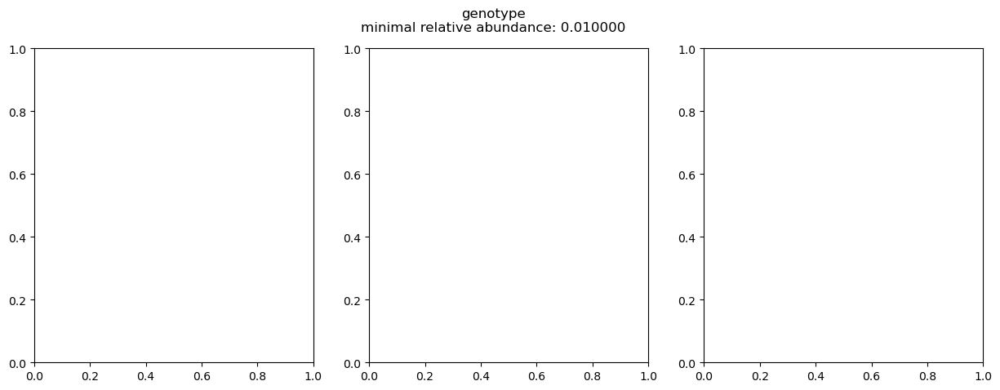

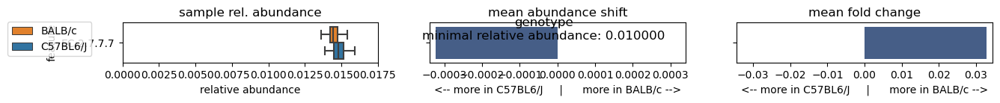

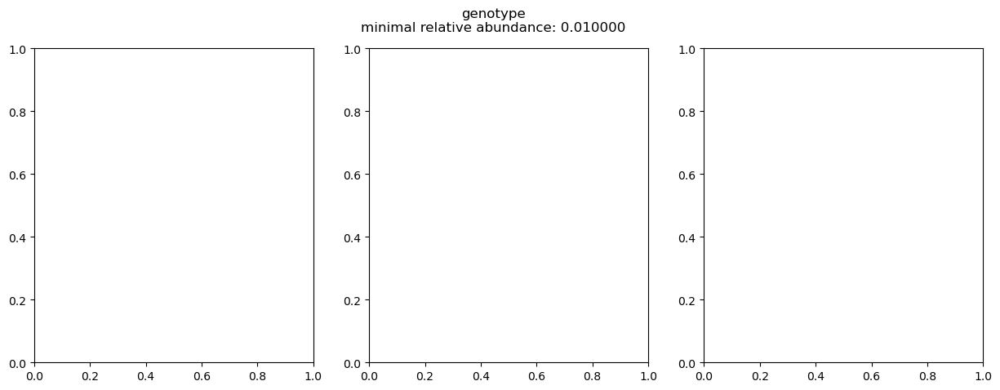

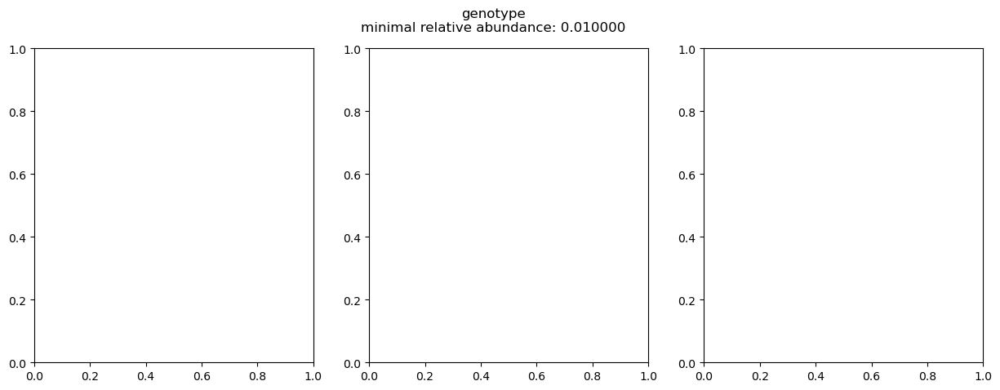

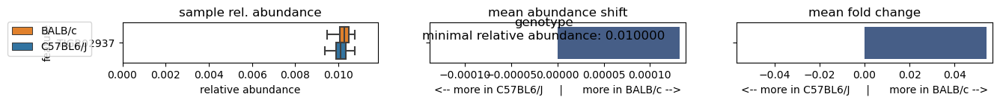

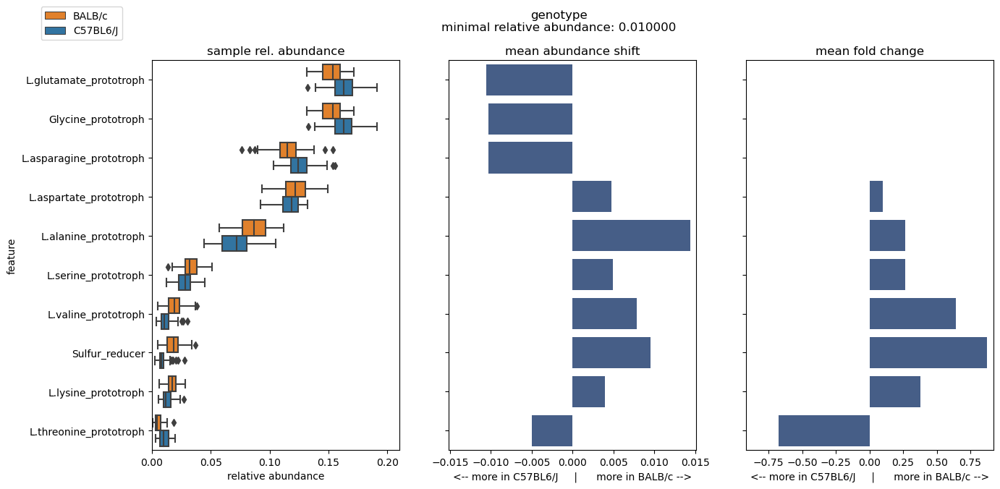

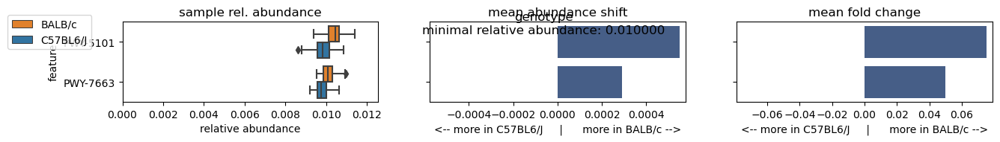

In [18]:
%matplotlib inline
for t in res_picrust2_gut['results']['counts'].keys():
    print(t)
    pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
    sample_subset.to_csv("tmp.meta", sep="\t")
    e = ca.read_amplicon("tmp.biom", "tmp.meta", min_reads=0, normalize=10000)
    print(e)

    res_dsFDR = find_diff_taxa(e, sample_subset, ['genotype'], random_seed=42)
    
    p = plot_diff_taxa(res_picrust2_gut['results']['counts'][t], 
                   sample_subset['genotype'], 
                   res_dsFDR, #onlyusetaxa=taxa_rf_dsfdr, 
                   #taxonomy=res_all['taxonomy']['RDP']['results']['Taxon'],
                   min_mean_abundance=0.01)

## rarifiziert
### Gut

In [19]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/rarefied6000-filtered-gut-table.qza\
  --output-path $work_dir/exported-rarified6000-gut-table

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied6000-filtered-gut-table.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-rarified6000-gut-table
CPU times: user 771 ms, sys: 146 ms, total: 916 ms
Wall time: 42 s


In [20]:
#exportieren der Biom tabellen -> verwenden derer die für Alphadiversität exportiert wurden, also OHNE rarefaction und OHNE Vergleichsproben
from ggmap.snippets import biom2pandas

picrust_gut = biom2pandas(work_dir + "/exported-rarified6000-gut-table/feature-table.biom").fillna(0)


In [22]:
#run picrust2
res_picrust2_gut = picrust2(picrust_gut, dry=False, dirty=True, use_grid=False)

Working directory is '/tmp/ana_picrust2_gewe0brf', cachefile is '.anacache/bc56a849dddf3e5a9df70c1fa829d260.picrust2'. /homes/arehm/Documents/Thesis/ggmap/ggmap/analyses.py:2258: FutureWarning: The squeeze argument has been deprecated and will be removed in a future version. Append .squeeze("columns") to the call to squeeze.


  'features': pd.read_csv('%s/16S_predicted_and_nsti.tsv.gz' % workdir, compression='gzip', sep='\t', index_col=0, squeeze=True)['metadata_NSTI'],
/homes/arehm/Documents/Thesis/ggmap/ggmap/analyses.py:2260: FutureWarning: The squeeze argument has been deprecated and will be removed in a future version. Append .squeeze("columns") to the call to squeeze.


  'samples': pd.read_csv('%s/%s_metagenome_out/weighted_nsti.tsv.gz' % (workdir, 'COG'), compression='gzip', sep='\t', index_col=0, squeeze=True)}


In [23]:
# you can list all different results, they come as feature tables=counts, speaking names=taxonomy and ~importance=NSTI
res_picrust2_gut['results'].keys()

dict_keys(['counts', 'taxonomy', 'NSTI'])

In [24]:
res_picrust2_gut['results']['counts'].keys()

dict_keys(['COG', 'EC', 'KO', 'PFAM', 'TIGRFAM', 'PHENO', 'MetaCyc_pathways'])

In [25]:
res_picrust2_gut['results']['counts']['COG']

,13422.181,13422.1,13422.118,13422.127,13422.172,13422.136,13422.154,13422.145,13422.109,13422.163,...,13422.colon384,13422.colon371,13422.colon385,13422.colon372,13422.colon386,13422.colon373,13422.colon387,13422.colon374,13422.colon375,13422.colon376
function,,,,,,,,,,,,,,,,,,,,,
COG0001,1038.00,946.00,2100.75,823.08,908.00,1089.25,770.25,1224.50,610.08,1961.33,...,1381.00,923.75,1343.00,1402.00,1453.75,1133.75,1480.50,1104.75,1190.25,1096.5
COG0002,4015.67,2651.50,4340.00,3784.58,3583.91,4099.75,2625.16,3298.17,2521.58,4056.41,...,3431.35,3363.25,4046.45,3577.17,3876.35,3040.92,4176.33,3071.09,3146.33,3659.5
COG0003,0.00,21.00,42.00,12.33,19.00,9.00,10.00,9.00,30.33,3.33,...,28.00,0.50,7.00,10.50,5.00,21.50,7.00,6.00,3.00,6.0
COG0004,2602.50,2207.00,2966.25,2297.58,2417.50,2651.50,2033.25,2508.25,2174.33,3236.58,...,2725.75,2431.00,2841.50,2328.25,3032.25,2200.50,3149.75,2399.00,2251.25,2588.5
COG0005,3279.17,2365.25,2504.00,3387.75,3097.91,3171.75,2488.66,2980.42,2314.25,2380.33,...,3024.10,4114.00,3257.70,4011.42,2821.85,3670.92,3208.08,3648.84,4052.83,4038.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
COG5655,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0
COG5658,20.00,70.75,59.00,39.50,14.25,118.00,19.50,44.75,23.00,42.75,...,85.75,107.50,174.75,40.00,90.50,37.50,81.75,68.25,59.25,164.0
COG5659,0.00,7.00,14.00,4.00,6.00,3.00,3.00,3.00,10.00,1.00,...,9.00,0.00,2.00,3.00,1.00,7.00,1.00,2.00,1.00,2.0


In [26]:
res_picrust2_gut['results']['taxonomy']['COG']

function
COG0001            Glutamate-1-semialdehyde aminotransferase
COG0002           N-acetyl-gamma-glutamylphosphate reductase
COG0003          Anion-transporting ATPase, ArsA/GET3 family
COG0004                         Ammonia channel protein AmtB
COG0005                      Purine nucleoside phosphorylase
                                 ...                        
COG5655    Plasmid rolling circle replication initiator p...
COG5658                     Uncharacterized membrane protein
COG5659                                   SRSO17 transposase
COG5662    Transmembrane transcriptional regulator (anti-...
COG5663             Uncharacterized protein, HAD superfamily
Name: description, Length: 3941, dtype: object

In [27]:
! rm -r /homes/arehm/TMP/ana_bdiv_945a7wzv

rm: cannot remove '/homes/arehm/TMP/ana_bdiv_945a7wzv': No such file or directory


In [29]:
# you can then compute e.g. beta diversity (but no UniFrac of course, since we lack a tree)
res_beta_picrust_gut = beta_diversity(res_picrust2_gut['results']['counts']['COG'], metrics=['bray_curtis'], dry=False, wait=True, use_grid=False)

Working directory is '/tmp/ana_bdiv_9mgdwrb0', cachefile is '.anacache/c5c2f0243d1d8e6db2d7df7dda1e2593.bdiv'. 

ValueError: SYSTEM CALL FAILED.
==== STDERR ====
Plugin error from diversity:

  The value passed to 'n_jobs' cannot exceed the number of processors (2) available to the system.

Debug info has been saved to /tmp/qiime2-q2cli-err-k9709oy3.log


==== STDOUT ====
Imported /tmp/ana_bdiv_9mgdwrb0/input.biom as BIOMV210DirFmt to /tmp/ana_bdiv_9mgdwrb0/input



In [30]:
# and compute emperor plots from these distances
emperor(meta, res_beta_picrust_gut['results'], fp_results="./", dry=False, use_grid=False)

Using existing results from '.anacache/d852bd80d8a34f246fdefdac5580e950.emperor'. 


{'results': {'bray_curtis': './emperor-pcoa_bray_curtis.qzv'},
 'workdir': '/homes/arehm/TMP/ana_emperor_5w9fug_g',
 'qid': '15212507',
 'file_cache': '.anacache/d852bd80d8a34f246fdefdac5580e950.emperor',
 'cached_inputs': {'metadata': '8b18bd199a34601ee886e42536c701de',
  'beta_diversities': '52676f04895e98ab02bea40d8e8da274',
  'other_beta_diversities': None},
 'timing': ['Linux rs620-bcf-2-6 5.4.0-135-generic #152-Ubuntu SMP Wed Nov 23 20:19:22 UTC 2022 x86_64 x86_64 x86_64 GNU/Linux\n',
  '\tCommand being timed: "qiime tools import --input-path /homes/arehm/TMP/ana_emperor_5w9fug_g/bray_curtis --type DistanceMatrix --output-path /homes/arehm/TMP/ana_emperor_5w9fug_g/beta_bray_curtis.qza"\n',
  '\tUser time (seconds): 8.27\n',
  '\tSystem time (seconds): 1.14\n',
  '\tPercent of CPU this job got: 39%\n',
  '\tElapsed (wall clock) time (h:mm:ss or m:ss): 0:23.90\n',
  '\tAverage shared text size (kbytes): 0\n',
  '\tAverage unshared data size (kbytes): 0\n',
  '\tAverage stack size (

In [31]:
sample_subset = meta[meta['genotype'].isin(["C57BL6/J","BALB/c"])
                     & (meta['host_body_product'] == 'UBERON:lumen of gut') 
                     & (meta['comparison'] == 0)
                     & meta['generation'].isin(['F3','F4'])
                    ]

In [32]:
sample_subset

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,...,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
sample_name,,,,,,,,,,,,,,,,,,,,,
13422.128,1,2019-07-10,CF3-1,F3-1,eppi,necropsy,2019-10-22,motherF3,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-h6,NaN,3,C1,3: F3,0
13422.129,1,2019-07-10,CF3-1,F3-1,eppi,necropsy,2019-10-22,motherF3,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-a6,NaN,3,C1,3: F3,0
13422.130,1,2019-07-10,CF3-1,F3-2,eppi,necropsy,2019-10-22,fatherF3,TRUE,42,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,1-d5,NaN,3,C1,3: F3,0
13422.131,1,2019-07-10,CF3-1,F3-3,eppi,necropsy,2019-10-22,not provided,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-g4,NaN,3,C1,3: F3,0
13422.132,1,2019-07-10,CF3-1,F3-3,eppi,necropsy,2019-10-22,not provided,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-b6,NaN,3,C1,3: F3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.257,1,2019-10-08,BF4-3,F4-28,eppi,necropsy,2020-01-21,fatherF4,TRUE,42,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,2-c6,NaN,4,B3,4: F4,0
13422.258,1,2019-10-08,BF4-3,F4-29,eppi,necropsy,2020-01-21,motherF4,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-a9,NaN,4,B3,4: F4,0
13422.259,1,2019-10-08,BF4-3,F4-29,eppi,necropsy,2020-01-21,motherF4,TRUE,42,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-g9,NaN,4,B3,4: F4,0


In [39]:
!rm -r /homes/arehm/TMP/ana_bdiv_setznxkn

In [38]:
#emperor for each of the categories
for t in res_picrust2_gut['results']['counts'].keys():
    print(t)
    res_beta_2 = beta_diversity(res_picrust2_gut['results']['counts'][t], metrics=['bray_curtis'], dry=False, wait=False, use_grid=False)
    if res_beta_2['results'] is not None:
        res_emp = emperor(sample_subset, res_beta_2['results'], fp_results="./", infix=t + 'f3f4', dry=False, wait=False, use_grid=False )
        display(plotNetworks('genotype', sample_subset, alpha=None, beta=res_beta_2['results'], summarize=True)[0], use_grid=False)

COG


Found 1 temporary working directories, but non of them have finished (missing "finished.info1" file). If no job is currently running, you might want to delete these directories and restart:
  /homes/arehm/TMP/ana_bdiv_setznxkn


EC


Working directory is '/homes/arehm/TMP/ana_bdiv_i5kktqoq', cachefile is '.anacache/0cdc3ca29e17eee79cb9750c5045d526.bdiv'. 

ValueError: Error in submitting job via qsub:
sbatch: error: Batch job submission failed: Required partition not available (inactive or drain)


In [ ]:
import calour as ca
ca.set_log_level(40)

COG


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 133 samples, 3941 features
'genotype'  (n=133)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   2417 (of  3941) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
EC


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 133 samples, 1744 features
'genotype'  (n=133)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   1090 (of  1744) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

KO


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 133 samples, 5615 features
'genotype'  (n=133)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   2851 (of  5615) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
PFAM


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 133 samples, 6856 features
'genotype'  (n=133)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   3877 (of  6856) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

Warnings: no taxa left!
TIGRFAM


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])


AmpliconExperiment with 133 samples, 3198 features
'genotype'  (n=133)


/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   1833 (of  3198) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

PHENO
AmpliconExperiment with 133 samples, 38 features
'genotype'  (n=133)


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


    17 (of   38) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)

MetaCyc_pathways
AmpliconExperiment with 133 samples, 346 features
'genotype'  (n=133)


/tmp/ipykernel_2340445/3146832152.py:4: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2375: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]
/homes/arehm/Documents/Thesis/ggmap/ggmap/snippets.py:2310: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  metadata = metadata.loc[set(calour_experiment.sample_metadata.index) & set(metadata.index), :]


   202 (of  346) taxa different between 'C57BL6/J' (n=86) vs. 'BALB/c' (n=47)



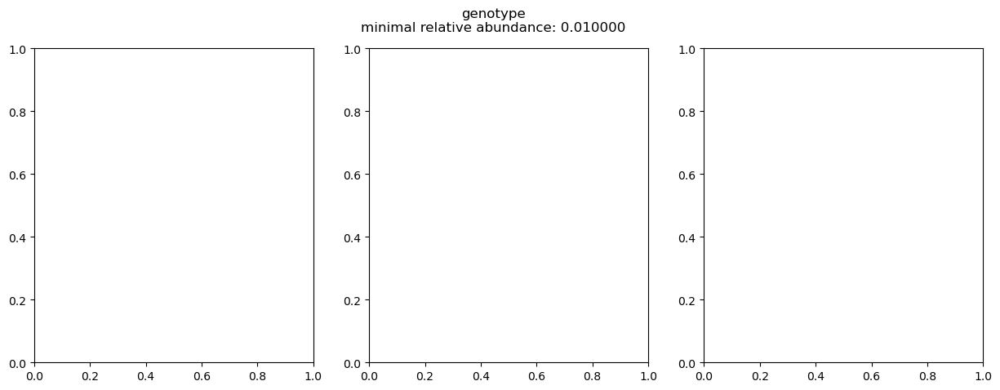

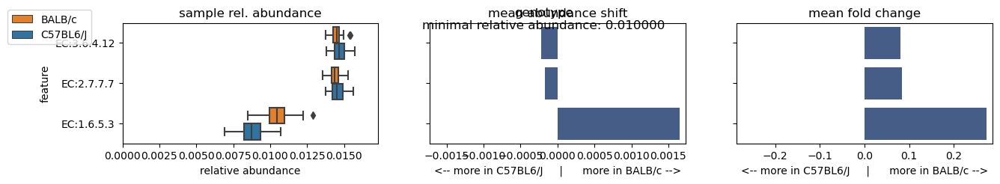

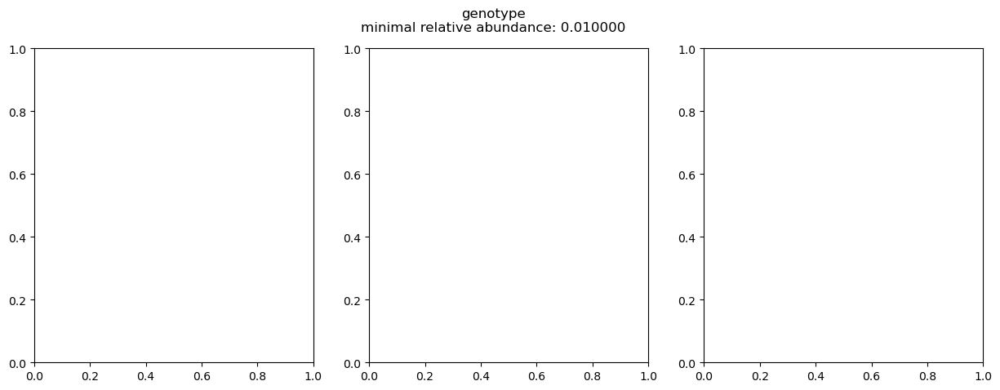

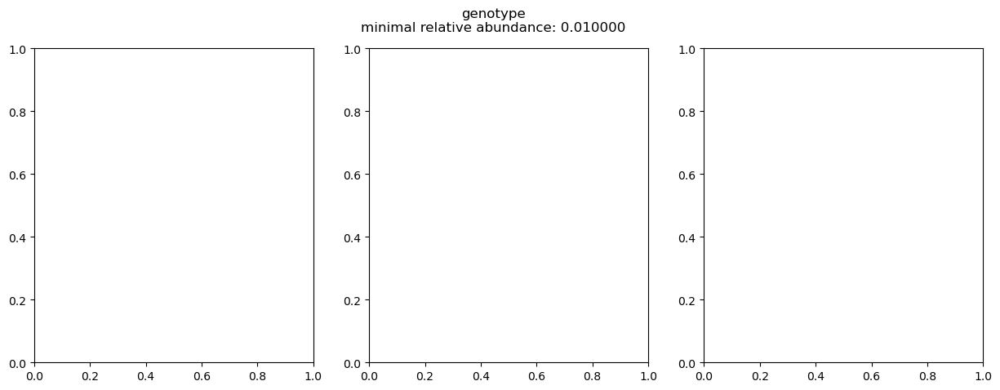

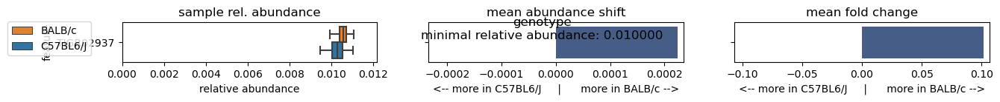

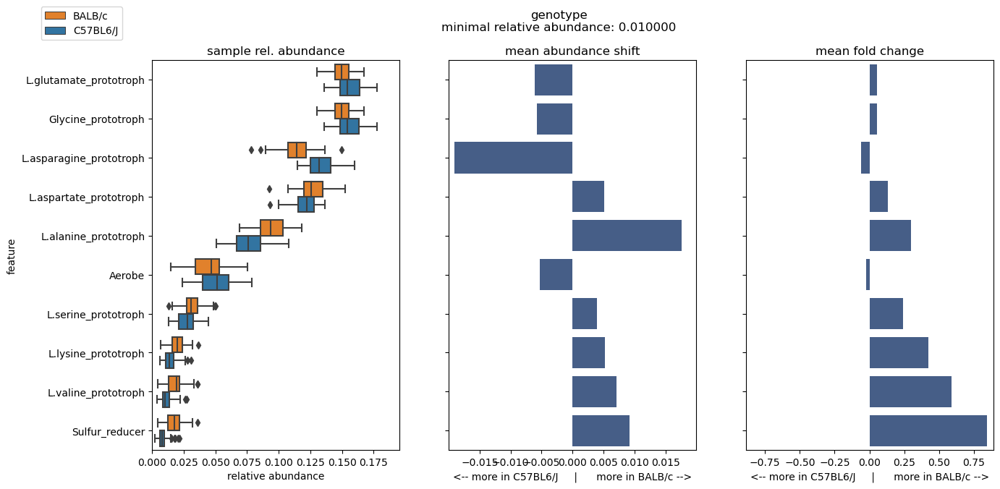

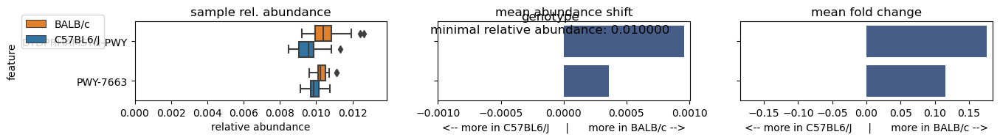

In [42]:
%matplotlib inline
for t in res_picrust2_gut['results']['counts'].keys():
    print(t)
    pandas2biom("tmp.biom", res_picrust2_gut['results']['counts'][t].loc[:, set(sample_subset.index) & set(picrust_gut.columns)])
    sample_subset.to_csv("tmp.meta", sep="\t")
    e = ca.read_amplicon("tmp.biom", "tmp.meta", min_reads=0, normalize=10000)
    print(e)

    res_dsFDR = find_diff_taxa(e, sample_subset, ['genotype'], random_seed=42)
    
    p = plot_diff_taxa(res_picrust2_gut['results']['counts'][t], 
                   sample_subset['genotype'], 
                   res_dsFDR, #onlyusetaxa=taxa_rf_dsfdr, 
                   #taxonomy=res_all['taxonomy']['RDP']['results']['Taxon'],
                   min_mean_abundance=0.01)

# Alpha Diversity

### Lumen of the Gut

Table needs to be filtered first by bodysite as to avoid artificial diversity by combining skin and gut samples.

In [4]:
meta = pd.read_csv(meta_file, sep="\t", dtype=str).set_index('sample_name')

In [5]:
test = meta[meta['host_body_product'].isin(['UBERON:lumen of gut'])]
test['genotype'].value_counts()

C57BL6/J    202
BALB/c      126
marmoset     20
B6CF1         6
Name: genotype, dtype: int64

In [26]:
indeces = []
for i in range (64,88):
    index = "13422.colon3" + str(i)
    indeces.append(index)
    index = "13422.skin3" + str(i)
    indeces.append(index)
    index = "13422.3" + str(i) + "skin"
    indeces.append(index)


In [27]:
comparison_mice_indeces = str(indeces)[1:-1]

In [71]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces) AND [host_body_product] IN ('UBERON:lumen of gut')" \
  --o-filtered-table $work_dir/filtered-gut-table-for-alpha.qza

/bin/bash: qiime: command not found
CPU times: user 3.14 ms, sys: 16.8 ms, total: 19.9 ms
Wall time: 196 ms


In [72]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/filtered-gut-table-for-alpha.qza \
  --output-path $work_dir/exported-filtered-gut-table-for-alpha

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-gut-table-for-alpha.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-filtered-gut-table-for-alpha
CPU times: user 302 ms, sys: 37.5 ms, total: 340 ms
Wall time: 12.8 s


Diversity was calculated using the ggmap package

In [7]:
from ggmap.snippets import biom2pandas

filtered_gut_table = biom2pandas(work_dir + "/exported-filtered-gut-table-for-alpha/feature-table.biom").fillna(0)

In [8]:
alpha_div_gut = alpha_diversity(filtered_gut_table, 6000, metrics=["shannon", "observed_features", "PD_whole_tree"], num_iterations=10, reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", use_grid=True, dry=False)

Using existing results from '.anacache/30d4263465aeb97b305da558afdc515c.adiv'. 


In [25]:
alpha_div_gut['results']

,shannon,observed_features,PD_whole_tree
iter10_depth6000,,,
13422.181,5.259452,137.3,12.234850
13422.1,5.912450,201.9,17.136439
13422.118,4.846749,151.7,13.861305
13422.127,5.695879,174.3,15.666234
13422.172,6.003214,176.6,16.329569
13422.136,5.677014,185.8,15.713614
13422.154,5.793480,182.1,16.125904
13422.145,6.268491,182.7,15.868448
13422.109,5.480658,173.7,15.962766


In [14]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_body_product] IN ('UBERON:lumen of gut')" \
  --o-filtered-table $work_dir/filtered-gut-table-for-alpha_compincluded.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-gut-table-for-alpha_compincluded.qza
CPU times: user 967 ms, sys: 214 ms, total: 1.18 s
Wall time: 36.2 s


In [15]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/filtered-gut-table-for-alpha_compincluded.qza \
  --output-path $work_dir/exported-filtered-gut-table-for-alpha_compincluded

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-gut-table-for-alpha_compincluded.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-filtered-gut-table-for-alpha_compincluded
CPU times: user 806 ms, sys: 168 ms, total: 974 ms
Wall time: 30.5 s


In [16]:
filtered_gut_table_comp_included = biom2pandas(work_dir + "/exported-filtered-gut-table-for-alpha_compincluded/feature-table.biom").fillna(0)
alpha_div_gut_comp_included = alpha_diversity(filtered_gut_table_comp_included, 6000, metrics=["shannon", "observed_features", "PD_whole_tree"], num_iterations=10, reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", use_grid=True, dry=False)

Working directory is '/homes/arehm/TMP/ana_adiv_evfobss1', cachefile is '.anacache/8195506782071798ed31c5324bb6b3ee.adiv'. alpha_diversity: skipping check for branches without length information. Reactivate via fix_zero_len_branches=True.

Waiting for slurm-cluster job 14509853 to complete: .............................................................................................................. finished. Was removed.


In [ ]:
alpha_results_merged_gut_comp = alpha_div_gut_comp_included['results'].merge(meta, left_index=True, right_index=True)
alpha_results_merged_gut_comp[alpha_results_merged_gut_comp['genotype'].isin(['C57BL6/J', 'BALB/c'])]

##### Visual Comparison of Genotype Alpha Diversity

In [ ]:
#import pandas as pd
#alpha_shannon_gut = pd.read_csv(work_dir + "/alpha_shannon_gut.tsv", sep="\t", index_col=0)
#alpha_observed_gut = pd.read_csv(work_dir + "/alpha_observed_features_gut.tsv", sep="\t", index_col=0)
#alpha_faithpd_gut = pd.read_csv(work_dir + "/alpha_faithpd_gut.tsv", sep="\t", index_col=0)
#alpha_shannon_gut = alpha_shannon_gut.drop('#q2:types')
#alpha_observed_gut = alpha_observed_gut.drop('#q2:types')
#alpha_faithpd_gut = alpha_faithpd_gut.drop('#q2:types')

In [9]:
alpha_results_merged_gut = alpha_div_gut['results'].merge(meta, left_index=True, right_index=True)
alpha_results_merged_gut[alpha_results_merged_gut['genotype'].isin(['C57BL6/J', 'BALB/c'])]

,shannon,PD_whole_tree,observed_features,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,...,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
13422.181,5.260159,12.543171,138.8,1,2019-08-08,BF3-2,F3-26,eppi,necropsy,2019-11-19,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-c4,NaN,3,B2,3: F3,0
13422.118,4.838070,13.822269,148.9,1,2019-05-09,BF2-2,F2-21,eppi,necropsy,2019-09-10,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-c2,NaN,2,B2,2: F2,0
13422.127,5.690784,15.673930,174.7,1,2019-05-09,BF2-2,F2-25,eppi,necropsy,2019-08-21,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,1-c6,NaN,2,B2,2: F2,0
13422.172,6.005072,16.391061,178.1,1,2019-07-13,CF3-3,F3-20,eppi,necropsy,2019-10-28,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,1-a12,NaN,3,C3,3: F3,0
13422.136,5.681626,15.988516,187.2,1,2019-07-10,CF3-1,F3-4,eppi,necropsy,2019-10-22,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-g6,NaN,3,C1,3: F3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.86,5.848891,16.987230,194.7,1,2019-05-06,CF2-1,F2-7,eppi,necropsy,2019-08-20,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,3-h2,3-h2,2,C1,2: F2,0
13422.94,5.943126,15.690028,190.1,1,2019-05-03,CF2-2,F2-9,eppi,necropsy,2019-08-15,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-f10,1-f10,2,C2,2: F2,0
13422.87,5.459895,15.502197,166.0,1,2019-05-06,CF2-1,F2-7,eppi,necropsy,2019-08-20,...,mouse gut metagenome,male,410661,Influence of the genetic background on murine ...,3-c6,3-c6,2,C1,2: F2,0
13422.95,6.416446,19.120956,234.7,1,2019-05-03,CF2-2,F2-9,eppi,necropsy,2019-08-15,...,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,4-a8,4-a8,2,C2,2: F2,0


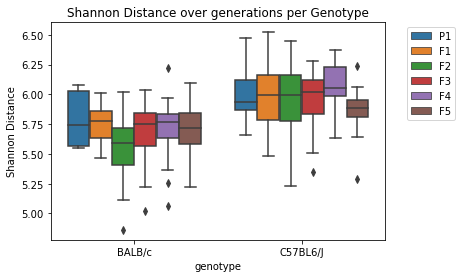

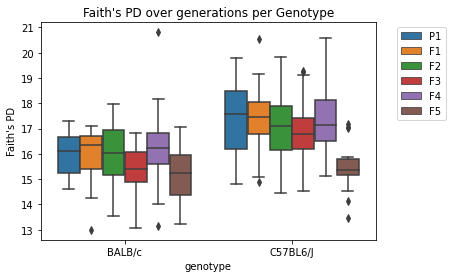

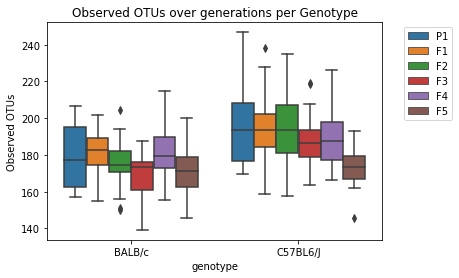

In [267]:
%matplotlib inline

import seaborn as sns
import matplotlib.pyplot as plt

no_RM = alpha_results_merged_gut[alpha_results_merged_gut['genotype'].isin(['C57BL6/J', 'BALB/c'])]

cdf = no_RM.explode("shannon")
cdf["shannon"] = cdf["shannon"].astype("float")
order_list = ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']

ax = sns.boxplot(x="genotype", y="shannon", hue="generation", data=cdf, hue_order=order_list)
plt.title("Shannon Distance over generations per Genotype")
plt.ylabel("Shannon Distance")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()


cdf = no_RM.explode("PD_whole_tree")
cdf["PD_whole_tree"] = cdf["PD_whole_tree"].astype("float")

ax = sns.boxplot(x="genotype", y="PD_whole_tree", hue="generation", data=cdf, hue_order=order_list)
plt.title("Faith's PD over generations per Genotype")
plt.ylabel("Faith's PD")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

cdf = no_RM.explode("observed_features")
cdf["observed_features"] = cdf["observed_features"].astype("float")

ax = sns.boxplot(x="genotype", y="observed_features", hue="generation", data=cdf, hue_order=order_list)
plt.title("Observed OTUs over generations per Genotype")
plt.ylabel("Observed OTUs")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

#### Skin

In [81]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces) AND [host_body_product] IN ('UBERON:sebum')" \
  --o-filtered-table $work_dir/filtered-sebum-table-for-alpha.qza

%time ! $q_path; qiime tools export \
  --input-path $work_dir/filtered-sebum-table-for-alpha.qza \
  --output-path $work_dir/exported-filtered-sebum-table-for-alpha

/bin/bash: qiime: command not found
CPU times: user 7.05 ms, sys: 12.8 ms, total: 19.8 ms
Wall time: 200 ms
Exported /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-sebum-table-for-alpha.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-filtered-sebum-table-for-alpha
CPU times: user 453 ms, sys: 76.3 ms, total: 529 ms
Wall time: 19.8 s


In [10]:
filtered_sebum_table = biom2pandas(work_dir + "/exported-filtered-sebum-table-for-alpha/feature-table.biom").fillna(0)
alpha_div_sebum = alpha_diversity(filtered_sebum_table, 1000, metrics=["shannon", "observed_features", "PD_whole_tree"], num_iterations=10, reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", use_grid=True, dry=False)

Using existing results from '.anacache/77d549f8f6eef3d9e05d92670bd2e6b2.adiv'. 


In [11]:
alpha_results_merged_sebum[alpha_results_merged_sebum['comparison'].isin(['1'])]

,observed_features,PD_whole_tree,shannon,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,elevation_units,empo_1,empo_2,empo_3,env_biome,env_feature,env_material,env_package,facility,father_subject_id,generation,genotype,geo_loc_name,host_age,host_age_units,host_body_habitat,host_body_product,host_body_site,host_common_name,host_height,host_height_units,host_scientific_name,host_subject_id,host_taxid,host_weight,host_weight_units,iacuc_institute,iacuc_protocol_id,latitude,latitude_units,life_stage,longitude,longitude_units,mother_subject_id,parental_cage,physical_specimen_location,physical_specimen_remaining,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison


In [11]:
alpha_results_merged_sebum = alpha_div_sebum['results'].merge(meta, left_index=True, right_index=True)
alpha_results_merged_sebum[alpha_results_merged_sebum['genotype'].isin(['C57BL6/J', 'BALB/c'])]

,observed_features,shannon,PD_whole_tree,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,...,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
13422.181skin,42.9,4.320901,9.026971,3,2019-08-08,BF3-2,F3-26,eppi,necropsy,2019-11-19,...,mouse skin metagenome,female,410661,Skin screening,6-c4,6-c4,3,B2,3: F3,0
13422.172skin,26.6,0.741001,6.138310,3,2019-07-13,CF3-3,F3-20,eppi,necropsy,2019-10-28,...,mouse skin metagenome,male,410661,Skin screening,6-a12,6-a12,3,C3,3: F3,0
13422.118skin,29.6,1.934505,6.330459,3,2019-05-09,BF2-2,F2-21,eppi,necropsy,2019-09-10,...,mouse skin metagenome,female,410661,Skin screening,8-c2,8-c2,2,B2,2: F2,0
13422.145skin,44.6,1.280731,9.204390,3,2019-07-10,CF3-2,F3-7,eppi,necropsy,2019-10-23,...,mouse skin metagenome,female,410661,Skin screening,7-d10,7-d10,3,C2,3: F3,0
13422.154skin,60.6,5.131082,9.753208,3,2019-07-14,CF3-2,F3-12,eppi,necropsy,2019-10-29,...,mouse skin metagenome,male,410661,Skin screening,9-c8,9-c8,3,C2,3: F3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.85skin,41.0,3.752409,8.670402,3,2019-05-06,CF2-1,F2-6,eppi,necropsy,2019-08-20,...,mouse skin metagenome,male,410661,Skin screening,7-a8,7-a8,2,C1,2: F2,0
13422.93skin,32.9,4.148164,6.787002,3,2019-05-03,CF2-2,F2-9,eppi,necropsy,2019-08-15,...,mouse skin metagenome,female,410661,Skin screening,7-c10,7-c10,2,C2,2: F2,0
13422.69skin,85.4,5.170829,11.918280,3,2019-02-18,CF1-3,F1-12,eppi,necropsy,2019-06-03,...,mouse skin metagenome,female,410661,Skin screening,8-g10,8-g10,1,C3,1: F1,0
13422.87skin,43.3,3.823303,9.079061,3,2019-05-06,CF2-1,F2-7,eppi,necropsy,2019-08-20,...,mouse skin metagenome,male,410661,Skin screening,8-c6,8-c6,2,C1,2: F2,0


In [12]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_body_product] IN ('UBERON:sebum')" \
  --o-filtered-table $work_dir/filtered-sebum-table-for-alpha_compincluded.qza

%time ! $q_path; qiime tools export \
  --input-path $work_dir/filtered-sebum-table-for-alpha_compincluded.qza \
  --output-path $work_dir/exported-filtered-sebum-table-for-alpha_compincluded

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-sebum-table-for-alpha_compincluded.qza
CPU times: user 876 ms, sys: 186 ms, total: 1.06 s
Wall time: 32.8 s
Exported /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-sebum-table-for-alpha_compincluded.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-filtered-sebum-table-for-alpha_compincluded
CPU times: user 561 ms, sys: 78.9 ms, total: 640 ms
Wall time: 22.8 s


In [18]:
filtered_sebum_table_comp_included = biom2pandas(work_dir + "/exported-filtered-sebum-table-for-alpha_compincluded/feature-table.biom").fillna(0)
alpha_div_sebum_comp = alpha_diversity(filtered_sebum_table_comp_included, 1000, metrics=["shannon", "observed_features", "PD_whole_tree"], num_iterations=10, reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", use_grid=True, dry=False)

Using existing results from '.anacache/8dc96e8ac80d555114501ed79389e961.adiv'. 


In [20]:
alpha_results_merged_sebum_comp = alpha_div_sebum_comp['results'].merge(meta, left_index=True, right_index=True)
alpha_results_merged_sebum_comp[alpha_results_merged_sebum_comp['genotype'].isin(['C57BL6/J', 'BALB/c'])]

,PD_whole_tree,observed_features,shannon,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,elevation_units,empo_1,empo_2,empo_3,env_biome,env_feature,env_material,env_package,facility,father_subject_id,generation,genotype,geo_loc_name,host_age,host_age_units,host_body_habitat,host_body_product,host_body_site,host_common_name,host_height,host_height_units,host_scientific_name,host_subject_id,host_taxid,host_weight,host_weight_units,iacuc_institute,iacuc_protocol_id,latitude,latitude_units,life_stage,longitude,longitude_units,mother_subject_id,parental_cage,physical_specimen_location,physical_specimen_remaining,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
13422.181skin,8.718595,42.6,4.312264,3,2019-08-08,BF3-2,F3-26,eppi,necropsy,2019-11-19,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F3,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,181,10090,21.9,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,not provided,F2-21,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,6-c4,6-c4,3,B2,3: F3,0
13422.172skin,6.077599,25.0,0.725551,3,2019-07-13,CF3-3,F3-20,eppi,necropsy,2019-10-28,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F3,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,172,10090,32.3,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,not provided,F2-12,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,male,410661,Skin screening,6-a12,6-a12,3,C3,3: F3,0
13422.118skin,6.077318,29.6,1.731438,3,2019-05-09,BF2-2,F2-21,eppi,necropsy,2019-09-10,motherF2,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F2,BALB/c,Germany:Duesseldorf,17,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,118,10090,27.2,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,F2,F1-21,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,8-c2,8-c2,2,B2,2: F2,0
13422.145skin,9.230453,43.7,1.298037,3,2019-07-10,CF3-2,F3-7,eppi,necropsy,2019-10-23,motherF3,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F3,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,145,10090,26.5,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,F3,F2-8,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,7-d10,7-d10,3,C2,3: F3,0
13422.154skin,9.777445,60.5,5.150581,3,2019-07-14,CF3-2,F3-12,eppi,necropsy,2019-10-29,not provided,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F3,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,154,10090,31.4,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,not provided,F2-8,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,male,410661,Skin screening,9-c8,9-c8,3,C2,3: F3,0
13422.163skin,6.271259,33.5,4.302546,3,2019-07-10,CF3-3,F3-16,eppi,necropsy,2019-10-24,fatherF3,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated hab

##### Visual Comparison of Genotype Alpha Diversity Skin

In [7]:
#alpha_shannon_sebum = pd.read_csv(work_dir + "/alpha_shannon_sebum.tsv", sep="\t", index_col=0)
#alpha_observed_sebum = pd.read_csv(work_dir + "/alpha_observed_features_sebum.tsv", sep="\t", index_col=0)
#alpha_faithpd_sebum = pd.read_csv(work_dir + "/alpha_faithpd_sebum.tsv", sep="\t", index_col=0)
#alpha_shannon_sebum = alpha_shannon_sebum.drop('#q2:types')
#alpha_observed_sebum = alpha_observed_sebum.drop('#q2:types')
#alpha_faithpd_sebum = alpha_faithpd_sebum.drop('#q2:types')

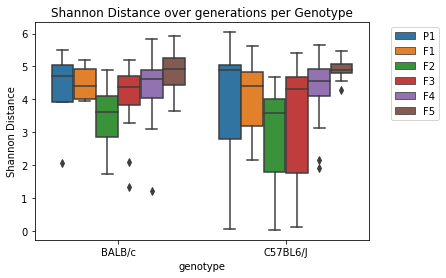

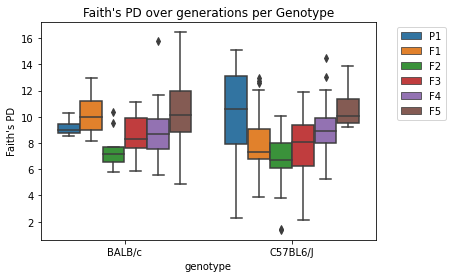

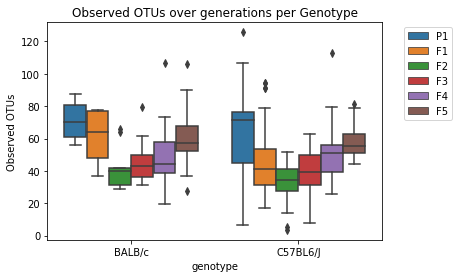

In [271]:
%matplotlib inline
no_RM = alpha_results_merged_sebum[alpha_results_merged_sebum['genotype'].isin(['C57BL6/J', 'BALB/c'])]
cdf = no_RM.explode("shannon")
cdf["shannon"] = cdf["shannon"].astype("float")
order_list = ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']

ax = sns.boxplot(x="genotype", y="shannon", hue="generation", data=cdf, hue_order=order_list)
plt.title("Shannon Distance over generations per Genotype")
plt.ylabel("Shannon Distance")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()


cdf = no_RM.explode("PD_whole_tree")
cdf["PD_whole_tree"] = cdf["PD_whole_tree"].astype("float")

ax = sns.boxplot(x="genotype", y="PD_whole_tree", hue="generation", data=cdf, hue_order=order_list)
plt.title("Faith's PD over generations per Genotype")
plt.ylabel("Faith's PD")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

cdf = no_RM.explode("observed_features")
cdf["observed_features"] = cdf["observed_features"].astype("float")

ax = sns.boxplot(x="genotype", y="observed_features", hue="generation", data=cdf, hue_order=order_list)
plt.title("Observed OTUs over generations per Genotype")
plt.ylabel("Observed OTUs")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

# Beta diversity

In [27]:
%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/rarefied-filtered-feature-table.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/beta_matrix.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/beta_matrix.qza \
  --o-pcoa $work_dir/beta_pcoa_unweighted.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/beta_pcoa_unweighted.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/unweighted_emperor.qzv

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/beta_matrix.qza
CPU times: user 400 ms, sys: 100 ms, total: 500 ms
Wall time: 17.2 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/beta_pcoa_unweighted.qza
CPU times: user 371 ms, sys: 101 ms, total: 472 ms
Wall time: 16.3 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/unweighted_emperor.qzv
CPU times: user 388 ms, sys: 93.6 ms, total: 482 ms
Wall time: 16.4 s


### Only mice

In [14]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied-filtered-feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('marmoset') OR [host_common_name] IN ('not applicable') OR [host_body_product] IN ('UBERON:lung')" \
  --p-exclude-ids True\
  --o-filtered-table $work_dir/mouse-filtered-table-new.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/mouse-filtered-table-new.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/mouse_beta_matrix-new.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/mouse_beta_matrix-new.qza \
  --o-pcoa $work_dir/mouse_beta_pcoa_unweighted-new.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/mouse_beta_pcoa_unweighted-new.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/mouse_unweighted_emperor-new.qzv

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-filtered-table-new.qza
CPU times: user 325 ms, sys: 79.3 ms, total: 405 ms
Wall time: 19.1 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_matrix-new.qza
CPU times: user 245 ms, sys: 49 ms, total: 294 ms
Wall time: 14.3 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_pcoa_unweighted-new.qza
CPU times: user 253 ms, sys: 42.1 ms, total: 295 ms
Wall time: 14 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_unweighted_emperor-new.qzv
CPU times: user 235 ms, sys: 23.2 ms, total: 258 ms
Wall time: 12.4 s


### Per Batch

In [93]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied-filtered-feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [batch] IN ('1') " \
  --o-filtered-table $work_dir/mouse-filtered-table-batch1.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/mouse-filtered-table-batch1.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/mouse_beta_matrix_batch1.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/mouse_beta_matrix_batch1.qza \
  --o-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch1.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch1.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/mouse_unweighted_emperor_batch1.qzv

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-filtered-table-batch1.qza
CPU times: user 115 ms, sys: 42.1 ms, total: 157 ms
Wall time: 10.7 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_matrix_batch1.qza
CPU times: user 92.1 ms, sys: 18.7 ms, total: 111 ms
Wall time: 7.62 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_pcoa_unweighted_batch1.qza
CPU times: user 75.1 ms, sys: 25.9 ms, total: 101 ms
Wall time: 6.92 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_unweighted_emperor_batch1.qzv
CPU times: user 70.5 ms, sys: 31.5 ms, total: 102 ms
Wall time: 6.83 s


In [15]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied-filtered-feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [batch] IN ('2') AND [sample_name] NOT IN ($comparison_mice_indeces)" \
  --o-filtered-table $work_dir/mouse-filtered-table-batch2.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/mouse-filtered-table-batch2.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/mouse_beta_matrix_batch2.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/mouse_beta_matrix_batch2.qza \
  --o-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch2.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch2.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/mouse_unweighted_emperor_batch2.qzv

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-filtered-table-batch2.qza
CPU times: user 188 ms, sys: 57.5 ms, total: 245 ms
Wall time: 17.3 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_matrix_batch2.qza
CPU times: user 108 ms, sys: 32.3 ms, total: 140 ms
Wall time: 10.3 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_pcoa_unweighted_batch2.qza
CPU times: user 118 ms, sys: 10.9 ms, total: 129 ms
Wall time: 9.51 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_unweighted_emperor_batch2.qzv
CPU times: user 109 ms, sys: 24.5 ms, total: 134 ms
Wall time: 10.2 s


In [16]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied-filtered-feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [batch] IN ('3') AND [sample_name] NOT IN ($comparison_mice_indeces)" \
  --o-filtered-table $work_dir/mouse-filtered-table-batch3.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/mouse-filtered-table-batch3.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/mouse_beta_matrix_batch3.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/mouse_beta_matrix_batch3.qza \
  --o-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch3.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/mouse_beta_pcoa_unweighted_batch3.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/mouse_unweighted_emperor_batch3.qzv

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-filtered-table-batch3.qza
CPU times: user 98.2 ms, sys: 20 ms, total: 118 ms
Wall time: 9.02 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_matrix_batch3.qza
CPU times: user 113 ms, sys: 12.5 ms, total: 125 ms
Wall time: 9.26 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_beta_pcoa_unweighted_batch3.qza
CPU times: user 99.6 ms, sys: 22.5 ms, total: 122 ms
Wall time: 9.24 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse_unweighted_emperor_batch3.qzv
CPU times: user 108 ms, sys: 23.5 ms, total: 131 ms
Wall time: 9.85 s


### Per Body Product
#### Gut with comparison

In [18]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied6000-filtered-gut-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name]='mouse'" \
  --o-filtered-table $work_dir/gut6000-mouse-filtered-table.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000-mouse-filtered-table.qza
CPU times: user 416 ms, sys: 103 ms, total: 519 ms
Wall time: 20.2 s


In [19]:
%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/gut6000-mouse-filtered-table.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/gut6000_beta_matrix.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/gut6000_beta_matrix.qza \
  --o-pcoa $work_dir/gut6000_beta_pcoa_unweighted.qza

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_matrix.qza
CPU times: user 303 ms, sys: 60.5 ms, total: 363 ms
Wall time: 14.1 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_pcoa_unweighted.qza
CPU times: user 317 ms, sys: 31 ms, total: 348 ms
Wall time: 13.3 s


In [20]:
%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/gut6000_beta_pcoa_unweighted.qza \
  --m-metadata-file meta_gen_num.txt \
  --o-visualization $work_dir/gut6000_unweighted_emperor.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_unweighted_emperor.qzv
CPU times: user 307 ms, sys: 66.3 ms, total: 374 ms
Wall time: 14.2 s


#### Gut without comparison

2022/11/15: interesting development here on the beta diversity front for gut samples. The cage lineage C3 seems to be moving into a different direction than C1 and C2 -> instead of "moving down" it seems to be "moving up" or rather staying in the same place. this might be the duality of samples Celeste was talking about 

In [21]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/gut6000-mouse-filtered-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces)" \
  --o-filtered-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza

/bin/bash: qiime: command not found
CPU times: user 5.21 ms, sys: 7.64 ms, total: 12.8 ms
Wall time: 186 ms


In [44]:
%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/gut6000_beta_matrix-nocomp.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/gut6000_beta_matrix-nocomp.qza \
  --o-pcoa $work_dir/gut6000_beta_pcoa_unweighted-nocomp.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/gut6000_beta_pcoa_unweighted-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --o-visualization $work_dir/gut6000_unweighted_emperor-nocomp.qzv

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_matrix-nocomp.qza
CPU times: user 357 ms, sys: 32.3 ms, total: 389 ms
Wall time: 15 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_pcoa_unweighted-nocomp.qza
CPU times: user 276 ms, sys: 41.2 ms, total: 317 ms
Wall time: 12.4 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_unweighted_emperor-nocomp.qzv
CPU times: user 513 ms, sys: 59.7 ms, total: 573 ms
Wall time: 22.4 s


In [58]:
%time ! $q_path; qiime diversity beta\
  --i-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza \
  --p-metric "braycurtis" \
  --o-distance-matrix $work_dir/gut6000_beta_braycurtis_matrix-nocomp.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "weighted_unifrac" \
  --o-distance-matrix $work_dir/gut6000_beta_weighted_unifrac_matrix-nocomp.qza

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_braycurtis_matrix-nocomp.qza
CPU times: user 315 ms, sys: 69.4 ms, total: 385 ms
Wall time: 13.7 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_weighted_unifrac_matrix-nocomp.qza
CPU times: user 334 ms, sys: 93.1 ms, total: 427 ms
Wall time: 15.5 s


In [81]:
%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/gut6000_beta_braycurtis_matrix-nocomp.qza \
  --o-pcoa $work_dir/gut6000_beta_pcoa_braycurtis-nocomp.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/gut6000_beta_weighted_unifrac_matrix-nocomp.qza \
  --o-pcoa $work_dir/gut6000_beta_pcoa_weighted-nocomp.qza

Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_pcoa_braycurtis-nocomp.qza
CPU times: user 340 ms, sys: 84.4 ms, total: 424 ms
Wall time: 15.6 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_beta_pcoa_weighted-nocomp.qza
CPU times: user 329 ms, sys: 91 ms, total: 420 ms
Wall time: 15.1 s


In [650]:
%time ! $q_path; qiime emperor plot \
  --i-pcoa  $work_dir/gut6000_beta_pcoa_weighted-nocomp.qza \
  --m-metadata-file $meta_file \
  --o-visualization $work_dir/gut6000_unweighted_emperor-nocomp.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_unweighted_emperor-nocomp.qzv
CPU times: user 424 ms, sys: 82.8 ms, total: 506 ms
Wall time: 18 s


In [36]:
%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/gut_beta_pcoa_unweighted-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --p-custom-axes gen_number \
  --o-visualization $work_dir/gut_unweighted_emperor-nocomp-time.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut_unweighted_emperor-nocomp-time.qzv
CPU times: user 377 ms, sys: 123 ms, total: 500 ms
Wall time: 16.8 s


In [4]:
%time ! $q_path; qiime diversity beta-group-significance \
  --i-distance-matrix $work_dir/gut_beta_matrix-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --m-metadata-column i_generation \
  --p-pairwise \
  --p-permutations 9999 \
  --o-visualization $work_dir/gut_beta_group_significance_nopair.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut_beta_group_significance_nopair.qzv
CPU times: user 2.19 s, sys: 338 ms, total: 2.53 s
Wall time: 1min 52s


#### Sebum with comparison

In [23]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/rarefied-filtered-sebum-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name]='mouse'" \
  --o-filtered-table $work_dir/sebum-mouse-filtered-table.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/sebum-mouse-filtered-table.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/sebum_beta_matrix.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/sebum_beta_matrix.qza \
  --o-pcoa $work_dir/sebum_beta_pcoa_unweighted.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum-mouse-filtered-table.qza
CPU times: user 279 ms, sys: 42.1 ms, total: 321 ms
Wall time: 12.3 s
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_beta_matrix.qza
CPU times: user 265 ms, sys: 59.1 ms, total: 325 ms
Wall time: 12.7 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_beta_pcoa_unweighted.qza
CPU times: user 267 ms, sys: 68.6 ms, total: 336 ms
Wall time: 12.7 s


In [24]:
%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/sebum_beta_pcoa_unweighted.qza \
  --m-metadata-file meta_gen_num.txt \
  --o-visualization $work_dir/sebum_unweighted_emperor.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_unweighted_emperor.qzv
CPU times: user 279 ms, sys: 49.4 ms, total: 328 ms
Wall time: 12.8 s


#### Sebum without comparison

In [61]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/sebum-mouse-filtered-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces)" \
  --o-filtered-table $work_dir/sebum-mouse-filtered-table-nocomp.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/sebum-mouse-filtered-table-nocomp.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "unweighted_unifrac" \
  --o-distance-matrix $work_dir/sebum_beta_matrix-nocomp.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/sebum_beta_matrix-nocomp.qza \
  --o-pcoa $work_dir/sebum_beta_pcoa_unweighted-nocomp.qza

%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/sebum_beta_pcoa_unweighted-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --o-visualization $work_dir/sebum_unweighted_emperor-nocomp.qzv

/bin/bash: qiime: command not found
CPU times: user 8.3 ms, sys: 7.79 ms, total: 16.1 ms
Wall time: 214 ms
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_beta_matrix-nocomp.qza
CPU times: user 500 ms, sys: 95.5 ms, total: 596 ms
Wall time: 23.2 s
Saved PCoAResults to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_beta_pcoa_unweighted-nocomp.qza
CPU times: user 317 ms, sys: 40 ms, total: 357 ms
Wall time: 13.7 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/sebum_unweighted_emperor-nocomp.qzv
CPU times: user 355 ms, sys: 51.1 ms, total: 406 ms
Wall time: 15.3 s


In [ ]:
%time ! $q_path; qiime diversity beta \
  --i-table $work_dir/sebum-mouse-filtered-table-nocomp.qza \
  --p-metric "braycurtis" \
  --o-distance-matrix $work_dir/sebum_beta_braycurtis_matrix-nocomp.qza

%time ! $q_path; qiime diversity beta-phylogenetic \
  --i-table $work_dir/sebum-mouse-filtered-table-nocomp.qza \
  --i-phylogeny $work_dir/insertion-tree.qza \
  --p-metric "weighted_unifrac" \
  --o-distance-matrix $work_dir/sebum_beta_weighted_unifrac_matrix-nocomp.qza

In [ ]:
%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/sebum_beta_braycurtis_matrix-nocomp.qza \
  --o-pcoa $work_dir/sebum_beta_pcoa_braycurtis-nocomp.qza

%time ! $q_path; qiime diversity pcoa \
  --i-distance-matrix $work_dir/sebum_beta_weighted_unifrac_matrix-nocomp.qza \
  --o-pcoa $work_dir/sebum_beta_pcoa_weighted-nocomp.qza

In [ ]:
%time ! $q_path; qiime emperor plot \
  --i-pcoa $work_dir/sebum_beta_pcoa_unweighted-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --p-custom-axes gen_number \
  --o-visualization $work_dir/sebum_unweighted_emperor-nocomp-time.qzv

In [ ]:
%time ! $q_path; qiime diversity beta-group-significance \
  --i-distance-matrix $work_dir/sebum_beta_matrix-nocomp.qza \
  --m-metadata-file meta_gen_num.txt \
  --m-metadata-column i_generation \
  --p-permutations 9999 \
  --o-visualization $work_dir/sebum_beta_group_significance_nopair.qzv

## Taxonomy barplots

In [4]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/rarefied-filtered-noCyanobacteria-feature-table-all.qza \
  --o-visualization $work_dir/summary-rarefied-filtered-noCyanobacteria-feature-table.qzv \
  --m-sample-metadata-file $meta_file

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/summary-rarefied-filtered-noCyanobacteria-feature-table.qzv
CPU times: user 1.07 s, sys: 201 ms, total: 1.27 s
Wall time: 52.1 s


In [3]:
%time ! $q_path; qiime taxa barplot \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --m-metadata-file meta_gen_num.txt \
  --o-visualization $work_dir/taxa_barplot_full.qzv

QIIME is caching your current deployment for improved performance. This may take a few moments and should only happen once per deployment.
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/taxa_barplot_full.qzv
CPU times: user 898 ms, sys: 163 ms, total: 1.06 s
Wall time: 49.7 s


In [14]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/taxonomy_full.qza \
  --output-path $work_dir/exported-taxonomy-full

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/taxonomy_full.qza as TSVTaxonomyDirectoryFormat to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-taxonomy-full
CPU times: user 988 ms, sys: 195 ms, total: 1.18 s
Wall time: 35.6 s


In [15]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/fragment-filtered‐feature-table.qza \
  --output-path $work_dir/exported-fragment-filtered-feature-table

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/fragment-filtered‐feature-table.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/exported-fragment-filtered-feature-table
CPU times: user 643 ms, sys: 138 ms, total: 781 ms
Wall time: 25.7 s


In [3]:
#taxa_all_l2 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-2.csv", sep=",").set_index('index')
#taxa_all_l3 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-3.csv", sep=",").set_index('index')
#taxa_all_l4 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-4.csv", sep=",").set_index('index')
#taxa_all_l5 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-5.csv", sep=",").set_index('index')
taxa_all_l6 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-6.csv", sep=",").set_index('index')
#taxa_all_l7 = pd.read_csv("/homes/arehm/Documents/Thesis/JupyterNotebook/taxa/level-7.csv", sep=",").set_index('index')

In [29]:
taxa_all_l5 = taxa_all_l5[taxa_all_l5['host_body_product'].isin(['UBERON:lumen of gut', 'UBERON:sebum']) & taxa_all_l5['host_scientific_name'].isin(['Mus musculus']) & taxa_all_l5['genotype'].isin(['BALB/c', 'C57BL6/J'])]
filtered_taxa = taxa_all_l5.groupby(["host_body_product","genotype"]).sum()
filtered_taxa = filtered_taxa.drop(columns=['batch', 'dna_extracted', 'elevation', 'latitude', 'longitude', 'physical_specimen_remaining', 'qiita_study_id', 'taxon_id', 'gen_number', 'comparison'])
#taxa_all_l5['percent'] = (taxa_all_l5['sum']/taxa_all_l5['sum'].sum())*100
#taxa_all_l5 = taxa_all_l5[~taxa_all_l5.index.str.endswith("__")]
filtered_taxa = filtered_taxa.loc[:,~filtered_taxa.columns.str.endswith('__')]

In [79]:
exported_taxonomy = pd.read_csv("exported-taxonomy-full/taxonomy.tsv", sep="\t").set_index("Feature ID")

In [68]:
exported_taxonomy[['Taxon1', 'Taxon2']] = exported_taxonomy["Taxon"].apply(lambda x: pd.Series(str(x).split(" c__")))

In [76]:
phylum_taxa= exported_taxonomy.drop(columns=["Taxon2", "Taxon"])
#phylum_taxa = phylum_taxa.loc[:,~phylum_taxa.columns.str.endswith('k__Bacteria')]
phylum_taxa.rename(columns={'Taxon1':'Taxon'}, inplace=True)
phylum_taxa = phylum_taxa[["Taxon", "Confidence"]]
phylum_taxa = phylum_taxa.drop(phylum_taxa[phylum_taxa.Taxon == "k__Bacteria"].index)
phylum_taxa.to_csv("exported-taxonomy-full/phylum.tsv", sep="\t")

In [22]:
filtered_exported_taxonomy = exported_taxonomy.loc[:,~exported_taxonomy.columns.str.endswith('__')]

In [25]:
filtered_exported_taxonomy.to_csv("exported-taxonomy-full/filtered-taxonomy.tsv", header=True, sep="\t")

In [20]:
exported_taxonomy.to_csv("exported-taxonomy-full/test.tsv", header=True, sep="\t")

32 taxa left after collapsing to Phylum.
656 samples left with metadata and counts.
21 taxa left after filtering low abundant.
raw counts: 767
raw meta: 668
meta with counts: 4 samples x 4 fields
counts with meta: 4


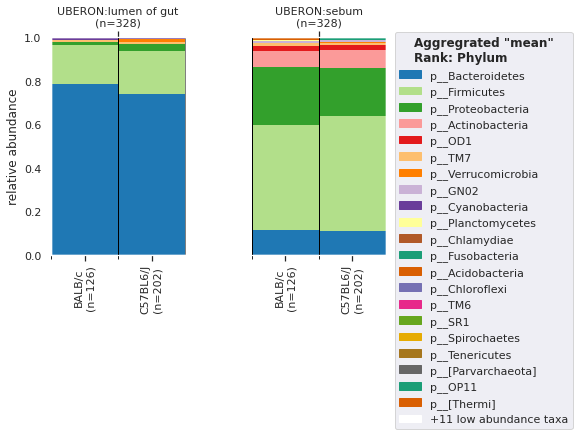

In [85]:
%matplotlib inline
fig = plotTaxonomy("exported-fragment-filtered-feature-table/feature-table.biom", meta[meta['host_body_product'].isin(['UBERON:lumen of gut', 'UBERON:sebum']) & meta['host_scientific_name'].isin(['Mus musculus']) & meta['genotype'].isin(['BALB/c', 'C57BL6/J'])],  file_taxonomy="exported-taxonomy-full/phylum.tsv", fct_aggregate=np.mean, group_l0="host_body_product",group_l1="genotype", rank="Phylum", minreadnr=100)
plt.show()

In [141]:
exported_taxonomy[['Taxon1', 'Taxon2']] = exported_taxonomy["Taxon"].apply(lambda x: pd.Series(str(x).split(" g__")))
family_taxa= exported_taxonomy.drop(columns=["Taxon2", "Taxon"])
#phylum_taxa = phylum_taxa.loc[:,~phylum_taxa.columns.str.endswith('k__Bacteria')]
family_taxa.rename(columns={'Taxon1':'Taxon'}, inplace=True)
family_taxa = family_taxa[["Taxon", "Confidence"]]
#family_taxa = family_taxa.drop(family_taxa[family_taxa.Taxon == "k__Bacteria"].index)
#family_taxa = family_taxa[~(family_taxa.Taxon == "k__Bacteria") | (family_taxa.Taxon == "k__Bacteria; p__Firmicutes; c__Clostridia; o__Clostridiales")]
#family_taxa = family_taxa[~(family_taxa.Taxon == "k__Bacteria; p__Firmicutes; c__Clostridia; o__Clostridiales") & ~(family_taxa.Taxon == "k__Bacteria") & ~(family_taxa.Taxon == "k__Bacteria; p__Firmicutes") & ~(family_taxa.Taxon == "k__Bacteria; p__Firmicutes; c__Clostridia")]
family_taxa = family_taxa[~(family_taxa['Taxon'].str.endswith('f__;')) & ~(family_taxa['Taxon'].str.endswith('f__;'))]
family_taxa = family_taxa[family_taxa["Taxon"].str.contains("f__")]
family_taxa.to_csv("exported-taxonomy-full/family.tsv", sep="\t")

In [142]:
family_taxa["Taxon"].value_counts()

k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__S24-7;                                  4094
k__Bacteria; p__Firmicutes; c__Clostridia; o__Clostridiales; f__Lachnospiraceae                             1281
k__Bacteria; p__Firmicutes; c__Clostridia; o__Clostridiales; f__Ruminococcaceae;                             661
k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__Rikenellaceae                            368
k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__Bacteroidaceae;                          291
k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__Rikenellaceae;                           268
k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__Porphyromonadaceae;                      246
k__Bacteria; p__Firmicutes; c__Bacilli; o__Lactobacillales; f__Lactobacillaceae;                             152
k__Bacteria; p__Bacteroidetes; c__Bacteroidia; o__Bacteroidales; f__[Odoribacteraceae];         

161 taxa left after collapsing to Family.
656 samples left with metadata and counts.
34 taxa left after filtering low abundant.
raw counts: 767
raw meta: 668
meta with counts: 4 samples x 4 fields
counts with meta: 4


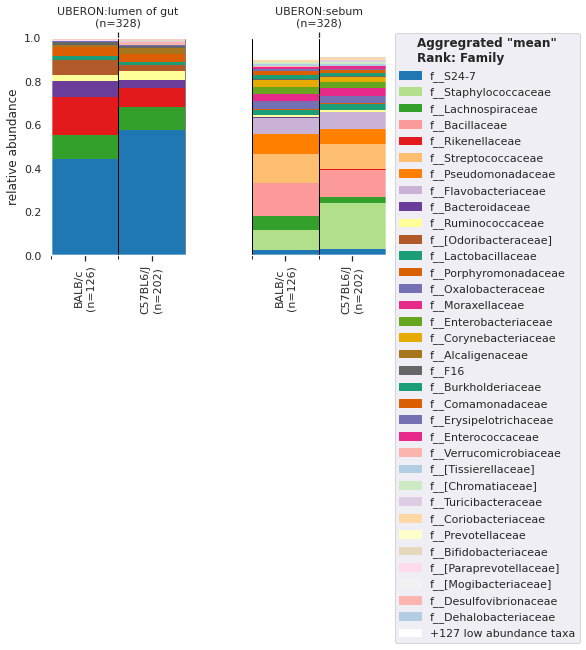

In [156]:
%matplotlib inline
fig, rank_counts, graphinfo, vals, colors = plotTaxonomy("exported-fragment-filtered-feature-table/feature-table.biom", meta[meta['host_body_product'].isin(['UBERON:lumen of gut', 'UBERON:sebum']) & meta['host_scientific_name'].isin(['Mus musculus']) & meta['genotype'].isin(['BALB/c', 'C57BL6/J'])],  file_taxonomy="exported-taxonomy-full/family.tsv", fct_aggregate=np.mean, group_l0="host_body_product",group_l1="genotype", rank="Family", minreadnr=5000)

###### all levels

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


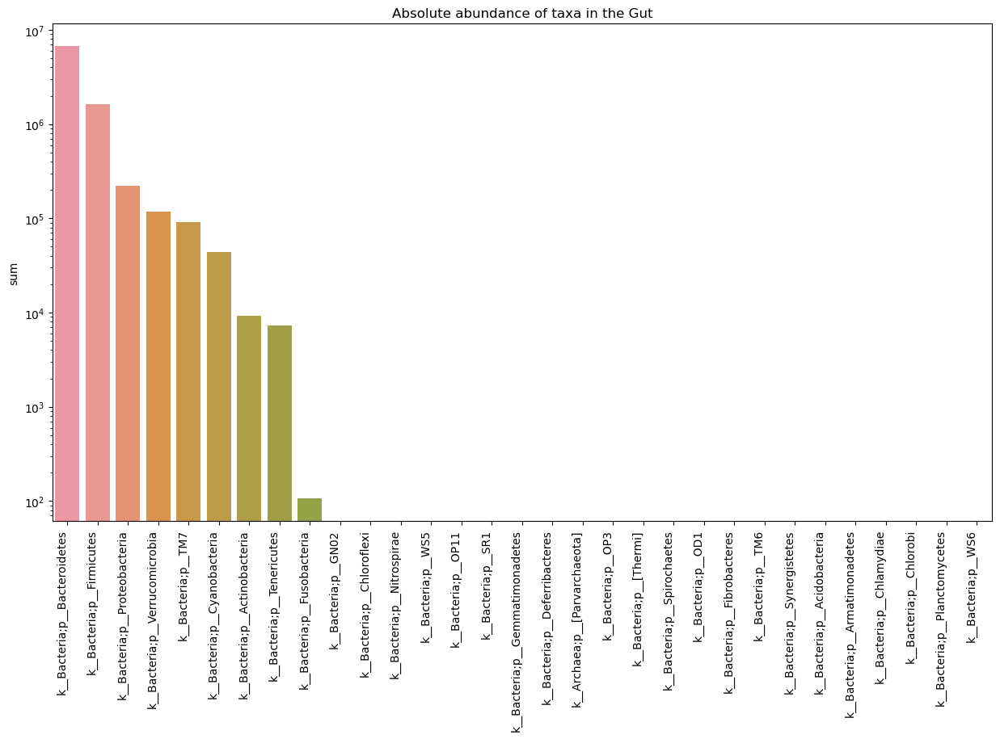

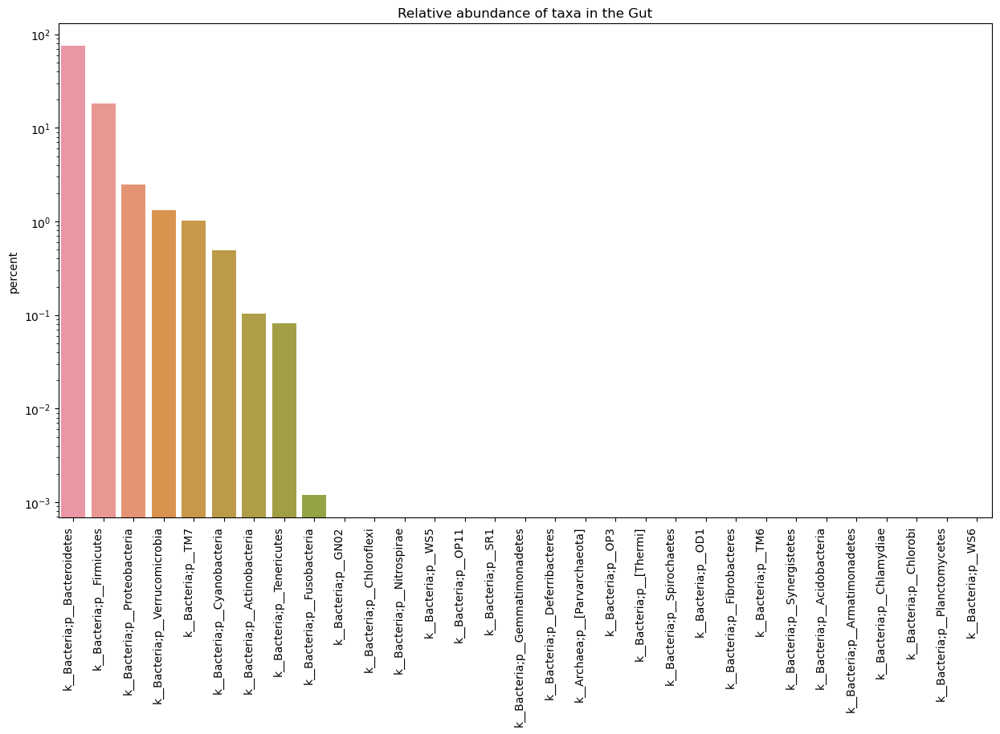

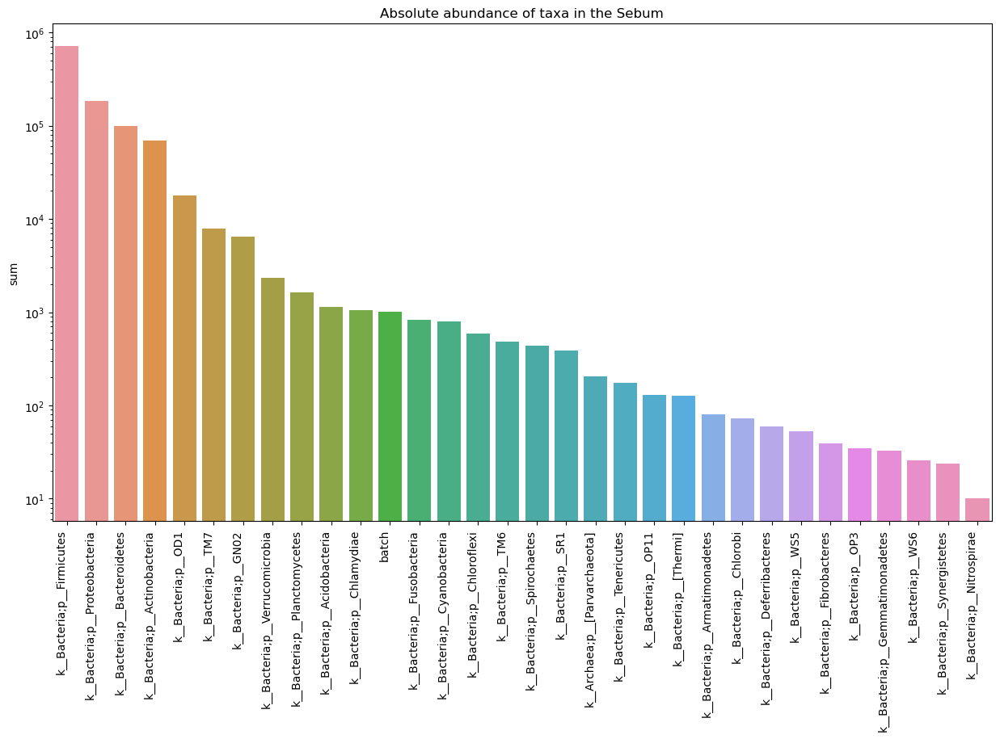

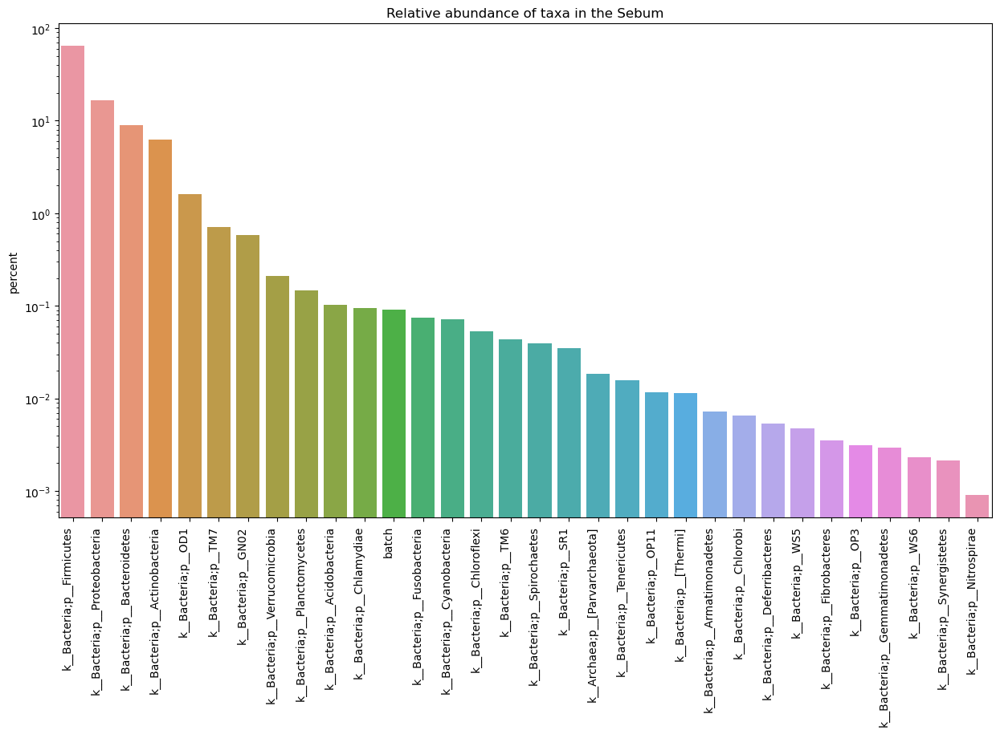

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


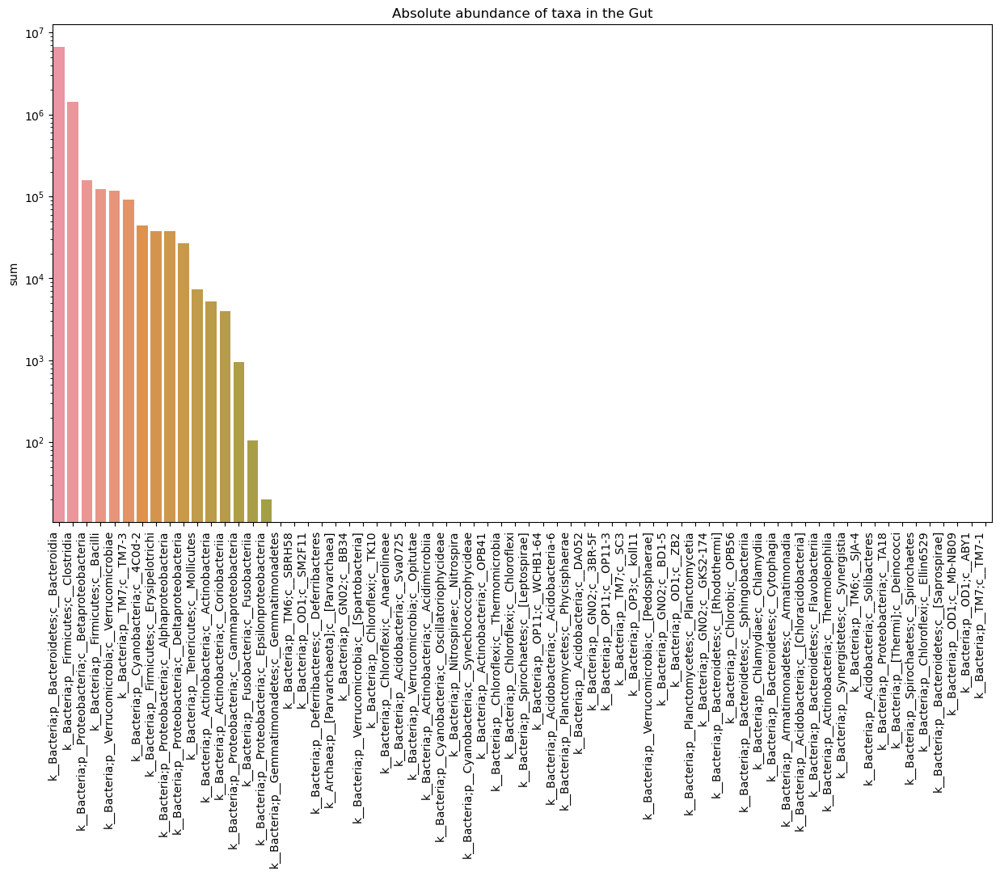

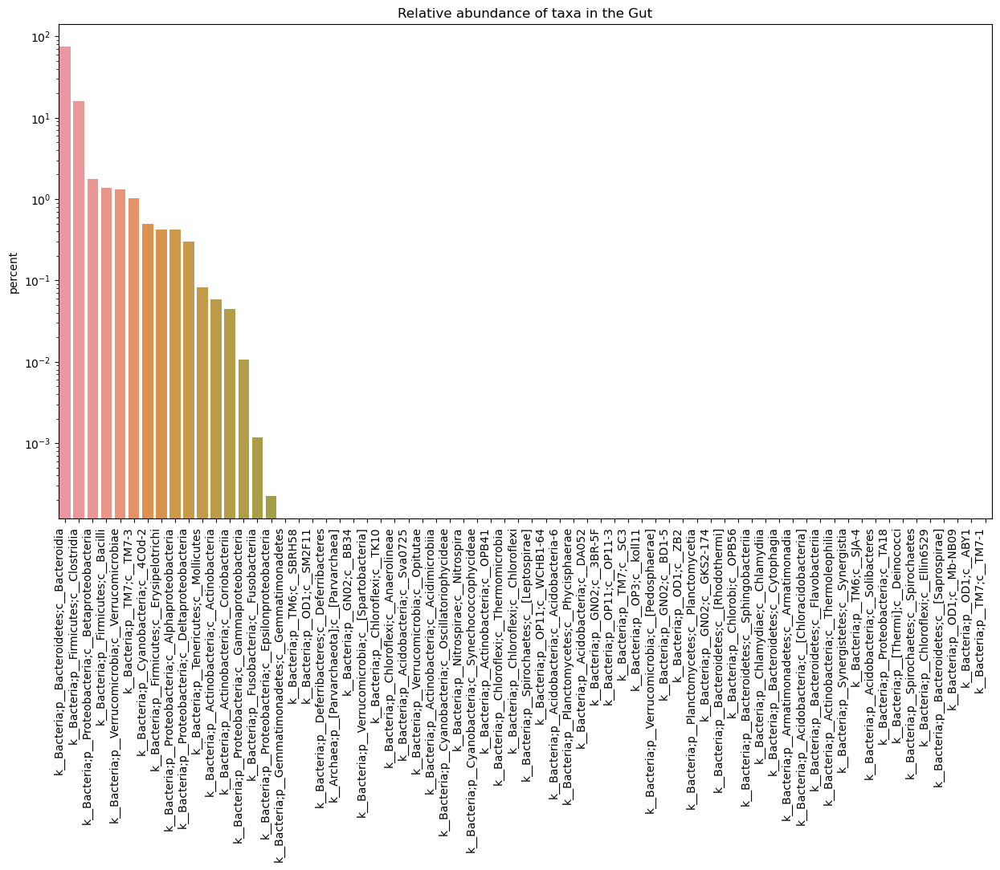

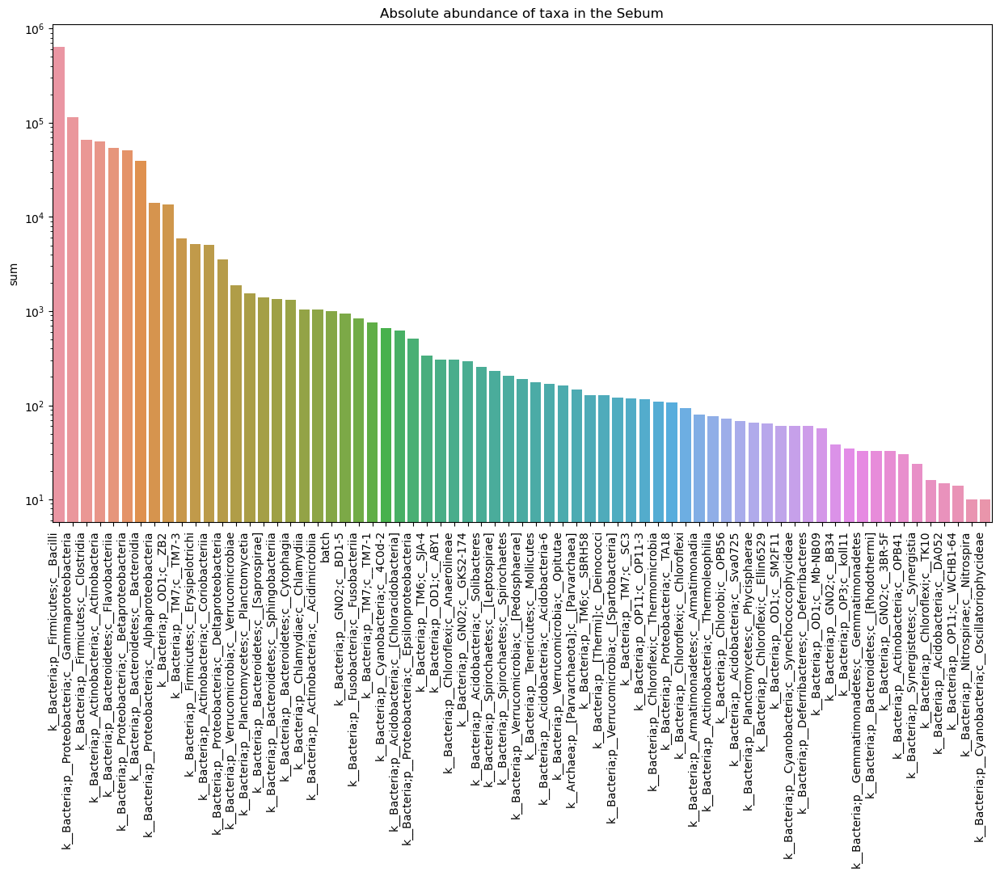

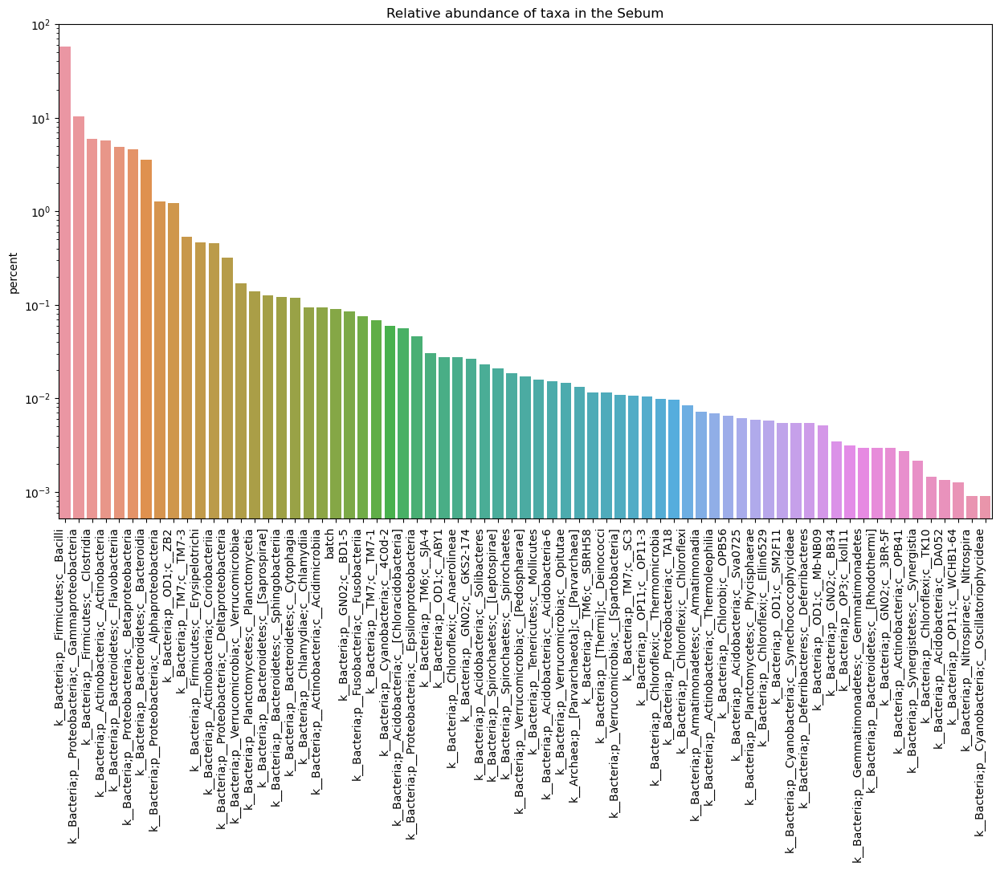

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


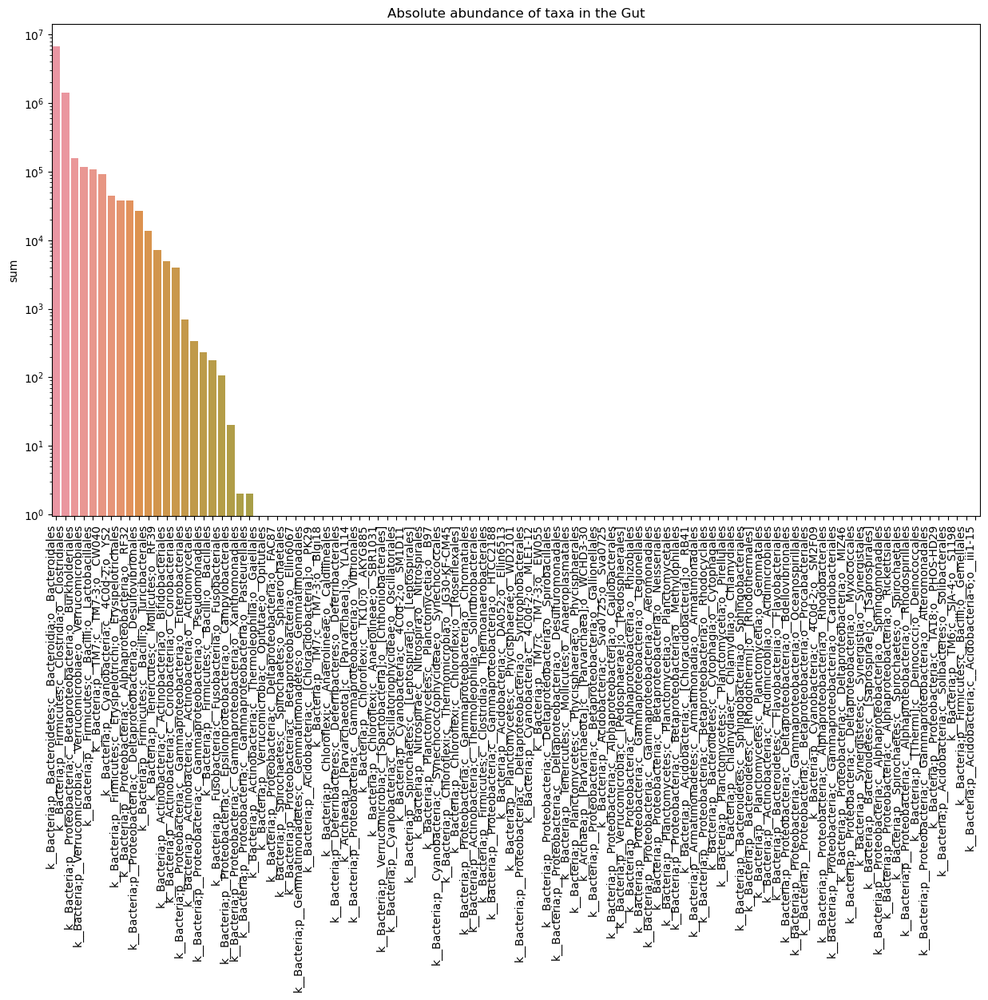

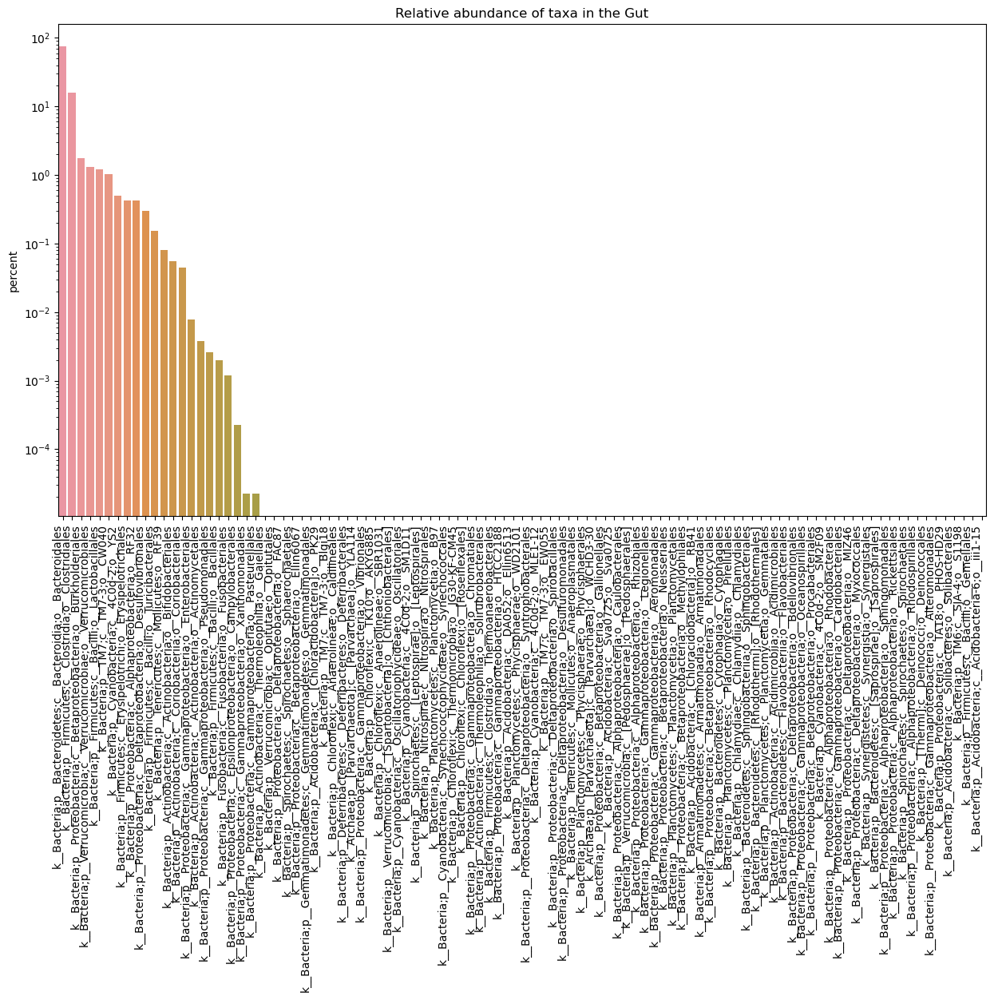

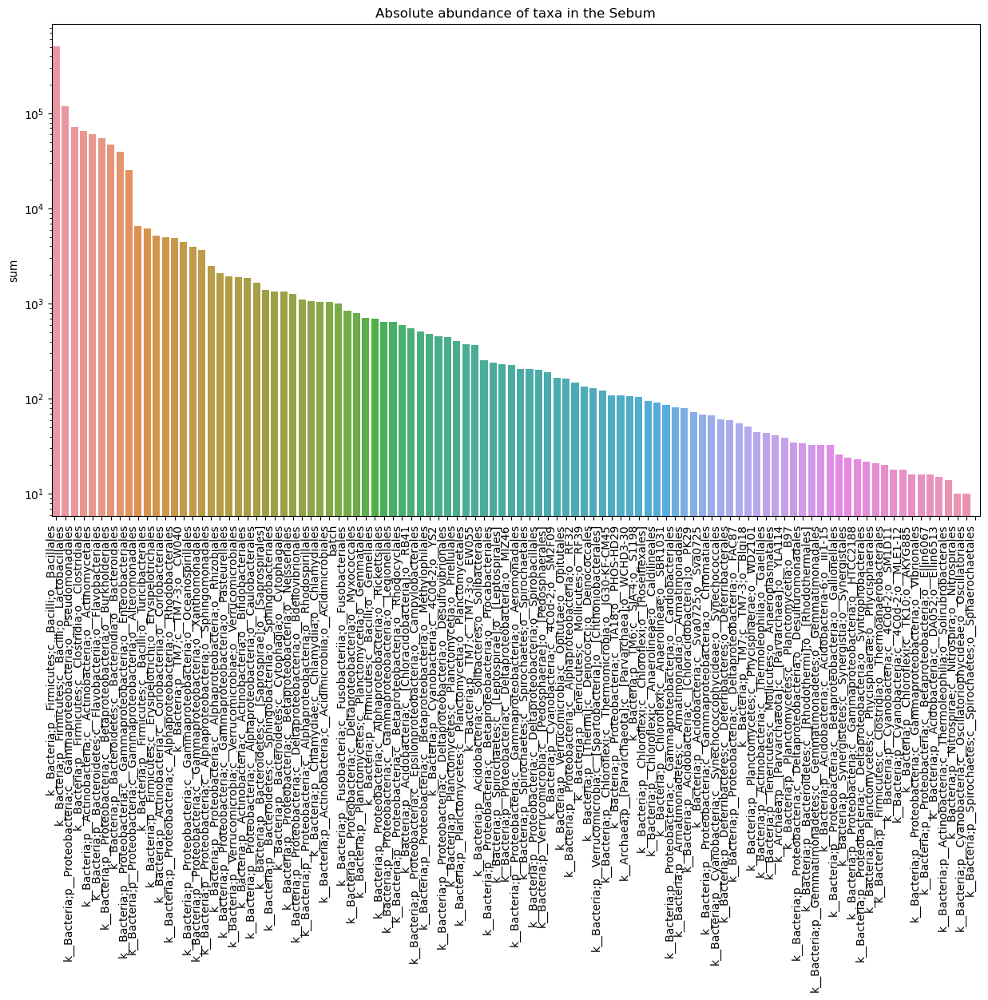

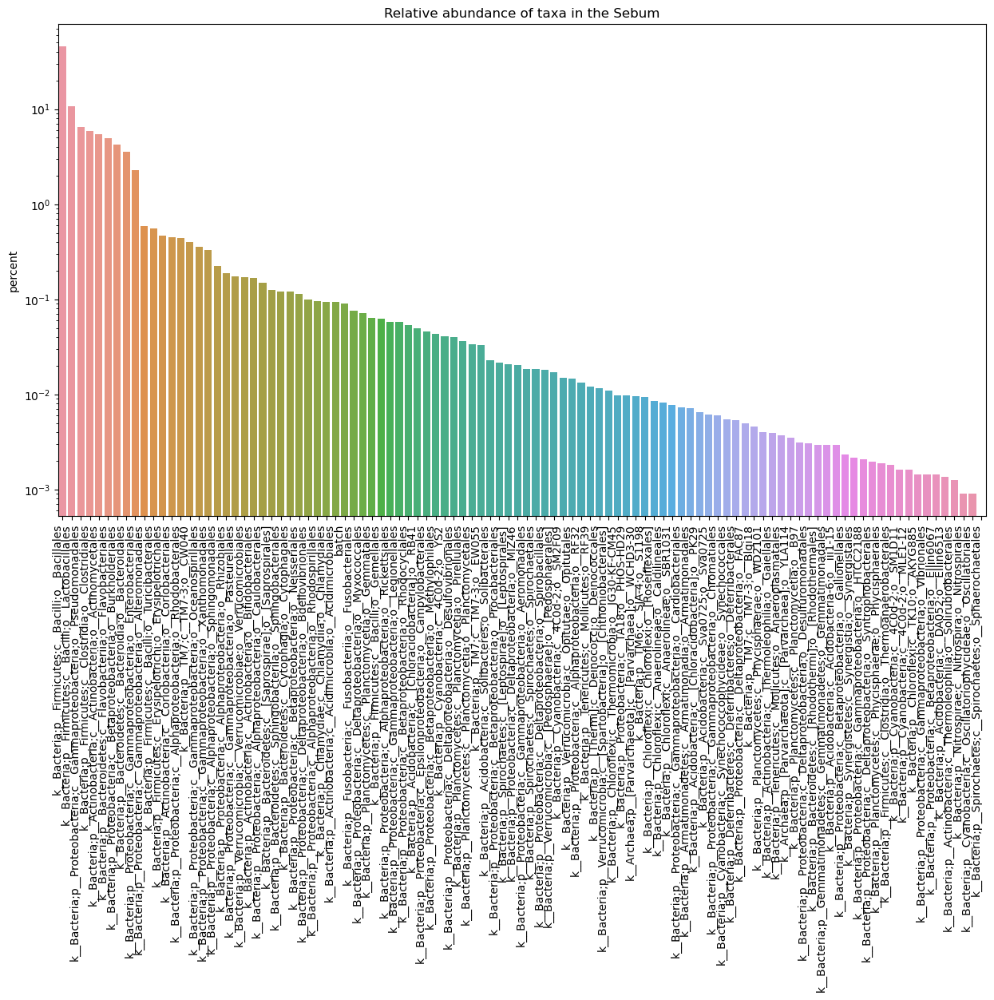

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


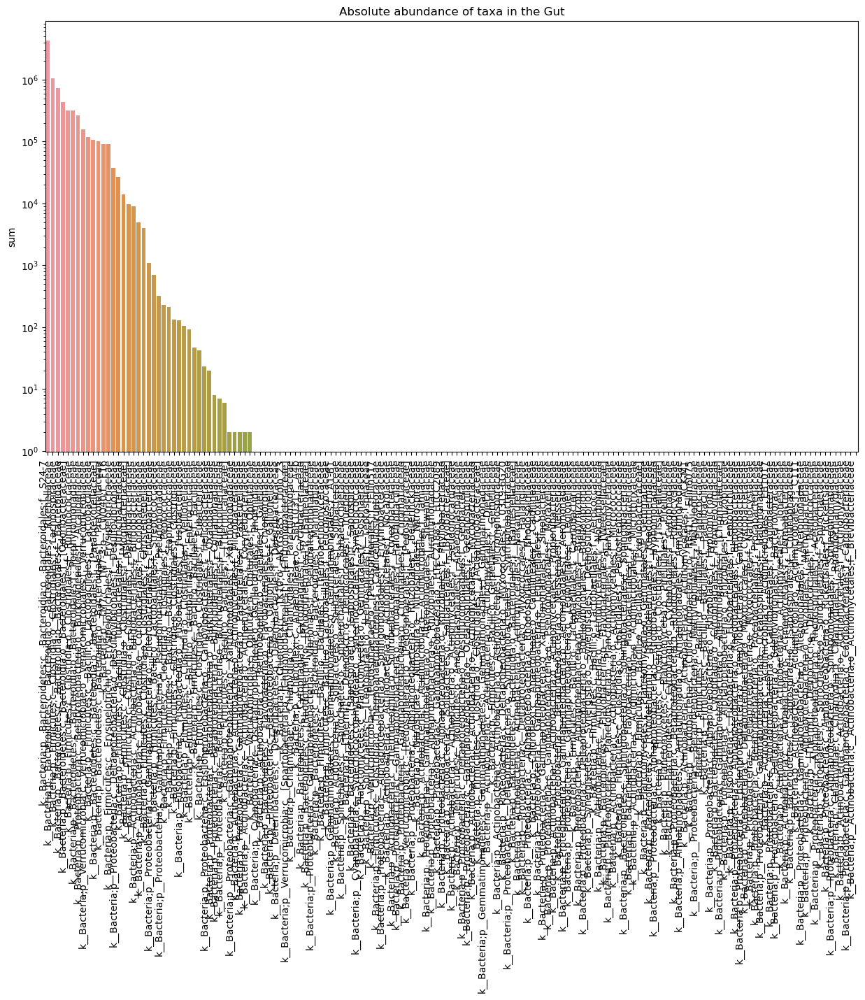

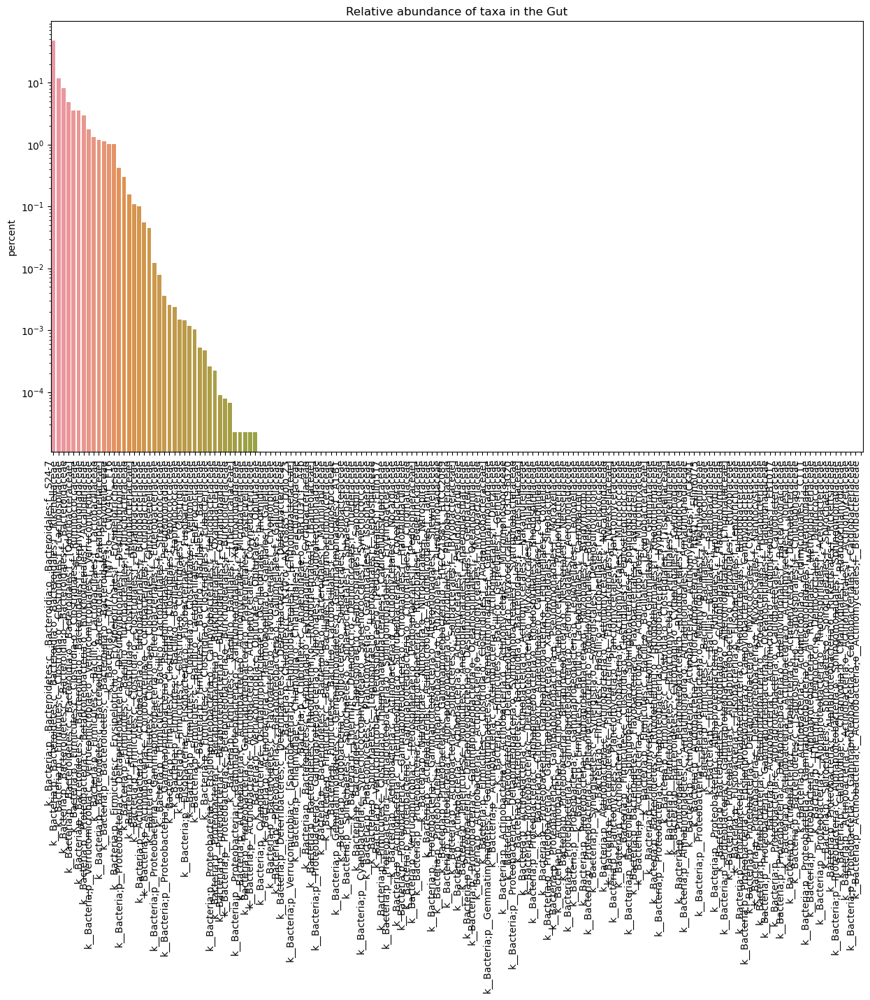

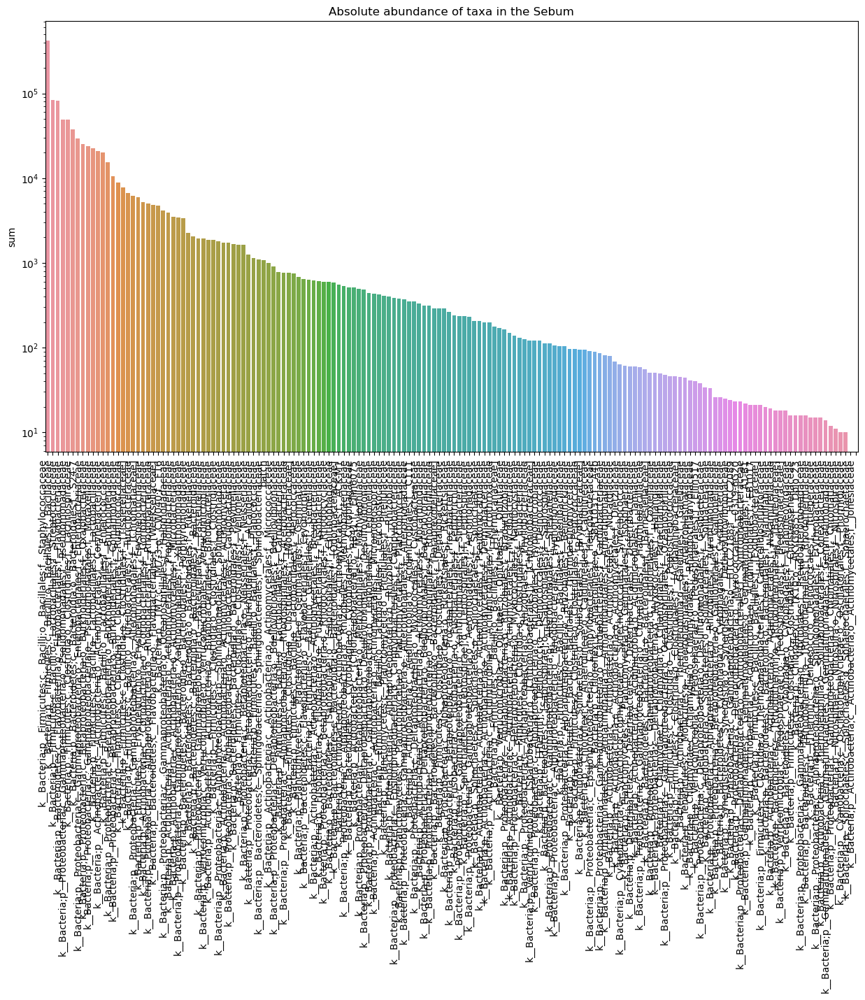

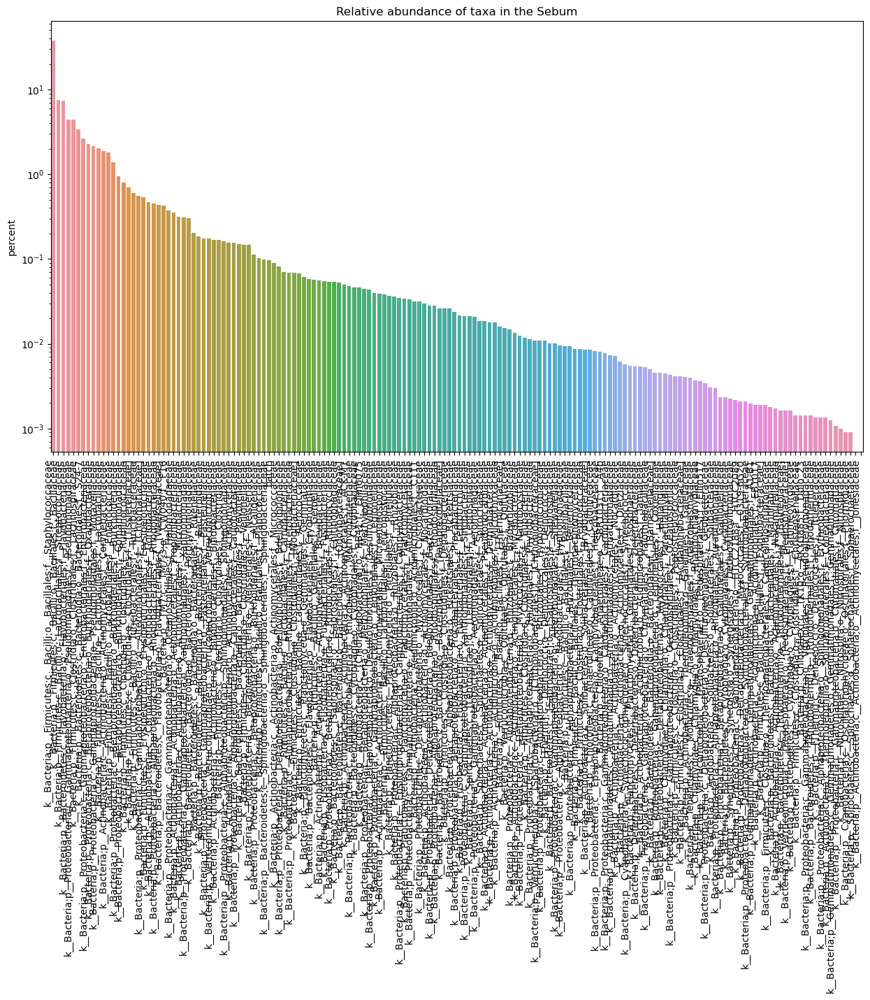

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


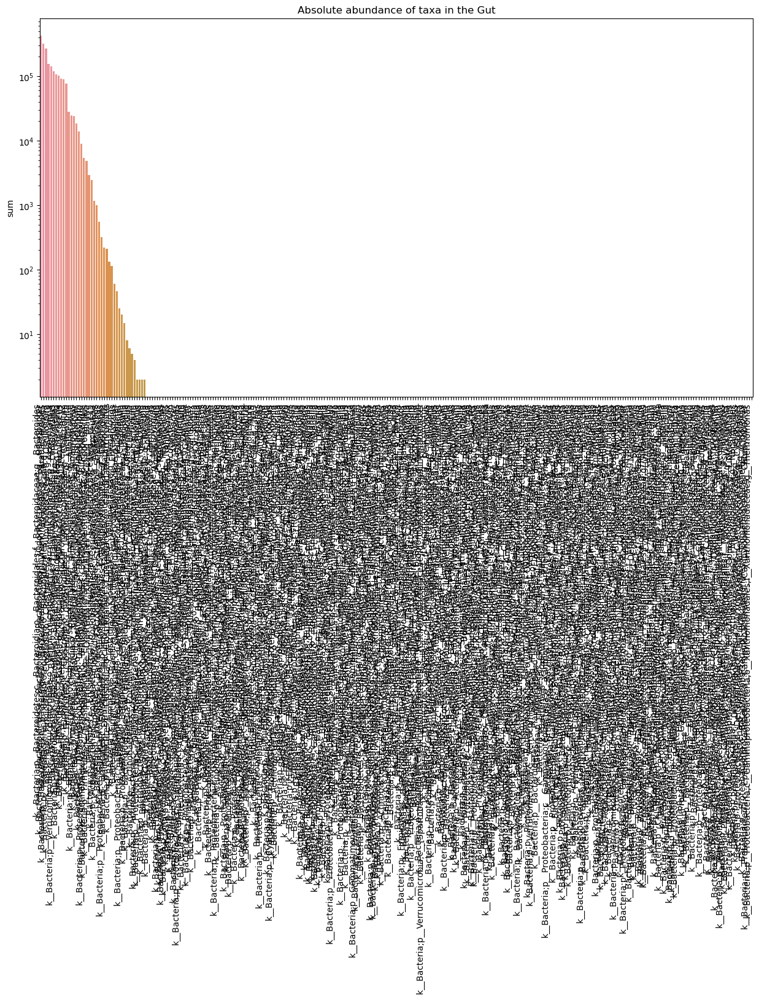

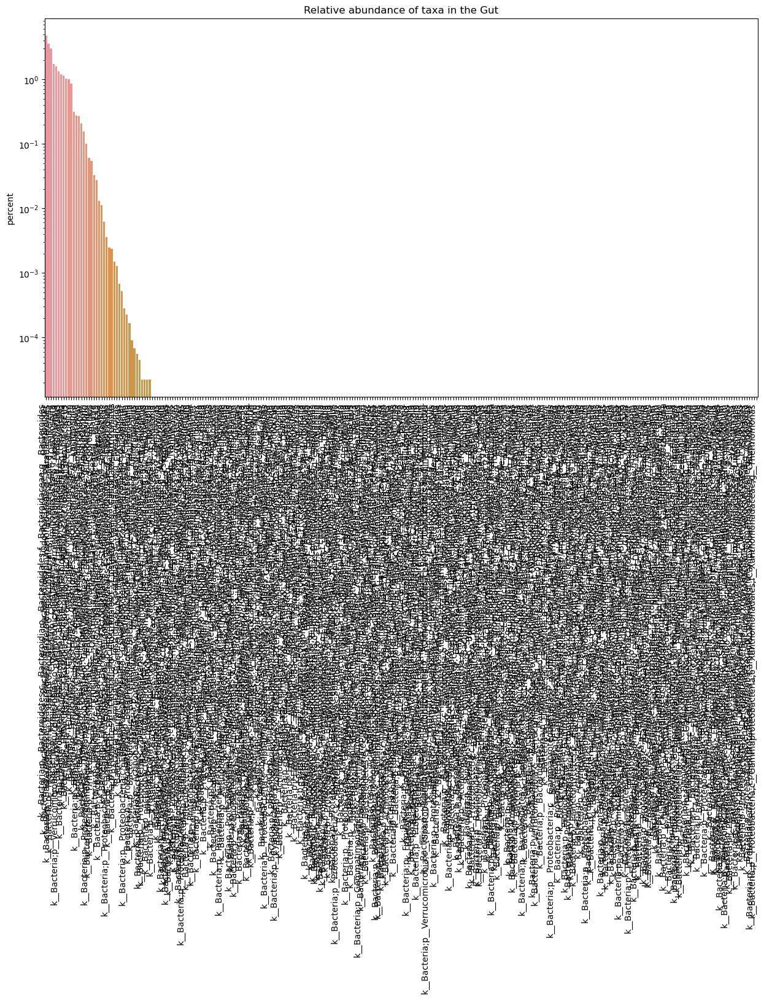

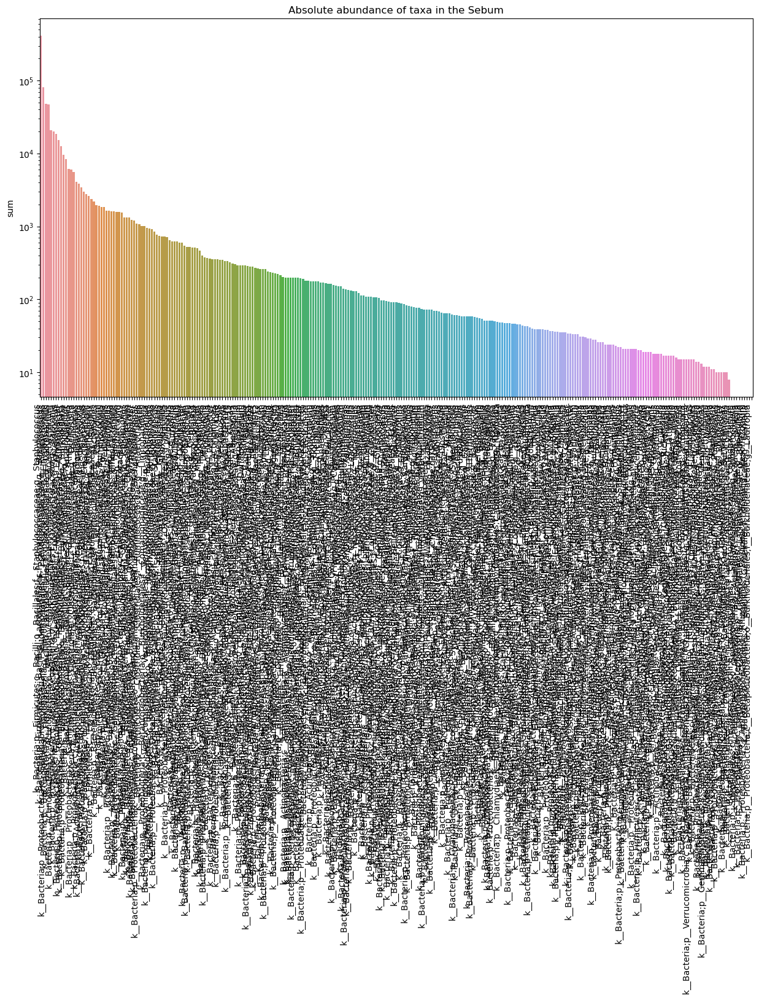

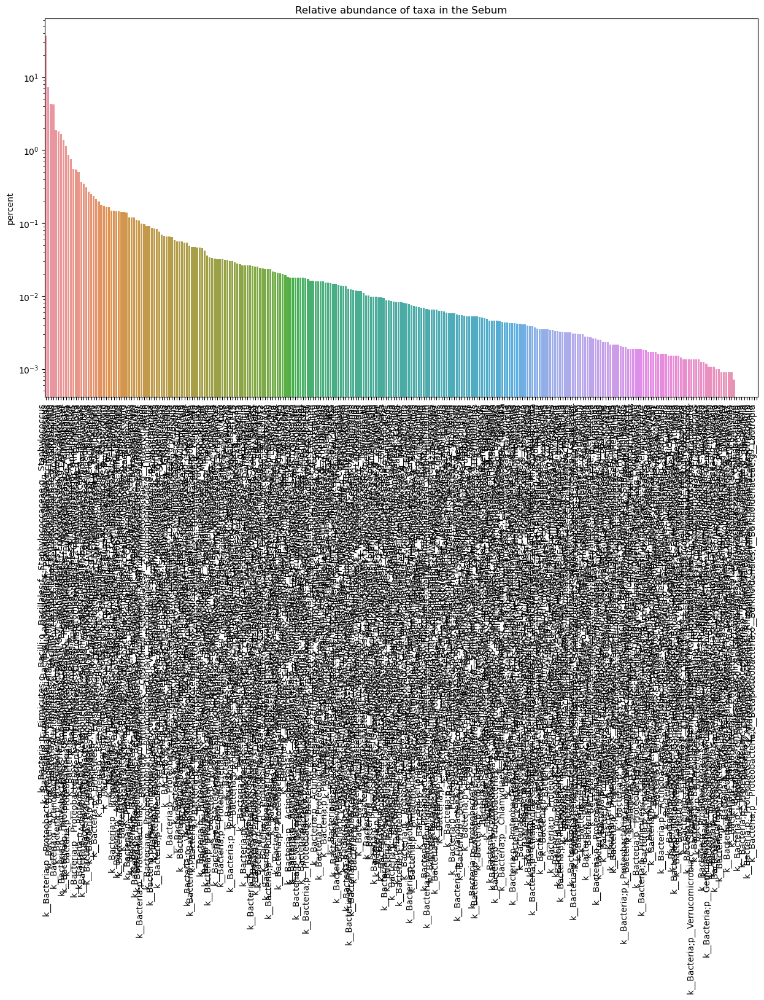

/tmp/ipykernel_2006513/1509955621.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)


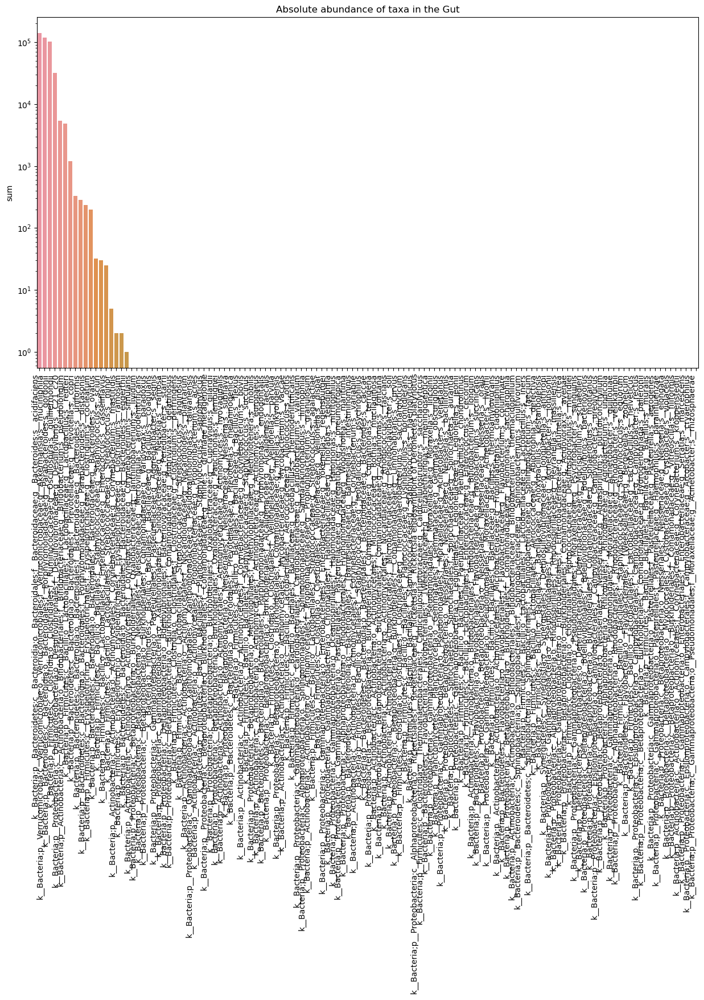

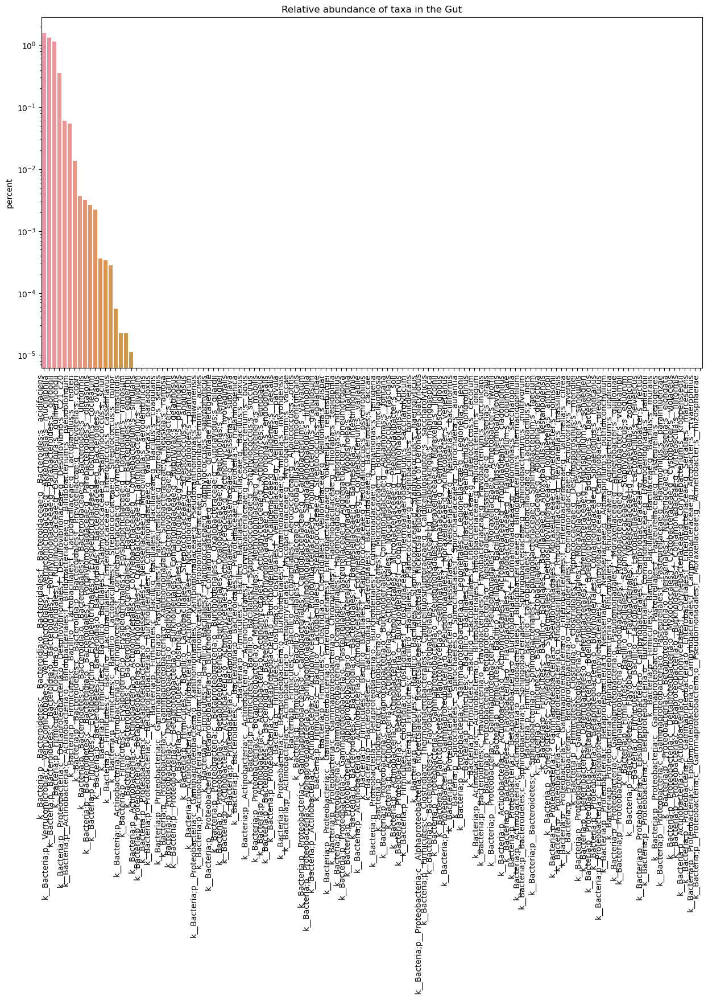

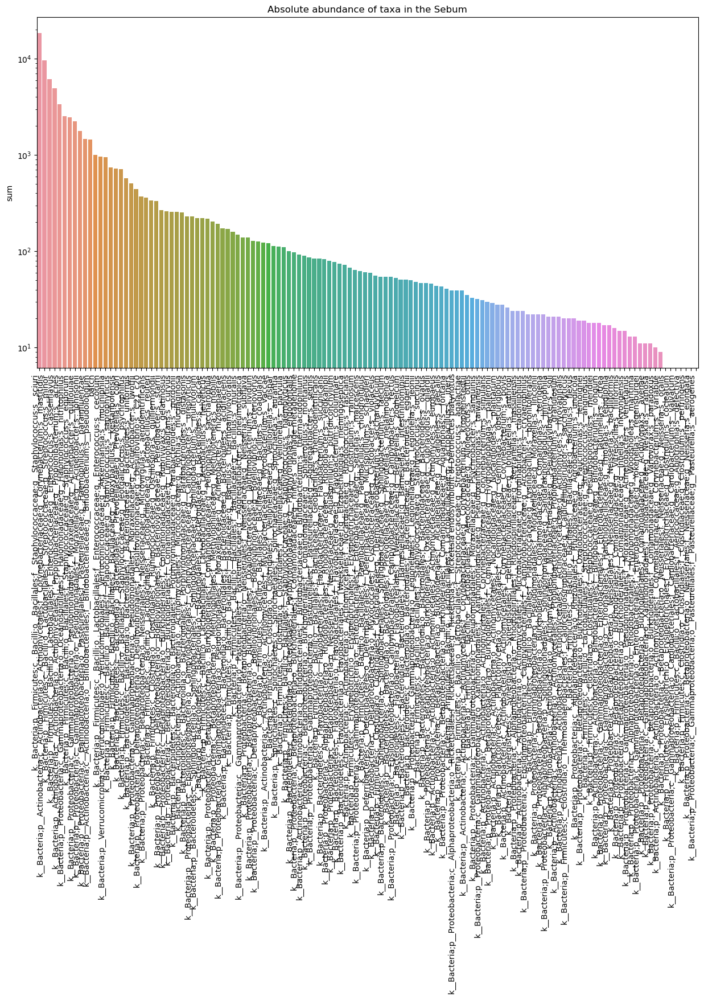

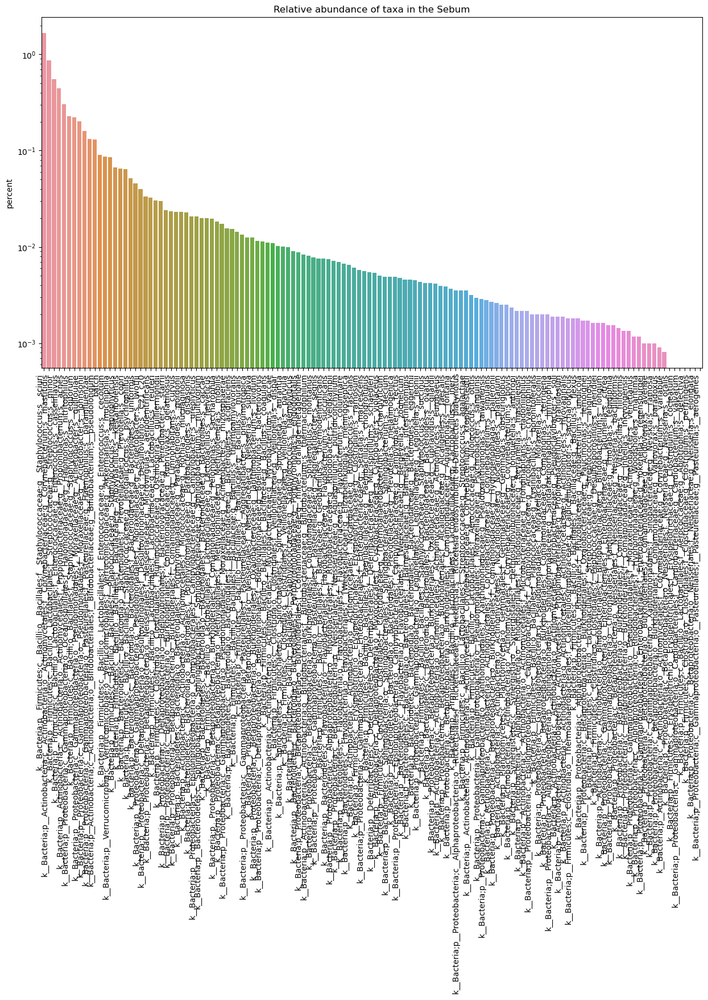

In [130]:
for taxa_level in [taxa_all_l2, taxa_all_l3,taxa_all_l4,taxa_all_l5,taxa_all_l6,taxa_all_l7]:
    taxa_gut = taxa_level[taxa_level['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_level['host_scientific_name'].isin(['Mus musculus'])]
    taxa_sebum = taxa_level[taxa_level['host_body_product'].isin(['UBERON:sebum']) & taxa_level['host_scientific_name'].isin(['Mus musculus'])]
    for i, body_product in enumerate([taxa_gut, taxa_sebum]):
        product = "Gut" if i == 0 else "Sebum"
        taxa_body_sum_all =body_product.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)
        taxa_body_sum_all['percent'] = (taxa_body_sum_all['sum'] / taxa_body_sum_all['sum'].sum())*100
        taxa_body_sum_all = taxa_body_sum_all[~taxa_body_sum_all.index.str.endswith("__")]
        plt.figure(figsize=(15,8))
        ax = sns.barplot(x=taxa_body_sum_all.index, y=taxa_body_sum_all['sum'])
        ax.set(yscale="log", title = f"Absolute abundance of taxa in the {product}")
        plt.xticks(rotation=90, ha="right")
        plt.show()
        plt.figure(figsize=(15,8))
        ax = sns.barplot(x=taxa_body_sum_all.index, y=taxa_body_sum_all['percent'])
        ax.set(yscale = "log", title = f"Relative abundance of taxa in the {product}")
        plt.xticks(rotation=90, ha="right")
        plt.show()

In [ ]:
taxa_l2_gut = taxa_all_l2[taxa_all_l2['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l2['host_scientific_name'].isin(['Mus musculus'])]
taxa_l2_sebum = taxa_all_l2[taxa_all_l2['host_body_product'].isin(['UBERON:sebum']) & taxa_all_l2['host_scientific_name'].isin(['Mus musculus'])]

In [ ]:
taxa_gut_sum_all =taxa_gut.sum(axis=0, skipna=True)[:-58].to_frame(name='sum').sort_values('sum', ascending=False)
taxa_gut_sum_all['percent'] = (taxa_gut_sum_all['sum'] / taxa_gut_sum_all['sum'].sum())*100

##### Sebum

In [27]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table /homes/arehm/Benga_ThreeGen/FromQiita/128106_feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces) AND [host_body_product] IN ('UBERON:sebum') AND [genotype] IN ('C57BL6/J', 'BALB/c')" \
  --o-filtered-table $work_dir/dsFDR_table_sebum.qza

%time ! $q_path; qiime tools export \
  --input-path $work_dir/dsFDR_table_sebum.qza \
  --output-path $work_dir/dsFDR_table_sebum_export

/bin/bash: qiime: command not found
CPU times: user 8.65 ms, sys: 4.71 ms, total: 13.4 ms
Wall time: 186 ms
Exported /homes/arehm/Documents/Thesis/JupyterNotebook/dsFDR_table_sebum.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/dsFDR_table_sebum_export
CPU times: user 316 ms, sys: 41.8 ms, total: 357 ms
Wall time: 13.5 s


## Taxonomy Scatterplots

In [56]:
import seaborn as sns

ModuleNotFoundError: No module named 'seaborn'

In [96]:
v1 = taxa_gut.iloc[1]['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia']
otal_abundance_akkermansia = taxa_gut['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'].sum()
result = v1 / otal_abundance_akkermansia
print(result)

0.014110866852831085


In [4]:
#use level6 table as Akkermansia is a genus
taxa_gut = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]
taxa_gut['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'].astype(float)
total_abundance_akkermansia = taxa_gut['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'].sum()
taxa_gut['relative_abundance'] = taxa_gut['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'] / total_abundance_akkermansia

/tmp/ipykernel_1257448/2412317447.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  taxa_gut['relative_abundance'] = taxa_gut['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'] / total_abundance_akkermansia


In [54]:
%matplotlib inline
taxa_all_l6[taxa_all_l6['comparison'].isin(['1'])]

,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;__;__,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Rhodobacteraceae;g__Paracoccus,k__Bacteria;p__Bacteroidetes;c__Flavobacteriia;o__Flavobacteriales;f__Flavobacteriaceae;g__Flavobacterium,k__Bacteria;p__Firmicutes;__;__;__;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Prevotellaceae;g__Prevotella,k__Bacteria;__;__;__;__;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__Bacillaceae;g__Bacillus,k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Luteolibacter,k__Bacteria;p__Fusobacteria;c__Fusobacteriia;o__Fusobacteriales;f__Fusobacteriaceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__S24-7;g__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Oscillospira,k__Bacteria;p__Actinobacteria;c__Acidimicrobiia;o__Acidimicrobiales;f__Microthrixaceae;g__,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Oxalobacteraceae;g__Polynucleobacter,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Lachnospiraceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__;g__,k__Bacteria;p__GN02;c__BD1-5;o__;f__;g__,k__Bacteria;p__Actinobacteria;c__Coriobacteriia;o__Coriobacteriales;f__Coriobacteriaceae;g__Adlercreutzia,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Oxalobacteraceae;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__[Exiguobacteraceae];g__Exiguobacterium,k__Bacteria;p__OD1;c__ZB2;o__;f__;g__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Lachnospiraceae;g__Blautia,k__Bacteria;p__Planctomycetes;c__Planctomycetia;o__Gemmatales;f__Gemmataceae;g__Gemmata,k__Bacteria;p__GN02;c__GKS2-174;o__;f__;g__,k__Bacteria;p__TM7;c__TM7-3;o__;f__;g__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Prevotellaceae;__,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Actinomycetales;__;__,k__Bacteria;p__Bacteroidetes;c__[Rhodothermi];o__[Rhodothermales];f__Rhodothermaceae;g__Rubricoccus,k__Bacteria;p__Chlorobi;c__OPB56;o__;f__;g__,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;__;__;__,k__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Pseudomonadales;f__Pseudomonadaceae;g__Pseudomonas,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Hyphomonadaceae;__,k__Bacteria;p__Bacteroidetes;c__Sphingobacteriia;o__Sphingobacteriales;f__Sphingobacteriaceae;g__Sphingobacterium,k__Bacteria;p__Chlamydiae;c__Chlamydiia;o__Chlamydiales;__;__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__[Tissierellaceae];g__Gallicola,k__Bacteria;p__Planctomycetes;c__Planctomycetia;o__Pirellulales;f__Pirellulaceae;__,k__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;__;__;__,k__Bacteria;p__Bacteroidetes;c__Cytophagia;o__Cytophagales;f__Cytophagaceae;g__Leadbetterella,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Achromobacter,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Rhodocyclales;f__Rhodocyclaceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Rikenellaceae;g__,k__Bacteria;p__Armatimonadetes;c__Armatimonadia;o__Armatimonadales;f__Armatimonadaceae;g__Armatimonas,k__Bacteria;p__Firmicutes;c__Bacilli;o__Lactobacillales;f__Streptococcaceae;g__Streptococcus,k__Bacteria;p__TM7;c__TM7-3;o__CW040;f__F16;g__,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Actinomycetales;f__ACK-M1;g__,k__Bacteria;p__Tenericutes;c__Mollicutes;o__RF39;f__;g__,k__Bacteria;p__Acidobacteria;c__[Chloracidobacteria];o__RB41;f__Ellin6075;g__,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Methylophilales;f__Methylophilaceae;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__Planococcaceae;g__Planomicrobium,k__Bacteria;p__Firmicutes;c__Bacilli;o__Lac

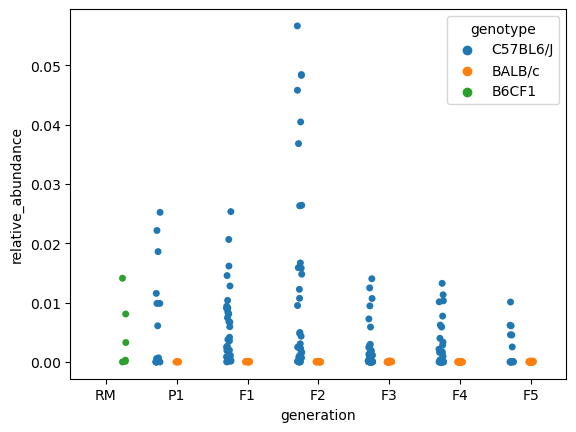

In [6]:
#goal: scatterplot with genotype on x axis and relative abundance of akkermansia on the y axis
%matplotlib inline
ax = sns.stripplot(x= 'generation', y='relative_abundance', data= taxa_gut, hue='genotype', order=['RM','P1', 'F1', 'F2', 'F3', 'F4', 'F5'], hue_order=['C57BL6/J', 'BALB/c', 'B6CF1'],dodge=True)
plt.savefig(work_dir + "/scatter_akkermansia.png", transparent=False, bbox_inches='tight')
plt.show()

In [40]:
taxa_gut_P1 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['P1'])]
taxa_gut_F1 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['F1'])]
taxa_gut_F2 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['F2'])]
taxa_gut_F3 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['F3'])]
taxa_gut_F4 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['F4'])]
taxa_gut_F5 = taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable']) & taxa_all_l6['generation'].isin(['F5'])]

/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


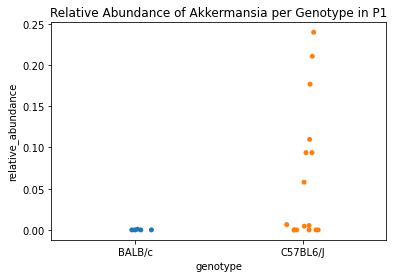

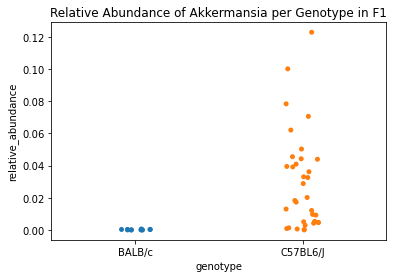

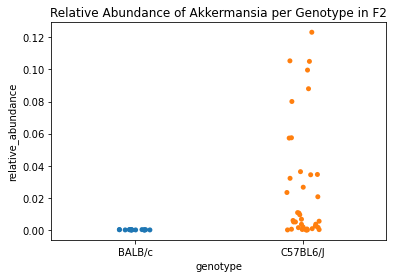

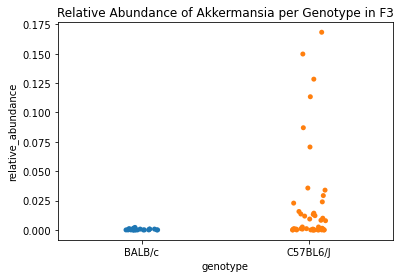

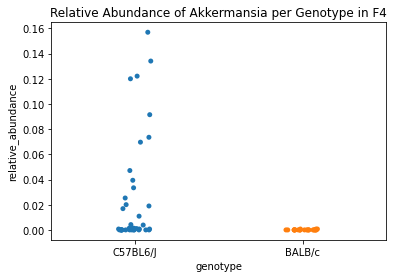

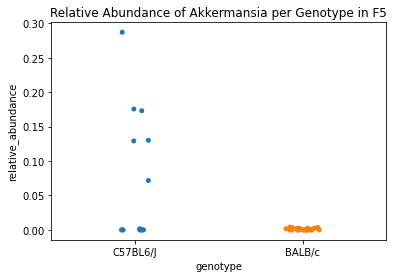

In [112]:
gen_dict={
    '0': 'P1',
    '1': 'F1',
    '2': 'F2',
    '3': 'F3',
    '4': 'F4',
    '5':'F5'
}

for i,generation in enumerate([taxa_gut_P1, taxa_gut_F1, taxa_gut_F2, taxa_gut_F3, taxa_gut_F4, taxa_gut_F5]):
    %matplotlib inline
    gen = gen_dict[str(i)]
    generation['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'].astype(float)
    total_abundance_akkermansia = generation['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'].sum()
    generation['relative_abundance'] = generation['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia'] / total_abundance_akkermansia
    ax = sns.stripplot(x= 'genotype', y='relative_abundance', data= generation).set(title=f'Relative Abundance of Akkermansia per Genotype in {gen}')
    plt.show()

### ANCOM
#### Only mice without comparison mice (GUT)

In [28]:
import matplotlib.pyplot as plt

In [31]:
#ANCOM gut total
%time !$q_path; qiime taxa collapse \
  --i-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-level 7 \
  --o-collapsed-table $work_dir/collapsed-level7-mouse-gut-table-nocomp.qza
%time !$q_path; qiime composition add-pseudocount \
  --i-table $work_dir/collapsed-level7-mouse-gut-table-nocompRM.qza \
  --o-composition-table $work_dir/composition-table-mouse-gut-l7-nocompRM.qza
%time !$q_path; qiime composition ancom \
  --i-table $work_dir/composition-table-mouse-gut-l7-nocompRM.qza \
  --m-metadata-file $meta_file \
  --m-metadata-column genotype \
  --o-visualization $work_dir/ancom-genotype-mouse-gut-l7-nocompRM.qzv

^C

Aborted!
CPU times: user 201 ms, sys: 39.7 ms, total: 240 ms
Wall time: 9.12 s
^C

Aborted!
CPU times: user 97.8 ms, sys: 43.1 ms, total: 141 ms
Wall time: 5.43 s
^C

Aborted!
CPU times: user 28.4 ms, sys: 4.71 ms, total: 33.2 ms
Wall time: 938 ms


In [ ]:
#ANCOM for specific generations
%time !$q_path; qiime taxa collapse \
  --i-table $work_dir/mouse-table-gut6000-nocompRM_F1.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-level 7 \
  --o-collapsed-table $work_dir/collapsed-level7-mouse-gut-table-nocompRM_F1.qza
%time !$q_path; qiime composition add-pseudocount \
  --i-table $work_dir/collapsed-level7-mouse-gut-table-nocompRM_F1.qza \
  --o-composition-table $work_dir/composition-table-mouse-gut-l7-nocompRM_F1.qza
%time !$q_path; qiime composition ancom \
  --i-table $work_dir/composition-table-mouse-gut-l7-nocompRM_F1.qza \
  --m-metadata-file $meta_file \
  --m-metadata-column genotype \
  --o-visualization $work_dir/ancom-genotype-mouse-gut-l7-nocompRM_F1.qzv

In [30]:
!unzip $work_dir/composition-table-mouse-gut-l7-nocompRM_F1.qza

Archive:  /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-gut-l7-nocompRM_F1.qza
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/metadata.yaml  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/checksums.md5  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/VERSION  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/data/feature-table.biom  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/metadata.yaml  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/citations.bib  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/VERSION  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/artifacts/b9e463aa-2442-41f6-a9aa-b1fc25935a85/metadata.yaml  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/artifacts/b9e463aa-2442-41f6-a9aa-b1fc25935a85/citations.bib  
  inflating: 4bab5dd9-261b-4028-b668-665e72b28356/provenance/artifacts/b9e463aa-2442-41f6-a9aa-b1fc25935a85/VERSION  
  inflating: 4bab5dd9-261b-4028-b668-6

In [86]:
! $q_path; biom convert \
  --input-fp 0847fa0f-7390-4411-a385-ffd3996c3c15/data/feature-table.biom       \
  --to-tsv \
  --output-fp $work_dir/ancom-biom-table-gut6-F1 

In [37]:
ancom_biom_table_gut = pd.read_csv(work_dir+"/ancom-biom-table-gut6-F1", 
            sep="\t",skiprows=1, index_col=0)
ancom_biom_table_gut.sum()

13422.29    6053.0
13422.32    6053.0
13422.34    6053.0
13422.28    6053.0
13422.30    6053.0
13422.35    6053.0
13422.31    6053.0
13422.38    6053.0
13422.33    6053.0
13422.42    6053.0
13422.51    6053.0
13422.36    6053.0
13422.43    6053.0
13422.60    6053.0
13422.52    6053.0
13422.37    6053.0
13422.61    6053.0
13422.44    6053.0
13422.53    6053.0
13422.70    6053.0
13422.62    6053.0
13422.54    6053.0
13422.45    6053.0
13422.39    6053.0
13422.71    6053.0
13422.63    6053.0
13422.55    6053.0
13422.46    6053.0
13422.40    6053.0
13422.72    6053.0
13422.64    6053.0
13422.56    6053.0
13422.41    6053.0
13422.47    6053.0
13422.65    6053.0
13422.57    6053.0
13422.48    6053.0
13422.66    6053.0
13422.58    6053.0
13422.49    6053.0
13422.67    6053.0
13422.59    6053.0
13422.50    6053.0
13422.68    6053.0
13422.69    6053.0
dtype: float64

/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "set_facecolor" which is no lon

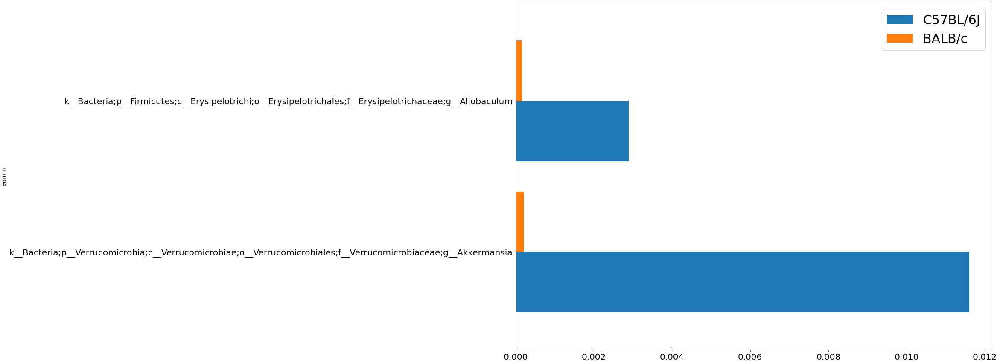

In [38]:
relative_abundance_gut= ancom_biom_table_gut.div(6053)
list_C57B = meta[meta['genotype'].isin(['C57BL6/J'])].index
list_BALB = meta[meta['genotype'].isin(['BALB/c'])].index

ancom_C57B_gut=relative_abundance_gut[[col for col in relative_abundance_gut.columns if col in list_C57B]]
ancom_C57B_gut["average"]=ancom_C57B_gut.mean(axis=1)

ancom_BALB_gut = relative_abundance_gut[[col for col in relative_abundance_gut.columns if col in list_BALB]]
ancom_BALB_gut["average"] = ancom_BALB_gut.mean(axis=1)

%matplotlib inline
#ancom_taxa_gut_F1 = ['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia;s__muciniphila']
#ancom_taxa_gut_F2=['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia;s__muciniphila']
#ancom_taxa_gut_F3=['k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens']
#ancom_taxa_gut_F4 = ['k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens', 'k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium;s__pseudolongum']
#ancom_taxa_gut_F5=['k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens']
#ancom_taxa_gut_F5-6=['k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum']
#ancom_taxa_gut_F4-6 = ['k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides', 'k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__[Odoribacteraceae];g__Odoribacter', 'k__Bacteria;p__Firmicutes;c__Bacilli;o__Turicibacterales;f__Turicibacteraceae;g__Turicibacter', 'k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Sutterella', 'k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus']
#ancom_taxa_gut_F3-6 = ['k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__[Odoribacteraceae];g__Odoribacter', 'k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Sutterella', 'k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides']
#ancom_taxa_gut_F2-6 = ['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__[Odoribacteraceae];g__Odoribacter', 'k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus', 'k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Sutterella', 'k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum']
ancom_taxa_gut = ['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia', 'k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum']
taxa_C57B_gut = ancom_C57B_gut[ancom_C57B_gut.index.isin(ancom_taxa_gut)]
taxa_BALB_gut = ancom_BALB_gut[ancom_BALB_gut.index.isin(ancom_taxa_gut)]

ancom_plot = pd.DataFrame({'C57BL6/J': taxa_C57B_gut['average'],
                           'BALB/c': taxa_BALB_gut['average']},
                         index=taxa_C57B_gut.index)
ancom_taxa_plot = ancom_plot.plot.barh(figsize=(20,15), width =0.8, fontsize=20).legend(loc=1, prop={'size':30})
plt.legend(labels=["C57BL/6J","BALB/c"], fontsize=30)
ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot_gut6_F1.png', set_facecolor='white', bbox_inches='tight', facecolor='white')

In [32]:
%time !$q_path; qiime feature-table filter-samples \
  --i-table $work_dir/gut6000-mouse-filtered-table-nocomp.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [genotype] NOT IN ('B6CF1')" \
  --o-filtered-table $work_dir/mouse-table-gut6000-nocompRM.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-table-gut6000-nocompRM.qza
CPU times: user 390 ms, sys: 69.5 ms, total: 459 ms
Wall time: 17.7 s


In [71]:
%time !$q_path; qiime taxa collapse \
  --i-table $work_dir/mouse-table-gut6000-nocompRM.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-level 6 \
  --o-collapsed-table $work_dir/collapsed-level6-mouse-gut-table-nocompRM.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/collapsed-level6-mouse-gut-table-nocompRM.qza
CPU times: user 627 ms, sys: 124 ms, total: 750 ms
Wall time: 33.5 s


In [72]:
%time !$q_path; qiime composition add-pseudocount \
  --i-table $work_dir/collapsed-level6-mouse-gut-table-nocompRM.qza \
  --o-composition-table $work_dir/composition-table-mouse-gut-l6-nocompRM.qza

Saved FeatureTable[Composition] to: /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-gut-l6-nocompRM.qza
CPU times: user 555 ms, sys: 107 ms, total: 662 ms
Wall time: 27.7 s


In [73]:
%time !$q_path; qiime composition ancom \
  --i-table $work_dir/composition-table-mouse-gut-l6-nocompRM.qza \
  --m-metadata-file meta_gen_num.txt \
  --m-metadata-column genotype \
  --o-visualization $work_dir/ancom-genotype-mouse-gut-l6-nocompRM.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/ancom-genotype-mouse-gut-l6-nocompRM.qzv
CPU times: user 560 ms, sys: 131 ms, total: 691 ms
Wall time: 31.2 s


In [74]:
!unzip $work_dir/composition-table-mouse-gut-l6-nocompRM.qza

Archive:  /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-gut-l6-nocompRM.qza
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/VERSION  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/checksums.md5  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/metadata.yaml  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/data/feature-table.biom  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/citations.bib  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/VERSION  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/metadata.yaml  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/action/action.yaml  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/artifacts/2ac8d9c9-b2fa-48fa-ae5a-b21134de3268/citations.bib  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/artifacts/2ac8d9c9-b2fa-48fa-ae5a-b21134de3268/VERSION  
  inflating: d3386047-2e2a-466d-92a1-107610ae2a54/provenance/artifacts/2ac8d9c9-b2f

In [75]:
! $q_path; biom convert \
  --input-fp d3386047-2e2a-466d-92a1-107610ae2a54/data/feature-table.biom       \
  --to-tsv \
  --output-fp $work_dir/ancom-biom-table-gut-l6 

In [76]:
!$q_path; biom summarize-table -i d3386047-2e2a-466d-92a1-107610ae2a54/data/feature-table.biom  

Num samples: 303
Num observations: 70
Total count: 1,839,210
Table density (fraction of non-zero values): 1.000

Counts/sample summary:
 Min: 6,070.000
 Max: 6,070.000
 Median: 6,070.000
 Mean: 6,070.000
 Std. dev.: 0.000
 Sample Metadata Categories: None provided
 Observation Metadata Categories: None provided

Counts/sample detail:
13422.181: 6,070.000
13422.118: 6,070.000
13422.127: 6,070.000
13422.172: 6,070.000
13422.136: 6,070.000
13422.154: 6,070.000
13422.145: 6,070.000
13422.109: 6,070.000
13422.163: 6,070.000
13422.10: 6,070.000
13422.173: 6,070.000
13422.100: 6,070.000
13422.146: 6,070.000
13422.119: 6,070.000
13422.182: 6,070.000
13422.155: 6,070.000
13422.128: 6,070.000
13422.164: 6,070.000
13422.137: 6,070.000
13422.11: 6,070.000
13422.147: 6,070.000
13422.174: 6,070.000
13422.129: 6,070.000
13422.165: 6,070.000
13422.101: 6,070.000
13422.138: 6,070.000
13422.156: 6,070.000
13422.110: 6,070.000
13422.183: 6,070.000
13422.102: 6,070.000
13422.148: 6,070.000
13422.12: 6,070

In [77]:
ancom_biom_table_gut_l6 = pd.read_csv(work_dir+"/ancom-biom-table-gut-l6", 
            sep="\t",skiprows=1, index_col=0)

In [ ]:
    k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum
    k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides
k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__[Odoribacteraceae];g__Odoribacter
    k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia
    k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Sutterella
    k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus
    k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium
    k__Bacteria;p__Firmicutes;c__Bacilli;o__Turicibacterales;f__Turicibacteraceae;g__Turicibacter
    k__Bacteria;p__Proteobacteria;c__Deltaproteobacteria;o__Desulfovibrionales;f__Desulfovibrionaceae;g__Desulfovibrio

In [88]:
%matplotlib inline

relative_abundance_gut= ancom_biom_table_gut.div(6081)
list_C57B = meta[meta['genotype'].isin(['C57BL6/J'])].index
list_BALB = meta[meta['genotype'].isin(['BALB/c'])].index

ancom_C57B_gut = relative_abundance_gut[[col for col in relative_abundance_gut.columns if col in list_C57B]]
ancom_C57B_gut["average"]=ancom_C57B_gut.mean(axis=1)

ancom_BALB_gut = relative_abundance_gut[[col for col in relative_abundance_gut.columns if col in list_BALB]]
ancom_BALB_gut["average"] = ancom_BALB_gut.mean(axis=1)



ancom_taxa_gut = ['k__Bacteria;p__Proteobacteria;c__Deltaproteobacteria;o__Desulfovibrionales;f__Desulfovibrionaceae;g__Desulfovibrio;s__C21_c20','k__Bacteria;p__Firmicutes;c__Bacilli;o__Lactobacillales;f__Lactobacillaceae;g__Lactobacillus;s__reuteri','k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium;s__pseudolongum','k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Porphyromonadaceae;g__Parabacteroides;s__gordonii','k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens','k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia;s__muciniphila']
ancom_taxa_gut_l6 = ['k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium','k__Bacteria;p__Proteobacteria;c__Deltaproteobacteria;o__Desulfovibrionales;f__Desulfovibrionaceae;g__Desulfovibrio', 'k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum', 'k__Bacteria;p__Firmicutes;c__Bacilli;o__Turicibacterales;f__Turicibacteraceae;g__Turicibacter', 'k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia', 'k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Sutterella', 'k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides', 'k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__[Odoribacteraceae];g__Odoribacter']

taxa_C57B_gut = ancom_C57B_gut[ancom_C57B_gut.index.isin(ancom_taxa_gut)]
taxa_BALB_gut = ancom_BALB_gut[ancom_BALB_gut.index.isin(ancom_taxa_gut)]

ancom_plot = pd.DataFrame({'C57BL6/J': taxa_C57B_gut['average'],
                           'BALB/c': taxa_BALB_gut['average']},
                         index=taxa_C57B_gut.index)

/tmp/ipykernel_967230/468320902.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ancom_C57B_gut["average"]=ancom_C57B_gut.mean(axis=1)
/tmp/ipykernel_967230/468320902.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ancom_BALB_gut["average"] = ancom_BALB_gut.mean(axis=1)


prepare lists wit indeces 

/tmp/ipykernel_967230/2022786303.py:5: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "set_facecolor" which is no longer supported as of 3.3 and will become an error in 3.6
  ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot_gut_species.svg', set_facecolor='white', bbox_inches='tight')


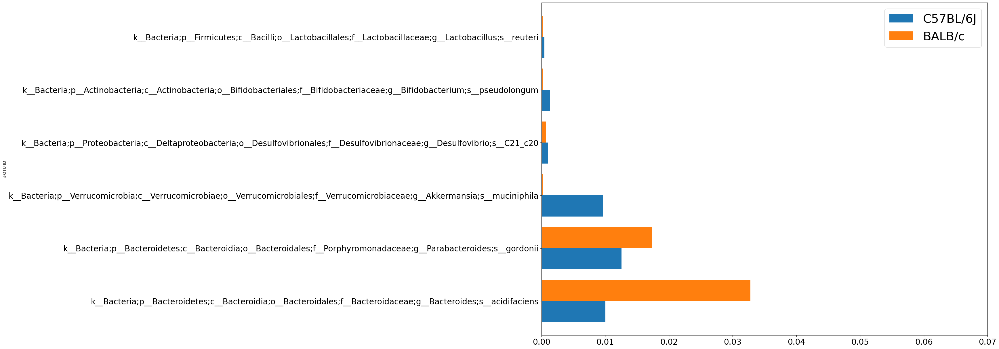

In [89]:
import matplotlib.pyplot as plt
ancom_taxa_plot = ancom_plot.plot.barh(figsize=(20,15), width =0.8, fontsize=20).legend(loc=1, prop={'size':30})
plt.legend(labels=["C57BL/6J","BALB/c"], fontsize=30)
plt.xlim(right=0.07)
ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot_gut_species.svg', set_facecolor='white', bbox_inches='tight')

#### Only Mice without comparison mice (sebum)

In [62]:
%time !$q_path; qiime feature-table filter-samples \
  --i-table $work_dir/sebum-mouse-filtered-table-nocomp.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [genotype] NOT IN ('B6CF1')" \
  --o-filtered-table $work_dir/mouse-table-sebum-nocompRM.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-table-sebum-nocompRM.qza
CPU times: user 295 ms, sys: 61.3 ms, total: 356 ms
Wall time: 13.8 s


In [46]:
%time !$q_path; qiime feature-table filter-samples \
  --i-table $work_dir/mouse-table-sebum-nocompRM.qza \
  --m-metadata-file $meta_file \
  --p-where "[host_common_name] IN ('mouse') AND [genotype] NOT IN ('B6CF1') AND [generation] IN ('F5')" \
  --o-filtered-table $work_dir/mouse-table-sebum-nocompRM_F5.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/mouse-table-sebum-nocompRM_F5.qza
CPU times: user 292 ms, sys: 62 ms, total: 354 ms
Wall time: 13.4 s


In [73]:
%time !$q_path; qiime taxa collapse \
  --i-table $work_dir/mouse-table-sebum-nocompRM_F1.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-level 6 \
  --o-collapsed-table $work_dir/collapsed-level6-mouse-sebum-table-nocompRM_F1.qza

%time !$q_path; qiime composition add-pseudocount \
  --i-table $work_dir/collapsed-level6-mouse-sebum-table-nocompRM_F1.qza \
  --o-composition-table $work_dir/composition-table-mouse-sebum-l6-nocompRM_F1.qza

%time !$q_path; qiime composition ancom \
  --i-table $work_dir/composition-table-mouse-sebum-l6-nocompRM_F1.qza \
  --m-metadata-file $meta_file \
  --m-metadata-column genotype \
  --o-visualization $work_dir/ancom-genotype-mouse-sebum-l6-nocompRM_F1.qzv
!unzip $work_dir/composition-table-mouse-sebum-l6-nocompRM_F1.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/collapsed-level6-mouse-sebum-table-nocompRM_F1.qza
CPU times: user 309 ms, sys: 66.3 ms, total: 375 ms
Wall time: 14.1 s
Saved FeatureTable[Composition] to: /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-sebum-l6-nocompRM_F1.qza
CPU times: user 268 ms, sys: 62.5 ms, total: 330 ms
Wall time: 12.1 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/ancom-genotype-mouse-sebum-l6-nocompRM_F1.qzv
CPU times: user 439 ms, sys: 84.3 ms, total: 523 ms
Wall time: 21.7 s
Archive:  /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-sebum-l6-nocompRM_F1.qza
  inflating: 2661ce78-59a9-496c-ac6e-b663b5921e33/metadata.yaml  
  inflating: 2661ce78-59a9-496c-ac6e-b663b5921e33/checksums.md5  
  inflating: 2661ce78-59a9-496c-ac6e-b663b5921e33/VERSION  
  inflating: 2661ce78-59a9-496c-ac6e-b663b5921e33/data/feature-table.biom  
  inflating: 2661ce78-59a9-496c-ac6e-b6

In [68]:
! $q_path; biom convert \
  --input-fp 8322a6d9-60c4-4a35-9f3a-d880bfed4211/data/feature-table.biom       \
  --to-tsv \
  --output-fp $work_dir/ancom-biom-table-sebum6-F2 

In [69]:
ancom_biom_table_sebum = pd.read_csv(work_dir+"/ancom-biom-table-sebum6-F2", 
            sep="\t",skiprows=1, index_col=0)
ancom_biom_table_sebum.sum()

13422.217skin    1279.0
13422.208skin    1279.0
13422.226skin    1279.0
13422.244skin    1279.0
13422.235skin    1279.0
13422.209skin    1279.0
13422.218skin    1279.0
13422.227skin    1279.0
13422.245skin    1279.0
13422.254skin    1279.0
13422.228skin    1279.0
13422.219skin    1279.0
13422.236skin    1279.0
13422.201skin    1279.0
13422.246skin    1279.0
13422.195skin    1279.0
13422.210skin    1279.0
13422.202skin    1279.0
13422.247skin    1279.0
13422.237skin    1279.0
13422.256skin    1279.0
13422.220skin    1279.0
13422.211skin    1279.0
13422.196skin    1279.0
13422.248skin    1279.0
13422.238skin    1279.0
13422.203skin    1279.0
13422.257skin    1279.0
13422.230skin    1279.0
13422.221skin    1279.0
13422.249skin    1279.0
13422.212skin    1279.0
13422.231skin    1279.0
13422.239skin    1279.0
13422.197skin    1279.0
13422.204skin    1279.0
13422.222skin    1279.0
13422.259skin    1279.0
13422.205skin    1279.0
13422.213skin    1279.0
13422.223skin    1279.0
13422.232skin   

/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "set_facecolor" which is no lon

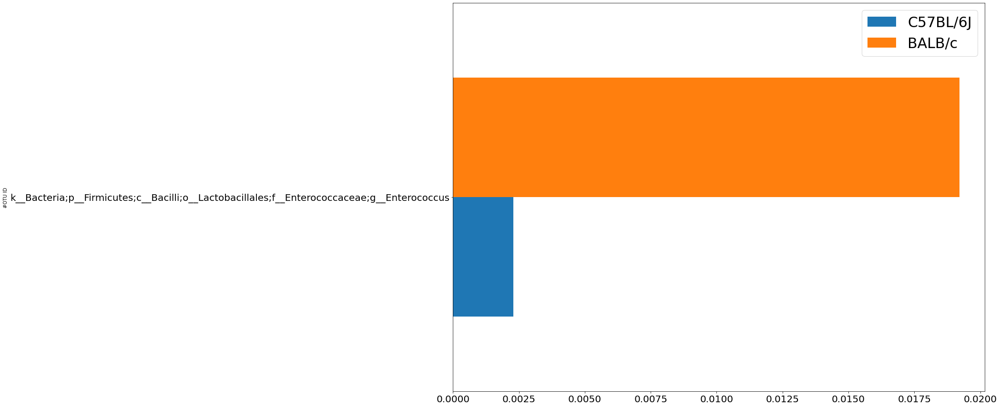

In [70]:
relative_abundance_sebum= ancom_biom_table_sebum.div(1279)
list_C57B = meta[meta['genotype'].isin(['C57BL6/J'])].index
list_BALB = meta[meta['genotype'].isin(['BALB/c'])].index

ancom_C57B_sebum=relative_abundance_sebum[[col for col in relative_abundance_sebum.columns if col in list_C57B]]
ancom_C57B_sebum["average"]=ancom_C57B_sebum.mean(axis=1)

ancom_BALB_sebum = relative_abundance_sebum[[col for col in relative_abundance_sebum.columns if col in list_BALB]]
ancom_BALB_sebum["average"] = ancom_BALB_sebum.mean(axis=1)

%matplotlib inline
#ancom_taxa_sebum_F1 = ['']
#ancom_taxa_sebum_F2=['']
#ancom_taxa_sebum_F3=['']
#ancom_taxa_sebum_F4 = ['k__Bacteria;p__Firmicutes;c__Bacilli;o__Lactobacillales;f__Enterococcaceae;g__Enterococcus;s__casseliflavus']
#ancom_taxa_sebum_F5 =['']
#ancom_taxa_sebum_F5-6=['']
#ancom_taxa_sebum_F4-6 = ['k__Bacteria;p__Firmicutes;c__Bacilli;o__Lactobacillales;f__Enterococcaceae;g__Enterococcus']
#ancom_taxa_sebum_F3-6 = ['']
#ancom_taxa_sebum_F2-6 = ['']
#ancom_taxa_sebum = ['k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia', 'k__Bacteria;p__Firmicutes;c__Erysipelotrichi;o__Erysipelotrichales;f__Erysipelotrichaceae;g__Allobaculum']
taxa_C57B_sebum = ancom_C57B_sebum[ancom_C57B_sebum.index.isin(ancom_taxa_sebum)]
taxa_BALB_sebum = ancom_BALB_sebum[ancom_BALB_sebum.index.isin(ancom_taxa_sebum)]

ancom_plot = pd.DataFrame({'C57BL6/J': taxa_C57B_sebum['average'],
                           'BALB/c': taxa_BALB_sebum['average']},
                         index=taxa_C57B_sebum.index)
ancom_taxa_plot = ancom_plot.plot.barh(figsize=(20,15), width =0.8, fontsize=20).legend(loc=1, prop={'size':30})
plt.legend(labels=["C57BL/6J","BALB/c"], fontsize=30)
ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot_sebum6_F3.png', set_facecolor='white', bbox_inches='tight', facecolor='white')

In [63]:
%time !$q_path; qiime taxa collapse \
  --i-table $work_dir/mouse-table-sebum-nocompRM.qza \
  --i-taxonomy $work_dir/taxonomy_full.qza \
  --p-level 7 \
  --o-collapsed-table $work_dir/collapsed-level7-mouse-sebum-table-nocompRM.qza

%time !$q_path; qiime composition add-pseudocount \
  --i-table $work_dir/collapsed-level7-mouse-sebum-table-nocompRM.qza \
  --o-composition-table $work_dir/composition-table-mouse-sebum-l7-nocompRM.qza

%time !$q_path; qiime composition ancom \
  --i-table $work_dir/composition-table-mouse-sebum-l7-nocompRM.qza \
  --m-metadata-file $meta_file \
  --m-metadata-column genotype \
  --o-visualization $work_dir/ancom-genotype-mouse-sebum-l7-nocompRM.qzv

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/collapsed-level7-mouse-sebum-table-nocompRM.qza
CPU times: user 286 ms, sys: 59.2 ms, total: 345 ms
Wall time: 13.5 s
Saved FeatureTable[Composition] to: /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-sebum-l7-nocompRM.qza
CPU times: user 306 ms, sys: 40.7 ms, total: 347 ms
Wall time: 13.4 s
Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/ancom-genotype-mouse-sebum-l7-nocompRM.qzv
CPU times: user 1.22 s, sys: 157 ms, total: 1.38 s
Wall time: 1min 16s


In [64]:
!unzip $work_dir/composition-table-mouse-sebum-l7-nocompRM.qza

Archive:  /homes/arehm/Documents/Thesis/JupyterNotebook/composition-table-mouse-sebum-l7-nocompRM.qza
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/metadata.yaml  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/checksums.md5  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/VERSION  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/data/feature-table.biom  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/metadata.yaml  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/citations.bib  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/VERSION  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/artifacts/e53ea1db-cc40-484a-8189-8676dd3de570/metadata.yaml  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/artifacts/e53ea1db-cc40-484a-8189-8676dd3de570/citations.bib  
  inflating: 6c422394-92ca-43ef-846f-39f870386ff8/provenance/artifacts/e53ea1db-cc40-484a-8189-8676dd3de570/VERSION  
  inflating: 6c422394-92ca-43ef-846f-39

In [65]:
!$q_path; biom summarize-table -i 6c422394-92ca-43ef-846f-39f870386ff8/data/feature-table.biom  

Num samples: 250
Num observations: 582
Total count: 395,500
Table density (fraction of non-zero values): 1.000

Counts/sample summary:
 Min: 1,582.000
 Max: 1,582.000
 Median: 1,582.000
 Mean: 1,582.000
 Std. dev.: 0.000
 Sample Metadata Categories: None provided
 Observation Metadata Categories: None provided

Counts/sample detail:
13422.181skin: 1,582.000
13422.172skin: 1,582.000
13422.118skin: 1,582.000
13422.145skin: 1,582.000
13422.154skin: 1,582.000
13422.163skin: 1,582.000
13422.136skin: 1,582.000
13422.109skin: 1,582.000
13422.100skin: 1,582.000
13422.173skin: 1,582.000
13422.10skin: 1,582.000
13422.146skin: 1,582.000
13422.164skin: 1,582.000
13422.128skin: 1,582.000
13422.101skin: 1,582.000
13422.137skin: 1,582.000
13422.119skin: 1,582.000
13422.155skin: 1,582.000
13422.182skin: 1,582.000
13422.11skin: 1,582.000
13422.138skin: 1,582.000
13422.129skin: 1,582.000
13422.156skin: 1,582.000
13422.174skin: 1,582.000
13422.165skin: 1,582.000
13422.102skin: 1,582.000
13422.110skin: 1,

In [134]:
! $q_path; biom convert \
  --input-fp fcf55a1b-6e91-4838-925f-9f8982d868b5/data/feature-table.biom      \
  --to-tsv \
  --output-fp $work_dir/ancom-biom-table-sebum 

In [85]:
ancom_biom_table_sebum = pd.read_csv(work_dir+"/ancom-biom-table-sebum", 
            sep="\t",skiprows=1, index_col=0)

relative_abundance_sebum= ancom_biom_table_sebum.div(1582)

ancom_C57B_sebum = relative_abundance_sebum[[col for col in relative_abundance_sebum.columns if col in list_C57B]]
ancom_C57B_sebum["average"]=ancom_C57B_sebum.mean(axis=1)
ancom_BALB_sebum = relative_abundance_sebum[[col for col in relative_abundance_sebum.columns if col in list_BALB]]
ancom_BALB_sebum["average"] = ancom_BALB_sebum.mean(axis=1)

/tmp/ipykernel_967230/3780615916.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ancom_C57B_sebum["average"]=ancom_C57B_sebum.mean(axis=1)
/tmp/ipykernel_967230/3780615916.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ancom_BALB_sebum["average"] = ancom_BALB_sebum.mean(axis=1)


In [59]:
k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia;s__muciniphila 	589
k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;__;__ 	587
k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Ruminococcus;s__ 	585
k__Bacteria;p__Firmicutes;c__Bacilli;o__Turicibacterales;f__Turicibacteraceae;g__Turicibacter;s__ 	584
k__Bacteria;p__Firmicutes;__;__;__;__;__ 	583
k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens 	582
k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__;g__;s__ 	582
k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__RF32;f__;g__;s__ 	579
k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Porphyromonadaceae;g__Parabacteroides;s__ 	575
k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium;s__pseudolongum

SyntaxError: invalid syntax (4216597718.py, line 1)

/tmp/ipykernel_967230/575856643.py:11: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "set_facecolor" which is no longer supported as of 3.3 and will become an error in 3.6
  ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot-sebum7.png', set_facecolor='white', bbox_inches='tight')


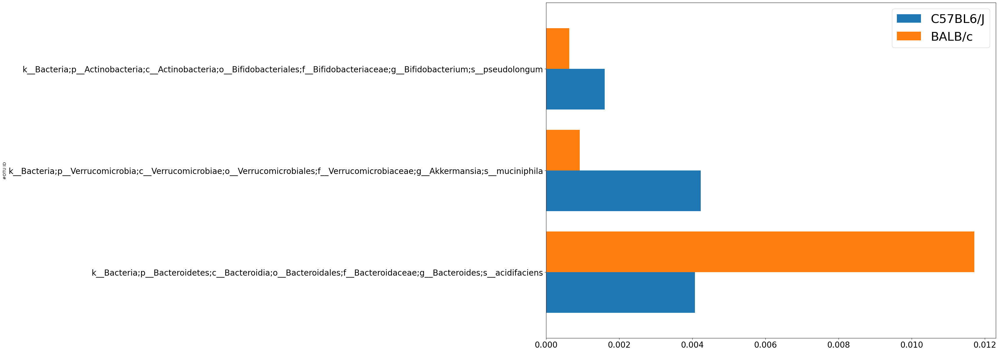

In [60]:
ancom_taxa_sebum = ['k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium;s__pseudolongum','k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae;g__Bacteroides;s__acidifaciens','k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Akkermansia;s__muciniphila']
taxa_C57B_sebum = ancom_C57B_sebum[ancom_C57B_sebum.index.isin(ancom_taxa_sebum)]
taxa_BALB_sebum = ancom_BALB_sebum[ancom_BALB_sebum.index.isin(ancom_taxa_sebum)]


ancom_plot = pd.DataFrame({'C57BL6/J': taxa_C57B_sebum['average'],
                           'BALB/c': taxa_BALB_sebum['average']},
                         index=taxa_C57B_sebum.index)
import matplotlib.pyplot as plt
ancom_taxa_plot = ancom_plot.plot.barh(figsize=(20,15), width =0.8, fontsize=20).legend(loc=1, prop={'size':30})
ancom_taxa_plot.figure.savefig(work_dir + '/ancom_plot-sebum7.png', set_facecolor='white', bbox_inches='tight')

## Upsetplot

In [4]:
import upsetplot
from upsetplot import UpSet
from upsetplot import from_memberships
from upsetplot import plot
from matplotlib import cm

In [22]:
def make_UpSet(category, upset_taxa_gut, plotname):
    position_category_column = upset_taxa_gut.columns.get_loc(category)
    up_to_gen = upset_taxa_gut.drop(upset_taxa_gut.iloc[:, (position_category_column+1):335],axis = 1)
    only_gen = up_to_gen.drop(up_to_gen.iloc[:, 277:position_category_column], axis = 1)
    taxa_sum = only_gen.groupby(category).sum()
    taxa_sum = taxa_sum.loc[:,~taxa_sum.columns.str.endswith("__")]
    taxa_sum = taxa_sum.loc[:, (taxa_sum != 0).any(axis=0)]
    taxa_sum = taxa_sum.transpose()
    over_zero = taxa_sum > 0
    over_zero = over_zero.rename(columns=lambda x: x + ' ')
    upset_combined = pd.concat([taxa_sum, over_zero],axis=1)
    upset_combined['taxa1'] = upset_combined.index
    upset_combined['taxa'] = upset_combined['taxa1'].str.split(';', expand=True)[5]
    upset_combined = upset_combined.drop(["taxa1"], axis=1)
    upset_combined = upset_combined.set_index(list(over_zero.columns))
    #upset = UpSet(upset_combined, subset_size='count', intersection_plot_elements=0, show_counts=True)
    plot(upset_combined, show_counts=True, subset_size="count", sort_categories_by="-input")
    #upset.add_stacked_bars(by="taxa")
    #upset.add_stacked_bars(by="taxa", elements=10, colors=cm.gist_stern)
    #upset.plot()
    #plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0, title=f'Colours for taxa')
    plt.suptitle(f'UpSet plot for Genus divided by {category}')
    #plt.style.use("ggplot")
    plt.savefig(work_dir + f"/{plotname}.svg", transparent=False, bbox_inches='tight')
    plt.show()

In [92]:
taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])][-60:]

,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;__;__,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Rhodobacteraceae;g__Paracoccus,k__Bacteria;p__Bacteroidetes;c__Flavobacteriia;o__Flavobacteriales;f__Flavobacteriaceae;g__Flavobacterium,k__Bacteria;p__Firmicutes;__;__;__;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Prevotellaceae;g__Prevotella,k__Bacteria;__;__;__;__;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__Bacillaceae;g__Bacillus,k__Bacteria;p__Verrucomicrobia;c__Verrucomicrobiae;o__Verrucomicrobiales;f__Verrucomicrobiaceae;g__Luteolibacter,k__Bacteria;p__Fusobacteria;c__Fusobacteriia;o__Fusobacteriales;f__Fusobacteriaceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__S24-7;g__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Ruminococcaceae;g__Oscillospira,k__Bacteria;p__Actinobacteria;c__Acidimicrobiia;o__Acidimicrobiales;f__Microthrixaceae;g__,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Oxalobacteraceae;g__Polynucleobacter,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Lachnospiraceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__;g__,k__Bacteria;p__GN02;c__BD1-5;o__;f__;g__,k__Bacteria;p__Actinobacteria;c__Coriobacteriia;o__Coriobacteriales;f__Coriobacteriaceae;g__Adlercreutzia,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Oxalobacteraceae;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__[Exiguobacteraceae];g__Exiguobacterium,k__Bacteria;p__OD1;c__ZB2;o__;f__;g__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__Lachnospiraceae;g__Blautia,k__Bacteria;p__Planctomycetes;c__Planctomycetia;o__Gemmatales;f__Gemmataceae;g__Gemmata,k__Bacteria;p__GN02;c__GKS2-174;o__;f__;g__,k__Bacteria;p__TM7;c__TM7-3;o__;f__;g__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Prevotellaceae;__,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Actinomycetales;__;__,k__Bacteria;p__Bacteroidetes;c__[Rhodothermi];o__[Rhodothermales];f__Rhodothermaceae;g__Rubricoccus,k__Bacteria;p__Chlorobi;c__OPB56;o__;f__;g__,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;__;__;__,k__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Pseudomonadales;f__Pseudomonadaceae;g__Pseudomonas,k__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Hyphomonadaceae;__,k__Bacteria;p__Bacteroidetes;c__Sphingobacteriia;o__Sphingobacteriales;f__Sphingobacteriaceae;g__Sphingobacterium,k__Bacteria;p__Chlamydiae;c__Chlamydiia;o__Chlamydiales;__;__,k__Bacteria;p__Firmicutes;c__Clostridia;o__Clostridiales;f__[Tissierellaceae];g__Gallicola,k__Bacteria;p__Planctomycetes;c__Planctomycetia;o__Pirellulales;f__Pirellulaceae;__,k__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;__;__;__,k__Bacteria;p__Bacteroidetes;c__Cytophagia;o__Cytophagales;f__Cytophagaceae;g__Leadbetterella,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Bifidobacteriales;f__Bifidobacteriaceae;g__Bifidobacterium,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Burkholderiales;f__Alcaligenaceae;g__Achromobacter,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Rhodocyclales;f__Rhodocyclaceae;__,k__Bacteria;p__Bacteroidetes;c__Bacteroidia;o__Bacteroidales;f__Rikenellaceae;g__,k__Bacteria;p__Armatimonadetes;c__Armatimonadia;o__Armatimonadales;f__Armatimonadaceae;g__Armatimonas,k__Bacteria;p__Firmicutes;c__Bacilli;o__Lactobacillales;f__Streptococcaceae;g__Streptococcus,k__Bacteria;p__TM7;c__TM7-3;o__CW040;f__F16;g__,k__Bacteria;p__Actinobacteria;c__Actinobacteria;o__Actinomycetales;f__ACK-M1;g__,k__Bacteria;p__Tenericutes;c__Mollicutes;o__RF39;f__;g__,k__Bacteria;p__Acidobacteria;c__[Chloracidobacteria];o__RB41;f__Ellin6075;g__,k__Bacteria;p__Proteobacteria;c__Betaproteobacteria;o__Methylophilales;f__Methylophilaceae;__,k__Bacteria;p__Firmicutes;c__Bacilli;o__Bacillales;f__Planococcaceae;g__Planomicrobium,k__Bacteria;p__Firmicutes;c__Bacilli;o__Lac

### UpSet Plots für Genotypen

In [23]:
#prepare taxa_all_l6 table
upset_taxa_gut= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


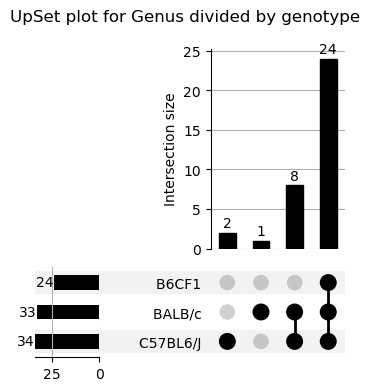

In [24]:
make_UpSet("genotype", upset_taxa_gut, "upset_gut_genotype")

#### BALB/c

In [28]:
upset_taxa_gut_BALB= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['genotype'].isin(['BALB/c', 'B6CF1'])& taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


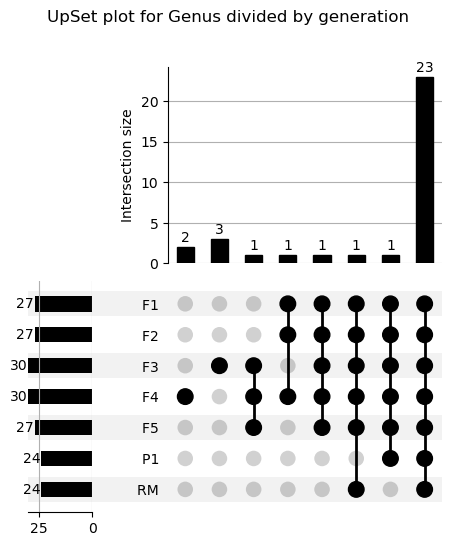

In [29]:
make_UpSet('generation', upset_taxa_gut_BALB, "upset_gut_BALB_generation")

##### Cage Lineage

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


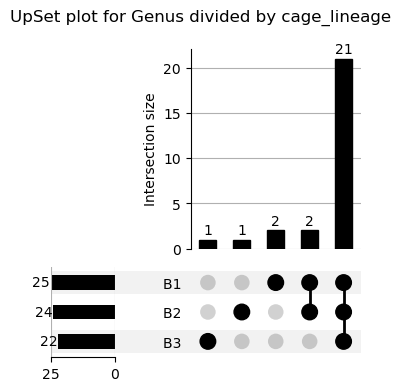

In [31]:
make_UpSet("cage_lineage", upset_taxa_gut_BALB[upset_taxa_gut_BALB['genotype'].isin(['BALB/c'])], "upset_gut_BALB_cagelineage")

#### B6J

In [33]:
upset_taxa_gut_B6J= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:lumen of gut']) & taxa_all_l6['genotype'].isin(['C57BL6/J', 'B6CF1'])& taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


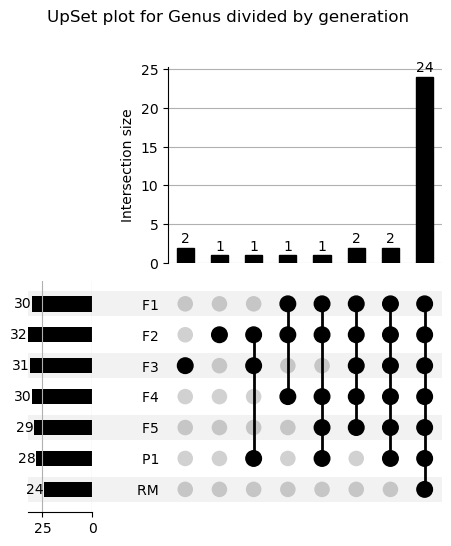

In [35]:
make_UpSet("generation", upset_taxa_gut_B6J, "upset_gut_B6J_generation")

##### Cage Lineage

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


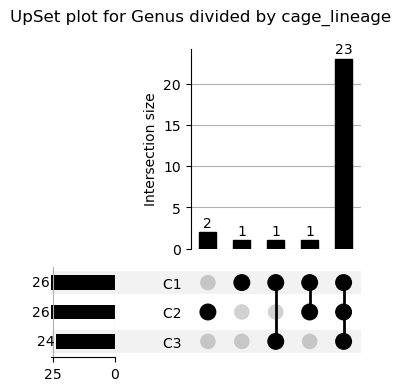

In [39]:
make_UpSet("cage_lineage", upset_taxa_gut_B6J[upset_taxa_gut_B6J['genotype'].isin(['C57BL6/J'])], "upset_gut_B6J_cagelineage")

### Sebum

In [16]:
import matplotlib.pyplot as plt

In [41]:
#prepare taxa_all_l6 table
upset_taxa_sebum= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:sebum']) & taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


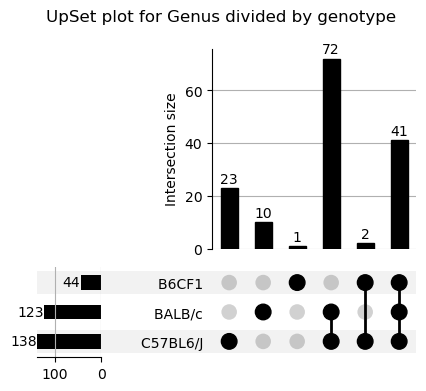

In [42]:
make_UpSet("genotype", upset_taxa_sebum, "upset_sebum_genotype")

#### BALB/c

In [15]:
upset_taxa_sebum_BALB= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:sebum']) & taxa_all_l6['genotype'].isin(['BALB/c', 'B6CF1'])& taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


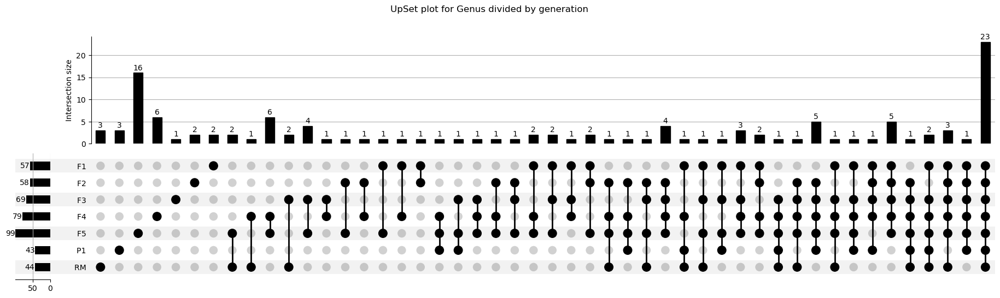

In [43]:
make_UpSet('generation', upset_taxa_sebum_BALB, "upset_sebum_BALB_generation")

##### Cage Lineage

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


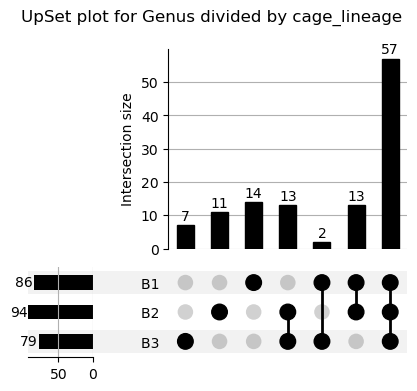

In [44]:
make_UpSet("cage_lineage", upset_taxa_sebum_BALB[upset_taxa_sebum_BALB['genotype'].isin(['BALB/c'])], "upset_sebum_BALB_cagelineage")

#### B6J

In [45]:
upset_taxa_sebum_B6J= taxa_all_l6[taxa_all_l6['host_body_product'].isin(['UBERON:sebum']) & taxa_all_l6['genotype'].isin(['C57BL6/J'])& taxa_all_l6['host_scientific_name'].isin(['Mus musculus']) & ~taxa_all_l6['generation'].isin(['not applicable'])]

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


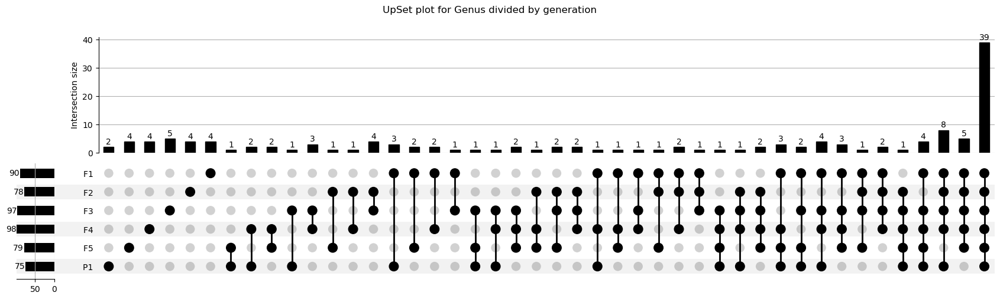

In [46]:
make_UpSet("generation", upset_taxa_sebum_B6J, "upset_sebum_B6J_generation")

##### Cage Lineage

/tmp/ipykernel_1218126/3444097880.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  taxa_sum = only_gen.groupby(category).sum()


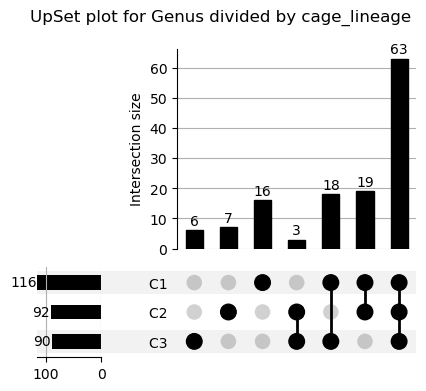

In [48]:
make_UpSet("cage_lineage", upset_taxa_sebum_B6J[upset_taxa_sebum_B6J["genotype"].isin(["C57BL6/J"])], "upset_sebum_B6J_cagelineage")

## GGMAP Timeline

In [1]:
from skbio.tree import TreeNode
%load_ext autoreload
%autoreload 2
%reload_ext autoreload
from ggmap.snippets import *
from ggmap.analyses import *
from ggmap.correlations import *
from ggmap.workflow import *
import seaborn as sns
import matplotlib.pyplot as plt

ggmap is custome code from Stefan Janssen, download at https://github.com/sjanssen2/ggmap, using commit 'c8b3e7489e02ab586f514103488ed5f815bc9832'
Reading settings file '/homes/arehm/.ggmaprc'


In [11]:
meta['i_generation'] = meta['generation'].apply(lambda x: {'RM': '-1: RM',
                                    'P1': '0: P1',
                                    'F1': '1: F1',
                                    'F2': '2: F2',
                                    'F3': '3: F3',
                                    'F4': '4: F4',
                                    'F5': '5: F5',
                                   }.get(x, x))

#### Alpha Diversity
##### Gut

In [77]:
RM_shannon_average = np.mean(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['shannon'])
RM_shannon_std = np.std(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['shannon'])
RM_PD_average = np.mean(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['PD_whole_tree'])
RM_PD_std = np.std(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['PD_whole_tree'])
RM_observed_average = np.mean(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['observed_features'])
RM_observed_std = np.std(alpha_results_merged_gut[alpha_results_merged_gut['generation'].isin(['RM'])]['observed_features'])

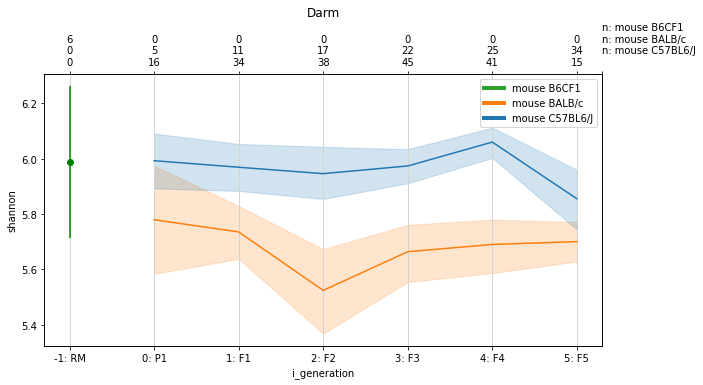

In [78]:
%matplotlib inline
import pylab
metric = 'shannon'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable'])],
                data=alpha_div_gut['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"},
                test_groups=None
                )
#axes.legend(labels=['BALB/c', 'C57BL/6J'])
plt.scatter("-1: RM", RM_shannon_average, color='green')
plt.errorbar(["-1: RM"], [RM_shannon_average], yerr=RM_shannon_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(labels, loc=2)
plt.title('Darm')
plt.savefig(work_dir + "/alpha_gut_timeline_shannon.png", transparent=True, bbox_inches="tight", facecolor='white')

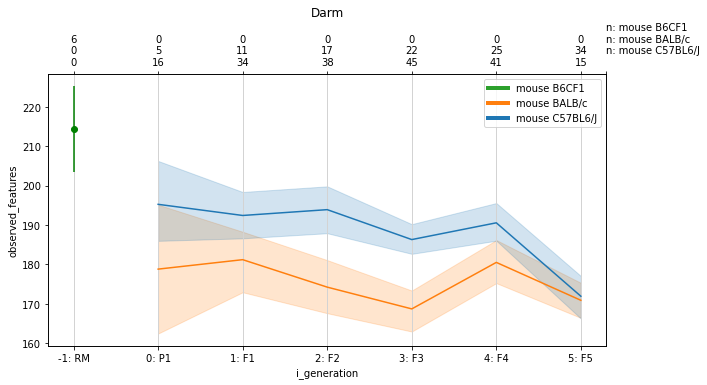

In [79]:
%matplotlib inline

metric = 'observed_features'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable']) ],
                data=alpha_div_gut['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                test_groups=None,
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"})
#axes.legend(labels=['BALB/c', 'C57BL/6J'])
plt.scatter("-1: RM", RM_observed_average, color='green')
plt.errorbar(["-1: RM"], [RM_observed_average], yerr=RM_observed_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(handles, labels, loc=2)
plt.title('Darm')
plt.savefig(work_dir + "/alpha_gut_timeline_observed_features.png", transparent=False, bbox_inches="tight", facecolor='white')

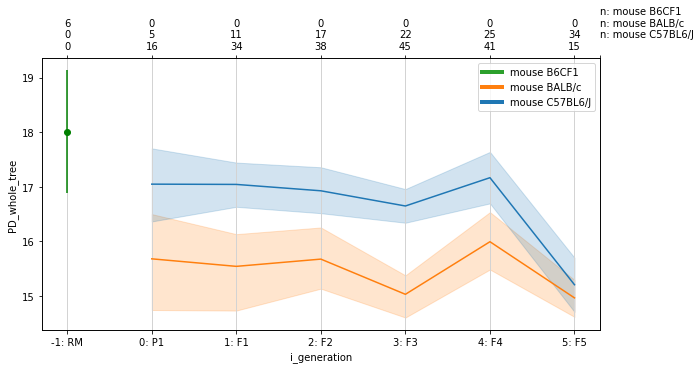

In [80]:
%matplotlib inline

metric = 'PD_whole_tree'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable'])],
                data=alpha_div_gut['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                test_groups=None,
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"})
#axes.legend(labels=['BALB/c', 'C57BL/6J'])
plt.scatter("-1: RM", RM_PD_average, color='green')
plt.errorbar(["-1: RM"], [RM_PD_average], yerr=RM_PD_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(handles, labels, loc=2)
plt.savefig(work_dir + "/alpha_gut_timeline_PD_whole_tree.png", transparent=False, bbox_inches="tight", facecolor='white')

##### Sebum

In [85]:
RM_shannon_average = np.mean(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['shannon'])
RM_shannon_std = np.std(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['shannon'])
RM_PD_average = np.mean(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['PD_whole_tree'])
RM_PD_std = np.std(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['PD_whole_tree'])
RM_observed_average = np.mean(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['observed_features'])
RM_observed_std = np.std(alpha_results_merged_sebum[alpha_results_merged_sebum['generation'].isin(['RM'])]['observed_features'])

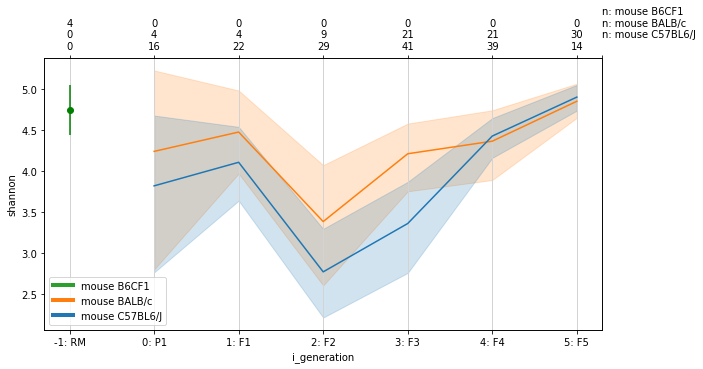

In [86]:
%matplotlib inline

metric = 'shannon'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable'])],
                data=alpha_div_sebum['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                test_groups=None,
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"})
plt.scatter("-1: RM", RM_shannon_average, color='green')
plt.errorbar(["-1: RM"], [RM_shannon_average], yerr=RM_shannon_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(handles, labels, loc=2)
#axes.legend(labels=['BALB/c', 'C57BL/6J', 'B6CF1'])
plt.savefig(work_dir + "/alpha_sebum_timeline_shannon.png", transparent=False, bbox_inches="tight", facecolor='white')

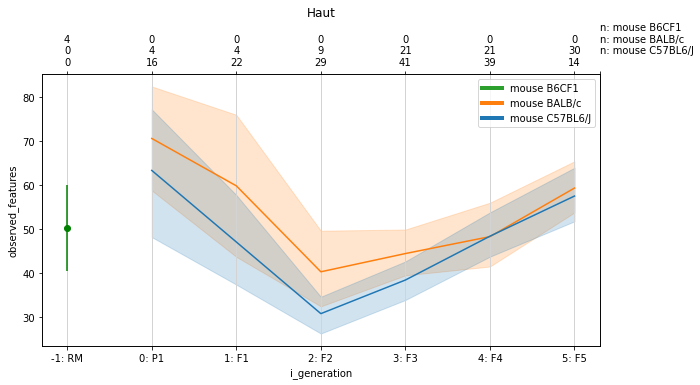

In [87]:
%matplotlib inline

metric = 'observed_features'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable'])],
                data=alpha_div_sebum['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                test_groups=None,
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"})
plt.scatter("-1: RM", RM_observed_average, color='green')
plt.errorbar(["-1: RM"], [RM_observed_average], yerr=RM_observed_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(handles, labels, loc=2)
plt.title('Haut')
plt.savefig(work_dir + "/alpha_sebum_timeline_observed_features.png", transparent=False, bbox_inches="tight", facecolor='white')

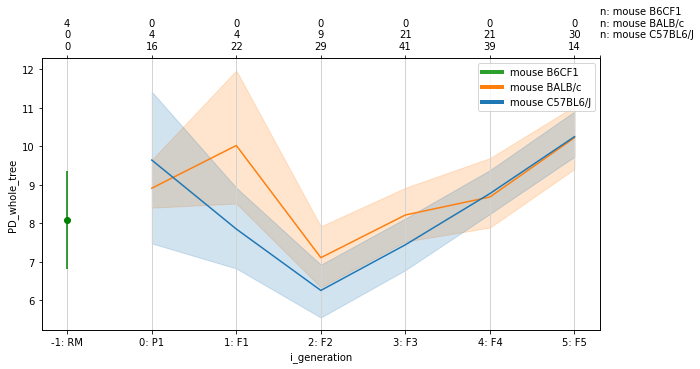

In [88]:
%matplotlib inline

metric = 'PD_whole_tree'
fig, axes = plt.subplots(1,1, figsize=(10,5))
a_data = plot_timecourse(meta[meta['genotype'].isin(['C57BL6/J','BALB/c', 'B6CF1']) & meta['host_common_name'].isin(['mouse']) & ~meta['generation'].isin(['not applicable'])],
                data=alpha_div_sebum['results'][metric],
                col_events='i_generation', col_entities=None,
                cols_groups=['host_common_name', 'genotype'],
                #test_groups=[(('mouse', 'C57BL6/J'), ('mouse', 'BALB/c'))],
                test_groups=None,
                pthreshold=0.05, print_samplesizes=True,
                ax=axes,
                colors_groups={('mouse', 'BALB/c'): "tab:orange", ('mouse', 'C57BL6/J'): "tab:blue"})
plt.scatter("-1: RM", RM_PD_average, color='green')
plt.errorbar(["-1: RM"], [RM_PD_average], yerr=RM_PD_std, color='green')
#handles, labels = fig.get_legend_handles_labels()
labels = ['BALB/c', 'C57BL/6J', 'B6CF1']
#plt.legend(handles, labels, loc=2)
#axes.legend(labels=['BALB/c', 'C57BL/6J'])
plt.savefig(work_dir + "/alpha_sebum_timeline_PD_whole_tree.png", transparent=False, bbox_inches="tight", facecolor='white')

##### Scatter Plots Aplha Diversity
###### Gut

In [12]:
gut_indeces = meta[meta['genotype'].isin(['C57BL6/J']) & meta['host_body_product'].isin(['UBERON:lumen of gut']) & ~meta['generation'].isin(['not applicable']) & ~meta['tube_id'].isin(['3-a8'])].index
gut_indeces
#gut_indeces = gut_indeces.delete('13422.217')

Index(['13422.100', '13422.101', '13422.102', '13422.103', '13422.104',
       '13422.105', '13422.106', '13422.107', '13422.108', '13422.109',
       ...
       '13422.90', '13422.91', '13422.92', '13422.93', '13422.94', '13422.95',
       '13422.96', '13422.97', '13422.98', '13422.99'],
      dtype='object', name='sample_name', length=189)

In [138]:
alpha_div_gut['results']['PD_whole_tree'].loc[gut_indeces]

NameError: name 'alpha_div_gut' is not defined

[Text(0.5, 1.0, 'Alpha Diversity per cage lineage by generation B6J')]

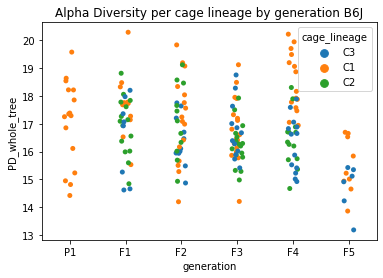

In [25]:
%matplotlib inline
import seaborn as sns
sns.stripplot(x= 'generation', y='PD_whole_tree', data= alpha_results_merged_gut.loc[gut_indeces],order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'], hue='cage_lineage').set(title='Alpha Diversity per cage lineage by generation B6J')
#lt.show()

it seems as if the cage lineage C1 adds a lot of diversity in F4 to the overall alpha diversity in C75B. This is then missing in F5 as the C1 is merged with C2 to make up for missing samples like we talked about with Laurentiu. The drop in Alphadiversity may thus not originate from a simple lack of number of samples but from the lack of C1 specifically!

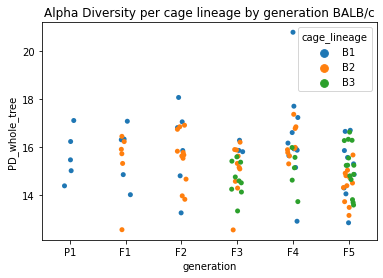

In [24]:
gut_indeces_BALB = meta[meta['genotype'].isin(['BALB/c']) & meta['host_body_product'].isin(['UBERON:lumen of gut']) & ~meta['generation'].isin(['not applicable'])].index
sns.stripplot(x= 'generation', y='PD_whole_tree', data= alpha_results_merged_gut.loc[gut_indeces_BALB],order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'],  hue='cage_lineage').set(title='Alpha Diversity per cage lineage by generation BALB/c')
plt.show()

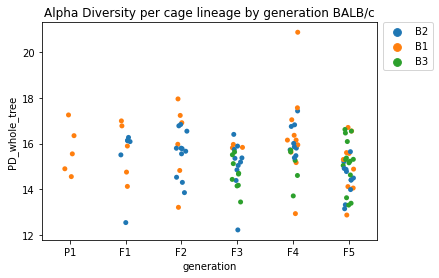

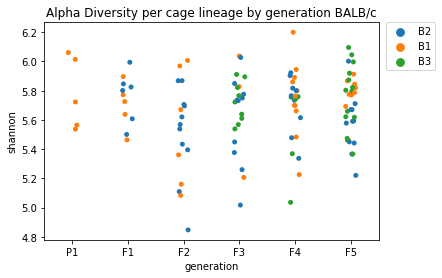

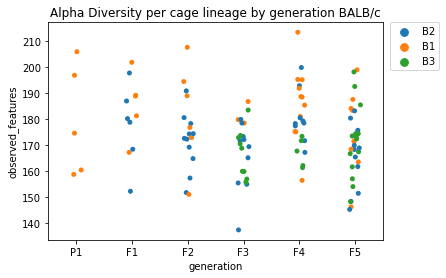

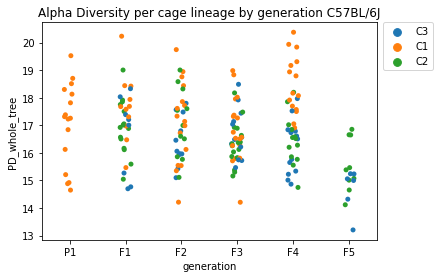

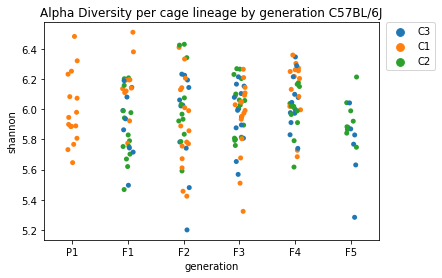

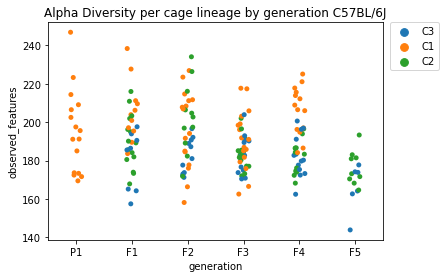

In [16]:
gut_indeces_C57B = meta[meta['genotype'].isin(['C57BL6/J']) & meta['host_body_product'].isin(['UBERON:lumen of gut']) & ~meta['generation'].isin(['not applicable'])].index
data_gut_C57B_alpha = alpha_results_merged_gut.loc[alpha_results_merged_gut.index.intersection(gut_indeces_C57B)]
gut_indeces_BALB = meta[meta['genotype'].isin(['BALB/c']) & meta['host_body_product'].isin(['UBERON:lumen of gut']) & ~meta['generation'].isin(['not applicable'])].index
data_gut_BALB_alpha = alpha_results_merged_gut.loc[alpha_results_merged_gut.index.intersection(gut_indeces_BALB)]
for count, data in enumerate([data_gut_BALB_alpha, data_gut_C57B_alpha]):
    genotype='BALB/c' if count == 0 else 'C57BL/6J'
    for metric in ['PD_whole_tree', 'shannon', 'observed_features']:
        sns.stripplot(x= 'generation', y=metric, data= data,order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'],  hue='cage_lineage')
        plt.title(f'Alpha Diversity per cage lineage by generation {genotype}')
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
        plt.show()

###### Sebum

In [32]:
sebum_indeces_C57B = meta[meta['genotype'].isin(['C57BL6/J']) & meta['host_body_product'].isin(['UBERON:sebum']) & ~meta['generation'].isin(['not applicable']) & ~meta['tube_id'].isin(['3-a8'])].index
alpha_results_merged_sebum.loc[alpha_results_merged_sebum.index.intersection(sebum_indeces_C57B)]

,observed_features,shannon,PD_whole_tree,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,...,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,i_generation,comparison
13422.172skin,26.6,0.741001,6.138310,3,2019-07-13,CF3-3,F3-20,eppi,necropsy,2019-10-28,...,mouse skin metagenome,male,410661,Skin screening,6-a12,6-a12,3,C3,3: F3,0
13422.145skin,44.6,1.280731,9.204390,3,2019-07-10,CF3-2,F3-7,eppi,necropsy,2019-10-23,...,mouse skin metagenome,female,410661,Skin screening,7-d10,7-d10,3,C2,3: F3,0
13422.154skin,60.6,5.131082,9.753208,3,2019-07-14,CF3-2,F3-12,eppi,necropsy,2019-10-29,...,mouse skin metagenome,male,410661,Skin screening,9-c8,9-c8,3,C2,3: F3,0
13422.163skin,33.7,4.291547,6.326331,3,2019-07-10,CF3-3,F3-16,eppi,necropsy,2019-10-24,...,mouse skin metagenome,male,410661,Skin screening,9-g9,9-g9,3,C3,3: F3,0
13422.136skin,32.5,3.974896,6.388162,3,2019-07-10,CF3-1,F3-4,eppi,necropsy,2019-10-22,...,mouse skin metagenome,female,410661,Skin screening,7-g6,7-g6,3,C1,3: F3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.85skin,41.0,3.752409,8.670402,3,2019-05-06,CF2-1,F2-6,eppi,necropsy,2019-08-20,...,mouse skin metagenome,male,410661,Skin screening,7-a8,7-a8,2,C1,2: F2,0
13422.93skin,32.9,4.148164,6.787002,3,2019-05-03,CF2-2,F2-9,eppi,necropsy,2019-08-15,...,mouse skin metagenome,female,410661,Skin screening,7-c10,7-c10,2,C2,2: F2,0
13422.69skin,85.4,5.170829,11.918280,3,2019-02-18,CF1-3,F1-12,eppi,necropsy,2019-06-03,...,mouse skin metagenome,female,410661,Skin screening,8-g10,8-g10,1,C3,1: F1,0
13422.87skin,43.3,3.823303,9.079061,3,2019-05-06,CF2-1,F2-7,eppi,necropsy,2019-08-20,...,mouse skin metagenome,male,410661,Skin screening,8-c6,8-c6,2,C1,2: F2,0


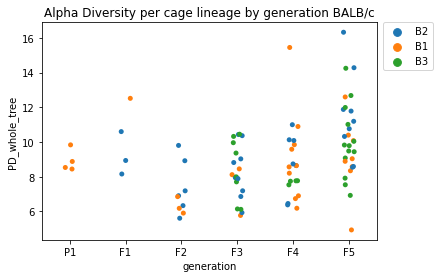

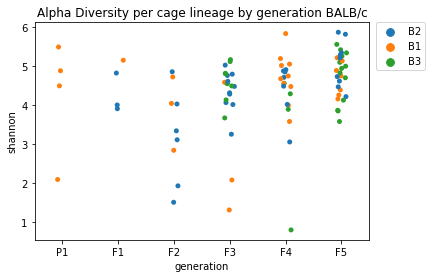

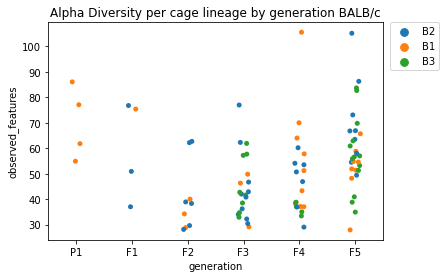

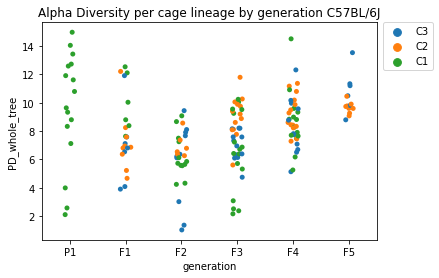

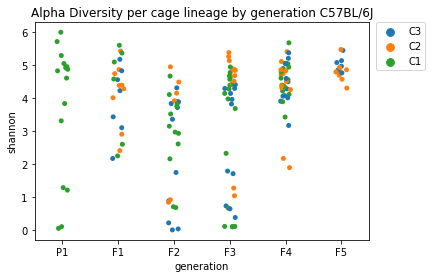

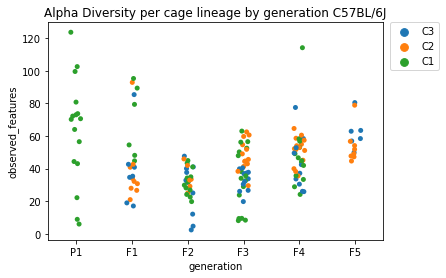

In [10]:
sebum_indeces_C57B = meta[meta['genotype'].isin(['C57BL6/J']) & meta['host_body_product'].isin(['UBERON:sebum']) & ~meta['generation'].isin(['not applicable'])].index
data_sebum_C57B_alpha = alpha_results_merged_sebum.loc[alpha_results_merged_sebum.index.intersection(sebum_indeces_C57B)]
sebum_indeces_BALB = meta[meta['genotype'].isin(['BALB/c']) & meta['host_body_product'].isin(['UBERON:sebum']) & ~meta['generation'].isin(['not applicable'])].index
data_sebum_BALB_alpha = alpha_results_merged_sebum.loc[alpha_results_merged_sebum.index.intersection(sebum_indeces_BALB)]
for count, data in enumerate([data_sebum_BALB_alpha, data_sebum_C57B_alpha]):
    genotype='BALB/c' if count == 0 else 'C57BL/6J'
    for metric in ['PD_whole_tree', 'shannon', 'observed_features']:
        sns.stripplot(x= 'generation', y=metric, data= data,order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'],  hue='cage_lineage')
        plt.title(f'Alpha Diversity per cage lineage by generation {genotype}')
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
        plt.show()

###### Sebumcatplot

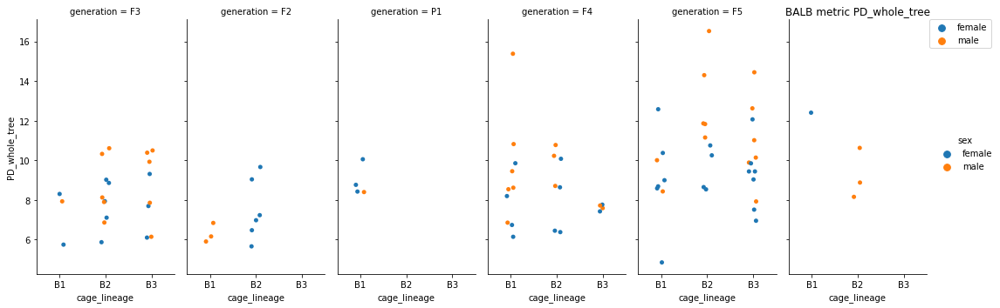

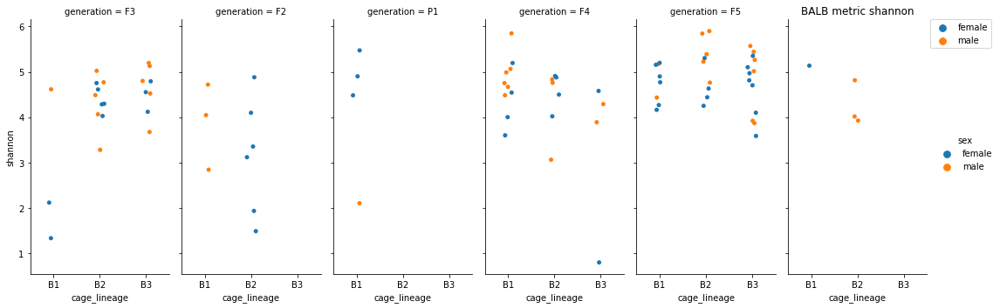

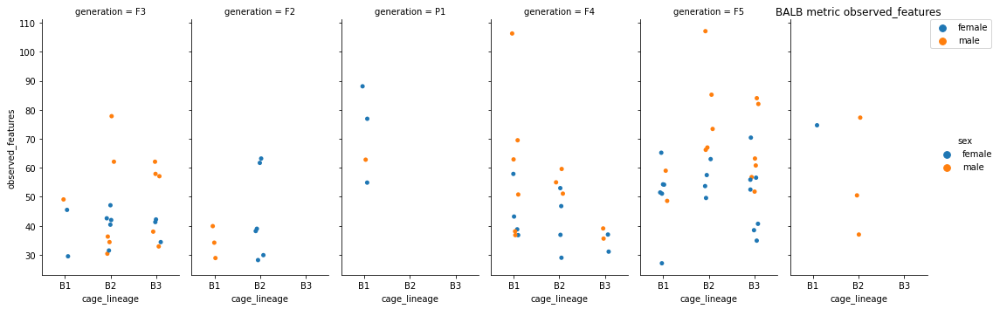

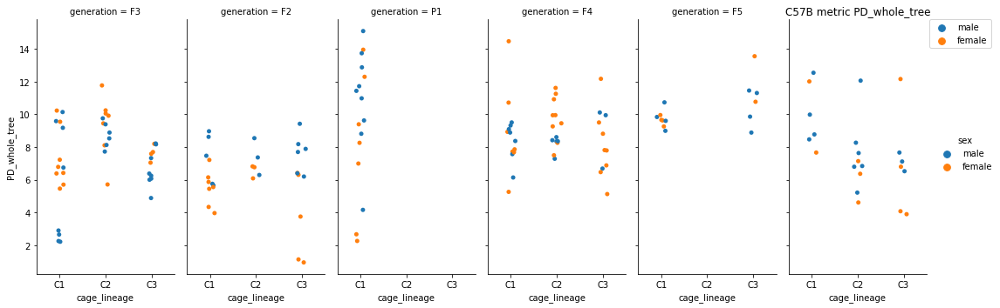

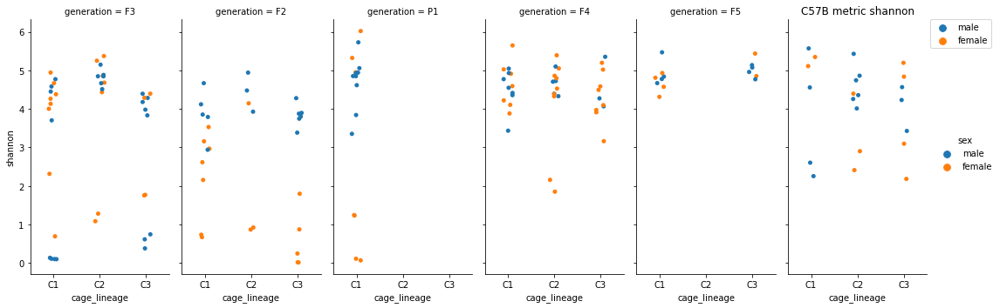

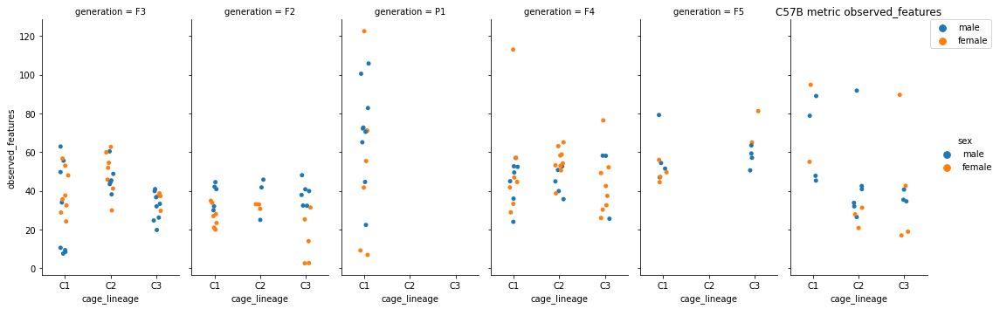

In [104]:
sebum_indeces_C57B = meta[meta['genotype'].isin(['C57BL6/J']) & meta['host_body_product'].isin(['UBERON:sebum']) & ~meta['generation'].isin(['not applicable'])].index
data_sebum_C57B_alpha = alpha_results_merged_sebum.loc[alpha_results_merged_sebum.index.intersection(sebum_indeces_C57B)]
sebum_indeces_BALB = meta[meta['genotype'].isin(['BALB/c']) & meta['host_body_product'].isin(['UBERON:sebum']) & ~meta['generation'].isin(['not applicable'])].index
data_sebum_BALB_alpha = alpha_results_merged_sebum.loc[alpha_results_merged_sebum.index.intersection(sebum_indeces_BALB)]
for count, data in enumerate([data_sebum_BALB_alpha, data_sebum_C57B_alpha]):
    genotype='BALB' if count == 0 else 'C57B'
    order=['B1', 'B2', 'B3'] if genotype == 'BALB' else ['C1', 'C2', 'C3']
    for metric in ['PD_whole_tree', 'shannon', 'observed_features']:
        sns.catplot(data=data, x='cage_lineage', y=metric, hue="sex", col="generation", aspect=.5, order=order)
        #sns.stripplot(x= 'generation', y=metric, data= data,order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'],  hue='cage_lineage')
        plt.title(f'{genotype} metric {metric}')
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
        plt.show()

In [ ]:
for count, data in enumerate([data_sebum_BALB_alpha, data_sebum_C57B_alpha]):
    genotype='BALB' if count == 0 else 'C57B'
    order=['B1', 'B2', 'B3'] if genotype == 'BALB' else ['C1', 'C2', 'C3']
    for metric in ['PD_whole_tree', 'shannon', 'observed_features']:
        sns.catplot(data=data, x='cage_lineage', y=metric, hue="", col="generation", aspect=.5, order=order)
        #sns.stripplot(x= 'generation', y=metric, data= data,order=['P1', 'F1', 'F2', 'F3', 'F4', 'F5'],  hue='cage_lineage')
        plt.title(f'{genotype} metric {metric}')
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
        plt.show()

#### Beta Diversity
##### Gut

In [41]:
significance_gut = pd.read_csv(work_dir + "/beta_significance_raw_gut.tsv", sep="\t", dtype=str)

In [45]:
P1_significance_C57B_gut = significance_gut[significance_gut["Group1"].isin(["0: P1"]) & significance_gut["Group2"].isin(["1: F1", "2: F2", "3: F3", "4: F4", "5: F5"]) & significance_gut["SubjectID1"].isin(list_C57B) & significance_gut["SubjectID2"].isin(list_C57B)]

In [46]:
P1_significance_C57B_gut["genotype"] = "C57BL6/J"

/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [48]:
P1_significance_BALB_gut = significance_gut[significance_gut["Group1"].isin(["0: P1"]) & significance_gut["Group2"].isin(["1: F1", "2: F2", "3: F3", "4: F4", "5: F5"]) & significance_gut["SubjectID1"].isin(list_BALB) & significance_gut["SubjectID2"].isin(list_BALB)]
P1_significance_BALB_gut["genotype"] = "BALB/c"

/homes/arehm/miniconda3/envs/notebookggmap/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [49]:
P1_significance_gut = P1_significance_C57B_gut.append(P1_significance_BALB_gut)
P1_significance_gut["Distance"] = P1_significance_gut["Distance"].astype(float)

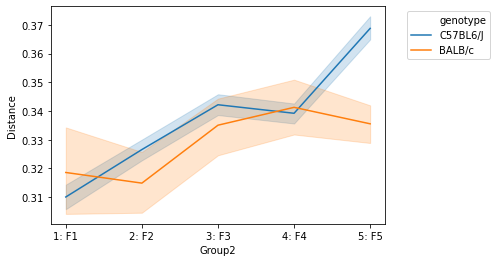

In [51]:
sns.lineplot(x="Group2", y="Distance", hue="genotype", err_style="band", data=P1_significance_gut)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.savefig(work_dir + "/beta_significance_distance_generations_gut.png", transparent=False, bbox_inches='tight')

In [52]:
distance_significance_gut_BALB= mannwhitneyu(P1_significance_gut[P1_significance_gut['Group2'].isin(["1: F1"]) & P1_significance_gut["genotype"].isin(["BALB/c"])]["Distance"] , P1_significance_gut[P1_significance_gut['Group2'].isin(["5: F5"]) & P1_significance_gut["genotype"].isin(["BALB/c"])]["Distance"])
distance_significance_gut_C57B= mannwhitneyu(P1_significance_gut[P1_significance_gut['Group2'].isin(["1: F1"]) & P1_significance_gut["genotype"].isin(["C57BL6/J"])]["Distance"] , P1_significance_gut[P1_significance_gut['Group2'].isin(["5: F5"]) & P1_significance_gut["genotype"].isin(["C57BL6/J"])]["Distance"])

In [53]:
P1_significance_gut["Group2"].value_counts()

3: F3    776
4: F4    736
2: F2    652
1: F1    540
5: F5    368
Name: Group2, dtype: int64

In [54]:
distance_significance_gut_BALB

MannwhitneyuResult(statistic=2193.0, pvalue=0.014458415704370188)

In [55]:
distance_significance_gut_C57B

MannwhitneyuResult(statistic=20429.0, pvalue=1.1303799106299238e-47)

##### Sebum

In [56]:
significance_sebum = pd.read_csv(work_dir + "/beta_significance_raw_sebum.tsv", sep="\t", dtype=str)

In [442]:
P1_significance_C57B_sebum = significance_sebum[significance_sebum["Group1"].isin(["0: P1"]) & significance_sebum["Group2"].isin(["1: F1", "2: F2", "3: F3", "4: F4", "5: F5"]) & significance_sebum["SubjectID1"].isin(list_C57B) & significance_sebum["SubjectID2"].isin(list_C57B)]

P1_significance_C57B_sebum["genotype"] = "C57BL6/J"

P1_significance_BALB_sebum = significance_sebum[significance_sebum["Group1"].isin(["0: P1"]) & significance_sebum["Group2"].isin(["1: F1", "2: F2", "3: F3", "4: F4", "5: F5"]) & significance_sebum["SubjectID1"].isin(list_BALB) & significance_sebum["SubjectID2"].isin(list_BALB)]
P1_significance_BALB_sebum["genotype"] = "BALB/c"

P1_significance_sebum = P1_significance_C57B_sebum.append(P1_significance_BALB_sebum)
P1_significance_sebum["Distance"] = P1_significance_sebum["Distance"].astype(float)

NameError: name 'significance_sebum' is not defined

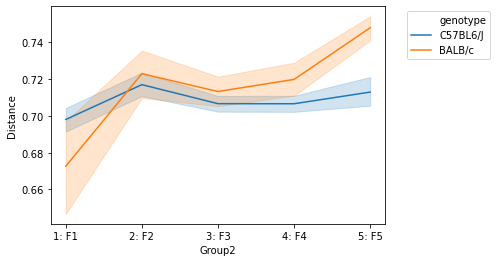

In [58]:
sns.lineplot(x="Group2", y="Distance", hue="genotype", err_style="band", data=P1_significance_sebum)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.savefig(work_dir + "/beta_significance_distance_generations_sebum.png", transparent=False, bbox_inches='tight')

In [59]:
distance_significance_sebum_BALB = mannwhitneyu(P1_significance_sebum[P1_significance_sebum['Group2'].isin(["1: F1"]) & P1_significance_sebum["genotype"].isin(["BALB/c"])]["Distance"], P1_significance_sebum[P1_significance_sebum['Group2'].isin(["5: F5"])& P1_significance_sebum["genotype"].isin(["BALB/c"])]["Distance"])
distance_significance_sebum_C57B = mannwhitneyu(P1_significance_sebum[P1_significance_sebum['Group2'].isin(["1: F1"])& P1_significance_sebum["genotype"].isin(["C57BL6/J"])]["Distance"], P1_significance_sebum[P1_significance_sebum['Group2'].isin(["5: F5"])& P1_significance_sebum["genotype"].isin(["C57BL6/J"])]["Distance"])

In [60]:
distance_significance_sebum_BALB

MannwhitneyuResult(statistic=200.0, pvalue=1.449607666530388e-07)

In [61]:
distance_significance_sebum_C57B

MannwhitneyuResult(statistic=35153.0, pvalue=0.014145056209730916)

# Statistics

In [2]:
#from skbio.stats.distance import DistanceMatrix
#from skbio.stats.distance import permanova
from qiime2 import Artifact
import itertools
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#### Seaborn Clustermap for Determination of HPLC samples

In [3]:
%time ! $q_path; qiime diversity filter-distance-matrix \
  --i-distance-matrix $work_dir/gut6000_beta_matrix-nocomp.qza \
  --m-metadata-file $work_dir/meta_gen_num.txt \
  --p-where "[genotype] IN ('C57BL6/J') AND [generation] IN ('F4')" \
  --o-filtered-distance-matrix $work_dir/gut6000_C57B_beta_matrix-nocomp.qza

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_C57B_beta_matrix-nocomp.qza
CPU times: user 362 ms, sys: 50.1 ms, total: 412 ms
Wall time: 15.7 s


In [6]:
dm_6000gut = Artifact.load(work_dir + "/gut6000_C57B_beta_matrix-nocomp.qza").view(DistanceMatrix)

In [7]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/gut6000_C57B_beta_matrix-nocomp.qza \
  --output-path $work_dir/gut6000_C57B_beta_matrix-nocomp_export

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_C57B_beta_matrix-nocomp.qza as DistanceMatrixDirectoryFormat to directory /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_C57B_beta_matrix-nocomp_export
CPU times: user 282 ms, sys: 60.7 ms, total: 343 ms
Wall time: 13.3 s


In [8]:
dm_6000gut_C57B = pd.read_csv(work_dir + "/gut6000_C57B_beta_matrix-nocomp_export/distance-matrix.tsv", sep="\t", dtype=str, index_col=0)

In [9]:
dm_6000gut_C57B_float = dm_6000gut_C57B.apply(pd.to_numeric)

In [10]:
meta['cage_group'].value_counts()

not applicable    160
CF3-1              34
CF3-2              32
PC                 32
CF2-1              32
CF1-2              30
CF4-1              30
CF4-2              28
BF5-3              28
CF4-3              26
CF3-3              24
CF2-3              22
BF5-2              22
CF1-1              22
BF4-1              22
CF2-2              22
BF2-2              22
BF3-2              20
CF5-1              18
BF3-3              18
BF5-1              18
BF4-2              18
CF1-3              16
CF5-2              12
BF2-1              12
BF1-2              12
RM                 12
BF1-1              10
PB                 10
BF4-3              10
BF3-1               6
Name: cage_group, dtype: int64

In [11]:
dm_6000gut_C57B

,13422.235,13422.222,13422.197,13422.216,13422.223,13422.200,13422.199,13422.198,13422.204,13422.225,13422.207,13422.203,13422.231,13422.211,13422.212,13422.232,13422.224,13422.219,13422.236,13422.227,13422.218,13422.220,13422.221,13422.213,13422.206,13422.233,13422.229,13422.215,13422.196,13422.208,13422.214,13422.205,13422.209,13422.201,13422.210,13422.202,13422.195,13422.226,13422.228,13422.230,13422.234
13422.235,0.0,0.39516954621719236,0.35268179504461805,0.4087338901962872,0.34044562877896667,0.38872423323109434,0.3730539506219069,0.35520445773340625,0.3183745807594164,0.22198489522054965,0.3715311761608149,0.36557286382877824,0.23024554412894752,0.3845258587154755,0.39172998524349417,0.25568150704233283,0.290813006574525,0.35218275064258214,0.20846930128829272,0.21521761311567347,0.3845450124626032,0.3725448202816786,0.3800331857107092,0.42614315130679514,0.3165011722254728,0.16550418111590495,0.15614002664668608,0.3461087536970344,0.3186612260944224,0.28097009325936007,0.3386877048371959,0.3545791691444819,0.31155035712283635,0.3380609979046529,0.36757981934684664,0.3703825546849579,0.4086542735091748,0.24068690163030934,0.2755766006051691,0.20132443805457617,0.2607185373120207
13422.222,0.39516954621719236,0.0,0.30418141154139716,0.273165796566748,0.2685478843972726,0.34391024798352304,0.30236089581045655,0.33184946535670634,0.30036602141218394,0.33203505835606234,0.3253820405763538,0.32338087061010207,0.36021024637196125,0.2594061110244142,0.2757430537313815,0.33022583899620767,0.38392254629346284,0.22202360597769935,0.32913692241424247,0.38642611590688764,0.23870351482866642,0.2539801433042307,0.18533198059550163,0.29667182825817723,0.31697131037175036,0.4136908895267422,0.37009509278055475,0.26417197124906233,0.3312390361286549,0.27572112754054395,0.3124486004751533,0.3307842998823818,0.2960819828203962,0.2692922405539937,0.2570001801013141,0.3066618881241577,0.29898042522374885,0.3479950740209336,0.30733284693477336,0.34464361179343317,0.35083182581160366
13422.197,0.35268179504461805,0.30418141154139716,0.0,0.31356159184802535,0.294382160207839,0.25778238549658167,0.2419072318233815,0.18433175216148254,0.21849752460729205,0.27773071305319863,0.29004441087221317,0.24756979308945815,0.3121981357651466,0.2816534440549454,0.27269348126683907,0.37616507116859343,0.40542404202896226,0.2919229676966773,0.28311776858789056,0.36053642476351044,0.2891562970668855,0.27132605426134354,0.24010097975331032,0.3163503580847098,0.21860498151220742,0.3528772158604313,0.29505087195077495,0.29761362640027683,0.22129478238639688,0.2030162581539501,0.31428930208968053,0.27063443593362496,0.20363262360307421,0.22138493310829988,0.2622321503539783,0.20593147810628631,0.23844923917510638,0.3126991900559254,0.29621450383912323,0.327691971983225,0.3397719986471495
13422.216,0.4087338901962872,0.273165796566748,0.31356159184802535,0.0,0.2918571617801666,0.38470046769867494,0.3781903622944658,0.3865034954715406,0.3114791747782484,0.35278033343122384,0.38156949129133677,0.36224124200810887,0.3739097560465932,0.27516998407271437,0.2600721960111786,0.3233008652960671,0.3970953078286779,0.29695910825967686,0.3128680137548742,0.4129566339012554,0.34028290063722966,0.24560203000173797,0.24633036824245969,0.36323920634867535,0.3512343934800702,0.40541048162444576,0.37901727689194076,0.21081335310004023,0.34101335649660514,0.31776846828553307,0.3309032275967422,0.3375374602728067,0.3244654654559285,0.34828123585382176,0.2883386426615499,0.35358795690776673,0.30270641847997787,0.3742915834002815,0.3448529850465923,0.3427260023286424,0.35175893556886695
13422.223,0.34044562877896667,0.2685478843972726,0.294382160207839,0.2918571617801666,0.0,0.31258702176143616,0.3432754212609362,0.3366165656322397,0.25343352461805824,0.2766645242238578,0.3241002286063858,0.3123702210786132,0.3558652878710529,0.25917431337726377,0.2676383668956251,0.2877990716632766,0.33254860044096596,0.2560026815715311,0.2658146299175271,0.33773077236807947,0.25238956409178326,0.262

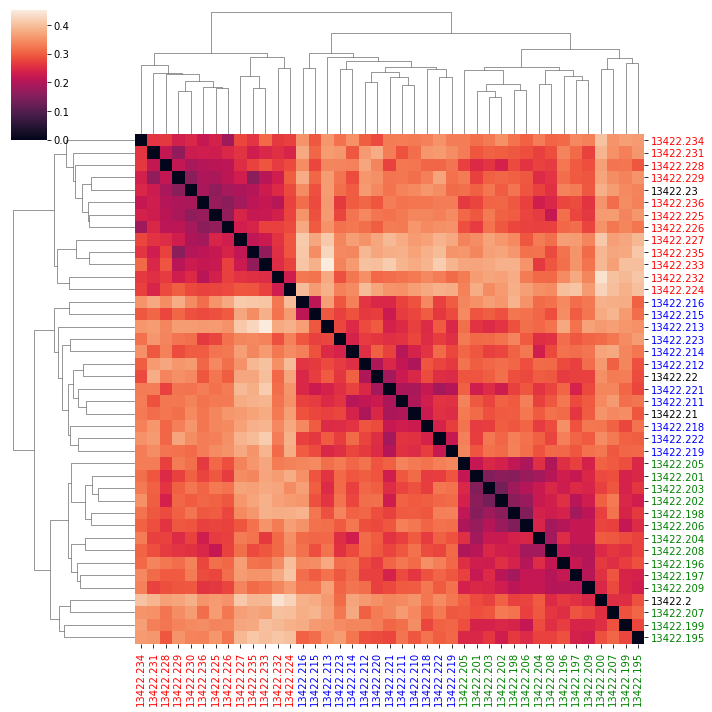

In [16]:
C57B_F4 = sns.clustermap(dm_6000gut_C57B_float, yticklabels = True, xticklabels= True)
#sns.set_style('white')
for tick in C57B_F4.ax_heatmap.get_yticklabels():
    group = meta.loc[tick.get_text()]["cage_group"]
    if group in ("CF4-1"):
        tick.set_color('green')
    elif group in ("CF4-2"):
        tick.set_color('blue')
    elif group in ("CF4-3"):
        tick.set_color('red')
    else:
        tick.set_color('black')
for tick in C57B_F4.ax_heatmap.get_xticklabels():
    group = meta.loc[tick.get_text()]["cage_group"]
    if group in ("CF4-1"):
        tick.set_color('green')
    elif group in ("CF4-2"):
        tick.set_color('blue')
    elif group in ("CF4-3"):
        tick.set_color('red')
    else:
        tick.set_color('black')
plt.savefig(work_dir + "/C57B_F4.png", transparent=False)

In [13]:
%time ! $q_path; qiime diversity filter-distance-matrix \
  --i-distance-matrix $work_dir/gut6000_beta_matrix-nocomp.qza \
  --m-metadata-file $work_dir/meta_gen_num.txt \
  --p-where "[genotype] IN ('BALB/c') AND [generation] IN ('F4')" \
  --o-filtered-distance-matrix $work_dir/gut6000_BALB_beta_matrix-nocomp.qza

%time ! $q_path; qiime tools export \
  --input-path $work_dir/gut6000_BALB_beta_matrix-nocomp.qza \
  --output-path $work_dir/gut6000_BALB_beta_matrix-nocomp_export

dm_6000gut_BALB = pd.read_csv(work_dir + "/gut6000_BALB_beta_matrix-nocomp_export/distance-matrix.tsv", sep="\t", dtype=str, index_col=0)

dm_6000gut_BALB_float = dm_6000gut_BALB.apply(pd.to_numeric)

Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_BALB_beta_matrix-nocomp.qza
CPU times: user 319 ms, sys: 48.8 ms, total: 368 ms
Wall time: 14.2 s
Exported /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_BALB_beta_matrix-nocomp.qza as DistanceMatrixDirectoryFormat to directory /homes/arehm/Documents/Thesis/JupyterNotebook/gut6000_BALB_beta_matrix-nocomp_export
CPU times: user 271 ms, sys: 58.4 ms, total: 329 ms
Wall time: 12.7 s


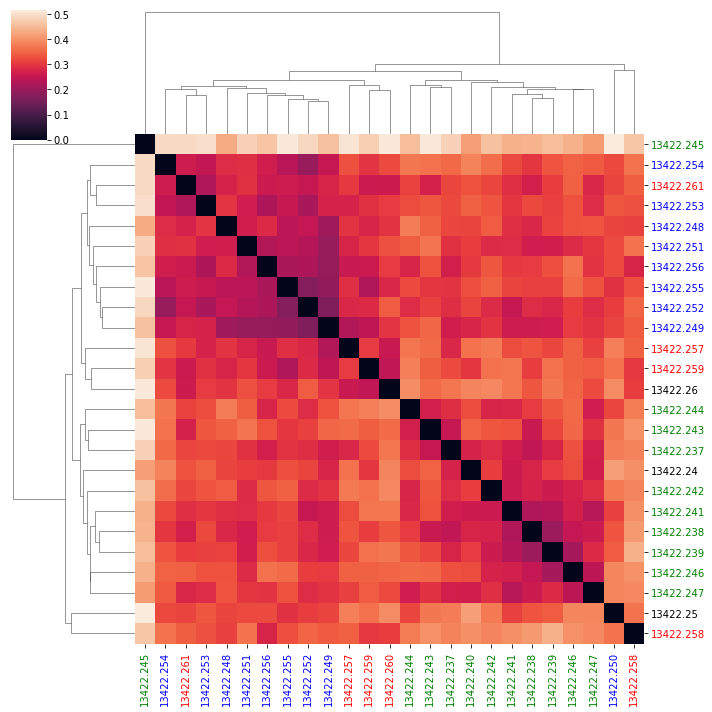

In [15]:
BALB_F4 = sns.clustermap(dm_6000gut_BALB_float, yticklabels = True, xticklabels= True)
for tick in BALB_F4.ax_heatmap.get_yticklabels():
    group = meta.loc[tick.get_text()]["cage_group"]
    if group in ("BF4-1"):
        tick.set_color('green')
    elif group in ("BF4-2"):
        tick.set_color('blue')
    elif group in ("BF4-3"):
        tick.set_color('red')
    else:
        tick.set_color('black')
for tick in BALB_F4.ax_heatmap.get_xticklabels():
    group = meta.loc[tick.get_text()]["cage_group"]
    if group in ("BF4-1"):
        tick.set_color('green')
    elif group in ("BF4-2"):
        tick.set_color('blue')
    elif group in ("BF4-3"):
        tick.set_color('red')
    else:
        tick.set_color('black')
plt.savefig(work_dir + "/BALB_F4.png", transparent=False)

In [14]:
meta['comparison'] = np.where(
    meta.index.isin(indeces), 1, 0) 

In [11]:
meta[meta['host_body_product'].isin(['UBERON:lumen of gut'])]['comparison'].value_counts()

0    330
1     24
Name: comparison, dtype: int64

In [12]:
meta.head()

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,elevation_units,empo_1,empo_2,empo_3,env_biome,env_feature,env_material,env_package,facility,father_subject_id,generation,genotype,geo_loc_name,host_age,host_age_units,host_body_habitat,host_body_product,host_body_site,host_common_name,host_height,host_height_units,host_scientific_name,host_subject_id,host_taxid,host_weight,host_weight_units,iacuc_institute,iacuc_protocol_id,latitude,latitude_units,life_stage,longitude,longitude_units,mother_subject_id,parental_cage,physical_specimen_location,physical_specimen_remaining,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,gen_number,cage_lineage,comparison
sample_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
13422.1,1,2018-04-10,RM,rm1,eppi,necropsy,2019-01-03,recipient mother,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,intestine environment,host-associated,SPF,not provided,RM,B6CF1,Germany:Duesseldorf,38,weeks,UBERON:gastrointestinal system,UBERON:lumen of gut,UBERON:colon,mouse,not provided,cm,Mus musculus,1,10090,not collected,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,recipient,room01.32,DNA in freezer03.140,TRUE,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-a9,1-a9,-1,other,0
13422.10,1,2018-11-30,PB,P1-11,eppi,necropsy,2019-03-20,motherP1,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,intestine environment,host-associated,SPF,not provided,P1,BALB/c,Germany:Duesseldorf,15,weeks,UBERON:gastrointestinal system,UBERON:lumen of gut,UBERON:colon,mouse,not provided,cm,Mus musculus,10,10090,34.3,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,P4,rm3,DNA in freezer03.140,TRUE,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-d1,3-d1,0,B1,0
13422.100,1,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,intestine environment,host-associated,SPF,not provided,F2,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:gastrointestinal system,UBERON:lumen of gut,UBERON:colon,mouse,not provided,cm,Mus musculus,100,10090,24.9,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,F2,F1-11,DNA in freezer03.140,TRUE,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-c12,NaN,2,C3,0
13422.100skin,3,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,sebum,host-associated,SPF,not provided,F2,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:skin,UBERON:sebum,UBERON:skin of external ear,mouse,not provided,cm,Mus musculus,100,10090,24.9,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,F2,F1-11,DNA in freezer03.140,TRUE,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,7-c12,7-c12,2,C3,0
13422.101,1,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,TRUE,42,meters,Host-associated,Animal,Animal distal gut,urban biome,mammalia-associated habitat,intestine environment,host-associated,SPF,not provided,F2,C57BL6/J,Germany:Duesseldorf,15,weeks,UBERON:gastrointestinal system,UBERON:lumen of gut,UBERON:colon,mouse,not provided,cm,Mus musculus,101,10090,24.7,grams,LANUV,G383/17,51.189401,Decimal degrees,adult,6.792239,Decimal degrees,F2,F1-11,DNA in freezer03.140,TRUE,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-a8,NaN,2,C3,0


In [5]:
def permanova_beta (condition, dm, comp_group):
    counts = condition[comp_group].value_counts()
    idx = condition.index
    results = permanova(dm.filter(idx), meta.loc[idx, comp_group], permutations = 9999)
    return counts, results

## Gut
Wir vergleichen alle Betadiversitätergebnisse von Maussamples aus dem Darm, mit und ohne Vergleichsmäuse. Dabei werden die Genotypen verglichen!
#### Gut with Comparison

In [7]:
dm_gut_comp = Artifact.load(work_dir + "/gut6000_beta_matrix.qza").view(DistanceMatrix)

In [8]:
genotype_dm = meta.loc[dm_gut_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]

<ipython-input-8-3d2ecf6fff89>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  genotype_dm = meta.loc[dm_gut_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


In [9]:
permanova_beta(genotype_dm, dm_gut_comp, "genotype")

(C57BL6/J    201
 BALB/c      126
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                     327
 number of groups                  2
 test statistic            39.912211
 p-value                      0.0001
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

#### Janvier vs. Düsseldorf

In [10]:
comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1])]
permanova_beta(comparison, dm_gut_comp, "genotype")

<ipython-input-10-ec8fe4cefe07>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1])]


(BALB/c      12
 C57BL6/J    12
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                      24
 number of groups                  2
 test statistic             1.746249
 p-value                      0.0742
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

Im Vergleich sind die Unterschiede zwischen den Genotypen aus Dússeldorf und Janvier nicht signifikant.

Vergleich zwischen den Balb und C57B Mäusen aus Janvier und aus Düsseldorf.

In [11]:
for genotype in ["C57BL6/J", "BALB/c"]:
    comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1]) & meta['genotype'].isin([genotype])]
    result = permanova_beta(comparison, dm_gut_comp, "geo_loc_name")
    print (f"{genotype} \n {result}")

<ipython-input-11-abec8c37dda8>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1]) & meta['genotype'].isin([genotype])]


C57BL6/J 
 (France:Janvier         6
Germany:Duesseldorf    6
Name: geo_loc_name, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      12
number of groups                  2
test statistic            11.467656
p-value                      0.0025
number of permutations         9999
Name: PERMANOVA results, dtype: object)
BALB/c 
 (France:Janvier         6
Germany:Duesseldorf    6
Name: geo_loc_name, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      12
number of groups                  2
test statistic              5.77737
p-value                      0.0027
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [12]:
for city in ["France:Janvier", "Germany:Duesseldorf"]:
    comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city])]
    result = permanova_beta(comparison, dm_gut_comp, "genotype")
    print (f"{city} \n {result}")

<ipython-input-12-d6af25f4933a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city])]


France:Janvier 
 (BALB/c      6
C57BL6/J    6
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      12
number of groups                  2
test statistic             2.688398
p-value                      0.0017
number of permutations         9999
Name: PERMANOVA results, dtype: object)
Germany:Duesseldorf 
 (BALB/c      6
C57BL6/J    6
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      12
number of groups                  2
test statistic             2.927077
p-value                      0.0026
number of permutations         9999
Name: PERMANOVA results, dtype: object)


##### BALB/c

In [12]:
for genotype in ['BALB/c', 'C57BL6/J']:
    comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]
    result = permanova_beta(comparison, dm_gut_comp, "comparison")
    print (f"BALB/c experiment + {genotype} comparison \n {result}")
    for city in ['France:Janvier', 'Germany:Duesseldorf']:
        comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]
        result = permanova_beta(comparison, dm_gut_comp, "comparison")
        print (f"BALB/c experiment + {genotype}-{city} comparison \n {result}")

<ipython-input-12-12468b98faca>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + BALB/c comparison 
 (0    114
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     126
number of groups                  2
test statistic            15.681646
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


<ipython-input-12-12468b98faca>:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + BALB/c-France:Janvier comparison 
 (0    114
1      6
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     120
number of groups                  2
test statistic            17.154228
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
BALB/c experiment + BALB/c-Germany:Duesseldorf comparison 
 (0    114
1      6
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     120
number of groups                  2
test statistic             6.801448
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
BALB/c experiment + C57BL6/J comparison 
 (0    114
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     12

In [14]:
for city in ['France:Janvier', 'Germany:Duesseldorf']:
    comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]
    result = permanova_beta(comparison, dm_gut_comp, "comparison")
    print (f"BALB/c experiment + whole {city} comparison \n {result}")

<ipython-input-14-ee60f9977d72>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


BALB/c experiment + whole France:Janvier comparison 
 (0    114
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     126
number of groups                  2
test statistic            31.071322
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
BALB/c experiment + whole Germany:Duesseldorf comparison 
 (0    114
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     126
number of groups                  2
test statistic            11.459907
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [15]:
comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | meta['comparison'].isin([1])]
result = permanova_beta(comparison, dm_gut_comp, "comparison")
print (f"BALB/c experiment + whole comparison \n {result}")

<ipython-input-15-66eca88562f5>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | meta['comparison'].isin([1])]


BALB/c experiment + whole comparison 
 (0    114
1     24
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     138
number of groups                  2
test statistic            26.492338
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [16]:
comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([0])]
result = permanova_beta(comparison, dm_gut_comp, "genotype")
print (f"BALB/c experiment + C57BL6/J \n {result}")

<ipython-input-16-ed4cfc82819f>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([0])]


BALB/c experiment + C57BL6/J 
 (C57BL6/J    189
BALB/c      114
B6CF1         6
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     309
number of groups                  3
test statistic            24.828435
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


##### C57BL6/J

In [17]:
for genotype in ['BALB/c', 'C57BL6/J']:
    comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]
    result = permanova_beta(comparison, dm_gut_comp, "comparison")
    print (f"C57BL6/J experiment + {genotype} comparison \n {result}")
    for city in ['France:Janvier', 'Germany:Duesseldorf']:
        comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]
        result = permanova_beta(comparison, dm_gut_comp, "comparison")
        print (f"C57BL6/J experiment + {genotype}-{city} comparison \n {result}")

<ipython-input-17-48f49e225223>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + BALB/c comparison 
 (0    189
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     201
number of groups                  2
test statistic            14.617701
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


<ipython-input-17-48f49e225223>:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + BALB/c-France:Janvier comparison 
 (0    189
1      6
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     195
number of groups                  2
test statistic            15.577131
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
C57BL6/J experiment + BALB/c-Germany:Duesseldorf comparison 
 (0    189
1      6
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     195
number of groups                  2
test statistic             6.177109
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
C57BL6/J experiment + C57BL6/J comparison 
 (0    189
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                 

In [18]:
for city in ['France:Janvier', 'Germany:Duesseldorf']:
    comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]
    result = permanova_beta(comparison, dm_gut_comp, "comparison")
    print (f"C57BL6/J experiment + whole {city} comparison \n {result}")

<ipython-input-18-52b4cd781f72>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


C57BL6/J experiment + whole France:Janvier comparison 
 (0    189
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     201
number of groups                  2
test statistic            28.776554
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
C57BL6/J experiment + whole Germany:Duesseldorf comparison 
 (0    189
1     12
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     201
number of groups                  2
test statistic              8.47173
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [19]:
comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | meta['comparison'].isin([1])]
result = permanova_beta(comparison, dm_gut_comp, "comparison")
print (f"C57BL6/J experiment + whole comparison \n {result}")

<ipython-input-19-edce19eb2211>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | meta['comparison'].isin([1])]


C57BL6/J experiment + whole comparison 
 (0    189
1     24
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     213
number of groups                  2
test statistic            22.193579
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [20]:
comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([0])]
result = permanova_beta(comparison, dm_gut_comp, "genotype")
print (f"C57BL6/J experiment + BALB/c \n {result}")

<ipython-input-20-1d2674cf98c9>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_comp.ids,:][meta['comparison'].isin([0])]


C57BL6/J experiment + BALB/c 
 (C57BL6/J    189
BALB/c      114
B6CF1         6
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     309
number of groups                  3
test statistic            24.828435
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


#### Gut without comparison

In [133]:
dm_gut_no_comp = Artifact.load(work_dir + "/gut6000_beta_matrix-nocomp.qza").view(DistanceMatrix)

In [8]:
meta['genotype'].value_counts()

C57BL6/J          416
BALB/c            264
not applicable     68
marmoset           20
B6CF1              12
Name: genotype, dtype: int64

In [9]:
genotype_dm_no_comp = meta.loc[dm_gut_no_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]

/tmp/ipykernel_2406560/1653512381.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  genotype_dm_no_comp = meta.loc[dm_gut_no_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


In [10]:
permanova_beta(genotype_dm_no_comp, dm_gut_no_comp, 'genotype')

(C57BL6/J    189
 BALB/c      114
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                     303
 number of groups                  2
 test statistic            47.595784
 p-value                      0.0001
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

##### cage lineage

In [134]:
#all
lineage_combination = list(itertools.combinations(['C1','C2','C3','B1','B2','B3'], 2))
count = 0
for lineage in lineage_combination:
    count += 1
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]
    result = permanova_beta(comparison, dm_gut_no_comp, 'cage_lineage')
    print(f"Cage lineage pair {lineage} \n {result} \n {count}")

/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'C2') 
 (C1    84
C2    55
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     139
number of groups                  2
test statistic             4.988952
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'C3') 
 (C1    84
C3    50
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     134
number of groups                  2
test statistic            16.421159
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'B1') 
 (C1    84
B1    39
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     123
number of groups                  2
test statistic            20.697807
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'B2') 
 (C1    84
B2    47
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     131
number of groups                  2
test statistic            25.824189
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 4


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'B3') 
 (C1    84
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     112
number of groups                  2
test statistic            22.244485
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 5


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C2', 'C3') 
 (C2    55
C3    50
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     105
number of groups                  2
test statistic            13.517849
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 6


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C2', 'B1') 
 (C2    55
B1    39
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      94
number of groups                  2
test statistic            17.604859
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 7


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C2', 'B2') 
 (C2    55
B2    47
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     102
number of groups                  2
test statistic            21.243443
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 8


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C2', 'B3') 
 (C2    55
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      83
number of groups                  2
test statistic            18.920318
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 9


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C3', 'B1') 
 (C3    50
B1    39
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      89
number of groups                  2
test statistic            26.815206
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 10


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C3', 'B2') 
 (C3    50
B2    47
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      97
number of groups                  2
test statistic            30.938699
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 11


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C3', 'B3') 
 (C3    50
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      78
number of groups                  2
test statistic            29.021847
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 12


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B1', 'B2') 
 (B2    47
B1    39
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      86
number of groups                  2
test statistic             8.442085
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 13


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B1', 'B3') 
 (B1    39
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      67
number of groups                  2
test statistic             9.343901
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 14


/tmp/ipykernel_2006513/1281138848.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B2', 'B3') 
 (B2    47
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      75
number of groups                  2
test statistic             2.883912
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 15


In [135]:
#B6J
lineage_combination = list(itertools.combinations(['C1','C2','C3'], 2))
count = 0
for lineage in lineage_combination:
    count += 1
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['cage_lineage'].isin(lineage)]
    result = permanova_beta(comparison, dm_gut_no_comp, 'cage_lineage')
    print(f"Cage lineage pair {lineage} \n {result} \n {count}")

/tmp/ipykernel_2006513/2850958822.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'C2') 
 (C1    84
C2    55
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     139
number of groups                  2
test statistic             4.988952
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1


/tmp/ipykernel_2006513/2850958822.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C1', 'C3') 
 (C1    84
C3    50
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     134
number of groups                  2
test statistic            16.421159
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_2006513/2850958822.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('C2', 'C3') 
 (C2    55
C3    50
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     105
number of groups                  2
test statistic            13.517849
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3


In [136]:
#B6J
lineage_combination = list(itertools.combinations(['B1','B2','B3'], 2))
count = 0
for lineage in lineage_combination:
    count += 1
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['cage_lineage'].isin(lineage)]
    result = permanova_beta(comparison, dm_gut_no_comp, 'cage_lineage')
    print(f"Cage lineage pair {lineage} \n {result} \n {count}")

/tmp/ipykernel_2006513/1701602728.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B1', 'B2') 
 (B2    47
B1    39
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      86
number of groups                  2
test statistic             8.442085
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1


/tmp/ipykernel_2006513/1701602728.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B1', 'B3') 
 (B1    39
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      67
number of groups                  2
test statistic             9.343901
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_2006513/1701602728.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['cage_lineage'].isin(lineage)]


Cage lineage pair ('B2', 'B3') 
 (B2    47
B3    28
Name: cage_lineage, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      75
number of groups                  2
test statistic             2.883912
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3


In [11]:
genotype_dm_no_comp = meta.loc[dm_gut_no_comp.ids,:][meta['cage_lineage'].isin(['C1', 'C3'])]
permanova_beta(genotype_dm_no_comp, dm_gut_no_comp, 'cage_lineage')

/tmp/ipykernel_2406560/1742409393.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  genotype_dm_no_comp = meta.loc[dm_gut_no_comp.ids,:][meta['cage_lineage'].isin(['C1', 'C3'])]


(C1    84
 C3    50
 Name: cage_lineage, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                     134
 number of groups                  2
 test statistic            16.421159
 p-value                      0.0001
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

##### Generations

In [22]:
generations_combination = list(itertools.combinations(['P1', 'F1', 'F2', 'F3', 'F4', 'F5'], 2))

In [13]:
generations_combination

[('P1', 'F1'),
 ('P1', 'F2'),
 ('P1', 'F3'),
 ('P1', 'F4'),
 ('P1', 'F5'),
 ('F1', 'F2'),
 ('F1', 'F3'),
 ('F1', 'F4'),
 ('F1', 'F5'),
 ('F2', 'F3'),
 ('F2', 'F4'),
 ('F2', 'F5'),
 ('F3', 'F4'),
 ('F3', 'F5'),
 ('F4', 'F5')]

In [14]:
test = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])]
test['generation'].value_counts()
test1 = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])]
test1['generation'].value_counts()

/tmp/ipykernel_2406560/2933395914.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  test = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])]
/tmp/ipykernel_2406560/2933395914.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  test1 = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])]


F3    45
F4    41
F2    38
F1    34
P1    16
F5    15
Name: generation, dtype: int64

In [15]:
count = 0
for generation in generations_combination:
    count += 1
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
    result = permanova_beta(comparison, dm_gut_no_comp, 'generation')
    print(f"BALB/c generation pair {generation} \n {result} \n {count}")

/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F1') 
 (F1    11
P1     5
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             1.287169
p-value                      0.1677
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1
BALB/c generation pair ('P1', 'F2') 
 (F2    17
P1     5
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      22
number of groups                  2
test statistic             1.413493
p-value                      0.0763
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F3') 
 (F3    22
P1     5
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      27
number of groups                  2
test statistic             2.491237
p-value                      0.0005
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3
BALB/c generation pair ('P1', 'F4') 
 (F4    25
P1     5
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      30
number of groups                  2
test statistic             2.975939
p-value                      0.0003
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 4


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F5') 
 (F5    34
P1     5
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      39
number of groups                  2
test statistic             3.364893
p-value                      0.0005
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 5
BALB/c generation pair ('F1', 'F2') 
 (F2    17
F1    11
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      28
number of groups                  2
test statistic             1.825917
p-value                      0.0117
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 6


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F1', 'F3') 
 (F3    22
F1    11
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      33
number of groups                  2
test statistic             2.811631
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 7


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F1', 'F4') 
 (F4    25
F1    11
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      36
number of groups                  2
test statistic             2.636733
p-value                      0.0006
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 8


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F1', 'F5') 
 (F5    34
F1    11
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      45
number of groups                  2
test statistic             2.880778
p-value                      0.0006
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 9


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F2', 'F3') 
 (F3    22
F2    17
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      39
number of groups                  2
test statistic             1.974299
p-value                      0.0054
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 10


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F2', 'F4') 
 (F4    25
F2    17
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      42
number of groups                  2
test statistic             2.144706
p-value                      0.0024
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 11


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F2', 'F5') 
 (F5    34
F2    17
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      51
number of groups                  2
test statistic             3.436828
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 12


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F3', 'F4') 
 (F4    25
F3    22
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      47
number of groups                  2
test statistic             2.427081
p-value                      0.0015
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 13


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F3', 'F5') 
 (F5    34
F3    22
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      56
number of groups                  2
test statistic             2.776279
p-value                      0.0006
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 14


/tmp/ipykernel_2406560/2989188860.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F4', 'F5') 
 (F5    34
F4    25
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      59
number of groups                  2
test statistic             2.381287
p-value                      0.0015
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 15


In [16]:
print(0.05 /  15)

0.0033333333333333335


In [17]:
count = 0
for generation in generations_combination:
    count += 1
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]
    result = permanova_beta(comparison, dm_gut_no_comp, 'generation')
    print(f"C57BL6/J generation pair {generation} \n {result} \n {count}")

/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F1') 
 (F1    34
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      50
number of groups                  2
test statistic             3.151606
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F2') 
 (F2    38
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      54
number of groups                  2
test statistic             4.161222
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F3') 
 (F3    45
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      61
number of groups                  2
test statistic             4.970546
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F4') 
 (F4    41
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      57
number of groups                  2
test statistic              6.98395
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 4


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F5') 
 (P1    16
F5    15
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      31
number of groups                  2
test statistic             7.300383
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 5


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F2') 
 (F2    38
F1    34
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      72
number of groups                  2
test statistic              2.08578
p-value                      0.0021
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 6


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F3') 
 (F3    45
F1    34
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      79
number of groups                  2
test statistic             5.202412
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 7


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F4') 
 (F4    41
F1    34
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      75
number of groups                  2
test statistic             7.678208
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 8


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F5') 
 (F1    34
F5    15
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      49
number of groups                  2
test statistic             9.137826
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 9


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F3') 
 (F3    45
F2    38
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      83
number of groups                  2
test statistic             3.784693
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 10


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F4') 
 (F4    41
F2    38
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      79
number of groups                  2
test statistic             5.795542
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 11


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F5') 
 (F2    38
F5    15
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      53
number of groups                  2
test statistic             7.428671
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 12


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F3', 'F4') 
 (F3    45
F4    41
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      86
number of groups                  2
test statistic             2.356916
p-value                      0.0024
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 13


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F3', 'F5') 
 (F3    45
F5    15
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      60
number of groups                  2
test statistic             4.014463
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 14


/tmp/ipykernel_2406560/3483370448.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F4', 'F5') 
 (F4    41
F5    15
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      56
number of groups                  2
test statistic             3.782551
p-value                      0.0003
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 15


##### Genotype Per Generation

In [18]:
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]
    result = permanova_beta(comparison, dm_gut_no_comp, 'genotype')
    print(f"{generation} \n {result}")

/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


P1 
 (C57BL6/J    16
BALB/c       5
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      21
number of groups                  2
test statistic             2.886522
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F1 
 (C57BL6/J    34
BALB/c      11
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      45
number of groups                  2
test statistic             7.493444
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F2 
 (C57BL6/J    38
BALB/c      17
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      55
number of groups                  2
test statistic             8.452908
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F3 
 (C57BL6/J    45
BALB/c      22
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      67
number of groups                  2
test statistic            11.552075
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F4 
 (C57BL6/J    41
BALB/c      25
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      66
number of groups                  2
test statistic            15.994638
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_2406560/3677679578.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F5 
 (BALB/c      34
C57BL6/J    15
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      49
number of groups                  2
test statistic            12.055787
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


##### Cage Groups BALB/c

In [35]:
cg_1 = list(itertools.combinations(['BF1-1', 'BF1-2'], 2))
cg_2 = list(itertools.combinations(['BF2-1', 'BF2-2'], 2))
cg_3 = list(itertools.combinations(['BF3-1', 'BF3-2', 'BF3-3'], 2))
cg_4 = list(itertools.combinations(['BF4-1', 'BF4-2', 'BF4-3'], 2))
cg_5 = list(itertools.combinations(['BF5-1', 'BF5-2', 'BF5-3'], 2))
cgB_list = [cg_1, cg_2, cg_3, cg_4, cg_5]

In [36]:
for cg_generation in cgB_list:
    for cg in cg_generation:
        comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['BALB/c'])]
        result = permanova_beta(comparison, dm_gut_no_comp, 'cage_group')
        print(f"{cg} \n {result}")

<ipython-input-36-4718a7e6c959>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['BALB/c'])]


('BF1-1', 'BF1-2') 
 (BF1-2    6
BF1-1    5
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      11
number of groups                  2
test statistic             1.682749
p-value                       0.018
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF2-1', 'BF2-2') 
 (BF2-2    11
BF2-1     6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      17
number of groups                  2
test statistic             2.630615
p-value                      0.0003
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF3-1', 'BF3-2') 
 (BF3-2    10
BF3-1     3
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      13
number of groups                  2
test statistic             2.767963
p-va

##### Cage Groups C57BL6/J

In [37]:
cg_1 = list(itertools.combinations(['CF1-1', 'CF1-2', 'CF1-3'], 2))
cg_2 = list(itertools.combinations(['CF2-1', 'CF2-2', 'CF2-3'], 2))
cg_3 = list(itertools.combinations(['CF3-1', 'CF3-2', 'CF3-3'], 2))
cg_4 = list(itertools.combinations(['CF4-1', 'CF4-2', 'CF4-3'], 2))
cg_5 = list(itertools.combinations(['CF5-1', 'CF5-2'], 2))
cgC_list = [cg_1, cg_2, cg_3, cg_4, cg_5]

In [38]:
for cg_generation in cgC_list:
    for cg in cg_generation:
        comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['C57BL6/J'])]
        result = permanova_beta(comparison, dm_gut_no_comp, 'cage_group')
        print(f"{cg} \n {result}")

<ipython-input-38-c34502b7a64e>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['C57BL6/J'])]


('CF1-1', 'CF1-2') 
 (CF1-2    15
CF1-1    11
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      26
number of groups                  2
test statistic             2.392625
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF1-3') 
 (CF1-1    11
CF1-3     8
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      19
number of groups                  2
test statistic             5.335409
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-2', 'CF1-3') 
 (CF1-2    15
CF1-3     8
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      23
number of groups                  2
test statistic              5.03508
p-

##### Cage-Columns BALB/c

In [39]:
cb_1 = list(itertools.combinations(['BF1-1', 'BF2-1', 'BF3-1', 'BF4-1', 'BF5-1', 'PB', 'RM'], 2))
cb_2 = list(itertools.combinations(['BF1-2', 'BF2-2', 'BF3-2', 'BF4-2', 'BF5-2', 'PB', 'RM'], 2))
cb_3 = list(itertools.combinations(['BF1-2', 'BF2-2', 'BF3-3', 'BF4-3', 'BF5-3', 'PB', 'RM'], 2))
ccB_list = [cb_1, cb_2, cb_3]

In [40]:
for cg_column in ccB_list:
    for column in cg_column:
        print(column)
        comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['BALB/c', 'B6CF1'])]
        result = permanova_beta(comparison, dm_gut_no_comp, 'cage_group')
        print(result)

('BF1-1', 'BF2-1')


<ipython-input-40-ec5328eb64dc>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['BALB/c', 'B6CF1'])]


(BF2-1    6
BF1-1    5
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      11
number of groups                  2
test statistic             1.012418
p-value                      0.4783
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF1-1', 'BF3-1')
(BF1-1    5
BF3-1    3
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       8
number of groups                  2
test statistic             1.352036
p-value                      0.1778
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF1-1', 'BF4-1')
(BF4-1    11
BF1-1     5
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             2.378737
p-value                      0.

##### Cage-Columns C57BL6/J

In [41]:
cc_1 = list(itertools.combinations(['CF1-1', 'CF2-1', 'CF3-1', 'CF4-1', 'CF5-1', 'PC', 'RM'], 2))
cc_2 = list(itertools.combinations(['CF1-2', 'CF2-2', 'CF3-2', 'CF4-2', 'CF5-1', 'PC', 'RM'], 2))
cc_3 = list(itertools.combinations(['CF1-3', 'CF2-3', 'CF3-3', 'CF4-3', 'CF5-2', 'PC', 'RM'], 2))
ccC_list = [cc_1, cc_2, cc_3]

In [42]:
for cg_column in ccC_list:
    for column in cg_column:
        comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['C57BL6/J', 'B6CF1'])]
        result = permanova_beta(comparison, dm_gut_no_comp, 'cage_group')
        print(f"{column} \n {result}")

<ipython-input-42-9d9bc6740cae>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['C57BL6/J', 'B6CF1'])]


('CF1-1', 'CF2-1') 
 (CF2-1    16
CF1-1    11
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      27
number of groups                  2
test statistic             2.077215
p-value                      0.0018
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF3-1') 
 (CF3-1    17
CF1-1    11
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      28
number of groups                  2
test statistic             3.059452
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF4-1') 
 (CF4-1    15
CF1-1    11
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      26
number of groups                  2
test statistic              6.37608
p-

##### Sex in each generation per genotype

In [43]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['BALB/c'])]
    result = permanova_beta(comparison, dm_gut_no_comp, 'sex')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-43-588175f0af1b>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['BALB/c'])]


P1 
 (female    4
male      1
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       5
number of groups                  2
test statistic             0.944469
p-value                      0.7967
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (male      7
female    4
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      11
number of groups                  2
test statistic             1.085202
p-value                        0.36
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (female    12
male       5
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      17
number of groups                  2
test statistic              0.90748
p-value                      0.6008
number of permutations         99

In [44]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['C57BL6/J'])]
    result = permanova_beta(comparison, dm_gut_no_comp, 'sex')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-44-9d86ca42e1e9>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['C57BL6/J'])]


P1 
 (male      9
female    7
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             1.829399
p-value                      0.0213
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (male      20
female    14
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      34
number of groups                  2
test statistic             1.677074
p-value                      0.0277
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (female    20
male      18
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      38
number of groups                  2
test statistic             2.105956
p-value                      0.0031
number of permutations         

##### Genotype in each generation per sex

In [45]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['female'])]
    result = permanova_beta(comparison, dm_gut_no_comp, 'genotype')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-45-5addb9c85bb2>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['female'])]


P1 
 (C57BL6/J    7
BALB/c      4
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      11
number of groups                  2
test statistic             2.478924
p-value                      0.0037
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (C57BL6/J    14
BALB/c       4
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      18
number of groups                  2
test statistic             3.953152
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (C57BL6/J    20
BALB/c      12
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      32
number of groups                  2
test statistic             5.837884
p-value                      0.0001
numb

In [46]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['male'])]
    result = permanova_beta(comparison, dm_gut_no_comp, 'genotype')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-46-a381c122af67>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_gut_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['male'])]


P1 
 (C57BL6/J    9
BALB/c      1
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      10
number of groups                  2
test statistic             1.651151
p-value                      0.0983
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (C57BL6/J    20
BALB/c       7
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      27
number of groups                  2
test statistic             4.989064
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (C57BL6/J    18
BALB/c       5
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      23
number of groups                  2
test statistic             3.300715
p-value                      0.0001
numb

## Sebum

#### Sebum with Comparison

In [6]:
dm_sebum_comp = Artifact.load(work_dir + "/sebum_beta_matrix.qza").view(DistanceMatrix)
gen_comparison_sebum = meta.loc[dm_sebum_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]
permanova_beta(gen_comparison_sebum, dm_sebum_comp, "genotype")

/tmp/ipykernel_3006441/3733600100.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  gen_comparison_sebum = meta.loc[dm_sebum_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


(C57BL6/J    169
 BALB/c       95
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                     264
 number of groups                  2
 test statistic             3.092623
 p-value                      0.0001
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

#### Janvier vs. Düsseldorf

In [7]:
test = meta[meta['comparison'].isin([1]) & meta['host_body_product'].isin(['UBERON:sebum'])]
test['geo_loc_name'].value_counts()

Germany:Duesseldorf    24
France:Janvier         12
Name: geo_loc_name, dtype: int64

In [8]:
comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1])]
permanova_beta(comparison, dm_sebum_comp, "genotype")

/tmp/ipykernel_3006441/3831783052.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1])]


(C57BL6/J    9
 BALB/c      7
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                      16
 number of groups                  2
 test statistic             1.131579
 p-value                      0.2414
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

In [9]:
for genotype in ["C57BL6/J", "BALB/c"]:
    comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['genotype'].isin([genotype])]
    result = permanova_beta(comparison, dm_sebum_comp, "geo_loc_name")
    print (f"{genotype} \n {result}")

/tmp/ipykernel_3006441/487032913.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['genotype'].isin([genotype])]


C57BL6/J 
 (France:Janvier         5
Germany:Duesseldorf    4
Name: geo_loc_name, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       9
number of groups                  2
test statistic             1.382886
p-value                      0.0616
number of permutations         9999
Name: PERMANOVA results, dtype: object)
BALB/c 
 (Germany:Duesseldorf    4
France:Janvier         3
Name: geo_loc_name, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       7
number of groups                  2
test statistic             1.780287
p-value                      0.0273
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/487032913.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['genotype'].isin([genotype])]


In [10]:
for city in ["France:Janvier", "Germany:Duesseldorf"]:
    comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city])]
    result = permanova_beta(comparison, dm_sebum_comp, "genotype")
    print (f"{city} \n {result}")

/tmp/ipykernel_3006441/964904607.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city])]


France:Janvier 
 (C57BL6/J    5
BALB/c      3
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       8
number of groups                  2
test statistic             1.111123
p-value                      0.2727
number of permutations         9999
Name: PERMANOVA results, dtype: object)
Germany:Duesseldorf 
 (BALB/c      4
C57BL6/J    4
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       8
number of groups                  2
test statistic             1.214593
p-value                      0.2036
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/964904607.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city])]


##### BALB/c

In [11]:
for genotype in ['BALB/c', 'C57BL6/J']:
    comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]
    result = permanova_beta(comparison, dm_sebum_comp, "comparison")
    print (f"BALB/c experiment + {genotype} comparison \n {result}")
    for city in ['France:Janvier', 'Germany:Duesseldorf']:
        comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]
        result = permanova_beta(comparison, dm_sebum_comp, "comparison")
        print (f"BALB/c experiment + {genotype}-{city} comparison \n {result}")

/tmp/ipykernel_3006441/428689594.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + BALB/c comparison 
 (0    88
1     7
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      95
number of groups                  2
test statistic             1.991666
p-value                      0.0009
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/428689594.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + BALB/c-France:Janvier comparison 
 (0    88
1     3
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      91
number of groups                  2
test statistic             1.259688
p-value                      0.0684
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/428689594.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + BALB/c-Germany:Duesseldorf comparison 
 (0    88
1     4
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      92
number of groups                  2
test statistic             2.536815
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/428689594.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + C57BL6/J comparison 
 (0    88
1     9
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      97
number of groups                  2
test statistic              2.72261
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/428689594.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + C57BL6/J-France:Janvier comparison 
 (0    88
1     5
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      93
number of groups                  2
test statistic             2.066971
p-value                      0.0005
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/428689594.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


BALB/c experiment + C57BL6/J-Germany:Duesseldorf comparison 
 (0    88
1     4
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      92
number of groups                  2
test statistic             2.046249
p-value                      0.0007
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [12]:
for city in ['France:Janvier', 'Germany:Duesseldorf']:
    comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]
    result = permanova_beta(comparison, dm_sebum_comp, "comparison")
    print (f"BALB/c experiment + whole {city} comparison \n {result}")

/tmp/ipykernel_3006441/952476864.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


BALB/c experiment + whole France:Janvier comparison 
 (0    88
1     8
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      96
number of groups                  2
test statistic             2.043175
p-value                      0.0003
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/952476864.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


BALB/c experiment + whole Germany:Duesseldorf comparison 
 (0    88
1     8
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      96
number of groups                  2
test statistic             3.494534
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [13]:
comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | meta['comparison'].isin([1])]
result = permanova_beta(comparison, dm_sebum_comp, "comparison")
print (f"BALB/c experiment + whole comparison \n {result}")

/tmp/ipykernel_3006441/2628515971.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c'])) | meta['comparison'].isin([1])]


BALB/c experiment + whole comparison 
 (0    88
1    16
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     104
number of groups                  2
test statistic             3.333096
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [14]:
comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]
result = permanova_beta(comparison, dm_sebum_comp, "genotype")
print (f"BALB/c experiment + C57BL6/J \n {result}")

/tmp/ipykernel_3006441/3999902444.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


BALB/c experiment + C57BL6/J 
 (C57BL6/J    160
BALB/c       88
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     248
number of groups                  2
test statistic             2.952036
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


##### C57BL6/J

In [15]:
for genotype in ['BALB/c', 'C57BL6/J']:
    comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]
    result = permanova_beta(comparison, dm_sebum_comp, "comparison")
    print (f"C57BL6/J experiment + {genotype} comparison \n {result}")
    for city in ['France:Janvier', 'Germany:Duesseldorf']:
        comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]
        result = permanova_beta(comparison, dm_sebum_comp, "comparison")
        print (f"C57BL6/J experiment + {genotype}-{city} comparison \n {result}")

/tmp/ipykernel_3006441/2800553577.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + BALB/c comparison 
 (0    160
1      7
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     167
number of groups                  2
test statistic             2.289784
p-value                      0.0005
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2800553577.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + BALB/c-France:Janvier comparison 
 (0    160
1      3
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     163
number of groups                  2
test statistic             1.422367
p-value                      0.0372
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2800553577.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + BALB/c-Germany:Duesseldorf comparison 
 (0    160
1      4
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     164
number of groups                  2
test statistic              2.69054
p-value                      0.0004
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2800553577.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + C57BL6/J comparison 
 (0    160
1      9
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     169
number of groups                  2
test statistic             2.444088
p-value                      0.0003
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2800553577.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + C57BL6/J-France:Janvier comparison 
 (0    160
1      5
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     165
number of groups                  2
test statistic             1.950999
p-value                      0.0019
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2800553577.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]) & meta['genotype'].isin([genotype]))]


C57BL6/J experiment + C57BL6/J-Germany:Duesseldorf comparison 
 (0    160
1      4
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     164
number of groups                  2
test statistic             1.858181
p-value                      0.0035
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [16]:
for city in ['France:Janvier', 'Germany:Duesseldorf']:
    comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]
    result = permanova_beta(comparison, dm_sebum_comp, "comparison")
    print (f"C57BL6/J experiment + whole {city} comparison \n {result}")

/tmp/ipykernel_3006441/3660782641.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


C57BL6/J experiment + whole France:Janvier comparison 
 (0    160
1      8
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     168
number of groups                  2
test statistic             2.087383
p-value                      0.0014
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/3660782641.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | (meta['comparison'].isin([1]) & meta['geo_loc_name'].isin([city]))]


C57BL6/J experiment + whole Germany:Duesseldorf comparison 
 (0    160
1      8
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     168
number of groups                  2
test statistic             3.489285
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [17]:
comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | meta['comparison'].isin([1])]
result = permanova_beta(comparison, dm_sebum_comp, "comparison")
print (f"C57BL6/J experiment + whole comparison \n {result}")

/tmp/ipykernel_3006441/4095772956.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][(meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J'])) | meta['comparison'].isin([1])]


C57BL6/J experiment + whole comparison 
 (0    160
1     16
Name: comparison, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     176
number of groups                  2
test statistic             3.412378
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


In [18]:
comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]
result = permanova_beta(comparison, dm_sebum_comp, "genotype")
print (f"C57BL6/J experiment + BALB/c experiment \n {result}")

/tmp/ipykernel_3006441/84013002.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


C57BL6/J experiment + BALB/c experiment 
 (C57BL6/J    160
BALB/c       88
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                     248
number of groups                  2
test statistic             2.952036
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object)


#### Sebum without Comparison

In [19]:
dm_sebum_no_comp = Artifact.load(work_dir + "/sebum_beta_matrix-nocomp.qza").view(DistanceMatrix)
gen_comparison_sebum = meta.loc[dm_sebum_no_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]
permanova_beta(gen_comparison_sebum, dm_sebum_no_comp, "genotype")

/tmp/ipykernel_3006441/3258555897.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  gen_comparison_sebum = meta.loc[dm_sebum_no_comp.ids,:][meta['genotype'].isin(['C57BL6/J', 'BALB/c'])]


(C57BL6/J    161
 BALB/c       89
 Name: genotype, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                     250
 number of groups                  2
 test statistic             2.936178
 p-value                      0.0001
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

In [20]:
dm_sebum_no_comp = Artifact.load(work_dir + "/sebum_beta_matrix-nocomp.qza").view(DistanceMatrix)
foster_comparison_sebum = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin(['RM', 'P1'])]
permanova_beta(foster_comparison_sebum, dm_sebum_no_comp, "generation")

/tmp/ipykernel_3006441/3683156894.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  foster_comparison_sebum = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin(['RM', 'P1'])]


(P1    20
 RM     4
 Name: generation, dtype: int64,
 method name               PERMANOVA
 test statistic name        pseudo-F
 sample size                      24
 number of groups                  2
 test statistic              0.93505
 p-value                      0.5621
 number of permutations         9999
 Name: PERMANOVA results, dtype: object)

##### Generation per Genotype

In [23]:
count = 0
for generation in generations_combination:
    count += 1
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'generation')
    print(f"BALB/c generation pair {generation} \n {result} \n {count}")

/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F1') 
 (P1    4
F1    4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       8
number of groups                  2
test statistic             1.887906
p-value                      0.0305
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1
BALB/c generation pair ('P1', 'F2') 
 (F2    9
P1    4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      13
number of groups                  2
test statistic             2.917187
p-value                      0.0016
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F3') 
 (F3    21
P1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      25
number of groups                  2
test statistic             3.676564
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3
BALB/c generation pair ('P1', 'F4') 
 (F4    21
P1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      25
number of groups                  2
test statistic             3.272905
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 4


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('P1', 'F5') 
 (F5    30
P1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      34
number of groups                  2
test statistic             3.378593
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 5


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F1', 'F2') 
 (F2    9
F1    4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      13
number of groups                  2
test statistic             1.405915
p-value                       0.036
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 6
BALB/c generation pair ('F1', 'F3') 
 (F3    21
F1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      25
number of groups                  2
test statistic             1.765827
p-value                      0.0012
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 7


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F1', 'F4') 
 (F4    21
F1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      25
number of groups                  2
test statistic             1.314732
p-value                      0.0434
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 8
BALB/c generation pair ('F1', 'F5') 
 (F5    30
F1     4
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      34
number of groups                  2
test statistic             1.503427
p-value                      0.0021
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 9


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]
/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F2', 'F3') 
 (F3    21
F2     9
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      30
number of groups                  2
test statistic             1.228903
p-value                      0.1011
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 10
BALB/c generation pair ('F2', 'F4') 
 (F4    21
F2     9
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      30
number of groups                  2
test statistic             1.133884
p-value                      0.1857
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 11


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F2', 'F5') 
 (F5    30
F2     9
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      39
number of groups                  2
test statistic             1.848584
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 12


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F3', 'F4') 
 (F3    21
F4    21
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      42
number of groups                  2
test statistic              1.24938
p-value                      0.0761
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 13


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F3', 'F5') 
 (F5    30
F3    21
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      51
number of groups                  2
test statistic             2.489463
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 14


/tmp/ipykernel_3006441/3865862490.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['BALB/c']) & meta['generation'].isin(generation)]


BALB/c generation pair ('F4', 'F5') 
 (F5    30
F4    21
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      51
number of groups                  2
test statistic             1.576863
p-value                      0.0018
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 15


In [24]:
count = 0
for generation in generations_combination:
    count += 1
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'generation')
    print(f"C57BL6/J generation pair {generation} \n {result} \n {count}")

/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F1') 
 (F1    22
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      38
number of groups                  2
test statistic             2.108824
p-value                      0.0013
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 1


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F2') 
 (F2    29
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      45
number of groups                  2
test statistic             3.916448
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 2


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F3') 
 (F3    41
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      57
number of groups                  2
test statistic             3.125391
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 3


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F4') 
 (F4    39
P1    16
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      55
number of groups                  2
test statistic             3.057411
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 4


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('P1', 'F5') 
 (P1    16
F5    14
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      30
number of groups                  2
test statistic             2.100589
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 5


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F2') 
 (F2    29
F1    22
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      51
number of groups                  2
test statistic             1.657988
p-value                      0.0047
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 6


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F3') 
 (F3    41
F1    22
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      63
number of groups                  2
test statistic             1.039166
p-value                      0.3543
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 7


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F4') 
 (F4    39
F1    22
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      61
number of groups                  2
test statistic             1.085184
p-value                      0.2712
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 8


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F1', 'F5') 
 (F1    22
F5    14
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      36
number of groups                  2
test statistic             1.727631
p-value                      0.0033
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 9


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F3') 
 (F3    41
F2    29
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      70
number of groups                  2
test statistic             1.473687
p-value                      0.0239
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 10


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F4') 
 (F4    39
F2    29
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      68
number of groups                  2
test statistic             2.540651
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 11


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F2', 'F5') 
 (F2    29
F5    14
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      43
number of groups                  2
test statistic             2.936603
p-value                      0.0001
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 12


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F3', 'F4') 
 (F3    41
F4    39
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      80
number of groups                  2
test statistic             1.600623
p-value                      0.0023
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 13


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F3', 'F5') 
 (F3    41
F5    14
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      55
number of groups                  2
test statistic             1.814268
p-value                      0.0027
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 14


/tmp/ipykernel_3006441/3731919696.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['genotype'].isin(['C57BL6/J']) & meta['generation'].isin(generation)]


C57BL6/J generation pair ('F4', 'F5') 
 (F4    39
F5    14
Name: generation, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      53
number of groups                  2
test statistic             1.367604
p-value                      0.0185
number of permutations         9999
Name: PERMANOVA results, dtype: object) 
 15


##### Genotype per Generation

In [25]:
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'genotype')
    print(f"{generation} \n {result}")

/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


P1 
 (C57BL6/J    16
BALB/c       4
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      20
number of groups                  2
test statistic              1.51122
p-value                      0.0469
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (C57BL6/J    22
BALB/c       4
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      26
number of groups                  2
test statistic             1.521866
p-value                      0.0233
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]
/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F2 
 (C57BL6/J    29
BALB/c       9
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      38
number of groups                  2
test statistic             1.230285
p-value                      0.1163
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F3 
 (C57BL6/J    41
BALB/c      21
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      62
number of groups                  2
test statistic             1.892641
p-value                      0.0011
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F4 
 (C57BL6/J    39
BALB/c      21
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      60
number of groups                  2
test statistic              1.26554
p-value                      0.0575
number of permutations         9999
Name: PERMANOVA results, dtype: object)


/tmp/ipykernel_3006441/2874111282.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['comparison'].isin([0]) & meta['generation'].isin([generation])]


F5 
 (BALB/c      30
C57BL6/J    14
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      44
number of groups                  2
test statistic             1.246394
p-value                      0.0374
number of permutations         9999
Name: PERMANOVA results, dtype: object)


##### Cage Groups BALB/c

In [56]:
for cg_generation in cgB_list:
    for cg in cg_generation:
        comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['BALB/c'])]
        result = permanova_beta(comparison, dm_sebum_no_comp, 'cage_group')
        print(f"{cg} \n {result}")

<ipython-input-56-1d269d62a0f9>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['BALB/c'])]


('BF1-1', 'BF1-2') 
 (BF1-2    3
BF1-1    1
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       4
number of groups                  2
test statistic             1.092141
p-value                      0.2542
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF2-1', 'BF2-2') 
 (BF2-2    6
BF2-1    3
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       9
number of groups                  2
test statistic             1.288844
p-value                      0.1044
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF3-1', 'BF3-2') 
 (BF3-2    10
BF3-1     3
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      13
number of groups                  2
test statistic             0.919405
p-valu

In [58]:
for cg_generation in cgC_list:
    for cg in cg_generation:
        comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['C57BL6/J'])]
        result = permanova_beta(comparison, dm_sebum_no_comp, 'cage_group')
        print(f"{cg} \n {result}")

<ipython-input-58-af7192b083a1>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(cg) & meta['genotype'].isin(['C57BL6/J'])]


('CF1-1', 'CF1-2') 
 (CF1-2    9
CF1-1    6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      15
number of groups                  2
test statistic              1.86736
p-value                      0.0022
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF1-3') 
 (CF1-3    7
CF1-1    6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      13
number of groups                  2
test statistic             2.074489
p-value                      0.0018
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-2', 'CF1-3') 
 (CF1-2    9
CF1-3    7
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             0.947065
p-value 

##### Cage-Columns BALB/c

In [41]:
cb_1 = list(itertools.combinations(['BF1-1', 'BF2-1', 'BF3-1', 'BF4-1', 'BF5-1', 'PB', 'RM'], 2))
cb_2 = list(itertools.combinations(['BF1-2', 'BF2-2', 'BF3-2', 'BF4-2', 'BF5-2', 'PB', 'RM'], 2))
cb_3 = list(itertools.combinations(['BF1-2', 'BF2-2', 'BF3-3', 'BF4-3', 'BF5-3', 'PB', 'RM'], 2))
ccB_list = [cb_1, cb_2, cb_3]

In [42]:
for cg_column in ccB_list:
    for column in cg_column:
        print(column)
        comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['BALB/c', 'B6CF1'])]
        result = permanova_beta(comparison, dm_sebum_no_comp, 'cage_group')
        print(result)

('BF1-1', 'BF2-1')


<ipython-input-42-05b354f4f028>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['BALB/c', 'B6CF1'])]


(BF2-1    3
BF1-1    1
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       4
number of groups                  2
test statistic             1.536755
p-value                      0.2519
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF1-1', 'BF3-1')
(BF3-1    3
BF1-1    1
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       4
number of groups                  2
test statistic             1.470639
p-value                      0.2394
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('BF1-1', 'BF4-1')
(BF4-1    10
BF1-1     1
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      11
number of groups                  2
test statistic             1.217146
p-value                      0.

##### Cage-Columns C57BL6/J

In [43]:
cc_1 = list(itertools.combinations(['CF1-1', 'CF2-1', 'CF3-1', 'CF4-1', 'CF5-1', 'PC', 'RM'], 2))
cc_2 = list(itertools.combinations(['CF1-2', 'CF2-2', 'CF3-2', 'CF4-2', 'CF5-1', 'PC', 'RM'], 2))
cc_3 = list(itertools.combinations(['CF1-3', 'CF2-3', 'CF3-3', 'CF4-3', 'CF5-2', 'PC', 'RM'], 2))
ccC_list = [cc_1, cc_2, cc_3]

In [44]:
for cg_column in ccC_list:
    for column in cg_column:
        comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['C57BL6/J', 'B6CF1'])]
        result = permanova_beta(comparison, dm_sebum_no_comp, 'cage_group')
        print(f"{column} \n {result}")

<ipython-input-44-6033b65a1d33>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['cage_group'].isin(column) & meta['genotype'].isin(['C57BL6/J', 'B6CF1'])]


('CF1-1', 'CF2-1') 
 (CF2-1    12
CF1-1     6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      18
number of groups                  2
test statistic             2.520886
p-value                      0.0002
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF3-1') 
 (CF3-1    16
CF1-1     6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      22
number of groups                  2
test statistic             2.022779
p-value                      0.0049
number of permutations         9999
Name: PERMANOVA results, dtype: object)
('CF1-1', 'CF4-1') 
 (CF4-1    14
CF1-1     6
Name: cage_group, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      20
number of groups                  2
test statistic             1.870915
p-

##### Sex in each generation per genotype

In [48]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['BALB/c'])]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'sex')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-48-16628ea9f009>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['BALB/c'])]


P1 
 (female    3
male      1
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       4
number of groups                  2
test statistic             1.272519
p-value                      0.2423
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (male      3
female    1
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       4
number of groups                  2
test statistic             1.092141
p-value                      0.2531
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (female    6
male      3
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                       9
number of groups                  2
test statistic             1.288844
p-value                      0.1137
number of permutations         9999

In [49]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['C57BL6/J'])]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'sex')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-49-58fb1ac1b3f6>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['genotype'].isin(['C57BL6/J'])]


P1 
 (male      9
female    7
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             1.643579
p-value                      0.0184
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (male      13
female     9
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      22
number of groups                  2
test statistic             1.085646
p-value                      0.2788
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (female    17
male      15
Name: sex, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      32
number of groups                  2
test statistic             1.528263
p-value                      0.0219
number of permutations         

##### Genotype in each generation per sex

In [ ]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['female'])]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'genotype')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-52-7f1cfac1c41b>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['female'])]


P1 
 (C57BL6/J    7
BALB/c      3
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      10
number of groups                  2
test statistic             1.265005
p-value                      0.1385
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (C57BL6/J    9
BALB/c      1
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      10
number of groups                  2
test statistic             1.474024
p-value                      0.2034
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (C57BL6/J    17
BALB/c       6
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      23
number of groups                  2
test statistic             1.655349
p-value                      0.0278
number

In [53]:
count = 0
for generation in ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']:
    comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['male'])]
    result = permanova_beta(comparison, dm_sebum_no_comp, 'genotype')
    count += 1
    print(f"{generation} \n {result}")
print(count)

<ipython-input-53-d4112ff3117e>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  comparison = meta.loc[dm_sebum_no_comp.ids,:][meta['generation'].isin([generation]) & meta['sex'].isin(['male'])]


P1 
 (C57BL6/J    9
BALB/c      1
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      10
number of groups                  2
test statistic             1.176062
p-value                       0.196
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F1 
 (C57BL6/J    13
BALB/c       3
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      16
number of groups                  2
test statistic             1.014775
p-value                       0.397
number of permutations         9999
Name: PERMANOVA results, dtype: object)
F2 
 (C57BL6/J    15
BALB/c       3
Name: genotype, dtype: int64, method name               PERMANOVA
test statistic name        pseudo-F
sample size                      18
number of groups                  2
test statistic             1.362471
p-value                      0.0245
numb

## Alpha Diversity Statistics

#### Gut

##### Differences within the comparisons

In [56]:
#genotype per category
statistic, p = mannwhitneyu(Janvier_faith_C57B_comp, Janvier_faith_BALB, alternative='less')
print(f'Statistic: {statistic} \n p={p}')
statistic, p = mannwhitneyu(Duess_faith_C57B_comp, Duess_faith_BALB, alternative='less')
print(f'Statistic: {statistic} \n p={p}')
statistic, p = mannwhitneyu(exp_faith_C57B_comp, exp_faith_BALB, alternative='less')
print(f'Statistic: {statistic} \n p={p}')

Statistic: 16.0 
 p=0.40509061820523684
Statistic: 17.0 
 p=0.4680931467365297
Statistic: 65.0 
 p=0.35372698385103735


In [1]:
alpha_C57B_comp = alpha_results_merged_gut_comp[alpha_results_merged_gut_comp['genotype'].isin(['C57BL6/J', 'B6CF1'])]
alpha_BALB_comp = alpha_results_merged_gut_comp[alpha_results_merged_gut_comp['genotype'].isin(['BALB/c', 'B6CF1'])]

NameError: name 'alpha_results_merged_gut_comp' is not defined

In [52]:
#all
Janvier_faith_comp = alpha_results_merged_gut_comp[(alpha_results_merged_gut_comp['comparison'].isin(['1'])) & (alpha_results_merged_gut_comp['geo_loc_name'].isin(['France:Janvier']))]['PD_whole_tree']
Duess_faith_comp = alpha_results_merged_gut_comp[alpha_results_merged_gut_comp['comparison'].isin(['1']) & (alpha_results_merged_gut_comp['geo_loc_name'].isin(['Germany:Duesseldorf']))]['PD_whole_tree']
exp_faith_comp = alpha_results_merged_gut_comp[alpha_results_merged_gut_comp['comparison'].isin(['1'])]['PD_whole_tree']

faith_groups_comp = list(itertools.combinations([Janvier_faith_comp, Duess_faith_comp, exp_faith_comp],2))
faith_groups_comp_str = list(itertools.combinations(["Janvier_faith_comp", "Duess_faith_comp", "exp_faith_comp"],2))

alpha = 0.05/len(faith_groups_comp)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_groups_comp:
    mannwhitneyu_table(pair, faith_groups_comp_str, count)
    count +=1

alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

('Janvier_faith_comp', 'Duess_faith_comp')
Statistik: 129.0 
 p-Wert: 0.0005530890920403621 

('Janvier_faith_comp', 'exp_faith_comp')
Statistik: 201.0 
 p-Wert: 0.028882198603347693 

('Duess_faith_comp', 'exp_faith_comp')
Statistik: 87.0 
 p-Wert: 0.9732625177273846 



,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(Janvier_faith_comp, Duess_faith_comp)",129.0,0.000553,0.016667,Y,Y
1,"(Janvier_faith_comp, exp_faith_comp)",201.0,0.028882,0.016667,N,Y
2,"(Duess_faith_comp, exp_faith_comp)",87.0,0.973263,0.016667,N,N


In [36]:
Janvier_faith_C57B_comp = alpha_C57B_comp[(alpha_C57B_comp['comparison'].isin(['1'])) & (alpha_C57B_comp['geo_loc_name'].isin(['France:Janvier']))]['PD_whole_tree']
Duess_faith_C57B_comp = alpha_C57B_comp[alpha_C57B_comp['comparison'].isin(['1']) & (alpha_C57B_comp['geo_loc_name'].isin(['Germany:Duesseldorf']))]['PD_whole_tree']
exp_faith_C57B_comp = alpha_C57B_comp[alpha_C57B_comp['comparison'].isin(['1'])]['PD_whole_tree']

faith_C57B_groups_comp = list(itertools.combinations([Janvier_faith_C57B_comp, Duess_faith_C57B_comp, exp_faith_C57B_comp],2))
faith_C57B_groups_comp_str = list(itertools.combinations(["Janvier_faith_C57B", "Duess_faith_C57B", "exp_faith_C57B"],2))

In [37]:
alpha = 0.05/len(faith_C57B_groups_comp)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_groups_comp:
    mannwhitneyu_table(pair, faith_C57B_groups_comp_str, count)
    count +=1

('Janvier_faith_C57B', 'Duess_faith_C57B')
Statistik: 31.0 
 p-Wert: 0.02266378103898607 

('Janvier_faith_C57B', 'exp_faith_C57B')
Statistik: 49.0 
 p-Wert: 0.12012267896083162 

('Duess_faith_C57B', 'exp_faith_C57B')
Statistik: 23.0 
 p-Wert: 0.8976588011512197 



In [38]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(Janvier_faith_C57B, Duess_faith_C57B)",31.0,0.022664,0.016667,N,Y
1,"(Janvier_faith_C57B, exp_faith_C57B)",49.0,0.120123,0.016667,N,N
2,"(Duess_faith_C57B, exp_faith_C57B)",23.0,0.897659,0.016667,N,N


In [39]:
#BALB/c

In [40]:
Janvier_faith_BALB = alpha_BALB_comp[(alpha_BALB_comp['comparison'].isin(['1'])) & (alpha_BALB_comp['geo_loc_name'].isin(['France:Janvier']))]['PD_whole_tree']
Duess_faith_BALB = alpha_BALB_comp[alpha_BALB_comp['comparison'].isin(['1']) & (alpha_BALB_comp['geo_loc_name'].isin(['Germany:Duesseldorf']))]['PD_whole_tree']
exp_faith_BALB = alpha_BALB_comp[alpha_BALB_comp['comparison'].isin(['1'])]['PD_whole_tree']

faith_BALB_groups_comp = list(itertools.combinations([Janvier_faith_BALB, Duess_faith_BALB, exp_faith_BALB],2))
faith_BALB_groups_comp_str = list(itertools.combinations(["Janvier_faith_BALB", "Duess_faith_BALB", "exp_faith_BALB"],2))

In [41]:
alpha = 0.05/len(faith_BALB_groups_comp)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_BALB_groups_comp:
    mannwhitneyu_table(pair, faith_BALB_groups_comp_str, count)
    count +=1

('Janvier_faith_BALB', 'Duess_faith_BALB')
Statistik: 34.0 
 p-Wert: 0.0065326133822129805 

('Janvier_faith_BALB', 'exp_faith_BALB')
Statistik: 52.0 
 p-Wert: 0.07266543083859112 

('Duess_faith_BALB', 'exp_faith_BALB')
Statistik: 20.0 
 p-Wert: 0.9394500415300744 



In [42]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(Janvier_faith_BALB, Duess_faith_BALB)",34.0,0.006533,0.016667,Y,Y
1,"(Janvier_faith_BALB, exp_faith_BALB)",52.0,0.072665,0.016667,N,N
2,"(Duess_faith_BALB, exp_faith_BALB)",20.0,0.939450,0.016667,N,N


##### Differences in Alpha Diversity per Genotype between generations

In [12]:
alpha_C57B = alpha_results_merged_gut[alpha_results_merged_gut['genotype'].isin(['C57BL6/J', 'B6CF1'])]
alpha_BALB = alpha_results_merged_gut[alpha_results_merged_gut['genotype'].isin(['BALB/c', 'B6CF1'])]

In [12]:
F1_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F1'])]['PD_whole_tree']
F2_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F2'])]['PD_whole_tree']
F3_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F3'])]['PD_whole_tree']
F4_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F4'])]['PD_whole_tree']
F5_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F5'])]['PD_whole_tree']
P1_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['P1'])]['PD_whole_tree']
RM_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['RM'])]['PD_whole_tree']

faith_C57B_groups = list(itertools.combinations([RM_faith_C57B, P1_faith_C57B, F1_faith_C57B, F2_faith_C57B, F3_faith_C57B, F4_faith_C57B, F5_faith_C57B],2))
faith_C57B_groups_str = list(itertools.combinations(['RM_faith_C57B','P1_faith_C57B', 'F1_faith_C57B', 'F2_faith_C57B', 'F3_faith_C57B', 'F4_faith_C57B', 'F5_faith_C57B'],2))

In [13]:
F1_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F1'])]['PD_whole_tree']
F2_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F2'])]['PD_whole_tree']
F3_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F3'])]['PD_whole_tree']
F4_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F4'])]['PD_whole_tree']
F5_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F5'])]['PD_whole_tree']
P1_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['P1'])]['PD_whole_tree']
RM_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['RM'])]['PD_whole_tree']

faith_BALB_groups = list(itertools.combinations([RM_faith_BALB, P1_faith_BALB, F1_faith_BALB, F2_faith_BALB, F3_faith_BALB, F4_faith_BALB, F5_faith_BALB],2))
faith_BALB_groups_str = list(itertools.combinations(['RM_faith_BALB','P1_faith_BALB', 'F1_faith_BALB', 'F2_faith_BALB', 'F3_faith_BALB', 'F4_faith_BALB', 'F5_faith_BALB'],2))

In [14]:
from scipy.stats import mannwhitneyu

In [13]:
def mannwhitneyu_table(pair, pairlist_str, count):
    generation_pair = (pairlist_str[count])
    print(generation_pair)
    statistic, p = mannwhitneyu(pair[0], pair[1], alternative='greater')
    statistics.append(statistic)
    p_values.append(p)
    groups.append(generation_pair)
    print(f'Statistik: {statistic} \n p-Wert: {p} \n')
    bonferroni.append("Y") if p < alpha else bonferroni.append("N")
    zerofive.append("Y") if p< 0.05 else zerofive.append("N")
    
    

In [18]:
alpha = 0.05/len(faith_C57B_groups)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_groups:
    mannwhitneyu_table(pair, faith_C57B_groups_str, count)
    count +=1

('RM_faith_C57B', 'P1_faith_C57B')
Statistik: 69.0 
 p-Wert: 0.0653585572325143 

('RM_faith_C57B', 'F1_faith_C57B')
Statistik: 145.0 
 p-Wert: 0.05372051251268815 

('RM_faith_C57B', 'F2_faith_C57B')
Statistik: 168.0 
 p-Wert: 0.033650293528135686 

('RM_faith_C57B', 'F3_faith_C57B')
Statistik: 224.0 
 p-Wert: 0.004836269633960255 

('RM_faith_C57B', 'F4_faith_C57B')
Statistik: 169.0 
 p-Wert: 0.07346137779973701 

('RM_faith_C57B', 'F5_faith_C57B')
Statistik: 87.0 
 p-Wert: 0.0006172848660033333 

('P1_faith_C57B', 'F1_faith_C57B')
Statistik: 286.0 
 p-Wert: 0.389446097255744 

('P1_faith_C57B', 'F2_faith_C57B')
Statistik: 332.0 
 p-Wert: 0.3012032498464635 

('P1_faith_C57B', 'F3_faith_C57B')
Statistik: 443.0 
 p-Wert: 0.08808520790737012 

('P1_faith_C57B', 'F4_faith_C57B')
Statistik: 332.0 
 p-Wert: 0.47521874843987194 

('P1_faith_C57B', 'F5_faith_C57B')
Statistik: 199.0 
 p-Wert: 0.0009578969001755805 

('F1_faith_C57B', 'F2_faith_C57B')
Statistik: 714.0 
 p-Wert: 0.223214936922

In [19]:
alpha = 0.05/len(faith_BALB_groups)
count = 0
for pair in faith_BALB_groups:
    mannwhitneyu_table(pair, faith_BALB_groups_str, count)
    count +=1

('RM_faith_BALB', 'P1_faith_BALB')
Statistik: 29.0 
 p-Wert: 0.00685541503906661 

('RM_faith_BALB', 'F1_faith_BALB')
Statistik: 64.0 
 p-Wert: 0.0010870212762758285 

('RM_faith_BALB', 'F2_faith_BALB')
Statistik: 94.0 
 p-Wert: 0.0014621029632436154 

('RM_faith_BALB', 'F3_faith_BALB')
Statistik: 132.0 
 p-Wert: 0.00012256451362687988 

('RM_faith_BALB', 'F4_faith_BALB')
Statistik: 135.0 
 p-Wert: 0.0014649427392295431 

('RM_faith_BALB', 'F5_faith_BALB')
Statistik: 201.0 
 p-Wert: 9.537820004301708e-05 

('P1_faith_BALB', 'F1_faith_BALB')
Statistik: 27.0 
 p-Wert: 0.5450989785656434 

('P1_faith_BALB', 'F2_faith_BALB')
Statistik: 40.0 
 p-Wert: 0.5929104671942114 

('P1_faith_BALB', 'F3_faith_BALB')
Statistik: 71.0 
 p-Wert: 0.16664930286152674 

('P1_faith_BALB', 'F4_faith_BALB')
Statistik: 50.0 
 p-Wert: 0.7652929493859979 

('P1_faith_BALB', 'F5_faith_BALB')
Statistik: 115.0 
 p-Wert: 0.10762685801453786 

('F1_faith_BALB', 'F2_faith_BALB')
Statistik: 92.0 
 p-Wert: 0.537477498010

In [20]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(RM_faith_C57B, P1_faith_C57B)",69.0,0.065359,0.002381,N,N
1,"(RM_faith_C57B, F1_faith_C57B)",145.0,0.053721,0.002381,N,N
2,"(RM_faith_C57B, F2_faith_C57B)",168.0,0.033650,0.002381,N,Y
3,"(RM_faith_C57B, F3_faith_C57B)",224.0,0.004836,0.002381,N,Y
4,"(RM_faith_C57B, F4_faith_C57B)",169.0,0.073461,0.002381,N,N
5,"(RM_faith_C57B, F5_faith_C57B)",87.0,0.000617,0.002381,Y,Y
6,"(P1_faith_C57B, F1_faith_C57B)",286.0,0.389446,0.002381,N,N
7,"(P1_faith_C57B, F2_faith_C57B)",332.0,0.301203,0.002381,N,N
8,"(P1_faith_C57B, F3_faith_C57B)",443.0,0.088085,0.002381,N,N
9,"(P1_faith_C57B, F4_faith_C57B)",332.0,0.475219,0.002381,N,N


##### Differences in Alpha Diversity per Generation between genotypes

In [21]:
generation_list_alpha = [(RM_faith_C57B, RM_faith_BALB),
                        (P1_faith_C57B, P1_faith_BALB),
                        (F1_faith_C57B, F1_faith_BALB),
                        (F2_faith_C57B, F2_faith_BALB),
                        (F3_faith_C57B, F3_faith_BALB),
                        (F4_faith_C57B, F4_faith_BALB),
                        (F5_faith_C57B, F5_faith_BALB)]
generation_list_alpha_str = [('RM_faith_C57B', 'RM_faith_BALB'),
                        ('P1_faith_C57B', 'P1_faith_BALB'),
                        ('F1_faith_C57B', 'F1_faith_BALB'),
                        ('F2_faith_C57B', 'F2_faith_BALB'),
                        ('F3_faith_C57B', 'F3_faith_BALB'),
                        ('F4_faith_C57B', 'F4_faith_BALB'),
                        ('F5_faith_C57B', 'F5_faith_BALB')]
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
generations=6
alpha = 0.05/generations
count = 0
for pair in generation_list_alpha:
    mannwhitneyu_table(pair, generation_list_alpha_str, count)
    count += 1

('RM_faith_C57B', 'RM_faith_BALB')
Statistik: 18.0 
 p-Wert: 0.532246162773191 

('P1_faith_C57B', 'P1_faith_BALB')
Statistik: 62.0 
 p-Wert: 0.037923846772238534 

('F1_faith_C57B', 'F1_faith_BALB')
Statistik: 308.0 
 p-Wert: 0.0007301484403152497 

('F2_faith_C57B', 'F2_faith_BALB')
Statistik: 474.0 
 p-Wert: 0.0030621656600100765 

('F3_faith_C57B', 'F3_faith_BALB')
Statistik: 885.0 
 p-Wert: 9.949872943379402e-08 

('F4_faith_C57B', 'F4_faith_BALB')
Statistik: 740.0 
 p-Wert: 0.001346964990467199 

('F5_faith_C57B', 'F5_faith_BALB')
Statistik: 298.0 
 p-Wert: 0.17827616888363024 



In [22]:
alpha_results_gen_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_gen_df

,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(RM_faith_C57B, RM_faith_BALB)",18.0,5.322462e-01,0.008333,N,N
1,"(P1_faith_C57B, P1_faith_BALB)",62.0,3.792385e-02,0.008333,N,Y
2,"(F1_faith_C57B, F1_faith_BALB)",308.0,7.301484e-04,0.008333,Y,Y
3,"(F2_faith_C57B, F2_faith_BALB)",474.0,3.062166e-03,0.008333,Y,Y
4,"(F3_faith_C57B, F3_faith_BALB)",885.0,9.949873e-08,0.008333,Y,Y
5,"(F4_faith_C57B, F4_faith_BALB)",740.0,1.346965e-03,0.008333,Y,Y
6,"(F5_faith_C57B, F5_faith_BALB)",298.0,1.782762e-01,0.008333,N,N


##### Horizontal cage groups comparisons per genotype

In [130]:
faith_CF1_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-1'])]['PD_whole_tree']
faith_CF1_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-2'])]['PD_whole_tree']
faith_CF1_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-3'])]['PD_whole_tree']

faith_CF2_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-1'])]['PD_whole_tree']
faith_CF2_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-2'])]['PD_whole_tree']
faith_CF2_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-3'])]['PD_whole_tree']

faith_CF3_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-1'])]['PD_whole_tree']
faith_CF3_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-2'])]['PD_whole_tree']
faith_CF3_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-3'])]['PD_whole_tree']

faith_CF4_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-1'])]['PD_whole_tree']
faith_CF4_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-2'])]['PD_whole_tree']
faith_CF4_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-3'])]['PD_whole_tree']


faith_CF5_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF5-1'])]['PD_whole_tree']
faith_CF5_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF5-2'])]['PD_whole_tree']

faith_CP1 = alpha_C57B[alpha_C57B['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_C57B[alpha_C57B['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_C57B_CF1 = list(itertools.combinations([faith_CF1_1, faith_CF1_2, faith_CF1_3],2))
faith_C57B_CF1_str = list(itertools.combinations(['faith_CF1_1', 'faith_CF1_2', 'faith_CF1_3'],2))

faith_C57B_CF2 = list(itertools.combinations([faith_CF2_1, faith_CF2_2, faith_CF2_3],2))
faith_C57B_CF2_str = list(itertools.combinations(['faith_CF2_1', 'faith_CF2_2', 'faith_CF2_3'],2))

faith_C57B_CF3 = list(itertools.combinations([faith_CF3_1, faith_CF3_2, faith_CF3_3],2))
faith_C57B_CF3_str = list(itertools.combinations(['faith_CF3_1', 'faith_CF3_2', 'faith_CF3_3'],2))

faith_C57B_CF4 = list(itertools.combinations([faith_CF4_1, faith_CF4_2, faith_CF4_3],2))
faith_C57B_CF4_str = list(itertools.combinations(['faith_CF4_1', 'faith_CF4_2', 'faith_CF4_3'],2))

faith_C57B_CF5 = list(itertools.combinations([faith_CF5_1, faith_CF5_2],2))
faith_C57B_CF5_str = list(itertools.combinations(['faith_CF5_1', 'faith_CF5_2'],2))

In [131]:
faith_BF1_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF1-1'])]['PD_whole_tree']
faith_BF1_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF1-2'])]['PD_whole_tree']

faith_BF2_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF2-1'])]['PD_whole_tree']
faith_BF2_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF2-2'])]['PD_whole_tree']

faith_BF3_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-1'])]['PD_whole_tree']
faith_BF3_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-2'])]['PD_whole_tree']
faith_BF3_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-3'])]['PD_whole_tree']

faith_BF4_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-1'])]['PD_whole_tree']
faith_BF4_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-2'])]['PD_whole_tree']
faith_BF4_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-3'])]['PD_whole_tree']


faith_BF5_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-1'])]['PD_whole_tree']
faith_BF5_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-2'])]['PD_whole_tree']
faith_BF5_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-3'])]['PD_whole_tree']

faith_CP1 = alpha_BALB[alpha_BALB['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_BALB[alpha_BALB['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_BALB_BF1 = list(itertools.combinations([faith_BF1_1, faith_BF1_2],2))
faith_BALB_BF1_str = list(itertools.combinations(['faith_BF1_1', 'faith_BF1_2'],2))

faith_BALB_BF2 = list(itertools.combinations([faith_BF2_1, faith_BF2_2],2))
faith_BALB_BF2_str = list(itertools.combinations(['faith_BF2_1', 'faith_BF2_2'],2))

faith_BALB_BF3 = list(itertools.combinations([faith_BF3_1, faith_BF3_2, faith_BF3_3],2))
faith_BALB_BF3_str = list(itertools.combinations(['faith_BF3_1', 'faith_BF3_2', 'faith_BF3_3'],2))

faith_BALB_BF4 = list(itertools.combinations([faith_BF4_1, faith_BF4_2, faith_BF4_3],2))
faith_BALB_BF4_str = list(itertools.combinations(['faith_BF4_1', 'faith_BF4_2', 'faith_BF4_3'],2))

faith_BALB_BF5 = list(itertools.combinations([faith_BF5_1, faith_BF5_2, faith_BF5_3],2))
faith_BALB_BF5_str = list(itertools.combinations(['faith_BF5_1', 'faith_BF5_2', 'faith_BF5_3'],2))

In [132]:
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
alpha_list=[]

list_count = 0
pair_count = 0
list_of_cages=[faith_C57B_CF1, faith_C57B_CF2, faith_C57B_CF3, faith_C57B_CF4, faith_C57B_CF5,
              faith_BALB_BF1, faith_BALB_BF2, faith_BALB_BF3, faith_BALB_BF4, faith_BALB_BF5]
list_of_cages_str=[faith_C57B_CF1_str, faith_C57B_CF2_str, faith_C57B_CF3_str, faith_C57B_CF4_str, faith_C57B_CF5_str,
                  faith_BALB_BF1_str, faith_BALB_BF2_str, faith_BALB_BF3_str, faith_BALB_BF4_str, faith_BALB_BF5_str]
for cage_list in list_of_cages:
    alpha = 0.05/len(cage_list)
    for pair in cage_list:
        pair_list_str = list_of_cages_str[list_count]
        mannwhitneyu_table(pair, pair_list_str, pair_count)
        alpha_list.append(alpha)
        pair_count += 1
    list_count +=1
    pair_count = 0

('faith_CF1_1', 'faith_CF1_2')
Statistik: 120.0 
 p-Wert: 0.027410172582105426 

('faith_CF1_1', 'faith_CF1_3')
Statistik: 67.0 
 p-Wert: 0.03159328753497815 

('faith_CF1_2', 'faith_CF1_3')
Statistik: 66.0 
 p-Wert: 0.3612860029960312 

('faith_CF2_1', 'faith_CF2_2')
Statistik: 87.0 
 p-Wert: 0.5295025915990086 

('faith_CF2_1', 'faith_CF2_3')
Statistik: 116.0 
 p-Wert: 0.08738657463559174 

('faith_CF2_2', 'faith_CF2_3')
Statistik: 80.0 
 p-Wert: 0.10608233997812899 

('faith_CF3_1', 'faith_CF3_2')
Statistik: 178.0 
 p-Wert: 0.0674690729040865 

('faith_CF3_1', 'faith_CF3_3')
Statistik: 109.0 
 p-Wert: 0.38674041185616836 

('faith_CF3_2', 'faith_CF3_3')
Statistik: 69.0 
 p-Wert: 0.8991380419179391 

('faith_CF4_1', 'faith_CF4_2')
Statistik: 180.0 
 p-Wert: 7.925034474639353e-05 

('faith_CF4_1', 'faith_CF4_3')
Statistik: 182.0 
 p-Wert: 5.453187463537257e-05 

('faith_CF4_2', 'faith_CF4_3')
Statistik: 90.0 
 p-Wert: 0.3988170345279871 

('faith_CF5_1', 'faith_CF5_2')
Statistik: 40.0

In [133]:
alpha_results_cage_group_horizontal_C57B_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha_list,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of horizontal compariosons of cage-groups')
alpha_results_cage_group_horizontal_C57B_df

Results of horizontal compariosons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(faith_CF1_1, faith_CF1_2)",120.0,0.027410,0.016667,N,Y
1,"(faith_CF1_1, faith_CF1_3)",67.0,0.031593,0.016667,N,Y
2,"(faith_CF1_2, faith_CF1_3)",66.0,0.361286,0.016667,N,N
3,"(faith_CF2_1, faith_CF2_2)",87.0,0.529503,0.016667,N,N
4,"(faith_CF2_1, faith_CF2_3)",116.0,0.087387,0.016667,N,N
5,"(faith_CF2_2, faith_CF2_3)",80.0,0.106082,0.016667,N,N
6,"(faith_CF3_1, faith_CF3_2)",178.0,0.067469,0.016667,N,N
7,"(faith_CF3_1, faith_CF3_3)",109.0,0.386740,0.016667,N,N
8,"(faith_CF3_2, faith_CF3_3)",69.0,0.899138,0.016667,N,N
9,"(faith_CF4_1, faith_CF4_2)",180.0,0.000079,0.016667,Y,Y


##### Vertical cage groups comparisons per genotype

In [387]:
faith_CP1 = alpha_C57B[alpha_C57B['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_C57B[alpha_C57B['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_C57B_CF_1 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_1, faith_CF2_1, faith_CF3_1, faith_CF4_1, faith_CF5_1],2))
faith_C57B_CF_1_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_1', 'faith_CF2_1', 'faith_CF3_1', 'faith_CF4_1', 'faith_CF5_1'],2))

faith_C57B_CF_2 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_2, faith_CF2_2, faith_CF3_2, faith_CF4_2, faith_CF5_1],2))
faith_C57B_CF_2_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_2', 'faith_CF2_2', 'faith_CF3_2', 'faith_CF4_2', 'faith_CF5_1'],2))

faith_C57B_CF_3 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_3, faith_CF2_3, faith_CF3_3, faith_CF4_3, faith_CF5_2],2))
faith_C57B_CF_3_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_3', 'faith_CF2_3', 'faith_CF3_3', 'faith_CF4_3', 'faith_CF5_2'],2))

In [388]:
faith_BP1 = alpha_BALB[alpha_BALB['cage_group'].isin(['PB'])]['PD_whole_tree']
faith_BRM = alpha_BALB[alpha_BALB['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_BALB_BF_1 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_1, faith_BF2_1, faith_BF3_1, faith_BF4_1, faith_BF5_1],2))
faith_BALB_BF_1_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_1', 'faith_BF2_1', 'faith_BF3_1', 'faith_BF4_1', 'faith_BF5_1'],2))

faith_BALB_BF_2 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_2, faith_BF2_2, faith_BF3_2, faith_BF4_2, faith_BF5_2],2))
faith_BALB_BF_2_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_2', 'faith_BF2_2', 'faith_BF3_2', 'faith_BF4_2', 'faith_BF5_2'],2))

faith_BALB_BF_3 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_2, faith_BF2_2, faith_BF3_3, faith_BF4_3, faith_BF5_3],2))
faith_BALB_BF_3_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_2', 'faith_BF2_2', 'faith_BF3_3', 'faith_BF4_3', 'faith_BF5_3'],2))

In [389]:
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
alpha_list=[]

list_count = 0
pair_count = 0
list_of_cages=[faith_C57B_CF_1, faith_C57B_CF_2, faith_C57B_CF_3,
              faith_BALB_BF_1, faith_BALB_BF_2, faith_BALB_BF_3]
list_of_cages_str=[faith_C57B_CF_1_str, faith_C57B_CF_2_str, faith_C57B_CF_3_str,
                  faith_BALB_BF_1_str, faith_BALB_BF_2_str, faith_BALB_BF_3_str]
for cage_list in list_of_cages:
    alpha = 0.05/len(cage_list)
    for pair in cage_list:
        pair_list_str = list_of_cages_str[list_count]
        mannwhitneyu_table(pair, pair_list_str, pair_count)
        alpha_list.append(alpha)
        pair_count += 1
    list_count +=1
    pair_count = 0

('faith_CRM', 'faith_CP1')
Statistik: 25.0 
 p-Wert: 0.8997046362759678 

('faith_CRM', 'faith_CF1_1')
Statistik: 7.0 
 p-Wert: 0.9396545997362772 

('faith_CRM', 'faith_CF2_1')
Statistik: 48.0 
 p-Wert: 0.03254336324638338 

('faith_CRM', 'faith_CF3_1')
Statistik: 50.0 
 p-Wert: 0.21639196056079957 

('faith_CRM', 'faith_CF4_1')
Statistik: 26.0 
 p-Wert: 0.8104427675387824 

('faith_CRM', 'faith_CF5_1')
Statistik: 5.0 
 p-Wert: 0.9883648539950246 

('faith_CP1', 'faith_CF1_1')
Statistik: 52.0 
 p-Wert: 0.3981944149926993 

('faith_CP1', 'faith_CF2_1')
Statistik: 151.0 
 p-Wert: 0.005701517625611581 

('faith_CP1', 'faith_CF3_1')
Statistik: 192.0 
 p-Wert: 0.00835001316826298 

('faith_CP1', 'faith_CF4_1')
Statistik: 145.0 
 p-Wert: 0.08834085115789114 

('faith_CP1', 'faith_CF5_1')
Statistik: 72.0 
 p-Wert: 0.32301679572855124 

('faith_CF1_1', 'faith_CF2_1')
Statistik: 67.0 
 p-Wert: 0.0021411150038004824 

('faith_CF1_1', 'faith_CF3_1')
Statistik: 77.0 
 p-Wert: 0.017818381924954024

In [390]:
alpha_results_cage_group_vertical_C57B_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha_list,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of vertical comparisons of cage-groups')
alpha_results_cage_group_vertical_C57B_df

Results of vertical comparisons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(faith_CRM, faith_CP1)",25.0,0.899705,0.002381,N,N
1,"(faith_CRM, faith_CF1_1)",7.0,0.939655,0.002381,N,N
2,"(faith_CRM, faith_CF2_1)",48.0,0.032543,0.002381,N,Y
3,"(faith_CRM, faith_CF3_1)",50.0,0.216392,0.002381,N,N
4,"(faith_CRM, faith_CF4_1)",26.0,0.810443,0.002381,N,N
5,"(faith_CRM, faith_CF5_1)",5.0,0.988365,0.002381,N,N
6,"(faith_CP1, faith_CF1_1)",52.0,0.398194,0.002381,N,N
7,"(faith_CP1, faith_CF2_1)",151.0,0.005702,0.002381,N,Y
8,"(faith_CP1, faith_CF3_1)",192.0,0.008350,0.002381,N,Y
9,"(faith_CP1, faith_CF4_1)",145.0,0.088341,0.002381,N,N


##### cage groups

In [21]:
faith_B1 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B1'])]['PD_whole_tree']
faith_B2 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B2'])]['PD_whole_tree']
faith_B3 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B3'])]['PD_whole_tree']

faith_BALB_Cage = list(itertools.combinations([faith_B1, faith_B2, faith_B3],2))
faith_BALB_Cage_str = list(itertools.combinations(['faith_B1', 'faith_B2', 'faith_B3'],2))

In [22]:
alpha = 0.05/len(faith_BALB_Cage)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_BALB_Cage:
    mannwhitneyu_table(pair, faith_BALB_Cage_str, count)
    count +=1

alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

('faith_B1', 'faith_B2')
Statistik: 1126.0 
 p-Wert: 0.034916475255455666 

('faith_B1', 'faith_B3')
Statistik: 769.0 
 p-Wert: 0.00233839787229068 

('faith_B2', 'faith_B3')
Statistik: 805.0 
 p-Wert: 0.054280061587160304 



,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(faith_B1, faith_B2)",1126.0,0.034916,0.016667,N,Y
1,"(faith_B1, faith_B3)",769.0,0.002338,0.016667,Y,Y
2,"(faith_B2, faith_B3)",805.0,0.054280,0.016667,N,N


In [23]:
faith_C1 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C1'])]['PD_whole_tree']
faith_C2 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C2'])]['PD_whole_tree']
faith_C3 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C3'])]['PD_whole_tree']

faith_C57B_Cage = list(itertools.combinations([faith_C1, faith_C2, faith_C3],2))
faith_C57B_Cage_str = list(itertools.combinations(['faith_C1', 'faith_C2', 'faith_C3'],2))

In [24]:
alpha = 0.05/len(faith_C57B_Cage)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_Cage:
    mannwhitneyu_table(pair, faith_C57B_Cage_str, count)
    count +=1

alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

('faith_C1', 'faith_C2')
Statistik: 3347.0 
 p-Wert: 3.1712418538932696e-05 

('faith_C1', 'faith_C3')
Statistik: 2746.0 
 p-Wert: 5.748678807422523e-06 

('faith_C2', 'faith_C3')
Statistik: 1758.0 
 p-Wert: 0.18422291342747082 



,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(faith_C1, faith_C2)",3347.0,0.000032,0.016667,Y,Y
1,"(faith_C1, faith_C3)",2746.0,0.000006,0.016667,Y,Y
2,"(faith_C2, faith_C3)",1758.0,0.184223,0.016667,N,N


#### Sebum

##### Differences within the comparisons

In [43]:
alpha_C57B_comp_sebum = alpha_results_merged_sebum_comp[alpha_results_merged_sebum_comp['genotype'].isin(['C57BL6/J', 'B6CF1'])]
alpha_BALB_comp_sebum = alpha_results_merged_sebum_comp[alpha_results_merged_sebum_comp['genotype'].isin(['BALB/c', 'B6CF1'])]

In [44]:
Janvier_faith_C57B_sebum = alpha_C57B_comp_sebum[(alpha_C57B_comp_sebum['comparison'].isin(['1'])) & (alpha_C57B_comp_sebum['geo_loc_name'].isin(['France:Janvier']))]['PD_whole_tree']
Duess_faith_C57B_sebum = alpha_C57B_comp_sebum[alpha_C57B_comp_sebum['comparison'].isin(['1']) & (alpha_C57B_comp_sebum['geo_loc_name'].isin(['Germany:Duesseldorf']))]['PD_whole_tree']
exp_faith_C57B_sebum = alpha_C57B_comp_sebum[alpha_C57B_comp_sebum['comparison'].isin(['1'])]['PD_whole_tree']

faith_C57B_groups_comp_sebum = list(itertools.combinations([Janvier_faith_C57B_comp, Duess_faith_C57B_comp, exp_faith_C57B_comp],2))
faith_C57B_groups_comp_sebum_str = list(itertools.combinations(["Janvier_faith_C57B", "Duess_faith_C57B", "exp_faith_C57B"],2))

In [45]:
alpha = 0.05/len(faith_C57B_groups_comp_sebum)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_groups_comp_sebum:
    mannwhitneyu_table(pair, faith_C57B_groups_comp_sebum_str, count)
    count +=1

('Janvier_faith_C57B', 'Duess_faith_C57B')
Statistik: 31.0 
 p-Wert: 0.02266378103898607 

('Janvier_faith_C57B', 'exp_faith_C57B')
Statistik: 49.0 
 p-Wert: 0.12012267896083162 

('Duess_faith_C57B', 'exp_faith_C57B')
Statistik: 23.0 
 p-Wert: 0.8976588011512197 



In [46]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(Janvier_faith_C57B, Duess_faith_C57B)",31.0,0.022664,0.016667,N,Y
1,"(Janvier_faith_C57B, exp_faith_C57B)",49.0,0.120123,0.016667,N,N
2,"(Duess_faith_C57B, exp_faith_C57B)",23.0,0.897659,0.016667,N,N


In [47]:
#BALB/c

In [48]:
Janvier_faith_BALB_comp = alpha_BALB_comp_sebum[(alpha_BALB_comp_sebum['comparison'].isin(['1'])) & (alpha_BALB_comp_sebum['geo_loc_name'].isin(['France:Janvier']))]['PD_whole_tree']
Duess_faith_BALB_comp = alpha_BALB_comp_sebum[alpha_BALB_comp_sebum['comparison'].isin(['1']) & (alpha_BALB_comp_sebum['geo_loc_name'].isin(['Germany:Duesseldorf']))]['PD_whole_tree']
exp_faith_BALB_comp = alpha_BALB_comp_sebum[alpha_BALB_comp_sebum['comparison'].isin(['1'])]['PD_whole_tree']

faith_BALB_groups_comp_sebum = list(itertools.combinations([Janvier_faith_BALB_comp, Duess_faith_BALB_comp, exp_faith_BALB_comp],2))
faith_BALB_groups_comp_sebum_str = list(itertools.combinations(["Janvier_faith_BALB", "Duess_faith_BALB", "exp_faith_BALB"],2))

In [49]:
alpha = 0.05/len(faith_BALB_groups_comp_sebum)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_BALB_groups_comp_sebum:
    mannwhitneyu_table(pair, faith_BALB_groups_comp_sebum_str, count)
    count +=1

('Janvier_faith_BALB', 'Duess_faith_BALB')
Statistik: 7.0 
 p-Wert: 0.4298418975993331 

('Janvier_faith_BALB', 'exp_faith_BALB')
Statistik: 11.5 
 p-Wert: 0.45421823068855094 

('Duess_faith_BALB', 'exp_faith_BALB')
Statistik: 13.0 
 p-Wert: 0.6125938988900248 



In [50]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(Janvier_faith_BALB, Duess_faith_BALB)",7.0,0.429842,0.016667,N,N
1,"(Janvier_faith_BALB, exp_faith_BALB)",11.5,0.454218,0.016667,N,N
2,"(Duess_faith_BALB, exp_faith_BALB)",13.0,0.612594,0.016667,N,N


##### Differences in Alpha Diversity per Genotype between generations

In [25]:
alpha_C57B = alpha_results_merged_sebum[alpha_results_merged_sebum['genotype'].isin(['C57BL6/J', 'B6CF1'])]
alpha_BALB = alpha_results_merged_sebum[alpha_results_merged_sebum['genotype'].isin(['BALB/c', 'B6CF1'])]

In [24]:
F1_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F1'])]['PD_whole_tree']
F2_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F2'])]['PD_whole_tree']
F3_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F3'])]['PD_whole_tree']
F4_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F4'])]['PD_whole_tree']
F5_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['F5'])]['PD_whole_tree']
P1_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['P1'])]['PD_whole_tree']
RM_faith_C57B = alpha_C57B[alpha_C57B['generation'].isin(['RM'])]['PD_whole_tree']

faith_C57B_groups = list(itertools.combinations([RM_faith_C57B, P1_faith_C57B, F1_faith_C57B, F2_faith_C57B, F3_faith_C57B, F4_faith_C57B, F5_faith_C57B],2))
faith_C57B_groups_str = list(itertools.combinations(['RM_faith_C57B','P1_faith_C57B', 'F1_faith_C57B', 'F2_faith_C57B', 'F3_faith_C57B', 'F4_faith_C57B', 'F5_faith_C57B'],2))

In [25]:
F1_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F1'])]['PD_whole_tree']
F2_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F2'])]['PD_whole_tree']
F3_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F3'])]['PD_whole_tree']
F4_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F4'])]['PD_whole_tree']
F5_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['F5'])]['PD_whole_tree']
P1_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['P1'])]['PD_whole_tree']
RM_faith_BALB = alpha_BALB[alpha_BALB['generation'].isin(['RM'])]['PD_whole_tree']

faith_BALB_groups = list(itertools.combinations([RM_faith_BALB, P1_faith_BALB, F1_faith_BALB, F2_faith_BALB, F3_faith_BALB, F4_faith_BALB, F5_faith_BALB],2))
faith_BALB_groups_str = list(itertools.combinations(['RM_faith_BALB','P1_faith_BALB', 'F1_faith_BALB', 'F2_faith_BALB', 'F3_faith_BALB', 'F4_faith_BALB', 'F5_faith_BALB'],2))

In [26]:
from scipy.stats import mannwhitneyu

In [27]:
def mannwhitneyu_table(pair, pairlist_str, count):
    generation_pair = (pairlist_str[count])
    print(generation_pair)
    statistic, p = mannwhitneyu(pair[0], pair[1], alternative='greater')
    statistics.append(statistic)
    p_values.append(p)
    groups.append(generation_pair)
    print(f'Statistik: {statistic} \n p-Wert: {p} \n')
    bonferroni.append("Y") if p < alpha else bonferroni.append("N")
    zerofive.append("Y") if p< 0.05 else zerofive.append("N")
    
    

In [28]:
alpha = 0.05/len(faith_C57B_groups)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_groups:
    mannwhitneyu_table(pair, faith_C57B_groups_str, count)
    count +=1

('RM_faith_C57B', 'P1_faith_C57B')
Statistik: 20.0 
 p-Wert: 0.8812262411047793 

('RM_faith_C57B', 'F1_faith_C57B')
Statistik: 51.0 
 p-Wert: 0.32206400802360935 

('RM_faith_C57B', 'F2_faith_C57B')
Statistik: 91.0 
 p-Wert: 0.036511142592147106 

('RM_faith_C57B', 'F3_faith_C57B')
Statistik: 95.0 
 p-Wert: 0.30905182780253726 

('RM_faith_C57B', 'F4_faith_C57B')
Statistik: 65.0 
 p-Wert: 0.7137805843493437 

('RM_faith_C57B', 'F5_faith_C57B')
Statistik: 5.0 
 p-Wert: 0.9937140773087892 

('P1_faith_C57B', 'F1_faith_C57B')
Statistik: 239.0 
 p-Wert: 0.03231193316762074 

('P1_faith_C57B', 'F2_faith_C57B')
Statistik: 367.0 
 p-Wert: 0.0007134580822750526 

('P1_faith_C57B', 'F3_faith_C57B')
Statistik: 470.0 
 p-Wert: 0.005986580330946157 

('P1_faith_C57B', 'F4_faith_C57B')
Statistik: 394.0 
 p-Wert: 0.06548402194403796 

('P1_faith_C57B', 'F5_faith_C57B')
Statistik: 111.0 
 p-Wert: 0.5248602632940191 

('F1_faith_C57B', 'F2_faith_C57B')
Statistik: 429.0 
 p-Wert: 0.01864672239333668 


In [29]:
alpha = 0.05/len(faith_BALB_groups)
count = 0
for pair in faith_BALB_groups:
    mannwhitneyu_table(pair, faith_BALB_groups_str, count)
    count +=1

('RM_faith_BALB', 'P1_faith_BALB')
Statistik: 5.0 
 p-Wert: 0.843839289161892 

('RM_faith_BALB', 'F1_faith_BALB')
Statistik: 3.0 
 p-Wert: 0.9438244011547681 

('RM_faith_BALB', 'F2_faith_BALB')
Statistik: 24.0 
 p-Wert: 0.1980329103544689 

('RM_faith_BALB', 'F3_faith_BALB')
Statistik: 41.0 
 p-Wert: 0.5442661274979733 

('RM_faith_BALB', 'F4_faith_BALB')
Statistik: 37.0 
 p-Wert: 0.658248304190824 

('RM_faith_BALB', 'F5_faith_BALB')
Statistik: 26.0 
 p-Wert: 0.9674159032093659 

('P1_faith_BALB', 'F1_faith_BALB')
Statistik: 5.0 
 p-Wert: 0.843839289161892 

('P1_faith_BALB', 'F2_faith_BALB')
Statistik: 31.0 
 p-Wert: 0.026878352487929663 

('P1_faith_BALB', 'F3_faith_BALB')
Statistik: 55.0 
 p-Wert: 0.1770770881731813 

('P1_faith_BALB', 'F4_faith_BALB')
Statistik: 49.0 
 p-Wert: 0.3149697321742206 

('P1_faith_BALB', 'F5_faith_BALB')
Statistik: 33.0 
 p-Wert: 0.929210568322378 

('F1_faith_BALB', 'F2_faith_BALB')
Statistik: 33.0 
 p-Wert: 0.012630150816006215 

('F1_faith_BALB', '

In [30]:
alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(RM_faith_C57B, P1_faith_C57B)",20.0,0.881226,0.002381,N,N
1,"(RM_faith_C57B, F1_faith_C57B)",51.0,0.322064,0.002381,N,N
2,"(RM_faith_C57B, F2_faith_C57B)",91.0,0.036511,0.002381,N,Y
3,"(RM_faith_C57B, F3_faith_C57B)",95.0,0.309052,0.002381,N,N
4,"(RM_faith_C57B, F4_faith_C57B)",65.0,0.713781,0.002381,N,N
5,"(RM_faith_C57B, F5_faith_C57B)",5.0,0.993714,0.002381,N,N
6,"(P1_faith_C57B, F1_faith_C57B)",239.0,0.032312,0.002381,N,Y
7,"(P1_faith_C57B, F2_faith_C57B)",367.0,0.000713,0.002381,Y,Y
8,"(P1_faith_C57B, F3_faith_C57B)",470.0,0.005987,0.002381,N,Y
9,"(P1_faith_C57B, F4_faith_C57B)",394.0,0.065484,0.002381,N,N


##### Differences in Alpha Diversity per Generation between genotypes

In [31]:
generation_list_alpha = [(RM_faith_C57B, RM_faith_BALB),
                        (P1_faith_C57B, P1_faith_BALB),
                        (F1_faith_C57B, F1_faith_BALB),
                        (F2_faith_C57B, F2_faith_BALB),
                        (F3_faith_C57B, F3_faith_BALB),
                        (F4_faith_C57B, F4_faith_BALB),
                        (F5_faith_C57B, F5_faith_BALB)]
generation_list_alpha_str = [('RM_faith_C57B', 'RM_faith_BALB'),
                        ('P1_faith_C57B', 'P1_faith_BALB'),
                        ('F1_faith_C57B', 'F1_faith_BALB'),
                        ('F2_faith_C57B', 'F2_faith_BALB'),
                        ('F3_faith_C57B', 'F3_faith_BALB'),
                        ('F4_faith_C57B', 'F4_faith_BALB'),
                        ('F5_faith_C57B', 'F5_faith_BALB')]
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
generations=6
alpha = 0.05/generations
count = 0
for pair in generation_list_alpha:
    mannwhitneyu_table(pair, generation_list_alpha_str, count)
    count += 1

('RM_faith_C57B', 'RM_faith_BALB')
Statistik: 8.0 
 p-Wert: 0.5587899429622483 

('P1_faith_C57B', 'P1_faith_BALB')
Statistik: 40.0 
 p-Wert: 0.2392604882720989 

('F1_faith_C57B', 'F1_faith_BALB')
Statistik: 18.0 
 p-Wert: 0.9701683093747987 

('F2_faith_C57B', 'F2_faith_BALB')
Statistik: 104.0 
 p-Wert: 0.8230489766789766 

('F3_faith_C57B', 'F3_faith_BALB')
Statistik: 348.0 
 p-Wert: 0.8914947309389627 

('F4_faith_C57B', 'F4_faith_BALB')
Statistik: 443.0 
 p-Wert: 0.3045202580301619 

('F5_faith_C57B', 'F5_faith_BALB')
Statistik: 220.0 
 p-Wert: 0.4054064378206218 



In [32]:
alpha_results_gen_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_gen_df

,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(RM_faith_C57B, RM_faith_BALB)",8.0,0.558790,0.008333,N,N
1,"(P1_faith_C57B, P1_faith_BALB)",40.0,0.239260,0.008333,N,N
2,"(F1_faith_C57B, F1_faith_BALB)",18.0,0.970168,0.008333,N,N
3,"(F2_faith_C57B, F2_faith_BALB)",104.0,0.823049,0.008333,N,N
4,"(F3_faith_C57B, F3_faith_BALB)",348.0,0.891495,0.008333,N,N
5,"(F4_faith_C57B, F4_faith_BALB)",443.0,0.304520,0.008333,N,N
6,"(F5_faith_C57B, F5_faith_BALB)",220.0,0.405406,0.008333,N,N


##### Horizontal cage groups comparisons per genotype

In [121]:
faith_CF1_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-1'])]['PD_whole_tree']
faith_CF1_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-2'])]['PD_whole_tree']
faith_CF1_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF1-3'])]['PD_whole_tree']

faith_CF2_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-1'])]['PD_whole_tree']
faith_CF2_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-2'])]['PD_whole_tree']
faith_CF2_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF2-3'])]['PD_whole_tree']

faith_CF3_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-1'])]['PD_whole_tree']
faith_CF3_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-2'])]['PD_whole_tree']
faith_CF3_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF3-3'])]['PD_whole_tree']

faith_CF4_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-1'])]['PD_whole_tree']
faith_CF4_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-2'])]['PD_whole_tree']
faith_CF4_3 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF4-3'])]['PD_whole_tree']


faith_CF5_1 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF5-1'])]['PD_whole_tree']
faith_CF5_2 = alpha_C57B[alpha_C57B['cage_group'].isin(['CF5-2'])]['PD_whole_tree']

faith_CP1 = alpha_C57B[alpha_C57B['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_C57B[alpha_C57B['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_C57B_CF1 = list(itertools.combinations([faith_CF1_1, faith_CF1_2, faith_CF1_3],2))
faith_C57B_CF1_str = list(itertools.combinations(['faith_CF1_1', 'faith_CF1_2', 'faith_CF1_3'],2))

faith_C57B_CF2 = list(itertools.combinations([faith_CF2_1, faith_CF2_2, faith_CF2_3],2))
faith_C57B_CF2_str = list(itertools.combinations(['faith_CF2_1', 'faith_CF2_2', 'faith_CF2_3'],2))

faith_C57B_CF3 = list(itertools.combinations([faith_CF3_1, faith_CF3_2, faith_CF3_3],2))
faith_C57B_CF3_str = list(itertools.combinations(['faith_CF3_1', 'faith_CF3_2', 'faith_CF3_3'],2))

faith_C57B_CF4 = list(itertools.combinations([faith_CF4_1, faith_CF4_2, faith_CF4_3],2))
faith_C57B_CF4_str = list(itertools.combinations(['faith_CF4_1', 'faith_CF4_2', 'faith_CF4_3'],2))

faith_C57B_CF5 = list(itertools.combinations([faith_CF5_1, faith_CF5_2],2))
faith_C57B_CF5_str = list(itertools.combinations(['faith_CF5_1', 'faith_CF5_2'],2))

In [122]:
faith_BF1_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF1-1'])]['PD_whole_tree']
faith_BF1_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF1-2'])]['PD_whole_tree']

faith_BF2_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF2-1'])]['PD_whole_tree']
faith_BF2_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF2-2'])]['PD_whole_tree']

faith_BF3_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-1'])]['PD_whole_tree']
faith_BF3_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-2'])]['PD_whole_tree']
faith_BF3_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF3-3'])]['PD_whole_tree']

faith_BF4_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-1'])]['PD_whole_tree']
faith_BF4_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-2'])]['PD_whole_tree']
faith_BF4_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF4-3'])]['PD_whole_tree']


faith_BF5_1 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-1'])]['PD_whole_tree']
faith_BF5_2 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-2'])]['PD_whole_tree']
faith_BF5_3 = alpha_BALB[alpha_BALB['cage_group'].isin(['BF5-3'])]['PD_whole_tree']

faith_CP1 = alpha_BALB[alpha_BALB['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_BALB[alpha_BALB['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_BALB_BF1 = list(itertools.combinations([faith_BF1_1, faith_BF1_2],2))
faith_BALB_BF1_str = list(itertools.combinations(['faith_BF1_1', 'faith_BF1_2'],2))

faith_BALB_BF2 = list(itertools.combinations([faith_BF2_1, faith_BF2_2],2))
faith_BALB_BF2_str = list(itertools.combinations(['faith_BF2_1', 'faith_BF2_2'],2))

faith_BALB_BF3 = list(itertools.combinations([faith_BF3_1, faith_BF3_2, faith_BF3_3],2))
faith_BALB_BF3_str = list(itertools.combinations(['faith_BF3_1', 'faith_BF3_2', 'faith_BF3_3'],2))

faith_BALB_BF4 = list(itertools.combinations([faith_BF4_1, faith_BF4_2, faith_BF4_3],2))
faith_BALB_BF4_str = list(itertools.combinations(['faith_BF4_1', 'faith_BF4_2', 'faith_BF4_3'],2))

faith_BALB_BF5 = list(itertools.combinations([faith_BF5_1, faith_BF5_2, faith_BF5_3],2))
faith_BALB_BF5_str = list(itertools.combinations(['faith_BF5_1', 'faith_BF5_2', 'faith_BF5_3'],2))

In [123]:
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
alpha_list=[]

list_count = 0
pair_count = 0
list_of_cages=[faith_C57B_CF1, faith_C57B_CF2, faith_C57B_CF3, faith_C57B_CF4, faith_C57B_CF5,
              faith_BALB_BF1, faith_BALB_BF2, faith_BALB_BF3, faith_BALB_BF4, faith_BALB_BF5]
list_of_cages_str=[faith_C57B_CF1_str, faith_C57B_CF2_str, faith_C57B_CF3_str, faith_C57B_CF4_str, faith_C57B_CF5_str,
                  faith_BALB_BF1_str, faith_BALB_BF2_str, faith_BALB_BF3_str, faith_BALB_BF4_str, faith_BALB_BF5_str]
for cage_list in list_of_cages:
    alpha = 0.05/len(cage_list)
    for pair in cage_list:
        pair_list_str = list_of_cages_str[list_count]
        mannwhitneyu_table(pair, pair_list_str, pair_count)
        alpha_list.append(alpha)
        pair_count += 1
    list_count +=1
    pair_count = 0

('faith_CF1_1', 'faith_CF1_2')
Statistik: 48.0 
 p-Wert: 0.007847147603017293 

('faith_CF1_1', 'faith_CF1_3')
Statistik: 36.0 
 p-Wert: 0.01915938157470678 

('faith_CF1_2', 'faith_CF1_3')
Statistik: 35.0 
 p-Wert: 0.37541175944950045 

('faith_CF2_1', 'faith_CF2_2')
Statistik: 22.0 
 p-Wert: 0.9127759994876827 

('faith_CF2_1', 'faith_CF2_3')
Statistik: 58.0 
 p-Wert: 0.6995611795227605 

('faith_CF2_2', 'faith_CF2_3')
Statistik: 38.0 
 p-Wert: 0.3255383170389172 

('faith_CF3_1', 'faith_CF3_2')
Statistik: 49.0 
 p-Wert: 0.9925301188982815 

('faith_CF3_1', 'faith_CF3_3')
Statistik: 88.0 
 p-Wert: 0.6534319004405377 

('faith_CF3_2', 'faith_CF3_3')
Statistik: 136.0 
 p-Wert: 0.0008812361887988318 

('faith_CF4_1', 'faith_CF4_2')
Statistik: 76.0 
 p-Wert: 0.8493904949838247 

('faith_CF4_1', 'faith_CF4_3')
Statistik: 83.0 
 p-Wert: 0.3816703040268372 

('faith_CF4_2', 'faith_CF4_3')
Statistik: 99.0 
 p-Wert: 0.11959473207731469 

('faith_CF5_1', 'faith_CF5_2')
Statistik: 10.0 
 p-Wert

In [124]:
alpha_results_cage_group_horizontal_C57B_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha_list,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of horizontal compariosons of cage-groups')
alpha_results_cage_group_horizontal_C57B_df

Results of horizontal compariosons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(faith_CF1_1, faith_CF1_2)",48.0,0.007847,0.016667,Y,Y
1,"(faith_CF1_1, faith_CF1_3)",36.0,0.019159,0.016667,N,Y
2,"(faith_CF1_2, faith_CF1_3)",35.0,0.375412,0.016667,N,N
3,"(faith_CF2_1, faith_CF2_2)",22.0,0.912776,0.016667,N,N
4,"(faith_CF2_1, faith_CF2_3)",58.0,0.699561,0.016667,N,N
5,"(faith_CF2_2, faith_CF2_3)",38.0,0.325538,0.016667,N,N
6,"(faith_CF3_1, faith_CF3_2)",49.0,0.992530,0.016667,N,N
7,"(faith_CF3_1, faith_CF3_3)",88.0,0.653432,0.016667,N,N
8,"(faith_CF3_2, faith_CF3_3)",136.0,0.000881,0.016667,Y,Y
9,"(faith_CF4_1, faith_CF4_2)",76.0,0.849390,0.016667,N,N


##### Vertical cage groups comparisons per genotype

In [391]:
faith_CP1 = alpha_C57B[alpha_C57B['cage_group'].isin(['PC'])]['PD_whole_tree']
faith_CRM = alpha_C57B[alpha_C57B['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_C57B_CF_1 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_1, faith_CF2_1, faith_CF3_1, faith_CF4_1, faith_CF5_1],2))
faith_C57B_CF_1_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_1', 'faith_CF2_1', 'faith_CF3_1', 'faith_CF4_1', 'faith_CF5_1'],2))

faith_C57B_CF_2 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_2, faith_CF2_2, faith_CF3_2, faith_CF4_2, faith_CF5_1],2))
faith_C57B_CF_2_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_2', 'faith_CF2_2', 'faith_CF3_2', 'faith_CF4_2', 'faith_CF5_1'],2))

faith_C57B_CF_3 = list(itertools.combinations([faith_CRM, faith_CP1, faith_CF1_3, faith_CF2_3, faith_CF3_3, faith_CF4_3, faith_CF5_2],2))
faith_C57B_CF_3_str = list(itertools.combinations(['faith_CRM', 'faith_CP1', 'faith_CF1_3', 'faith_CF2_3', 'faith_CF3_3', 'faith_CF4_3', 'faith_CF5_2'],2))

In [392]:
faith_BP1 = alpha_BALB[alpha_BALB['cage_group'].isin(['PB'])]['PD_whole_tree']
faith_BRM = alpha_BALB[alpha_BALB['cage_group'].isin(['RM'])]['PD_whole_tree']

faith_BALB_BF_1 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_1, faith_BF2_1, faith_BF3_1, faith_BF4_1, faith_BF5_1],2))
faith_BALB_BF_1_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_1', 'faith_BF2_1', 'faith_BF3_1', 'faith_BF4_1', 'faith_BF5_1'],2))

faith_BALB_BF_2 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_2, faith_BF2_2, faith_BF3_2, faith_BF4_2, faith_BF5_2],2))
faith_BALB_BF_2_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_2', 'faith_BF2_2', 'faith_BF3_2', 'faith_BF4_2', 'faith_BF5_2'],2))

faith_BALB_BF_3 = list(itertools.combinations([faith_BRM, faith_BP1, faith_BF1_2, faith_BF2_2, faith_BF3_3, faith_BF4_3, faith_BF5_3],2))
faith_BALB_BF_3_str = list(itertools.combinations(['faith_BRM', 'faith_BP1', 'faith_BF1_2', 'faith_BF2_2', 'faith_BF3_3', 'faith_BF4_3', 'faith_BF5_3'],2))

In [393]:
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
alpha_list=[]

list_count = 0
pair_count = 0
list_of_cages=[faith_C57B_CF_1, faith_C57B_CF_2, faith_C57B_CF_3,
              faith_BALB_BF_1, faith_BALB_BF_2, faith_BALB_BF_3]
list_of_cages_str=[faith_C57B_CF_1_str, faith_C57B_CF_2_str, faith_C57B_CF_3_str,
                  faith_BALB_BF_1_str, faith_BALB_BF_2_str, faith_BALB_BF_3_str]
for cage_list in list_of_cages:
    alpha = 0.05/len(cage_list)
    for pair in cage_list:
        pair_list_str = list_of_cages_str[list_count]
        mannwhitneyu_table(pair, pair_list_str, pair_count)
        alpha_list.append(alpha)
        pair_count += 1
    list_count +=1
    pair_count = 0

('faith_CRM', 'faith_CP1')
Statistik: 25.0 
 p-Wert: 0.8997046362759678 

('faith_CRM', 'faith_CF1_1')
Statistik: 7.0 
 p-Wert: 0.9396545997362772 

('faith_CRM', 'faith_CF2_1')
Statistik: 48.0 
 p-Wert: 0.03254336324638338 

('faith_CRM', 'faith_CF3_1')
Statistik: 50.0 
 p-Wert: 0.21639196056079957 

('faith_CRM', 'faith_CF4_1')
Statistik: 26.0 
 p-Wert: 0.8104427675387824 

('faith_CRM', 'faith_CF5_1')
Statistik: 5.0 
 p-Wert: 0.9883648539950246 

('faith_CP1', 'faith_CF1_1')
Statistik: 52.0 
 p-Wert: 0.3981944149926993 

('faith_CP1', 'faith_CF2_1')
Statistik: 151.0 
 p-Wert: 0.005701517625611581 

('faith_CP1', 'faith_CF3_1')
Statistik: 192.0 
 p-Wert: 0.00835001316826298 

('faith_CP1', 'faith_CF4_1')
Statistik: 145.0 
 p-Wert: 0.08834085115789114 

('faith_CP1', 'faith_CF5_1')
Statistik: 72.0 
 p-Wert: 0.32301679572855124 

('faith_CF1_1', 'faith_CF2_1')
Statistik: 67.0 
 p-Wert: 0.0021411150038004824 

('faith_CF1_1', 'faith_CF3_1')
Statistik: 77.0 
 p-Wert: 0.017818381924954024

In [394]:
alpha_results_cage_group_vertical_C57B_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha_list,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of vertical comparisons of cage-groups')
alpha_results_cage_group_vertical_C57B_df

Results of vertical comparisons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(faith_CRM, faith_CP1)",25.0,0.899705,0.002381,N,N
1,"(faith_CRM, faith_CF1_1)",7.0,0.939655,0.002381,N,N
2,"(faith_CRM, faith_CF2_1)",48.0,0.032543,0.002381,N,Y
3,"(faith_CRM, faith_CF3_1)",50.0,0.216392,0.002381,N,N
4,"(faith_CRM, faith_CF4_1)",26.0,0.810443,0.002381,N,N
5,"(faith_CRM, faith_CF5_1)",5.0,0.988365,0.002381,N,N
6,"(faith_CP1, faith_CF1_1)",52.0,0.398194,0.002381,N,N
7,"(faith_CP1, faith_CF2_1)",151.0,0.005702,0.002381,N,Y
8,"(faith_CP1, faith_CF3_1)",192.0,0.008350,0.002381,N,Y
9,"(faith_CP1, faith_CF4_1)",145.0,0.088341,0.002381,N,N


##### cage groups

In [26]:
faith_B1 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B1'])]['PD_whole_tree']
faith_B2 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B2'])]['PD_whole_tree']
faith_B3 = alpha_BALB[alpha_BALB['cage_lineage'].isin(['B3'])]['PD_whole_tree']

faith_BALB_Cage = list(itertools.combinations([faith_B1, faith_B2, faith_B3],2))
faith_BALB_Cage_str = list(itertools.combinations(['faith_B1', 'faith_B2', 'faith_B3'],2))

In [27]:
alpha = 0.05/len(faith_BALB_Cage)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_BALB_Cage:
    mannwhitneyu_table(pair, faith_BALB_Cage_str, count)
    count +=1

alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

('faith_B1', 'faith_B2')
Statistik: 441.0 
 p-Wert: 0.8168959556648853 

('faith_B1', 'faith_B3')
Statistik: 322.0 
 p-Wert: 0.7615362749786581 

('faith_B2', 'faith_B3')
Statistik: 436.0 
 p-Wert: 0.5119618031480732 



,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(faith_B1, faith_B2)",441.0,0.816896,0.016667,N,N
1,"(faith_B1, faith_B3)",322.0,0.761536,0.016667,N,N
2,"(faith_B2, faith_B3)",436.0,0.511962,0.016667,N,N


In [28]:
faith_C1 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C1'])]['PD_whole_tree']
faith_C2 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C2'])]['PD_whole_tree']
faith_C3 = alpha_C57B[alpha_C57B['cage_lineage'].isin(['C3'])]['PD_whole_tree']

faith_C57B_Cage = list(itertools.combinations([faith_C1, faith_C2, faith_C3],2))
faith_C57B_Cage_str = list(itertools.combinations(['faith_C1', 'faith_C2', 'faith_C3'],2))

In [29]:
alpha = 0.05/len(faith_C57B_Cage)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in faith_C57B_Cage:
    mannwhitneyu_table(pair, faith_C57B_Cage_str, count)
    count +=1

alpha_results_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
alpha_results_df

('faith_C1', 'faith_C2')
Statistik: 1361.0 
 p-Wert: 0.914287820868014 

('faith_C1', 'faith_C3')
Statistik: 1662.0 
 p-Wert: 0.1736113337207239 

('faith_C2', 'faith_C3')
Statistik: 1543.0 
 p-Wert: 0.0039916113617373215 



,Comparisons,Statistics,p_values,Alpha,Reject H0?,No Bonferroni reject H0
0,"(faith_C1, faith_C2)",1361.0,0.914288,0.016667,N,N
1,"(faith_C1, faith_C3)",1662.0,0.173611,0.016667,N,N
2,"(faith_C2, faith_C3)",1543.0,0.003992,0.016667,Y,Y


# Effect Sizes, Forward Step Redundancy analysis
### Gut

In [8]:
meta_nocomp = meta[meta['comparison'].isin([0])]

In [7]:
conditions = [
    (meta["cage_lineage"] == "C1"),
    (meta["cage_lineage"] == "C2"),
    (meta["cage_lineage"] == "C3"),
    (meta["cage_lineage"] == "B1"),
    (meta["cage_lineage"] == "B2"),
    (meta["cage_lineage"] == "B3"),
]

values = ["A", "B", "C", "A", "B", "C"]
 
meta['independent_cage_lineage']= np.select(conditions, values, "other")

Working directory is '/homes/arehm/TMP/ana_fRDAalpha_ssbhzx0m', cachefile is '.anacache/085b36d039e086658f5c17e42feae6ea.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 samples in metadata and alpha respectively. Merging to 189 samples for further analysis.

Waiting for slurm-cluster job 2917567 to complete: . finished.Working directory is '/homes/arehm/TMP/ana_fRDAalpha_z9q4qu92', cachefile is '.anacache/bdab14ae6e13f2c6446d8b813dee9e31.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 samples in metadata and alpha respectively. Merging to 189 samples for further analysis.

Waiting for slurm-cluster job 2917580 to complete: . finished.No significant findings.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_nv0lsx22', cachefile is '.anacache/2b81e89878311cf5c79de2cf3d7713a3.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 sa

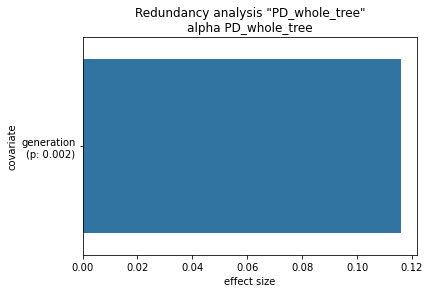

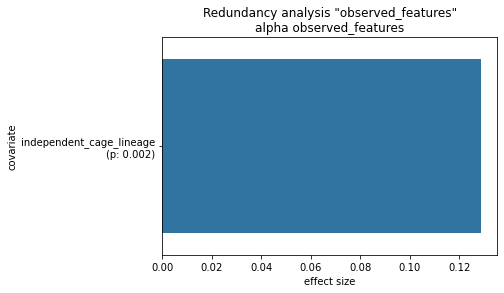

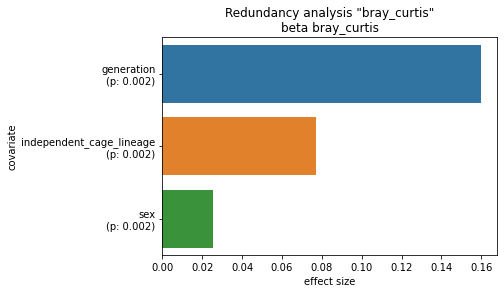

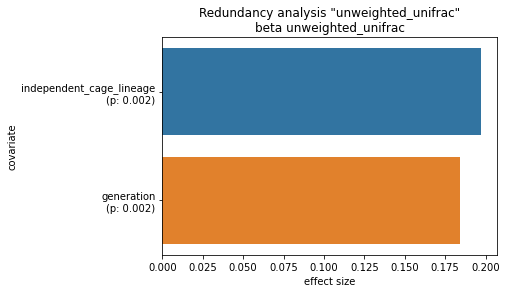

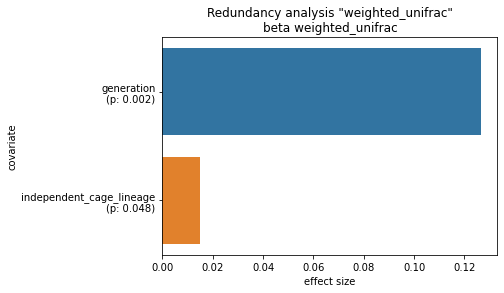

In [590]:
%matplotlib inline
#categorials
categorials = ['season', 'independent_cage_lineage', 'sex']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_gut['results'].keys()), len(gut_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    alpha=redundancy_analysis_alpha(meta_nocomp[meta_nocomp['genotype'].isin(['C57BL6/J'])],
                             alpha_div_gut['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')
for i, metric in enumerate(metrics_beta):
    beta=redundancy_analysis_beta(meta_nocomp[meta_nocomp['genotype'].isin(['C57BL6/J'])],
                             gut_beta_div['results'][metric],
                             metric,
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][1],
                             title='beta %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

found matching working dir "/homes/arehm/TMP/ana_fRDAalpha_vknip2by"
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_bxjk3rxl', cachefile is '.anacache/7b00fdb9666409f14a9b9bd930ba490e.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 329 samples in metadata and alpha respectively. Merging to 329 samples for further analysis.

Waiting for slurm-cluster job 3472409 to complete: . finished.Working directory is '/homes/arehm/TMP/ana_fRDAalpha_gvr7afn8', cachefile is '.anacache/8a248545372f4705bfd0ebee2c330109.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 329 samples in metadata and alpha respectively. Merging to 329 samples for further analysis.

Waiting for slurm-cluster job 3472410 to complete: . finished.Working directory is '/homes/arehm/TMP/ana_fRDAbeta_dmlll5m8', cachefile is '.anacache/ead8224a2c53b2cf8bc21511b787ecd8.fRDAbeta'. Ordinal "generation" does not specify 

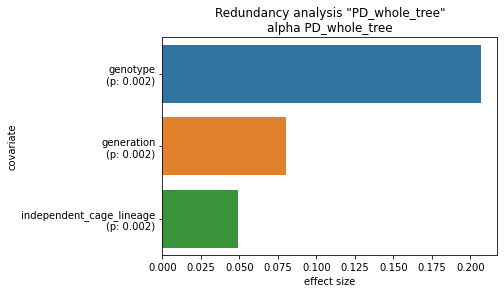

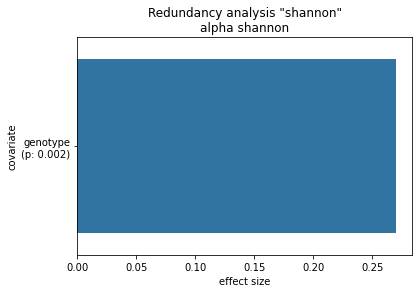

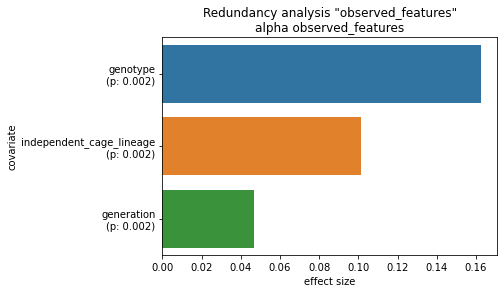

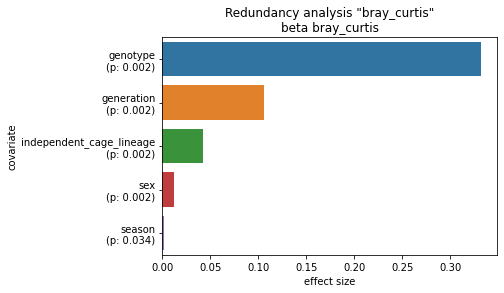

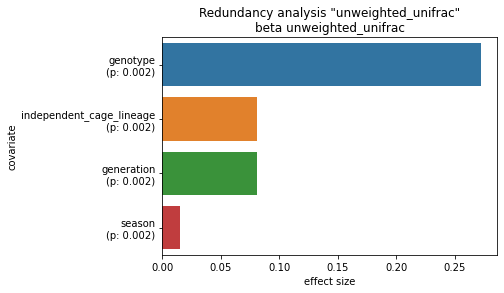

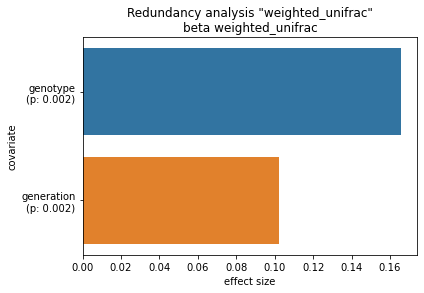

In [155]:
%matplotlib inline
#categorials
categorials = ['genotype', 'independent_cage_lineage', 'sex', 'season']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_gut['results'].keys()), len(gut_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    alpha=redundancy_analysis_alpha(meta_nocomp,
                             alpha_div_gut['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')
for i, metric in enumerate(metrics_beta):
    beta=redundancy_analysis_beta(meta_nocomp,
                             gut_beta_div['results'][metric],
                             metric,
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][1],
                             title='beta %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

In [152]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/rarefied6000-filtered-gut-table.qza \
  --output-path $work_dir/rarefied6000-filtered-gut-table_export

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied6000-filtered-gut-table.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied6000-filtered-gut-table_export
CPU times: user 287 ms, sys: 101 ms, total: 388 ms
Wall time: 13.1 s


In [ ]:
#OLD DO NOT USE

In [153]:
rarefied6000_gut = biom2pandas(work_dir + "/rarefied6000-filtered-gut-table_export/feature-table.biom").fillna(0)

In [154]:
gut_beta_div = beta_diversity(rarefied6000_gut, metrics=["unweighted_unifrac", "weighted_unifrac", "bray_curtis"], reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", dry=False, use_grid=True)

Working directory is '/homes/arehm/TMP/ana_bdiv_ospauent', cachefile is '.anacache/c9869f88aa547a95d60b001e4a5622c6.bdiv'. beta_diversity: skipping check for branches without length information. Reactivate via fix_zero_len_branches=True.

Waiting for slurm-cluster job 3472408 to complete: .......... finished. Was removed.


### Sebum

In [156]:
%time ! $q_path; qiime tools export \
  --input-path $work_dir/rarefied-filtered-sebum-table.qza \
  --output-path $work_dir/rarefied-filtered-sebum-table_export

Exported /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied-filtered-sebum-table.qza as BIOMV210DirFmt to directory /homes/arehm/Documents/Thesis/JupyterNotebook/rarefied-filtered-sebum-table_export
CPU times: user 521 ms, sys: 120 ms, total: 642 ms
Wall time: 21.1 s


In [157]:
rarefied_sebum = biom2pandas(work_dir + "/rarefied-filtered-sebum-table_export/feature-table.biom").fillna(0)

In [158]:
sebum_beta_div = beta_diversity(rarefied_sebum, metrics=["unweighted_unifrac", "weighted_unifrac", "bray_curtis"], reference_tree="/homes/arehm/Benga_ThreeGen/FromQiita/128106_insertion_tree.relabelled.tre", dry=False, use_grid=True)

Working directory is '/homes/arehm/TMP/ana_bdiv_2ix44pb4', cachefile is '.anacache/0a7fc3e664466d5478a17517bd392bb9.bdiv'. beta_diversity: skipping check for branches without length information. Reactivate via fix_zero_len_branches=True.

Waiting for slurm-cluster job 3472414 to complete: ........... finished. Was removed.


Working directory is '/homes/arehm/TMP/ana_fRDAalpha_txlw3141', cachefile is '.anacache/1fa069c3867d219b373bb4ad9b49ef67.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 254 samples in metadata and alpha respectively. Merging to 254 samples for further analysis.

Waiting for slurm-cluster job 3472417 to complete: .... finished. Was removed.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_kul3v7yr', cachefile is '.anacache/4106ba3a04cad73fa956630ce4e3c8e5.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 254 samples in metadata and alpha respectively. Merging to 254 samples for further analysis.

Waiting for slurm-cluster job 3472418 to complete: ... finished. Was removed.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_hlogwz9p', cachefile is '.anacache/365d80efe71675914de2eb057f8676dc.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
Y

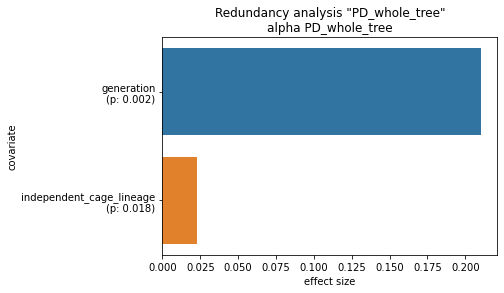

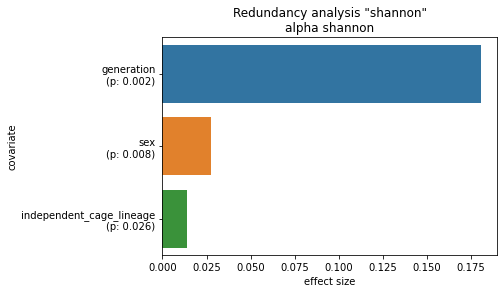

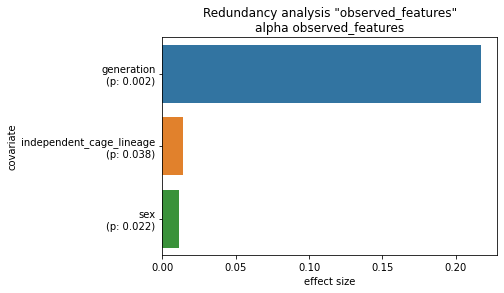

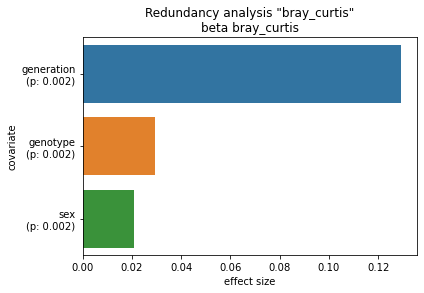

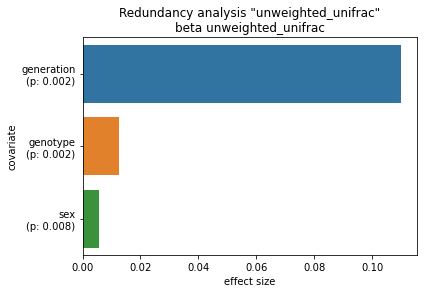

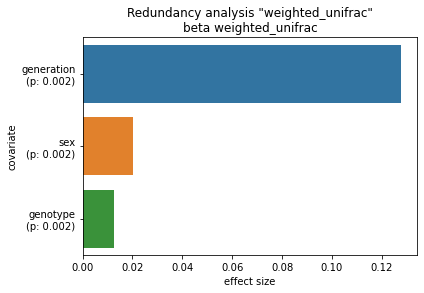

In [159]:
%matplotlib inline
#categorials
categorials = ['genotype', 'independent_cage_lineage', 'sex', 'season']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_sebum['results'].keys()), len(sebum_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    redundancy_analysis_alpha(meta_nocomp,
                             alpha_div_sebum['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True)
    plt.savefig(work_dir + "/sebum_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')
for i, metric in enumerate(metrics_beta):
    redundancy_analysis_beta(meta_nocomp,
                             sebum_beta_div['results'][metric],
                             metric,
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][1],
                             title='beta %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True)
    plt.savefig(work_dir + "/sebum_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

Working directory is '/homes/arehm/TMP/ana_fRDAalpha_wnsn_u89', cachefile is '.anacache/1adf73963a327ab3807812bc2c6b9d5d.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 254 samples in metadata and alpha respectively. Merging to 254 samples for further analysis.

Waiting for slurm-cluster job 12777348 to complete: .... finished. Was removed.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_88jnnc55', cachefile is '.anacache/78267ba7746bf7878c73a103b4db53a8.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable".
You provided 720 and 254 samples in metadata and alpha respectively. Merging to 254 samples for further analysis.

Waiting for slurm-cluster job 12777351 to complete: .... finished. Was removed.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_ngbz5sqd', cachefile is '.anacache/503e2a6e00cd08eb6edbbe420975733b.fRDAalpha'. Ordinal "generation" does not specify label(s) "RM", "not applicable"

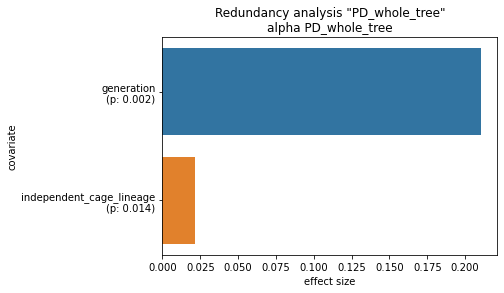

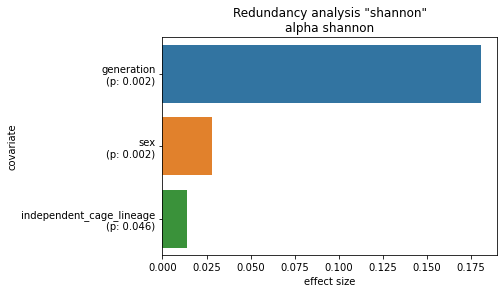

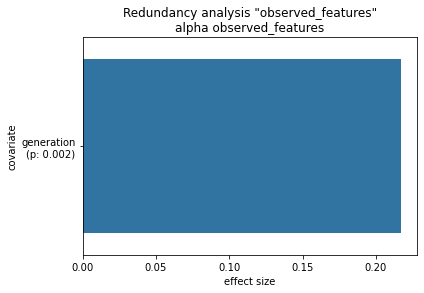

In [113]:
%matplotlib inline
#categorials
categorials = ['genotype', 'independent_cage_lineage', 'sex', 'season']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_sebum['results'].keys()), len(sebum_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    redundancy_analysis_alpha(meta_nocomp,
                             alpha_div_sebum['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True)
    plt.savefig(work_dir + "/sebum_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

Working directory is '/homes/arehm/TMP/ana_fRDAalpha_pq7w0f8z', cachefile is '.anacache/45765f27cd25ecfca58e7a726bf500dc.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 234 and 258 samples in metadata and alpha respectively. Merging to 89 samples for further analysis.

Waiting for slurm-cluster job 2917708 to complete: . finished.Working directory is '/homes/arehm/TMP/ana_fRDAalpha_qf15bsaq', cachefile is '.anacache/b1e5096f38a4bdd7c6f12ec3a052332e.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 234 and 258 samples in metadata and alpha respectively. Merging to 89 samples for further analysis.

Waiting for slurm-cluster job 2917721 to complete: . finished.No significant findings.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_u6wxuejc', cachefile is '.anacache/1260dd5bfd84da27f68edac36634abea.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 234 and 258 samp

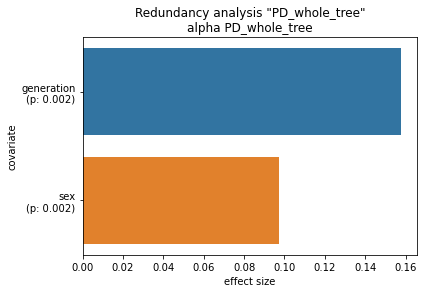

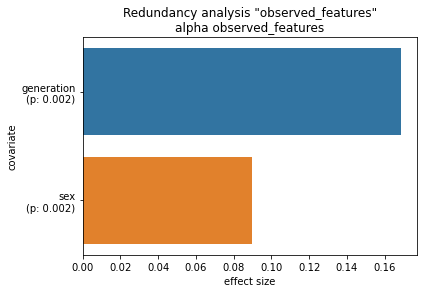

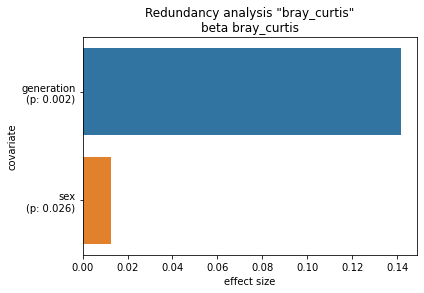

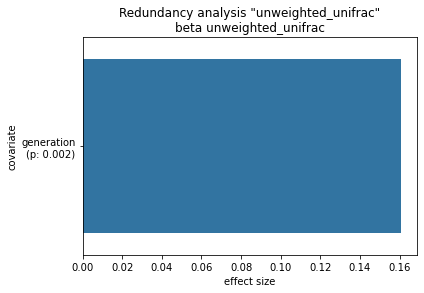

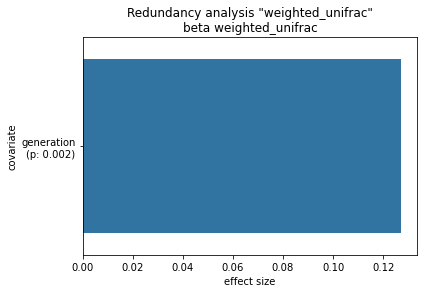

In [591]:
%matplotlib inline
#categorials
categorials = ['season', 'independent_cage_lineage', 'sex']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_gut['results'].keys()), len(gut_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    alpha=redundancy_analysis_alpha(meta_nocomp[meta_nocomp['genotype'].isin(['BALB/c'])],
                             alpha_div_sebum['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')
for i, metric in enumerate(metrics_beta):
    beta=redundancy_analysis_beta(meta_nocomp[meta_nocomp['genotype'].isin(['BALB/c'])],
                             sebum_beta_div['results'][metric],
                             metric,
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][1],
                             title='beta %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

Working directory is '/homes/arehm/TMP/ana_fRDAalpha_ssbhzx0m', cachefile is '.anacache/085b36d039e086658f5c17e42feae6ea.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 samples in metadata and alpha respectively. Merging to 189 samples for further analysis.

Waiting for slurm-cluster job 2917567 to complete: . finished.Working directory is '/homes/arehm/TMP/ana_fRDAalpha_z9q4qu92', cachefile is '.anacache/bdab14ae6e13f2c6446d8b813dee9e31.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 samples in metadata and alpha respectively. Merging to 189 samples for further analysis.

Waiting for slurm-cluster job 2917580 to complete: . finished.No significant findings.
Working directory is '/homes/arehm/TMP/ana_fRDAalpha_nv0lsx22', cachefile is '.anacache/2b81e89878311cf5c79de2cf3d7713a3.fRDAalpha'. Ordinal "generation" does not specify label(s) "not applicable".
You provided 386 and 329 sa

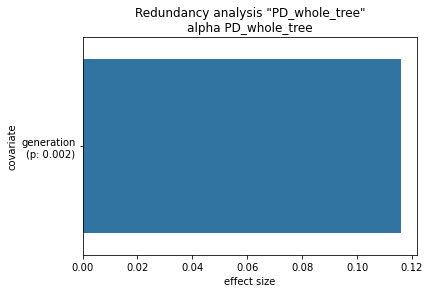

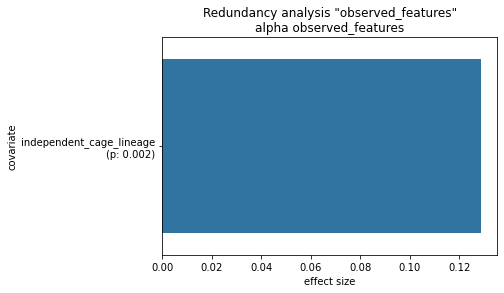

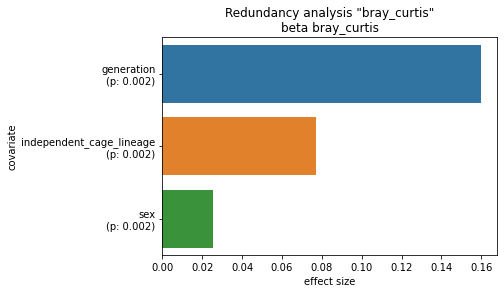

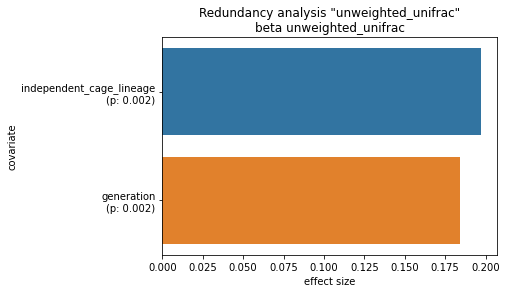

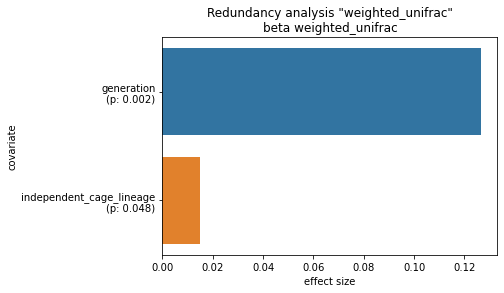

In [590]:
%matplotlib inline
#categorials
categorials = ['season', 'independent_cage_lineage', 'sex']

#ordinals
ordinals = {'generation': ['P1', 'F1', 'F2', 'F3', 'F4', 'F5']}

#intervals
intervals = []

#dates
dates = {}

#metrics
metrics_alpha = ['PD_whole_tree', 'shannon', 'observed_features']
metrics_beta = ['bray_curtis', 'unweighted_unifrac', 'weighted_unifrac']

#max_rows = max(len(alpha_div_gut['results'].keys()), len(gut_beta_div['results'].keys()))
#fig, axes = plt.subplots(max_rows, 2, figsize=(5*2, 5*max_rows))
for i, metric in enumerate(metrics_alpha):
    alpha=redundancy_analysis_alpha(meta_nocomp[meta_nocomp['genotype'].isin(['C57BL6/J'])],
                             alpha_div_gut['results'][metric],
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][0],
                             title='alpha %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')
for i, metric in enumerate(metrics_beta):
    beta=redundancy_analysis_beta(meta_nocomp[meta_nocomp['genotype'].isin(['C57BL6/J'])],
                             gut_beta_div['results'][metric],
                             metric,
                             categorials=categorials,
                             ordinals=ordinals,
                             intervals=intervals,
                             dates=dates,
                             #ax=axes[i][1],
                             title='beta %s' % metric,
                             dry=False,
                             wait=True,
                             use_grid=True,
                             dirty=True,
                             nocache=True)
    plt.savefig(work_dir + "/gut_redundancies_seperate_%s.png" % metric, transparent=False, bbox_inches='tight')

# Source Tracking
### Gut

In [160]:
rarefied6000_gut = biom2pandas(work_dir + "/rarefied6000-filtered-gut-table_export/feature-table.biom").fillna(0)

#### BALB/c
##### Impact of BF1 cage groups on BF2 cage groups

In [161]:
for sink_group in ["BF2-1", "BF2-2"]:
    meta[meta['genotype'].isin(["BALB/c"])]
    conditions = (
        (meta["cage_group"] == "BF1-1") | (meta["cage_group"] == "BF1-2"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_BF1-%s" % str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [162]:
BF1_2_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF1-BF2-1",
    dry=False,
    wait=True
    )
BF1_2_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF1-BF2-2",
    dry=False,
    wait=True
    )

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_3_5_ufhq', cachefile is '.anacache/1e333072de79aec50b929981d308e65b.sourcetracker2'. 
Waiting for slurm-cluster job 3472423 to complete: ................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_zjyq7nut', cachefile is '.anacache/bb09696cb1e73d8a8835ab4aa2fe2321.sourcetracker2'. 
Waiting for slurm-cluster job 3472426 to complete: .................... finished. Was removed.


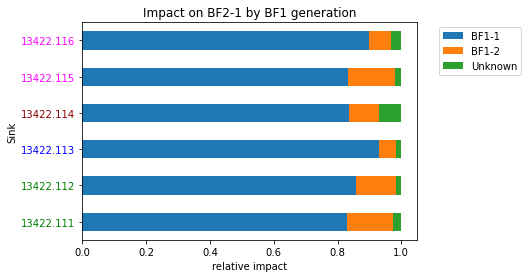

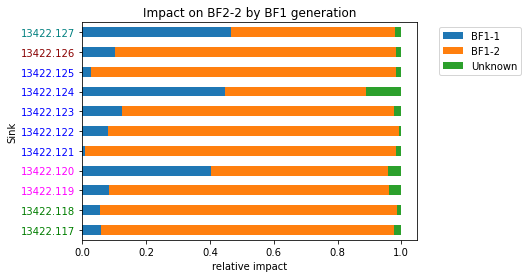

In [163]:
for i,group in enumerate([BF1_2_1_source_tracking, BF1_2_2_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-17"):
                tick.set_color('green')
            elif cage_ID in ("F2-18"):
                tick.set_color('blue')
            elif cage_ID in ("F2-19"):
                tick.set_color('darkred')
            elif cage_ID in ("F2-20"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')
        
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-21"):
                tick.set_color('green')
            elif cage_ID in ("F2-22"):
                tick.set_color('blue')
            elif cage_ID in ("F2-23"):
                tick.set_color('darkred')
            elif cage_ID in ("F2-24"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-25"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.xlabel('relative impact')   
    plt.title(f'Impact on BF2-{i} by BF1 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
    plt.savefig(work_dir + "/source_tracker_%s.png" %i, transparent=False, bbox_inches='tight')

##### Impact of BF2 cage groups on BF3 cage groups

In [164]:
for sink_group in ["BF3-1", "BF3-2", "BF3-3"]:
    meta[meta['genotype'].isin(["BALB/c"])]
    conditions = (
        (meta["cage_group"] == "BF2-1") | (meta["cage_group"] == "BF2-2") | (meta["cage_group"] == "BF2-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_BF2-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [165]:
BF2_3_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-1",
    dry=False,
    wait=True
)

BF2_3_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-2",
    dry=False,
    wait=True
)

BF2_3_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-3",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_bvpgqlgv', cachefile is '.anacache/ea68c976f180454345c5ba8c394e7a82.sourcetracker2'. 
Waiting for slurm-cluster job 3472429 to complete: ................. finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_dsrks2uu', cachefile is '.anacache/76bfe8cb08ad2ac8a6e7a5b204db2ee0.sourcetracker2'. 
Waiting for slurm-cluster job 3472432 to complete: ................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_6qdil4ud', cachefile is '.anacache/ee78027cea3264a10fa5367780543e6a.sourcetracker2'. 
Waiting for slurm-cluster job 3472435 to complete: .................... finished. Was removed.


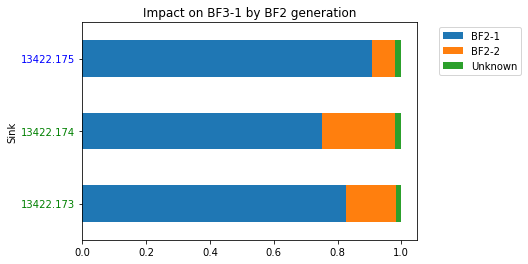

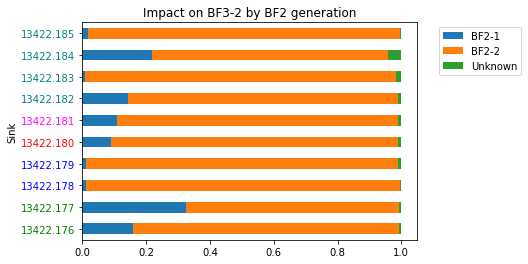

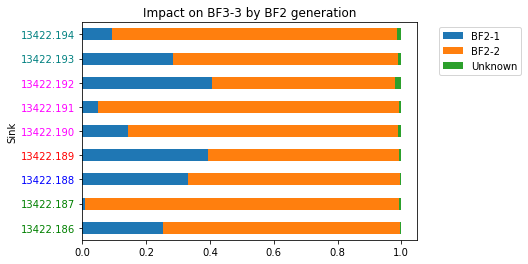

In [166]:
for i,group in enumerate([BF2_3_1_source_tracking, BF2_3_2_source_tracking, BF2_3_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-21"):
                tick.set_color('green')
            elif cage_ID in ("F3-22"):
                tick.set_color('blue')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-23"):
                tick.set_color('green')
            elif cage_ID in ("F3-24"):
                tick.set_color('blue')
            elif cage_ID in ("F3-25"):
                tick.set_color('red')
            elif cage_ID in ("F3-26"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-27"):
                tick.set_color('teal')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-28"):
                tick.set_color('green')
            elif cage_ID in ("F3-29"):
                tick.set_color('blue')
            elif cage_ID in ("F3-30"):
                tick.set_color('red')
            elif cage_ID in ("F3-31"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-32"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF3-{i} by BF2 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
    plt.savefig(work_dir + "/gut_BALB_source_tracker_%s.png" %i, transparent=False, bbox_inches='tight')

##### Impact of BF3 cage groups on BF4 cage groups

In [167]:
for sink_group in ["BF4-1", "BF4-2", "BF4-3"]:
    meta[meta['genotype'].isin(["BALB/c"])]
    conditions = (
        (meta["cage_group"] == "BF3-1") | (meta["cage_group"] == "BF3-2") | (meta["cage_group"] == "BF3-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_BF3-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [168]:
BF3_4_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-1",
    dry=False,
    wait=True
)

BF3_4_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-2",
    dry=False,
    wait=True
)

BF3_4_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-3",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_tg2g4zc9', cachefile is '.anacache/a6cf57c82d23ab820d30ef88a70e57b5.sourcetracker2'. 
Waiting for slurm-cluster job 3472438 to complete: ................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_6t05pac_', cachefile is '.anacache/8ce6767b4f7dbef4a30b0e45cd9b97e5.sourcetracker2'. 
Waiting for slurm-cluster job 3472441 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_zb4pavnu', cachefile is '.anacache/9929e94e12afa28d43c0e04e87dbefe6.sourcetracker2'. 
Waiting for slurm-cluster job 3472444 to complete: ................... finished. Was removed.


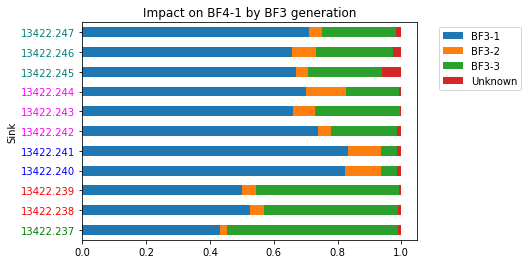

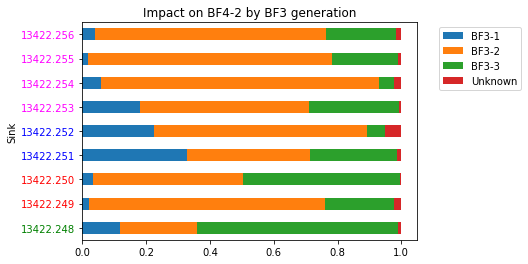

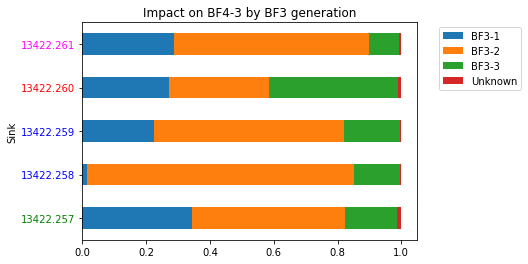

In [169]:
for i,group in enumerate([BF3_4_1_source_tracking, BF3_4_2_source_tracking, BF3_4_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-19"):
                tick.set_color('green')
            elif cage_ID in ("F4-20"):
                tick.set_color('blue')
            elif cage_ID in ("F4-21"):
                tick.set_color('red')
            elif cage_ID in ("F4-22"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-23"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-24"):
                tick.set_color('green')
            elif cage_ID in ("F4-25"):
                tick.set_color('blue')
            elif cage_ID in ("F4-26"):
                tick.set_color('red')
            elif cage_ID in ("F4-27"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-28"):
                tick.set_color('green')
            elif cage_ID in ("F4-29"):
                tick.set_color('blue')
            elif cage_ID in ("F4-30"):
                tick.set_color('red')
            elif cage_ID in ("F4-31"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF4-{i} by BF3 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of BF4 cage groups on BF5 cage groups

In [170]:
for sink_group in ["BF5-1", "BF5-2", "BF5-3"]:
    meta[meta['genotype'].isin(["BALB/c"])]
    conditions = (
        (meta["cage_group"] == "BF4-1") | (meta["cage_group"] == "BF4-2") | (meta["cage_group"] == "BF4-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_BF4-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [171]:
BF4_5_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-1",
    dry=False,
    wait=True
)

BF4_5_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-2",
    dry=False,
    wait=True
)

BF4_5_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-3",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_wi_2ds_g', cachefile is '.anacache/9a6ac6c512540cf3612011d5f0a9f356.sourcetracker2'. 
Waiting for slurm-cluster job 3472447 to complete: ..................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_maippqdj', cachefile is '.anacache/03b5d93492838a9355607dfb02b5ca93.sourcetracker2'. 
Waiting for slurm-cluster job 3472450 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_cre58x97', cachefile is '.anacache/a1017e79cada64b13a389ebd795373bd.sourcetracker2'. 
Waiting for slurm-cluster job 3472453 to complete: .................... finished. Was removed.


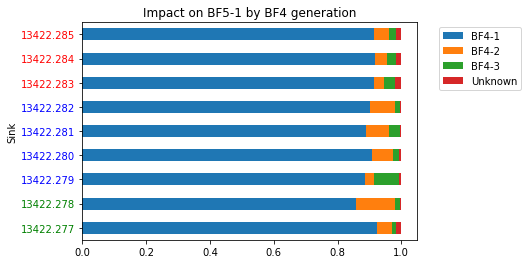

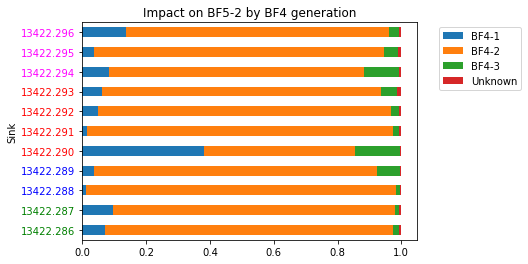

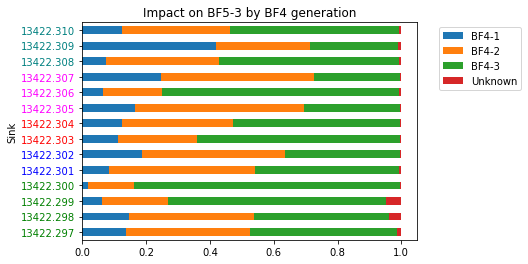

In [172]:
for i,group in enumerate([BF4_5_1_source_tracking, BF4_5_2_source_tracking, BF4_5_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-8"):
                tick.set_color('green')
            elif cage_ID in ("F5-9"):
                tick.set_color('blue')
            elif cage_ID in ("F5-10"):
                tick.set_color('red')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-11"):
                tick.set_color('green')
            elif cage_ID in ("F5-12"):
                tick.set_color('blue')
            elif cage_ID in ("F5-13"):
                tick.set_color('red')
            elif cage_ID in ("F5-14"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-15"):
                tick.set_color('green')
            elif cage_ID in ("F5-16"):
                tick.set_color('blue')
            elif cage_ID in ("F5-17"):
                tick.set_color('red')
            elif cage_ID in ("F5-18"):
                tick.set_color('magenta')
            elif cage_ID in ("F5-19"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF5-{i} by BF4 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
    plt.savefig(work_dir + "/gut_BALB_source_tracker_%s.png" %i, transparent=False, bbox_inches='tight')

#### C57BL6/J
##### Impact of CF1 cage groups on CF2 cage groups

In [173]:
for sink_group in ["CF2-1", "CF2-2", "CF2-3"]:
    meta[meta['genotype'].isin(["C57BL6/J"])]
    conditions = (
        (meta["cage_group"] == "CF1-1") | (meta["cage_group"] == "CF1-2") | (meta["cage_group"] == "CF1-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_CF1-%s" % str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [174]:
CF1_2_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTaCle
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-1",
    dry=False,
    wait=True
    )
CF1_2_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-2",
    dry=False,
    wait=True
    )
CF1_2_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-3",
    dry=False,
    wait=True
    )

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_fs7hm9dd', cachefile is '.anacache/131286c5162f4b95b69ace74772293ae.sourcetracker2'. 
Waiting for slurm-cluster job 3472458 to complete: ................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_xci4zd5b', cachefile is '.anacache/42d6c789d969bd1b9fdab96fd07e79a7.sourcetracker2'. 
Waiting for slurm-cluster job 3472462 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_0c67lyo_', cachefile is '.anacache/b1eb5b2c485abc8e0279d538398776ad.sourcetracker2'. 
Waiting for slurm-cluster job 3472465 to complete: .................... finished. Was removed.


In [175]:
meta.groupby(["source_sink_CF1-CF2-1", "cage_group"]).size()

source_sink_CF1-CF2-1  cage_group    
None                   BF1-1              10
                       BF1-2              12
                       BF2-1              12
                       BF2-2              22
                       BF3-1               6
                       BF3-2              20
                       BF3-3              18
                       BF4-1              22
                       BF4-2              18
                       BF4-3              10
                       BF5-1              18
                       BF5-2              22
                       BF5-3              28
                       CF2-2              22
                       CF2-3              22
                       CF3-1              34
                       CF3-2              32
                       CF3-3              24
                       CF4-1              30
                       CF4-2              28
                       CF4-3              26
                 

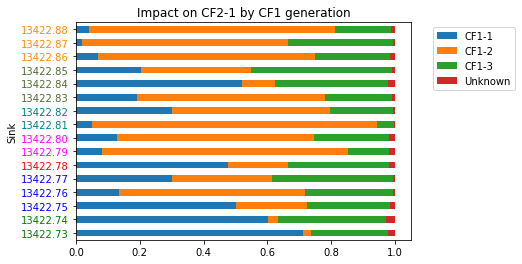

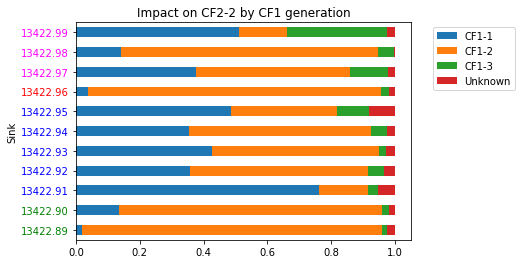

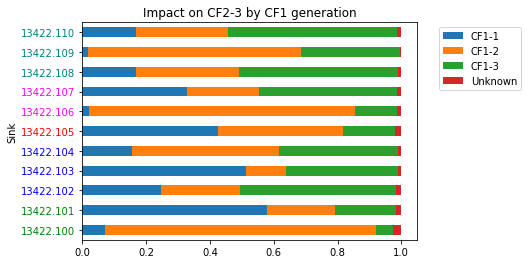

In [176]:
for i,group in enumerate([CF1_2_1_source_tracking, CF1_2_2_source_tracking, CF1_2_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-1"):
                tick.set_color('green')
            elif cage_ID in ("F2-2"):
                tick.set_color('blue')
            elif cage_ID in ("F2-3"):
                tick.set_color('red')
            elif cage_ID in ("F2-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-5"):
                tick.set_color('teal')
            elif cage_ID in ("F2-6"):
                tick.set_color('darkolivegreen')
            elif cage_ID in ("F2-7"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-8"):
                tick.set_color('green')
            elif cage_ID in ("F2-9"):
                tick.set_color('blue')
            elif cage_ID in ("F2-10"):
                tick.set_color('red')
            elif cage_ID in ("F2-11"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-12"):
                tick.set_color('green')
            elif cage_ID in ("F2-13"):
                tick.set_color('blue')
            elif cage_ID in ("F2-14"):
                tick.set_color('red')
            elif cage_ID in ("F2-15"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-16"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF2-{i} by CF1 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF2 cage groups on CF3 cage groups

In [177]:
for sink_group in ["CF3-1", "CF3-2", "CF3-3"]:
    meta[meta['genotype'].isin(["C57BL6/J"])]
    conditions = (
        (meta["cage_group"] == "CF2-1") | (meta["cage_group"] == "CF2-2") | (meta["cage_group"] == "CF2-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_CF2-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [178]:
CF2_3_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-1",
    dry=False,
    wait=True
)

CF2_3_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-2",
    dry=False,
    wait=True
)

CF2_3_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-3",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_dp916_d6', cachefile is '.anacache/93505565eb51372ca4703135605e585e.sourcetracker2'. 
Waiting for slurm-cluster job 3472469 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_c21bq9ql', cachefile is '.anacache/a90191aa1af49fb31d209b2279e43d9e.sourcetracker2'. 
Waiting for slurm-cluster job 3472474 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_lku3e2zd', cachefile is '.anacache/a950744aa25af3e22eac017feecf8fc8.sourcetracker2'. 
Waiting for slurm-cluster job 3472478 to complete: ................... finished. Was removed.


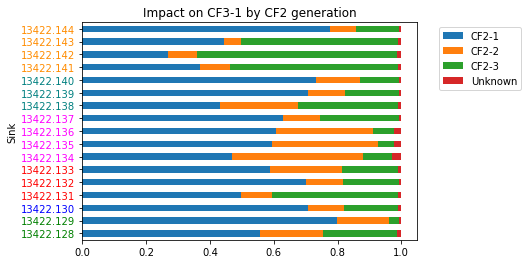

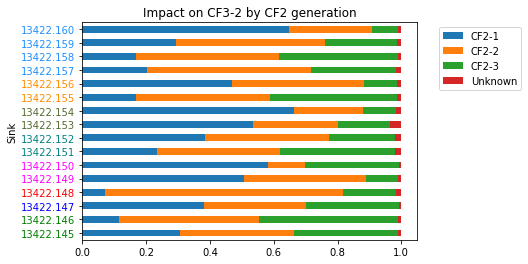

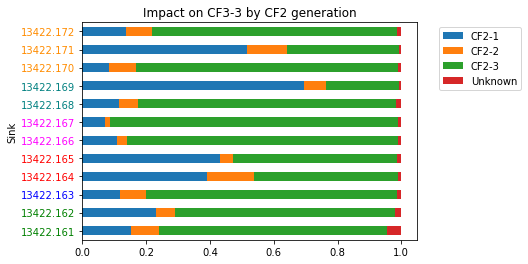

In [179]:
for i,group in enumerate([CF2_3_1_source_tracking, CF2_3_2_source_tracking, CF2_3_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-1"):
                tick.set_color('green')
            elif cage_ID in ("F3-2"):
                tick.set_color('blue')
            elif cage_ID in ("F3-3"):
                tick.set_color('red')
            elif cage_ID in ("F3-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-5"):
                tick.set_color('teal')
            elif cage_ID in ("F3-6"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-7"):
                tick.set_color('green')
            elif cage_ID in ("F3-8"):
                tick.set_color('blue')
            elif cage_ID in ("F3-9"):
                tick.set_color('red')
            elif cage_ID in ("F3-10"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-11"):
                tick.set_color('teal')
            elif cage_ID in ("F3-12"):
                tick.set_color('darkolivegreen')
            elif cage_ID in ("F3-13"):
                tick.set_color('darkorange')
            elif cage_ID in ("F3-14"):
                tick.set_color('dodgerblue')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-15"):
                tick.set_color('green')
            elif cage_ID in ("F3-16"):
                tick.set_color('blue')
            elif cage_ID in ("F3-17"):
                tick.set_color('red')
            elif cage_ID in ("F3-18"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-19"):
                tick.set_color('teal')
            elif cage_ID in ("F3-20"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF3-{i} by CF2 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF3 cage groups on CF4 cage groups

In [180]:
for sink_group in ["CF4-1", "CF4-2", "CF4-3"]:
    meta[meta['genotype'].isin(["C57BL6/J"])]
    conditions = (
        (meta["cage_group"] == "CF3-1") | (meta["cage_group"] == "CF3-2") | (meta["cage_group"] == "CF3-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_CF3-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [181]:
CF3_4_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-1",
    dry=False,
    wait=True
)

CF3_4_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-2",
    dry=False,
    wait=True
)

CF3_4_3_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-3",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_nv3fivkw', cachefile is '.anacache/12c78dd5e6b26d0fe80fa20b92051f73.sourcetracker2'. 
Waiting for slurm-cluster job 3472481 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_0zfott2h', cachefile is '.anacache/3bf185022f8f4fbe773a08b6c29e4c4d.sourcetracker2'. 
Waiting for slurm-cluster job 3472485 to complete: ................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_bj0tsfvn', cachefile is '.anacache/ff4fd6178eac281020b0f86b8f199193.sourcetracker2'. 
Waiting for slurm-cluster job 3472489 to complete: .................... finished. Was removed.


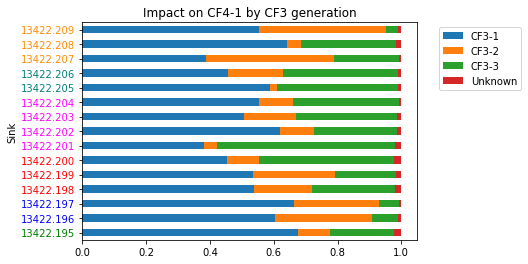

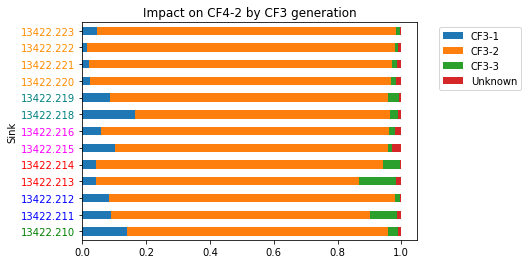

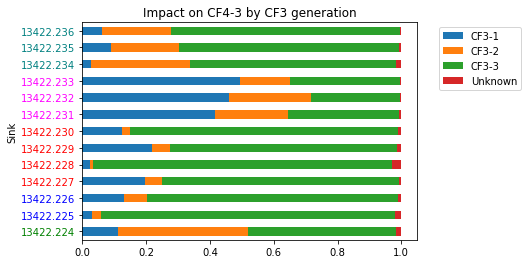

In [182]:
for i,group in enumerate([CF3_4_1_source_tracking, CF3_4_2_source_tracking, CF3_4_3_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-1"):
                tick.set_color('green')
            elif cage_ID in ("F4-2"):
                tick.set_color('blue')
            elif cage_ID in ("F4-3"):
                tick.set_color('red')
            elif cage_ID in ("F4-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-5"):
                tick.set_color('teal')
            elif cage_ID in ("F4-6"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-8"):
                tick.set_color('green')
            elif cage_ID in ("F4-9"):
                tick.set_color('blue')
            elif cage_ID in ("F4-10"):
                tick.set_color('red')
            elif cage_ID in ("F4-11"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-12"):
                tick.set_color('teal')
            elif cage_ID in ("F4-13"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-14"):
                tick.set_color('green')
            elif cage_ID in ("F4-15"):
                tick.set_color('blue')
            elif cage_ID in ("F4-16"):
                tick.set_color('red')
            elif cage_ID in ("F4-17"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-18"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF4-{i} by CF3 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF4 cage groups on CF5 cage groups

In [183]:
for sink_group in ["CF5-1", "CF5-2"]:
    meta[meta['genotype'].isin(["C57BL6/J"])]
    conditions = (
        (meta["cage_group"] == "CF4-1") | (meta["cage_group"] == "CF4-2") | (meta["cage_group"] == "CF4-3"),
        meta["cage_group"] == sink_group
    )
    values = ["Source", "Sink"]
    column_name ="source_sink_CF4-" + str(sink_group)
    meta[column_name] = np.select(conditions, values, "None")

In [184]:
CF4_5_1_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF4-CF5-1",
    dry=False,
    wait=True
)

CF4_5_2_source_tracking = sourcetracker2(
    rarefied6000_gut, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF4-CF5-2",
    dry=False,
    wait=True
)

Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_qyioqegx', cachefile is '.anacache/2f03fe014a4e59a4fdaf5a4d93606904.sourcetracker2'. 
Waiting for slurm-cluster job 3472493 to complete: .................... finished. Was removed.
Reduced to 353 samples (feature-table had 353, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_w8upl7io', cachefile is '.anacache/f2d616e507d4e763bc0b975fb46684f9.sourcetracker2'. 
Waiting for slurm-cluster job 3472496 to complete: .................... finished. Was removed.


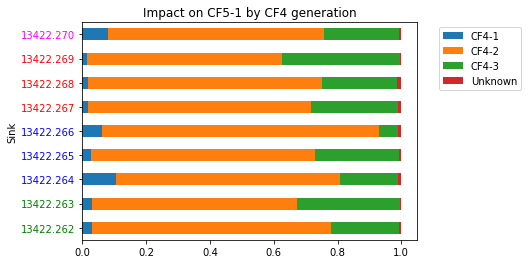

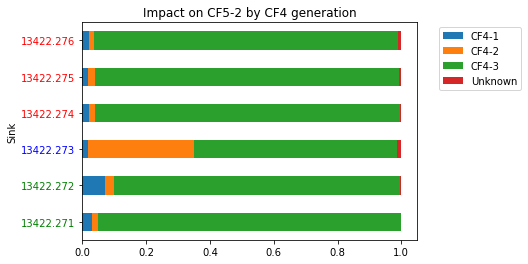

In [185]:
for i,group in enumerate([CF4_5_1_source_tracking, CF4_5_2_source_tracking], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-1"):
                tick.set_color('green')
            elif cage_ID in ("F5-2"):
                tick.set_color('blue')
            elif cage_ID in ("F5-3"):
                tick.set_color('red')
            elif cage_ID in ("F5-4"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')  
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-5"):
                tick.set_color('green')
            elif cage_ID in ("F5-6"):
                tick.set_color('blue')
            elif cage_ID in ("F5-7"):
                tick.set_color('red')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF5-{i} by CF4 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

### Sebum

In [186]:
rarefied_sebum = biom2pandas(work_dir + "/rarefied-filtered-sebum-table_export/feature-table.biom").fillna(0)

#### BALB/c
##### Impact of BF1 cage groups on BF2 cage groups

In [187]:
BF1_2_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF1-BF2-1",
    dry=False,
    wait=True
    )
BF1_2_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF1-BF2-2",
    dry=False,
    wait=True
    )

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_f_y1v39n', cachefile is '.anacache/d6027c071a142aa37c81c5533d4ab3bc.sourcetracker2'. 
Waiting for slurm-cluster job 3472498 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_c5c52uaw', cachefile is '.anacache/6a15a297264ff3ea955f3a4ad767969c.sourcetracker2'. 
Waiting for slurm-cluster job 3472499 to complete: ........ finished. Was removed.


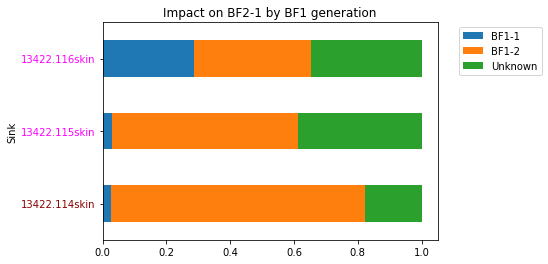

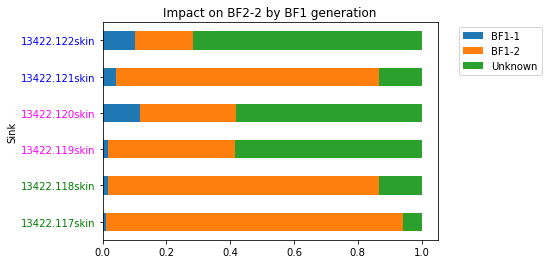

In [188]:
for i,group in enumerate([BF1_2_1_source_tracking_sebum, BF1_2_2_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-17"):
                tick.set_color('green')
            elif cage_ID in ("F2-18"):
                tick.set_color('blue')
            elif cage_ID in ("F2-19"):
                tick.set_color('darkred')
            elif cage_ID in ("F2-20"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')
        
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-21"):
                tick.set_color('green')
            elif cage_ID in ("F2-22"):
                tick.set_color('blue')
            elif cage_ID in ("F2-23"):
                tick.set_color('darkred')
            elif cage_ID in ("F2-24"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-25"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF2-{i} by BF1 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of BF2 cage groups on BF3 cage groups

In [189]:
BF2_3_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-1",
    dry=False,
    wait=True
)

BF2_3_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-2",
    dry=False,
    wait=True
)

BF2_3_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF2-BF3-3",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_8wmd0yk7', cachefile is '.anacache/efe70c36c11483983c8e163d4bd2ec9b.sourcetracker2'. 
Waiting for slurm-cluster job 3472501 to complete: ...... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_hfa59kue', cachefile is '.anacache/ffdd4a2af276184e7f9b203f251be198.sourcetracker2'. 
Waiting for slurm-cluster job 3472502 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_3byhnn8h', cachefile is '.anacache/f70b213c18053fad13066092e1511230.sourcetracker2'. 
Waiting for slurm-cluster job 3472505 to complete: ........ finished. Was removed.


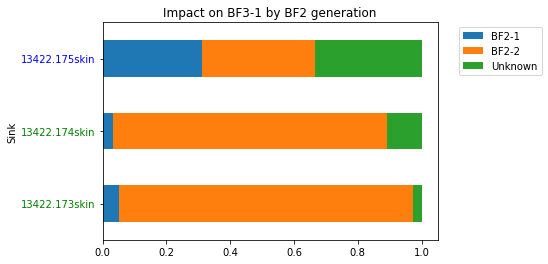

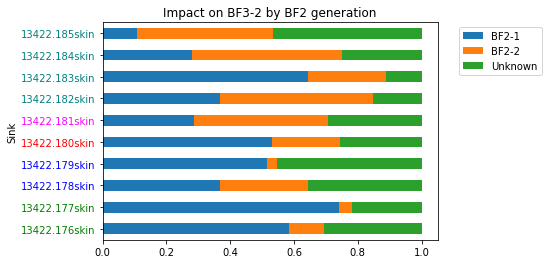

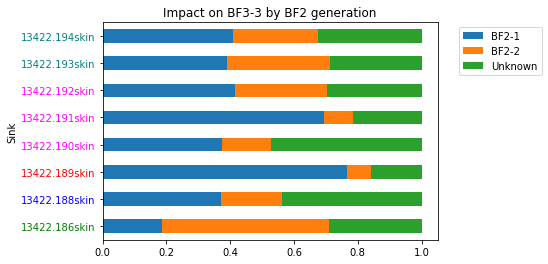

In [190]:
for i,group in enumerate([BF2_3_1_source_tracking_sebum, BF2_3_2_source_tracking_sebum, BF2_3_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-21"):
                tick.set_color('green')
            elif cage_ID in ("F3-22"):
                tick.set_color('blue')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-23"):
                tick.set_color('green')
            elif cage_ID in ("F3-24"):
                tick.set_color('blue')
            elif cage_ID in ("F3-25"):
                tick.set_color('red')
            elif cage_ID in ("F3-26"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-27"):
                tick.set_color('teal')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-28"):
                tick.set_color('green')
            elif cage_ID in ("F3-29"):
                tick.set_color('blue')
            elif cage_ID in ("F3-30"):
                tick.set_color('red')
            elif cage_ID in ("F3-31"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-32"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF3-{i} by BF2 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of BF3 cage groups on BF4 cage groups

In [191]:
BF3_4_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-1",
    dry=False,
    wait=True
)

BF3_4_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-2",
    dry=False,
    wait=True
)

BF3_4_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF3-BF4-3",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_eo2mdim8', cachefile is '.anacache/e506a97ddd0b804866ce26605f766fac.sourcetracker2'. 
Waiting for slurm-cluster job 3472507 to complete: ...... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2__hctd7b1', cachefile is '.anacache/a6d412e5e9ddaf3efa57a39b0a8572a0.sourcetracker2'. 
Waiting for slurm-cluster job 3472510 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_m1emqr_9', cachefile is '.anacache/e49cc7b39ffa8296cac06c6f3743563e.sourcetracker2'. 
Waiting for slurm-cluster job 3472512 to complete: ........ finished. Was removed.


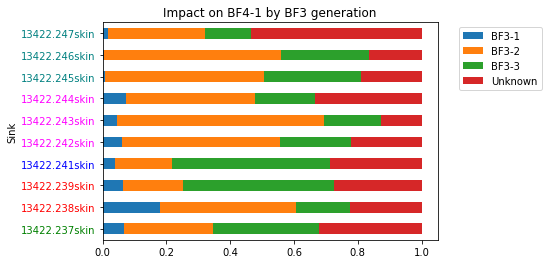

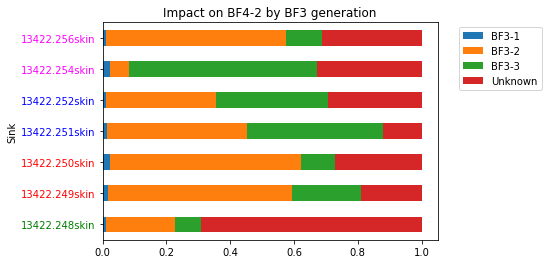

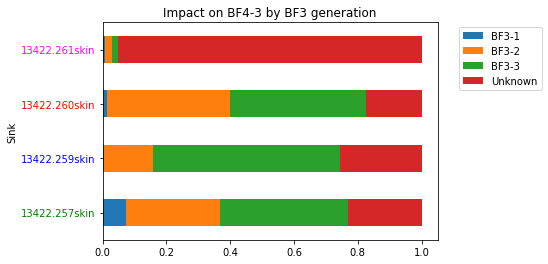

In [192]:
for i,group in enumerate([BF3_4_1_source_tracking_sebum, BF3_4_2_source_tracking_sebum, BF3_4_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-19"):
                tick.set_color('green')
            elif cage_ID in ("F4-20"):
                tick.set_color('blue')
            elif cage_ID in ("F4-21"):
                tick.set_color('red')
            elif cage_ID in ("F4-22"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-23"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-24"):
                tick.set_color('green')
            elif cage_ID in ("F4-25"):
                tick.set_color('blue')
            elif cage_ID in ("F4-26"):
                tick.set_color('red')
            elif cage_ID in ("F4-27"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-28"):
                tick.set_color('green')
            elif cage_ID in ("F4-29"):
                tick.set_color('blue')
            elif cage_ID in ("F4-30"):
                tick.set_color('red')
            elif cage_ID in ("F4-31"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF4-{i} by BF3 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of BF4 cage groups on BF5 cage groups

In [193]:
BF4_5_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-1",
    dry=False,
    wait=True
)

BF4_5_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-2",
    dry=False,
    wait=True
)

BF4_5_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_BF4-BF5-3",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_hfq__fs7', cachefile is '.anacache/f71bf7df341d9c529a840b11bb5772fa.sourcetracker2'. 
Waiting for slurm-cluster job 3472513 to complete: ...... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_xdeylwsd', cachefile is '.anacache/8de25c3717c01ed5b6deff8e637a446b.sourcetracker2'. 
Waiting for slurm-cluster job 3472515 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_4ztz7ab9', cachefile is '.anacache/b33f4a6eac0cc3c9cdb0a710e9774d4c.sourcetracker2'. 
Waiting for slurm-cluster job 3472518 to complete: ....... finished. Was removed.


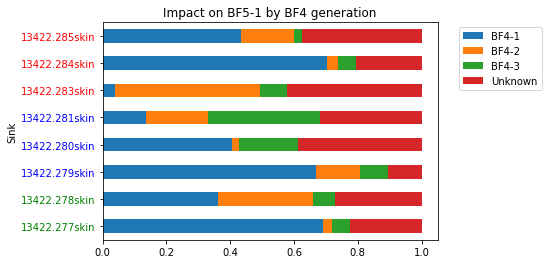

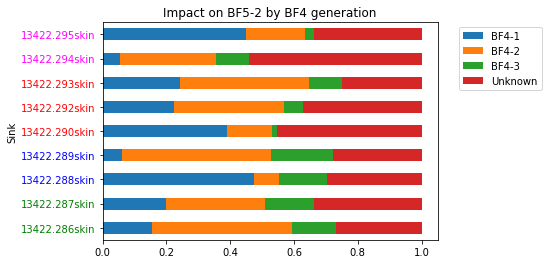

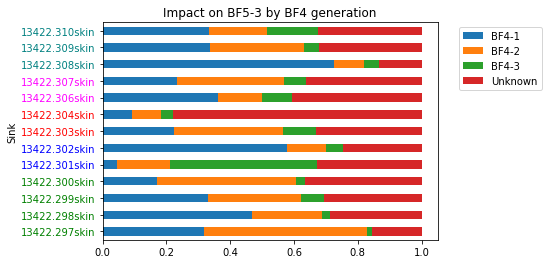

In [194]:
for i,group in enumerate([BF4_5_1_source_tracking_sebum, BF4_5_2_source_tracking_sebum, BF4_5_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-8"):
                tick.set_color('green')
            elif cage_ID in ("F5-9"):
                tick.set_color('blue')
            elif cage_ID in ("F5-10"):
                tick.set_color('red')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-11"):
                tick.set_color('green')
            elif cage_ID in ("F5-12"):
                tick.set_color('blue')
            elif cage_ID in ("F5-13"):
                tick.set_color('red')
            elif cage_ID in ("F5-14"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-15"):
                tick.set_color('green')
            elif cage_ID in ("F5-16"):
                tick.set_color('blue')
            elif cage_ID in ("F5-17"):
                tick.set_color('red')
            elif cage_ID in ("F5-18"):
                tick.set_color('magenta')
            elif cage_ID in ("F5-19"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on BF5-{i} by BF4 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

#### C57BL6/J
##### Impact of CF1 cage groups on CF2 cage groups

In [195]:
CF1_2_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTaCle
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-1",
    dry=False,
    wait=True
    )
CF1_2_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-2",
    dry=False,
    wait=True
    )
CF1_2_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF1-CF2-3",
    dry=False,
    wait=True
    )

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_rb6gcrpz', cachefile is '.anacache/0710072fb7ae1ca2a261b24e711ea0fe.sourcetracker2'. 
Waiting for slurm-cluster job 3472522 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_riq9kpz1', cachefile is '.anacache/42d83ef46367fea5d10dd08c5d5df1f1.sourcetracker2'. 
Waiting for slurm-cluster job 3472525 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_1ulhcmcx', cachefile is '.anacache/47543557ed09fe0a4a71c7037d68e8f9.sourcetracker2'. 
Waiting for slurm-cluster job 3472527 to complete: ....... finished. Was removed.


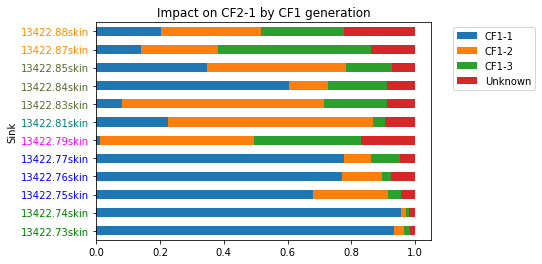

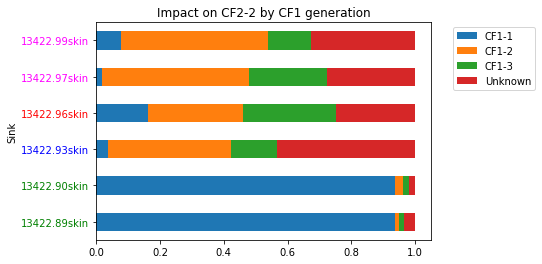

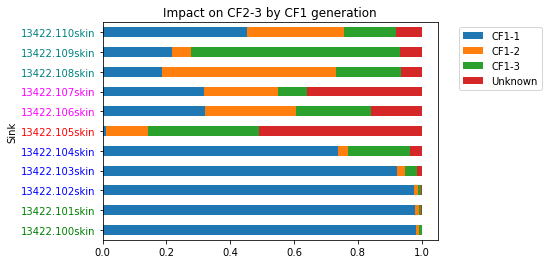

In [196]:
for i,group in enumerate([CF1_2_1_source_tracking_sebum, CF1_2_2_source_tracking_sebum, CF1_2_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-1"):
                tick.set_color('green')
            elif cage_ID in ("F2-2"):
                tick.set_color('blue')
            elif cage_ID in ("F2-3"):
                tick.set_color('red')
            elif cage_ID in ("F2-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-5"):
                tick.set_color('teal')
            elif cage_ID in ("F2-6"):
                tick.set_color('darkolivegreen')
            elif cage_ID in ("F2-7"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-8"):
                tick.set_color('green')
            elif cage_ID in ("F2-9"):
                tick.set_color('blue')
            elif cage_ID in ("F2-10"):
                tick.set_color('red')
            elif cage_ID in ("F2-11"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F2-12"):
                tick.set_color('green')
            elif cage_ID in ("F2-13"):
                tick.set_color('blue')
            elif cage_ID in ("F2-14"):
                tick.set_color('red')
            elif cage_ID in ("F2-15"):
                tick.set_color('magenta')
            elif cage_ID in ("F2-16"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF2-{i} by CF1 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF2 cage groups on CF3 cage groups

In [197]:
CF2_3_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-1",
    dry=False,
    wait=True
)

CF2_3_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-2",
    dry=False,
    wait=True
)

CF2_3_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF2-CF3-3",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_iub8vafl', cachefile is '.anacache/20f02a79e240e86735efd362040b41f8.sourcetracker2'. 
Waiting for slurm-cluster job 3472531 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_vvsifk0g', cachefile is '.anacache/2b239601a2906b8d80dbe079fe17e8ad.sourcetracker2'. 
Waiting for slurm-cluster job 3472535 to complete: ....... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_27sbq335', cachefile is '.anacache/f588fd4ddd69db5364bb34d858ec8eb1.sourcetracker2'. 
Waiting for slurm-cluster job 3472539 to complete: ....... finished. Was removed.


In [198]:
meta[meta['cage_group'].isin(['CF3-1'])]['cage_id'].value_counts()

F3-6    8
F3-4    8
F3-5    6
F3-3    6
F3-1    4
F3-2    2
Name: cage_id, dtype: int64

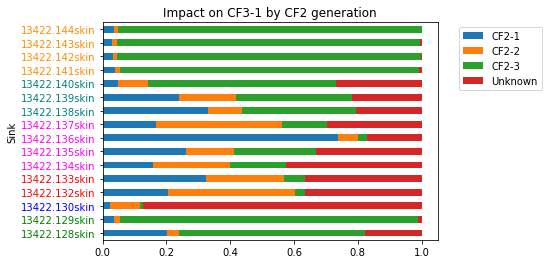

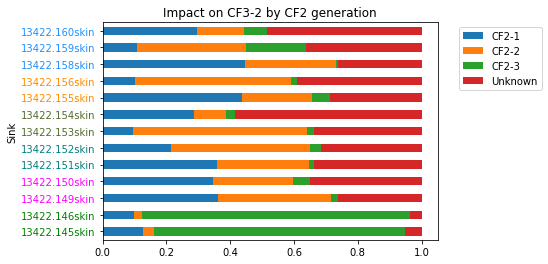

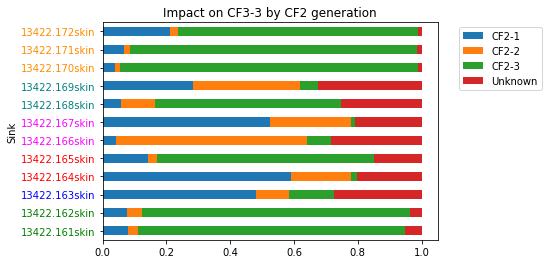

In [199]:
for i,group in enumerate([CF2_3_1_source_tracking_sebum, CF2_3_2_source_tracking_sebum, CF2_3_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-1"):
                tick.set_color('green')
            elif cage_ID in ("F3-2"):
                tick.set_color('blue')
            elif cage_ID in ("F3-3"):
                tick.set_color('red')
            elif cage_ID in ("F3-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-5"):
                tick.set_color('teal')
            elif cage_ID in ("F3-6"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-7"):
                tick.set_color('green')
            elif cage_ID in ("F3-8"):
                tick.set_color('blue')
            elif cage_ID in ("F3-9"):
                tick.set_color('red')
            elif cage_ID in ("F3-10"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-11"):
                tick.set_color('teal')
            elif cage_ID in ("F3-12"):
                tick.set_color('darkolivegreen')
            elif cage_ID in ("F3-13"):
                tick.set_color('darkorange')
            elif cage_ID in ("F3-14"):
                tick.set_color('dodgerblue')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F3-15"):
                tick.set_color('green')
            elif cage_ID in ("F3-16"):
                tick.set_color('blue')
            elif cage_ID in ("F3-17"):
                tick.set_color('red')
            elif cage_ID in ("F3-18"):
                tick.set_color('magenta')
            elif cage_ID in ("F3-19"):
                tick.set_color('teal')
            elif cage_ID in ("F3-20"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF3-{i} by CF2 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF3 cage groups on CF4 cage groups

In [200]:
CF3_4_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-1",
    dry=False,
    wait=True
)

CF3_4_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-2",
    dry=False,
    wait=True
)

CF3_4_3_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF3-CF4-3",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_mn74eaom', cachefile is '.anacache/6c9581fbdb9168ce1a75f13adca063d8.sourcetracker2'. 
Waiting for slurm-cluster job 3472542 to complete: ...... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_lsu7tnzv', cachefile is '.anacache/660e84a37a35b2ccf7806709237705a5.sourcetracker2'. 
Waiting for slurm-cluster job 3472546 to complete: ........ finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_paz_luw0', cachefile is '.anacache/ef8654d7a6765155c37aa59d5a0f40f2.sourcetracker2'. 
Waiting for slurm-cluster job 3472550 to complete: ....... finished. Was removed.


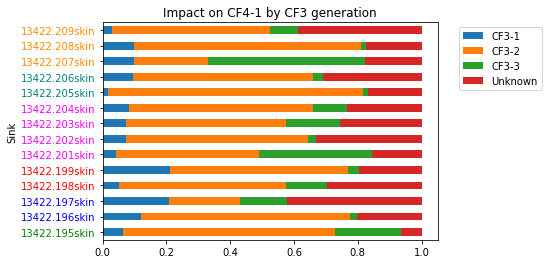

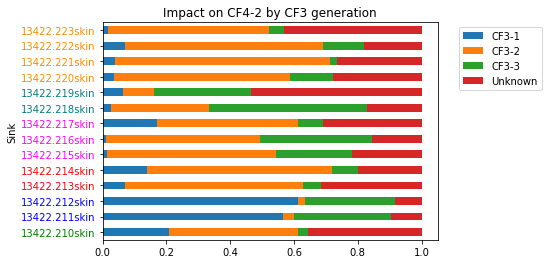

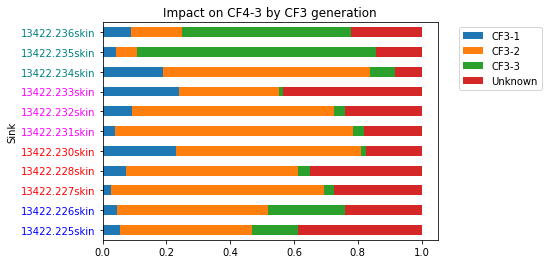

In [201]:
for i,group in enumerate([CF3_4_1_source_tracking_sebum, CF3_4_2_source_tracking_sebum, CF3_4_3_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-1"):
                tick.set_color('green')
            elif cage_ID in ("F4-2"):
                tick.set_color('blue')
            elif cage_ID in ("F4-3"):
                tick.set_color('red')
            elif cage_ID in ("F4-4"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-5"):
                tick.set_color('teal')
            elif cage_ID in ("F4-6"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')
    elif i==2:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-8"):
                tick.set_color('green')
            elif cage_ID in ("F4-9"):
                tick.set_color('blue')
            elif cage_ID in ("F4-10"):
                tick.set_color('red')
            elif cage_ID in ("F4-11"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-12"):
                tick.set_color('teal')
            elif cage_ID in ("F4-13"):
                tick.set_color('darkorange')
            else:
                tick.set_color('black')       
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F4-14"):
                tick.set_color('green')
            elif cage_ID in ("F4-15"):
                tick.set_color('blue')
            elif cage_ID in ("F4-16"):
                tick.set_color('red')
            elif cage_ID in ("F4-17"):
                tick.set_color('magenta')
            elif cage_ID in ("F4-18"):
                tick.set_color('teal')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF4-{i} by CF3 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

##### Impact of CF4 cage groups on CF5 cage groups

In [202]:
CF4_5_1_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF4-CF5-1",
    dry=False,
    wait=True
)

CF4_5_2_source_tracking_sebum = sourcetracker2(
    rarefied_sebum, #FeatureTable
    meta,
    col_envname="cage_group",
    col_type="source_sink_CF4-CF5-2",
    dry=False,
    wait=True
)

Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_mjzhuh10', cachefile is '.anacache/7961d30fa32980b75ab2f7cda34da80d.sourcetracker2'. 
Waiting for slurm-cluster job 3472553 to complete: ...... finished. Was removed.
Reduced to 282 samples (feature-table had 282, metadata had 780 samples)
Working directory is '/homes/arehm/TMP/ana_sourcetracker2_fkk167gs', cachefile is '.anacache/acf96e316522fadf26d8302e931b67f3.sourcetracker2'. 
Waiting for slurm-cluster job 3472555 to complete: ....... finished. Was removed.


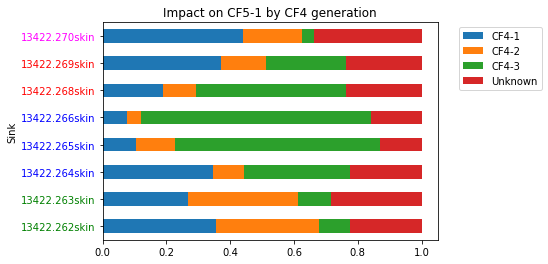

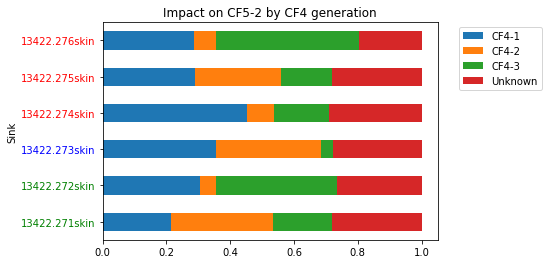

In [203]:
for i,group in enumerate([CF4_5_1_source_tracking_sebum, CF4_5_2_source_tracking_sebum], 1):
    ax= group["results"].transpose().plot.barh(stacked=True)
    if i == 1:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-1"):
                tick.set_color('green')
            elif cage_ID in ("F5-2"):
                tick.set_color('blue')
            elif cage_ID in ("F5-3"):
                tick.set_color('red')
            elif cage_ID in ("F5-4"):
                tick.set_color('magenta')
            else:
                tick.set_color('black')  
    else:
        for tick in ax.get_yticklabels():
            cage_ID = meta.loc[tick.get_text()]["cage_id"]
            if cage_ID in ("F5-5"):
                tick.set_color('green')
            elif cage_ID in ("F5-6"):
                tick.set_color('blue')
            elif cage_ID in ("F5-7"):
                tick.set_color('red')
            else:
                tick.set_color('black')
    plt.title(f'Impact on CF5-{i} by CF4 generation')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

# Seasonal Changes?

In [205]:
meta.loc[meta.collection_timestamp.str.contains('\d{4}-0[456789]-\d{2}'), :].index

Index(['13422.100', '13422.100skin', '13422.101', '13422.101skin', '13422.102',
       '13422.102skin', '13422.103', '13422.103skin', '13422.104',
       '13422.104skin',
       ...
       '13422.97', '13422.97skin', '13422.98', '13422.98skin', '13422.99',
       '13422.99skin', '13422.water412', '13422.water413', '13422.water414',
       '13422.water415'],
      dtype='object', name='sample_name', length=338)

In [111]:
meta['season'] = np.where(
    meta.index.isin(meta.loc[meta.collection_timestamp.str.contains('\d{4}-0[456789]-\d{2}'), :].index), 'summer', 'winter') 

### Gut
#### BALB/c

In [207]:
categorials=["season"]

season_gut_beta_group_significance = correlation_diversity_metacolumns(
    meta[meta['genotype'].isin(['BALB/c'])], 
    categorial=categorials, 
    alpha_diversities=alpha_div_gut['results'],
    beta_diversities=gut_beta_div['results'],
    dry=False,
    use_grid=True
)

Reducing analysis to 114 samples.
Working directory is '/homes/arehm/TMP/ana_corr-divmeta_x3rilthw', cachefile is '.anacache/d8c2610f0e2df958c33c71cef402187a.corr-divmeta'. 
Waiting for slurm-cluster job 3472559 to complete: ................. finished. Was removed.


In [208]:
season_gut_beta_group_significance['results'][season_gut_beta_group_significance['results']['column'].isin(['season'])]

,div,type,metric,column,test-statistic,test statistic name,p-value,test,sampleSize,number of permutations,number of groups
4,alpha,group-significance,shannon,season,2.0905149343051903,H,0.148216,Kruskal-Wallis (all groups),NaN,NaN,NaN
54,alpha,group-significance,PD_whole_tree,season,0.7310560927393226,H,0.392541,Kruskal-Wallis (all groups),NaN,NaN,NaN
75,alpha,group-significance,observed_features,season,0.5838971313803186,H,0.444789,Kruskal-Wallis (all groups),NaN,NaN,NaN
93,beta,group-significance,unweighted_unifrac,season,1.942287,pseudo-F,0.007000,permanova,114,999,2
94,beta,group-significance,unweighted_unifrac,season,0.023234,R,0.043000,anosim,114,999,2
95,beta,group-significance,weighted_unifrac,season,1.980911,pseudo-F,0.105000,permanova,114,999,2
96,beta,group-significance,weighted_unifrac,season,0.028124,R,0.036000,anosim,114,999,2
97,beta,group-significance,bray_curtis,season,3.004466,pseudo-F,0.004000,permanova,114,999,2
98,beta,group-significance,bray_curtis,season,0.063222,R,0.001000,anosim,114,999,2


#### C57B

In [209]:
categorials=["season"]

season_gut_beta_group_significance = correlation_diversity_metacolumns(
    meta[meta['genotype'].isin(['C57BL6/J'])], 
    categorial=categorials, 
    alpha_diversities=alpha_div_gut['results'],
    beta_diversities=gut_beta_div['results'],
    dry=False,
    use_grid=True
)

Reducing analysis to 189 samples.
Working directory is '/homes/arehm/TMP/ana_corr-divmeta_nin70wtx', cachefile is '.anacache/e04900667acd5b4b59a66f62a1927fe1.corr-divmeta'. 
Waiting for slurm-cluster job 3472567 to complete: ............. finished. Was removed.


In [210]:
season_gut_beta_group_significance['results'][season_gut_beta_group_significance['results']['column'].isin(['season'])]

,div,type,metric,column,test-statistic,test statistic name,p-value,test,sampleSize,number of permutations,number of groups
5,alpha,group-significance,shannon,season,0.8263907632328937,H,0.363318,Kruskal-Wallis (all groups),NaN,NaN,NaN
50,alpha,group-significance,PD_whole_tree,season,3.070925176188325,H,0.079704,Kruskal-Wallis (all groups),NaN,NaN,NaN
70,alpha,group-significance,observed_features,season,6.773777055585351,H,0.009251,Kruskal-Wallis (all groups),NaN,NaN,NaN
90,beta,group-significance,unweighted_unifrac,season,8.34619,pseudo-F,0.001000,permanova,189,999,2
91,beta,group-significance,unweighted_unifrac,season,0.103277,R,0.001000,anosim,189,999,2
92,beta,group-significance,weighted_unifrac,season,6.053764,pseudo-F,0.002000,permanova,189,999,2
93,beta,group-significance,weighted_unifrac,season,0.025485,R,0.082000,anosim,189,999,2
94,beta,group-significance,bray_curtis,season,7.943261,pseudo-F,0.001000,permanova,189,999,2
95,beta,group-significance,bray_curtis,season,0.073858,R,0.001000,anosim,189,999,2


### Sebum
#### BALB/c

In [211]:
categorials=["season"]

season_sebum_beta_group_significance_BALB = correlation_diversity_metacolumns(
    meta[meta['genotype'].isin(['BALB/c'])], 
    categorial=categorials, 
    alpha_diversities=alpha_div_sebum['results'],
    beta_diversities=sebum_beta_div['results'],
    dry=False,
    use_grid=True
)

Reducing analysis to 89 samples.
Working directory is '/homes/arehm/TMP/ana_corr-divmeta_y6rnwsl2', cachefile is '.anacache/b4a71bd212dd6557a95574e1c3b5b33c.corr-divmeta'. 
Waiting for slurm-cluster job 3472574 to complete: ........... finished. Was removed.


In [212]:
season_sebum_beta_group_significance_BALB['results'][season_sebum_beta_group_significance_BALB['results']['column'].isin(['season'])]

,div,type,metric,column,test-statistic,test statistic name,p-value,test,sampleSize,number of permutations,number of groups
4,alpha,group-significance,observed_features,season,4.131815651540512,H,0.042084,Kruskal-Wallis (all groups),NaN,NaN,NaN
47,alpha,group-significance,PD_whole_tree,season,4.165714285714273,H,0.041250,Kruskal-Wallis (all groups),NaN,NaN,NaN
74,alpha,group-significance,shannon,season,0.48599647266314605,H,0.485719,Kruskal-Wallis (all groups),NaN,NaN,NaN
93,beta,group-significance,unweighted_unifrac,season,1.54215,pseudo-F,0.005000,permanova,89,999,2
94,beta,group-significance,unweighted_unifrac,season,0.104831,R,0.006000,anosim,89,999,2
95,beta,group-significance,weighted_unifrac,season,1.198857,pseudo-F,0.264000,permanova,89,999,2
96,beta,group-significance,weighted_unifrac,season,0.022193,R,0.229000,anosim,89,999,2
97,beta,group-significance,bray_curtis,season,1.295447,pseudo-F,0.096000,permanova,89,999,2
98,beta,group-significance,bray_curtis,season,0.026451,R,0.218000,anosim,89,999,2


#### C57B

In [213]:
categorials=["season"]

season_sebum_beta_group_significance_C57B = correlation_diversity_metacolumns(
    meta[meta['genotype'].isin(['C57BL6/J'])], 
    categorial=categorials, 
    alpha_diversities=alpha_div_sebum['results'],
    beta_diversities=sebum_beta_div['results'],
    dry=False,
    use_grid=True
)

Reducing analysis to 161 samples.
Working directory is '/homes/arehm/TMP/ana_corr-divmeta_sp0vu2t8', cachefile is '.anacache/86a3d06a2e39b061e9f4035d501a2559.corr-divmeta'. 
Waiting for slurm-cluster job 3472581 to complete: ............ finished. Was removed.


In [214]:
! rm -r /homes/arehm/TMP/ana_corr-divmeta_lgyo__dm

rm: cannot remove '/homes/arehm/TMP/ana_corr-divmeta_lgyo__dm': No such file or directory


In [215]:
season_sebum_beta_group_significance_C57B['results'][season_sebum_beta_group_significance_C57B['results']['column'].isin(['season'])]

,div,type,metric,column,test-statistic,test statistic name,p-value,test,sampleSize,number of permutations,number of groups
7,alpha,group-significance,observed_features,season,15.846765181309397,H,6.868385,Kruskal-Wallis (all groups),NaN,NaN,NaN
38,alpha,group-significance,PD_whole_tree,season,18.447534165181253,H,1.746467,Kruskal-Wallis (all groups),NaN,NaN,NaN
77,alpha,group-significance,shannon,season,11.617402786030254,H,0.000653,Kruskal-Wallis (all groups),NaN,NaN,NaN
90,beta,group-significance,unweighted_unifrac,season,2.049705,pseudo-F,0.002000,permanova,161,999,2
91,beta,group-significance,unweighted_unifrac,season,-0.04549,R,0.913000,anosim,161,999,2
92,beta,group-significance,weighted_unifrac,season,5.268068,pseudo-F,0.001000,permanova,161,999,2
93,beta,group-significance,weighted_unifrac,season,0.087082,R,0.003000,anosim,161,999,2
94,beta,group-significance,bray_curtis,season,4.92221,pseudo-F,0.001000,permanova,161,999,2
95,beta,group-significance,bray_curtis,season,0.0686,R,0.009000,anosim,161,999,2


# Metadata correlation

In [610]:
meta['description'].value_counts()

not provided           516
blank-sterile water     58
motherF3                24
motherF2                24
motherF4                24
motherP1                20
monkey faces            20
motherF1                18
fatherF3                12
recipient mother        12
fatherF4                12
fatherF2                12
fatherF1                10
fatherP1                 8
mouse food               5
mouse bedding            5
Name: description, dtype: int64

(<Figure size 720x720 with 4 Axes>,
                          batch  birth_timestamp  cage_group   cage_id  \
 batch                 1.000000              0.0    0.316472  0.000000   
 birth_timestamp       0.000000              1.0    0.000000  0.000000   
 cage_group            0.316472              0.0    1.000000  0.912749   
 cage_id               0.000000              0.0    0.912749  1.000000   
 cage_lineage          0.344765              0.0    0.984354  0.898468   
 collection_timestamp  0.000000              0.0    0.000000  0.000000   
 comparison            0.626975              0.0    0.533640  0.466876   
 description           0.056402              0.0    0.441532  0.880269   
 empo_1                0.074283              0.0    0.383286  0.709110   
 empo_2                0.074283              0.0    0.383286  0.709110   
 empo_3                0.475464              0.0    0.302491  0.445800   
 env_material          0.686756              0.0    0.331238  0.336200   
 g

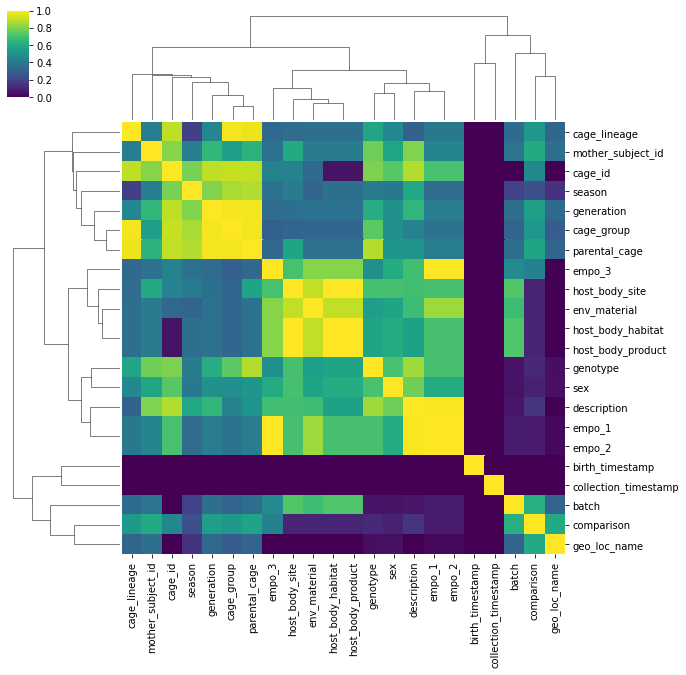

In [611]:
%matplotlib inline
#categorials
categorials=['sex', 
             'genotype',
             'season',
             'cage_group',
             'cage_id',
             'env_material',
             'geo_loc_name',
             'host_body_habitat',
             'host_body_product',
             'host_body_site',
             'batch',
             'description',
             'empo_1',
             'empo_2',
             'empo_3',
             'mother_subject_id',
             'parental_cage',
             'cage_lineage',
             'comparison',
             'generation'
            ]

#ordinals
ordinals = {}

#intervals
intervals = []

#dates
dates = {'collection_timestamp': 'yyyy-mm-dd', 'birth_timestamp': 'yyyy-mm-dd'}


correlate_metadata(meta, categorials=categorials, intervals=intervals, dates=dates, ordinals=ordinals)

In [628]:
meta_groupby= pd.DataFrame(meta.groupby(["host_body_product","genotype", "season", "generation", "cage_group", "cage_id", "collection_timestamp"]).size())

In [629]:
meta_groupby.to_csv(work_dir + '/seasonality_table.csv', sep="\t")

In [627]:
meta.groupby(["host_body_product","genotype", "season", "generation", "cage_group", "cage_id", "collection_timestamp"]).size()

host_body_product    genotype        season  generation      cage_group      cage_id         collection_timestamp
UBERON:lumen of gut  B6CF1           winter  RM              RM              rm1             2019-01-03               2
                                                                             rm2             2019-01-03               2
                                                                             rm3             2019-01-03               2
                     BALB/c          summer  F1              BF1-1           F1-15           2019-05-31               1
                                                                             F1-16           2019-05-31               1
                                                                             F1-17           2019-05-31               1
                                                                             F1-18           2019-05-31               1
                                              

In [625]:
meta_groupby

0
host_body_product   genotype       season generation     cage_group     cage_id           
UBERON:lumen of gut B6CF1          winter RM             RM             rm1              2
                                                                        rm2              2
                                                                        rm3              2
                    BALB/c         summer F1             BF1-1          F1-15            1
                                                                        F1-16            1
                                                                        F1-17            1
                                                                        F1-18            1
                                                                        F1-19            1
                                                         BF1-2          F1-20            2
                                                                        F1-21            2
                                                                        F1-22            1
                                                                        F1-23            1
                                          F2             BF2-1          F2-17            2
                                                                        F2-18            1
                                                                        F2-19            1
                                                                        F2-20            2
                                                         BF2-2          F2-21            2
                                                                        F2-22            5
                                                                        F2-23            1
                                                                        F2-24            2
                                                                        F2-25            1
                                          F5             BF5-2          F5-11            2
                                                                        F5-12            2
                                                                        F5-13            4
                                                                        F5-14            3
                                                         BF5-3          F5-15            4
                                                                        F5-16            2
                                                                        F5-17            2
                                                                        F5-18            3
                                                                        F5-19            3
                                   winter F3             BF3-1          F3-21            2
                                                                        F3-22            1
                                                         BF3-2          F3-23            2
                                                                        F3-24            2
                                                                        F3-25            1
                                                                        F3-26            1
                                                                        F3-27            4
                                                         BF3-3          F3-28            2
                                                                        F3-29            1
                                                                        F3-30            1
                                                                        F3-31            3
                                                                        F3-32            2
                                          F4             BF4-1          F4-19        

In [615]:
meta.groupby(["host_body_product","genotype", "season", "generation", "cage_group", "cage_id"]).size()

host_body_product    genotype        season  generation      cage_group      cage_id       
UBERON:lumen of gut  B6CF1           winter  RM              RM              rm1                2
                                                                             rm2                2
                                                                             rm3                2
                     BALB/c          summer  F1              BF1-1           F1-15              1
                                                                             F1-16              1
                                                                             F1-17              1
                                                                             F1-18              1
                                                                             F1-19              1
                                                             BF1-2           F1-20              2
                          

In [639]:
meta['comparison'].value_counts()

0    720
1     60
Name: comparison, dtype: int64

In [642]:
meta.groupby(["host_body_product","genotype", "sex"]).size()

host_body_product    genotype        sex         
UBERON:lumen of gut  B6CF1           female            6
                     BALB/c          female           71
                                     male             55
                     C57BL6/J        female           99
                                     male            103
                     marmoset        not provided     20
UBERON:lung          BALB/c          female            3
                                     male              3
                     C57BL6/J        female            3
                                     male              3
UBERON:sebum         B6CF1           female            6
                     BALB/c          female           74
                                     male             58
                     C57BL6/J        female          102
                                     male            106
not applicable       not applicable  not provided     68
dtype: int64

# QURRO

### Run DEICODE

In [4]:
! $q_path; qiime deicode --help

Usage: qiime deicode [OPTIONS] COMMAND [ARGS]...

  Description: This is a QIIME 2 plugin supporting Robust Aitchison on
  feature tables

  Plugin website: https://github.com/biocore/DEICODE

  Getting user support: Please post to the QIIME 2 forum for help with this
  plugin: https://forum.qiime2.org

Options:
  --version    Show the version and exit.
  --citations  Show citations and exit.
  --help       Show this message and exit.

Commands:
  auto-rpca  (Robust Aitchison) RPCA Biplot
  rpca       (Robust Aitchison) RPCA Biplot


In [12]:
meta['host_common_name']

sample_name
13422.1                    mouse
13422.10                   mouse
13422.100                  mouse
13422.100skin              mouse
13422.101                  mouse
                       ...      
13422.skin387              mouse
13422.water412    not applicable
13422.water413    not applicable
13422.water414    not applicable
13422.water415    not applicable
Name: host_common_name, Length: 780, dtype: object

In [16]:
%time ! $q_path; qiime feature-table filter-samples \
  --i-table $work_dir/fragment-filtered‐feature-table.qza \
  --m-metadata-file $meta_file \
  --p-where "[sample_name] NOT IN ($comparison_mice_indeces) AND [host_body_product] IN ('UBERON:lumen of gut') AND [host_common_name] IN ('mouse')" \
  --o-filtered-table $work_dir/filtered-gut-table-mouse-for-deicode.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/filtered-gut-table-mouse-for-deicode.qza
CPU times: user 617 ms, sys: 121 ms, total: 738 ms
Wall time: 26.5 s


Tutorial: https://forum.qiime2.org/t/robust-aitchison-pca-beta-diversity-with-deicode/8333

In [17]:
#running DEICODE on gut samples (filtered for contaminants)
! $q_path; qiime deicode rpca \
    --i-table $work_dir/filtered-gut-table-mouse-for-deicode.qza \
    --p-min-feature-count 10 \
    --p-min-sample-count 500 \
    --o-biplot $work_dir/gut_deicode_ordination.qza \
    --o-distance-matrix $work_dir/gut_deicode_distance.qza

Saved PCoAResults % Properties('biplot') to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut_deicode_ordination.qza
Saved DistanceMatrix to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut_deicode_distance.qza


### Running Qurro

In [18]:
! $q_path; qiime qurro loading-plot \
    --i-table $work_dir/filtered-gut-table-mouse-for-deicode.qza \
    --i-ranks $work_dir/gut_deicode_ordination.qza \
    --m-sample-metadata-file meta_gen_num.txt \
    --m-feature-metadata-file $work_dir/taxonomy_full.qza \
    --o-visualization $work_dir/gut-qurro-plot.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/gut-qurro-plot.qzv


# ITS
import of ITS Sequences

In [6]:
! $q_path; qiime tools import \
  --type 'SampleData[PairedEndSequencesWithQuality]' \
  --input-path /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/ITS_sequences/ \
  --input-format CasavaOneEightSingleLanePerSampleDirFmt \
  --output-path $work_dir/ITS-demux-paired-end.qza

Imported /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/ITS_sequences/ as CasavaOneEightSingleLanePerSampleDirFmt to /homes/arehm/Documents/Thesis/JupyterNotebook/ITS-demux-paired-end.qza


quality control with DADA2, NOT USED

In [3]:
! $q_path; qiime dada2 denoise-single \
  --i-demultiplexed-seqs $work_dir/ITS-demux-paired-end.qza \
  --p-trim-left 13 \
  --p-trunc-len 150 \
  --o-representative-sequences $work_dir/its-dada2-single-end-rep-seqs.qza \
  --o-table $work_dir/its-dada2-single-end-table.qza \
  --o-denoising-stats $work_dir/its-dada2-single-end-stats.qza

Saved FeatureTable[Frequency] to: /homes/arehm/Documents/Thesis/JupyterNotebook/its-dada2-single-end-table.qza
Saved FeatureData[Sequence] to: /homes/arehm/Documents/Thesis/JupyterNotebook/its-dada2-single-end-rep-seqs.qza
Saved SampleData[DADA2Stats] to: /homes/arehm/Documents/Thesis/JupyterNotebook/its-dada2-single-end-stats.qza


In [4]:
! $q_path; qiime metadata tabulate \
  --m-input-file $work_dir/its-dada2-single-end-stats.qza \
  --o-visualization $work_dir/its-dada2-single-end-stats.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/its-dada2-single-end-stats.qzv


## deblur
quality control with deblur outside of QIIME2

In [8]:
! $q_path; deblur workflow --help

Usage: deblur workflow [OPTIONS]

  Launch deblur workflow

Options:
  --seqs-fp PATH                  Either a Demultiplexed FASTA or FASTQ file
                                  including all samples, or a directory of
                                  per-sample FASTA or FASTQ files. Gzip'd
                                  files are acceptable (e.g., .fastq.gz).
                                  [required]

  --output-dir PATH               Directory path to store output including
                                  BIOM table  [required]

  -t, --trim-length INTEGER       Sequence trim length. All reads shorter than
                                  the trim-length will be discarded. A value
                                  of -1 can be specified to skip trimming;
                                  this assumes all sequences have an identical
                                  length.  [required]

  --left-trim-length INTEGER      Trim the first N bases from every sequence.
         

In [9]:
! $q_path; deblur workflow \
--seqs-fp /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/ITS_sequences/ \
--output-dir $work_dir/deblur-its \
--trim-length 150


/homes/arehm/miniconda3/envs/qiime2-2021.4/bin/deblur:531: DeprecationWarning: The 'warn' method is deprecated, use 'warning' instead
  logger.warn('deblur version %s workflow started on %s' %
/homes/arehm/miniconda3/envs/qiime2-2021.4/bin/deblur:533: DeprecationWarning: The 'warn' method is deprecated, use 'warning' instead
  logger.warn('parameters: %s' % locals())
/homes/arehm/miniconda3/envs/qiime2-2021.4/lib/python3.8/site-packages/deblur/workflow.py:850: UserWarning: Problem removing artifacts from file /vol/jlab/MicrobiomeAnalyses/Projects/Benga_ThreeGen/Trimming/ITS_sequences/591-34_S316_L001_R2_001.fastq.gz
  warnings.warn('Problem removing artifacts from file %s' %
/homes/arehm/miniconda3/envs/qiime2-2021.4/bin/deblur:634: DeprecationWarning: The 'warn' method is deprecated, use 'warning' instead
  logger.warn('deblurring failed for file %s' % input_fp)
/homes/arehm/miniconda3/envs/qiime2-2021.4/lib/python3.8/site-packages/deblur/workflow.py:850: UserWarning: Problem removing

import of `all.biom` file from deblur

In [3]:
! $q_path; qiime tools import \
  --input-path $work_dir/deblur-its/all.biom \
  --type 'FeatureTable[Frequency]' \
  --input-format BIOMV210Format \
  --output-path $work_dir/deblur-its/its-feature-table-deblur.qza

Imported /homes/arehm/Documents/Thesis/JupyterNotebook/deblur-its/all.biom as BIOMV210Format to /homes/arehm/Documents/Thesis/JupyterNotebook/deblur-its/its-feature-table-deblur.qza


In [2]:
%time ! $q_path; qiime feature-table summarize \
  --i-table $work_dir/deblur-its/its-feature-table-deblur.qza\
  --o-visualization $work_dir/deblur-its/its-feature-table-deblur-summary.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/deblur-its/its-feature-table-deblur-summary.qzv
CPU times: user 1.41 s, sys: 233 ms, total: 1.64 s
Wall time: 1min 15s


## taxonomy with UNITE
import sequences from unite database ver8 99% 10.05.2021

In [3]:
%time ! $q_path; qiime tools import \
  --input-path /homes/arehm/Documents/Thesis/JupyterNotebook/UNITE_8_3/sh_qiime_release_10.05.2021/sh_refs_qiime_ver8_99_10.05.2021.fasta \
  --type 'FeatureData[Sequence]' \
  --output-path $work_dir/unite_refs_qiime_ver8_99_10.05.2021_rep-seqs.qza

Imported /homes/arehm/Documents/Thesis/JupyterNotebook/UNITE_8_3/sh_qiime_release_10.05.2021/sh_refs_qiime_ver8_99_10.05.2021.fasta as DNASequencesDirectoryFormat to /homes/arehm/Documents/Thesis/JupyterNotebook/unite_refs_qiime_ver8_99_10.05.2021_rep-seqs.qza
CPU times: user 714 ms, sys: 130 ms, total: 844 ms
Wall time: 31.8 s


import taxonomy for QIIME2 from UNITE

In [10]:
%time ! $q_path; qiime tools import \
  --input-path /homes/arehm/Documents/Thesis/JupyterNotebook/UNITE_8_3/sh_qiime_release_10.05.2021/sh_taxonomy_qiime_ver8_99_10.05.2021.txt \
  --type FeatureData[Taxonomy] \
  --input-format HeaderlessTSVTaxonomyFormat \
  --output-path $work_dir/unite_taxonomy_qiime_ver8_99_10.05.2021_taxonomy.qza

There was a problem importing /homes/arehm/Documents/Thesis/JupyterNotebook/UNITE_8_3/sh_qiime_release_10.05.2021/sh_taxonomy_qiime_ver8_99_10.05.2021.txt:

  /homes/arehm/Documents/Thesis/JupyterNotebook/UNITE_8_3/sh_qiime_release_10.05.2021/sh_taxonomy_qiime_ver8_99_10.05.2021.txt is not a(n) TSVTaxonomyFormat file:

  ['Feature ID', 'Taxon'] must be the first two header values. The first two header values provided are: ['SH1677887.08FU_GU258247_reps', 'k__Fungi;p__Basidiomycota;c__Agaricomycetes;o__Russulales;f__Russulaceae;g__Lactifluus;s__unidentified'] (on line 1).

CPU times: user 591 ms, sys: 110 ms, total: 701 ms
Wall time: 26 s


train classifier to fit naive bayes with UNITE data

In [8]:
%time ! $q_path; qiime feature-classifier fit-classifier-naive-bayes \
  --i-reference-reads $work_dir/unite_refs_qiime_ver8_99_10.05.2021_rep-seqs.qza \
  --i-reference-taxonomy $work_dir/unite_taxonomy_qiime_ver8_99_10.05.2021_taxonomy.qza \
  --o-classifier $work_dir/unite-ver8_99_10.05.2021_classifier.qza 

Saved TaxonomicClassifier to: /homes/arehm/Documents/Thesis/JupyterNotebook/unite-ver8_99_10.05.2021_classifier.qza
CPU times: user 20.3 s, sys: 2.36 s, total: 22.7 s
Wall time: 14min 16s


import sequence data after deblur

In [8]:
%time ! $q_path; qiime tools import \
  --input-path $work_dir/deblur-its/all.seqs.fa \
  --type 'FeatureData[Sequence]' \
  --output-path $work_dir/its-rep-seqs.qza

Imported /homes/arehm/Documents/Thesis/JupyterNotebook/deblur-its/all.seqs.fa as DNASequencesDirectoryFormat to /homes/arehm/Documents/Thesis/JupyterNotebook/its-rep-seqs.qza
CPU times: user 555 ms, sys: 149 ms, total: 705 ms
Wall time: 25.4 s


run classify-sklearn on ITS sequence data after deblur with unite classifier

In [9]:
%time ! $q_path ; qiime feature-classifier classify-sklearn \
  --i-reads $work_dir/its-rep-seqs.qza \
  --i-classifier $work_dir/unite-ver8_99_10.05.2021_classifier.qza \
  --o-classification $work_dir/its_taxonomy_full.qza

Saved FeatureData[Taxonomy] to: /homes/arehm/Documents/Thesis/JupyterNotebook/its_taxonomy_full.qza
CPU times: user 1min 53s, sys: 13.9 s, total: 2min 7s
Wall time: 1h 49min 29s


create barplot

In [11]:
%time ! $q_path; qiime taxa barplot \
  --i-table $work_dir/deblur-its/its-feature-table-deblur.qza \
  --i-taxonomy $work_dir/its_taxonomy_full.qza \
  --o-visualization $work_dir/its-taxa_barplot_full.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/its-taxa_barplot_full.qzv
CPU times: user 1.25 s, sys: 227 ms, total: 1.48 s
Wall time: 1min 9s


OUTPUT: 
- majority of sequences only gets kingdom assignment -> same with the SILVA database, little bit worse
- some samples show assignment up to the species level -> these samples might be of interest
- connect with metadata to implore which samples these are

## Files from Qiita

In [36]:
%time ! $q_path; qiime tools import \
  --input-path $work_dir/deblur-its/qiita-its-deblur-final-reference-hit.seqs.fa \
  --type 'FeatureData[Sequence]' \
  --output-path $work_dir/qiita-deblur-final-its-rep-seqs.qza

Imported /homes/arehm/Documents/Thesis/JupyterNotebook/deblur-its/qiita-its-deblur-final-reference-hit.seqs.fa as DNASequencesDirectoryFormat to /homes/arehm/Documents/Thesis/JupyterNotebook/qiita-deblur-final-its-rep-seqs.qza
CPU times: user 630 ms, sys: 103 ms, total: 733 ms
Wall time: 29.2 s


In [37]:
%time ! $q_path ; qiime feature-classifier classify-sklearn \
  --i-reads $work_dir/qiita-deblur-final-its-rep-seqs.qza \
  --i-classifier $work_dir/unite-ver8_99_10.05.2021_classifier.qza \
  --o-classification $work_dir/qiita-its_taxonomy_full.qza

Saved FeatureData[Taxonomy] to: /homes/arehm/Documents/Thesis/JupyterNotebook/qiita-its_taxonomy_full.qza
CPU times: user 6min 3s, sys: 45.3 s, total: 6min 48s
Wall time: 6h 4min 15s


In [38]:
%time ! $q_path; qiime taxa barplot \
  --i-table $work_dir/deblur-its/qiita-its-deblur-final-feature-table.qza \
  --i-taxonomy $work_dir/qiita-its_taxonomy_full.qza \
  --m-metadata-file $work_dir/deblur-its/13422_20220524-060106.txt \
  --o-visualization $work_dir/qiita-its-taxa_barplot_full.qzv

Saved Visualization to: /homes/arehm/Documents/Thesis/JupyterNotebook/qiita-its-taxa_barplot_full.qzv
CPU times: user 3.12 s, sys: 418 ms, total: 3.54 s
Wall time: 3min 1s


# Metabolome

In [401]:
#gc_data = pd.read_csv('/homes/arehm/Benga_ThreeGen/Incoming/GC_results/220511__Data_21-0025.csv', sep="\t").rename(columns={'Sample.label.on.tube': 'sample_name'}).set_index("sample_name")
gc_data = pd.read_csv('/homes/arehm/Benga_ThreeGen/Incoming/GC_results/220511__Data_21-0025.csv', sep="\t").rename(columns={'Sample.label.on.tube': 'sample_name'})

ggmap is custome code from Stefan Janssen, download at https://github.com/sjanssen2/ggmap
Reading settings file '/homes/arehm/.ggmaprc'
ggmap is custome code from Stefan Janssen, download at https://github.com/sjanssen2/ggmap
Reading settings file '/homes/arehm/.ggmaprc'


In [402]:
gc_pivot = pd.pivot_table(gc_data, values = "relativeResponse", index = "Compound", columns = "sample_name").fillna(0)

In [233]:
gc_pivot.loc["3-P-glycerol_UK",["1.1.", "2.1.", "3.1.", "4.1.", "5.1."]]
BALB_list = ["11.1.", "12.1.", "13.1.", "14.1.", "15.1.", "16.1.", "17.1.", "18.1.", "19.1.", "20.1."]
C57B_list = ["1.1.", "2.1.", "3.1.", "4.1.", "5.1.", "6.1.", "7.1.", "8.1.", "9.1.", "10.1."]
F3_list = ["1.1.", "2.1.", "3.1.", "4.1.", "5.1.", "11.1.", "12.1.", "13.1.", "14.1.", "15.1."]
F4_list = ["6.1.", "7.1.", "8.1.", "9.1.", "10.1.", "16.1.", "17.1.", "18.1.", "19.1.", "20.1."]

BALB_set = set(["11.1.", "12.1.", "13.1.", "14.1.", "15.1.", "16.1.", "17.1.", "18.1.", "19.1.", "20.1."])
C57B_set = set(["1.1.", "2.1.", "3.1.", "4.1.", "5.1.", "6.1.", "7.1.", "8.1.", "9.1.", "10.1."])
F3_set = set(["1.1.", "2.1.", "3.1.", "4.1.", "5.1.", "11.1.", "12.1.", "13.1.", "14.1.", "15.1."])
F4_set = set(["6.1.", "7.1.", "8.1.", "9.1.", "10.1.", "16.1.", "17.1.", "18.1.", "19.1.", "20.1."])
list((BALB_set.intersection(F3_set)))

['15.1.', '13.1.', '12.1.', '11.1.', '14.1.']

In [376]:
gc_pivot.shape

(41, 20)

In [42]:
gc_pivot

sample_name,1.1.,10.1.,11.1.,12.1.,13.1.,14.1.,15.1.,16.1.,17.1.,18.1.,19.1.,2.1.,20.1.,3.1.,4.1.,5.1.,6.1.,7.1.,8.1.,9.1.
Compound,,,,,,,,,,,,,,,,,,,,
3-P-glycerol_UK,528.153473,433.950277,1120.129013,979.143267,542.986869,368.309198,789.165703,544.346322,772.042821,679.819818,515.669357,781.040155,541.661755,480.265410,438.836219,759.300420,686.044303,788.521079,556.203177,607.058233
5-oxoproline_UK_11.18,3084.297383,2647.100386,3989.957007,2689.332970,2446.943135,3487.654256,4021.845010,2662.833038,3754.566963,2683.903820,2664.488966,3446.303745,2952.844673,2640.482574,2125.198195,2732.539264,1711.828598,2715.774654,2404.291855,2684.752617
Asparagine,97.745714,94.914428,257.883167,152.563146,135.177285,100.216138,263.718962,156.723780,156.292665,174.845147,164.916060,113.254647,226.263934,122.201352,75.621585,162.059840,7.624693,136.496021,99.554174,140.862461
Aspartate,260.124533,190.632131,556.531838,446.442826,297.518894,349.153385,594.986309,436.802455,496.788809,388.243397,271.577939,249.896342,425.932143,265.191546,288.746702,376.974334,150.249543,329.123889,326.621196,438.276061
Aspartate2_UK,1410.527216,2624.778159,244.517770,641.680715,989.589395,1306.599103,1081.279252,1390.563472,25.511482,2379.289177,2279.039813,819.744209,822.785845,1222.475325,1279.733366,3188.975509,4.897099,1278.954837,1850.019756,920.324253
Cholesterol_UK,4585.193238,4325.557345,6140.241933,11013.274382,12380.451221,8749.620989,4946.106279,7026.445983,4332.023112,5660.881453,4702.002020,6377.653862,6603.592469,4962.187553,9290.152906,6348.708909,4937.021950,5770.637754,6755.559414,6694.243007
Citrate+Isocitrate,8495.042047,7861.128962,4852.412196,4454.986559,8099.251506,6838.287232,7101.645154,6470.837500,5144.090342,7095.494175,8278.168658,10633.546535,6991.172137,6393.331417,5747.230488,8031.902686,2712.328231,9166.969735,8628.673297,7009.550097
DMPA,7882.105571,9312.904360,9245.944331,8945.041168,10490.076025,9299.459034,8781.485911,8970.516356,8678.750213,8946.687118,9298.525253,7749.300322,9659.178399,8212.312982,9442.464177,9239.057895,8985.902955,9010.323985,10112.520379,9978.938592
Fructose,355.403244,200.808848,458.264956,394.709114,337.838276,378.086762,305.820694,337.858475,449.612519,276.973358,267.209813,393.655909,346.306774,233.348560,355.716948,271.193936,309.913902,301.302005,295.138020,385.768036


In [403]:
meta_gc = gc_data[['sample_name', "date", "MS.Label", "Species", "Tissue.type", "Condition.1", "Generation", "Benga-Nr."]].set_index(['sample_name']).drop_duplicates().rename(columns={'Condition.1': 'genotype', 'Generation': 'generation'})

In [404]:
meta_gc

,date,MS.Label,Species,Tissue.type,genotype,generation,Benga-Nr.
sample_name,,,,,,,
1.1.,44572,21-0025_001,mouse,serum,C57BL/6J,F3,145
2.1.,44572,21-0025_003,mouse,serum,C57BL/6J,F3,146
3.1.,44572,21-0025_005,mouse,serum,C57BL/6J,F3,149
4.1.,44572,21-0025_007,mouse,serum,C57BL/6J,F3,150
5.1.,44572,21-0025_009,mouse,serum,C57BL/6J,F3,152
6.1.,44572,21-0025_011,mouse,serum,C57BL/6J,F4,225
7.1.,44572,21-0025_013,mouse,serum,C57BL/6J,F4,226
8.1.,44572,21-0025_015,mouse,serum,C57BL/6J,F4,229
9.1.,44572,21-0025_017,mouse,serum,C57BL/6J,F4,230


In [20]:
gc_alpha_div_results = dict()
gc_alpha_div_results = alpha_diversity(gc_pivot, metrics=['shannon'], dry=False, wait=True, rarefaction_depth=None)

Using existing results from '.anacache/491daad7b1185c41ed4d07c70eebdc2c.adiv'. 


In [22]:
gc_alpha_div_results['results']

,shannon
iter10_depthNone,
1.1.,2.812454
10.1.,3.062096
11.1.,2.980020
12.1.,3.269284
13.1.,2.929963
14.1.,3.010319
15.1.,3.346747
16.1.,3.058171
17.1.,2.923006


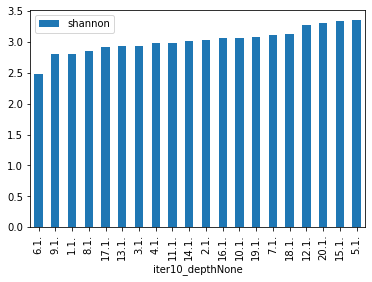

In [31]:
ax = gc_alpha_div_results['results'].sort_values(by = 'shannon').plot.bar(y = 'shannon')

In [14]:
gc_beta_div_results = beta_diversity(gc_pivot, metrics=["bray_curtis"], reference_tree=None, dry=True, use_grid=True)

Using existing results from '.anacache/5d7ca868865e4ced5a4e7f500e1361ed.bdiv'. 


In [123]:
gc_data["sample_name"].loc[gc_data["Generation"] == "F3"]

0       1.1.
1       2.1.
2       3.1.
3       4.1.
4       5.1.
       ...  
796    11.1.
797    12.1.
798    13.1.
799    14.1.
800    15.1.
Name: sample_name, Length: 406, dtype: object

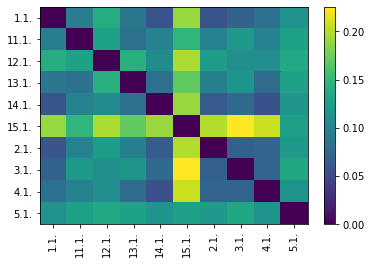

In [149]:
group_dm

## Beta Diversity - Genotypes in Generation

In [409]:
res_all_chems = {
    'alpha_diversity': alpha_diversity(gc_pivot, metrics=['shannon'], dry=False, wait=False, rarefaction_depth=None),
    'beta_diversity': beta_diversity(gc_pivot, metrics=['bray_curtis'], dry=False, wait=False)
}


Using existing results from '.anacache/491daad7b1185c41ed4d07c70eebdc2c.adiv'. 
Using existing results from '.anacache/5d7ca868865e4ced5a4e7f500e1361ed.bdiv'. 


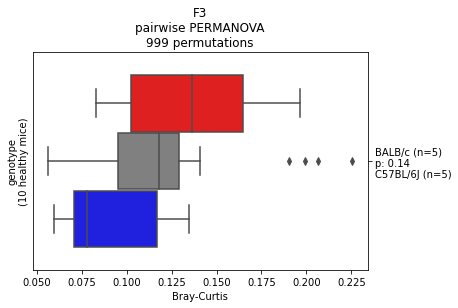

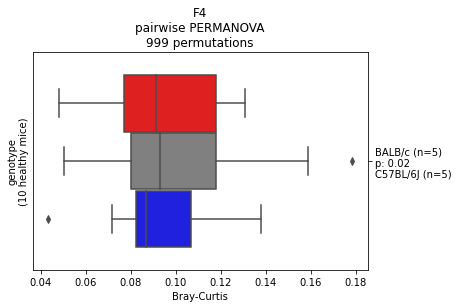

In [420]:
for generation in ['F3', 'F4']:
    field = 'genotype'
    field_meta = meta_gc[meta_gc['generation'] == generation][field]

    b = detect_distant_groups(res_all_chems['beta_diversity']['results']['bray_curtis'], 'Bray-Curtis', field_meta)
    ax, _ = plotGroup_permanovas(res_all_chems['beta_diversity']['results']['bray_curtis'], field_meta, **b,
                                 horizontal=True, print_sample_numbers=True, colors_boxplot={'between': 'gray', 'left': 'red', 'right': 'blue'})
    ax.set_ylabel(field+ "\n(%i healthy mice)" % field_meta.shape[0])
    ax.yaxis.label.set_visible(True)
    _ = ax.set_title('%s\npairwise %s\n%s permutations' % (generation, str.upper(b['fct_name']), b['num_permutations']))

## Beta Diversity - Generations in Genotype

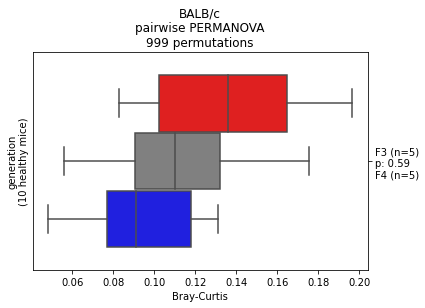

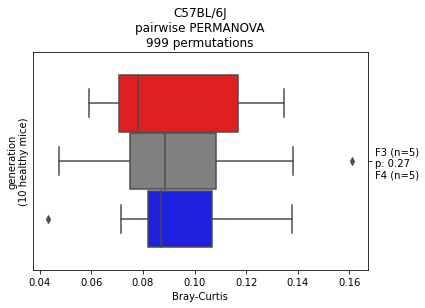

In [421]:
for genotype in ['BALB/c', 'C57BL/6J']:
    field = 'generation'
    field_meta = meta_gc[meta_gc['genotype'] == genotype][field]

    b = detect_distant_groups(res_all_chems['beta_diversity']['results']['bray_curtis'], 'Bray-Curtis', field_meta)
    ax, _ = plotGroup_permanovas(res_all_chems['beta_diversity']['results']['bray_curtis'], field_meta, **b,
                                 horizontal=True, print_sample_numbers=True, colors_boxplot={'between': 'gray', 'left': 'red', 'right': 'blue'})
    ax.set_ylabel(field+ "\n(%i healthy mice)" % field_meta.shape[0])
    ax.yaxis.label.set_visible(True)
    _ = ax.set_title('%s\npairwise %s\n%s permutations' % (genotype, str.upper(b['fct_name']), b['num_permutations']))

## Beta Diversity - Genotypes combined / Generations combined

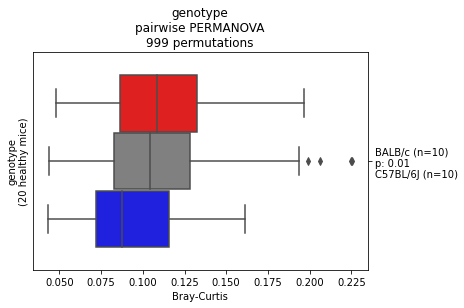

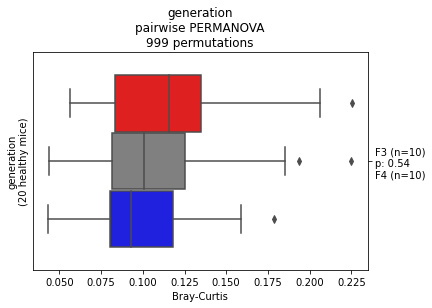

In [423]:
field = 'genotype'
field_meta = meta_gc[field]

b = detect_distant_groups(res_all_chems['beta_diversity']['results']['bray_curtis'], 'Bray-Curtis', field_meta)
ax, _ = plotGroup_permanovas(res_all_chems['beta_diversity']['results']['bray_curtis'], field_meta, **b,
                             horizontal=True, print_sample_numbers=True, colors_boxplot={'between': 'gray', 'left': 'red', 'right': 'blue'})
ax.set_ylabel(field+ "\n(%i healthy mice)" % field_meta.shape[0])
ax.yaxis.label.set_visible(True)
_ = ax.set_title('%s\npairwise %s\n%s permutations' % (field, str.upper(b['fct_name']), b['num_permutations']))

field = 'generation'
field_meta = meta_gc[field]

b = detect_distant_groups(res_all_chems['beta_diversity']['results']['bray_curtis'], 'Bray-Curtis', field_meta)
ax, _ = plotGroup_permanovas(res_all_chems['beta_diversity']['results']['bray_curtis'], field_meta, **b,
                             horizontal=True, print_sample_numbers=True, colors_boxplot={'between': 'gray', 'left': 'red', 'right': 'blue'})
ax.set_ylabel(field+ "\n(%i healthy mice)" % field_meta.shape[0])
ax.yaxis.label.set_visible(True)
_ = ax.set_title('%s\npairwise %s\n%s permutations' % (field, str.upper(b['fct_name']), b['num_permutations']))

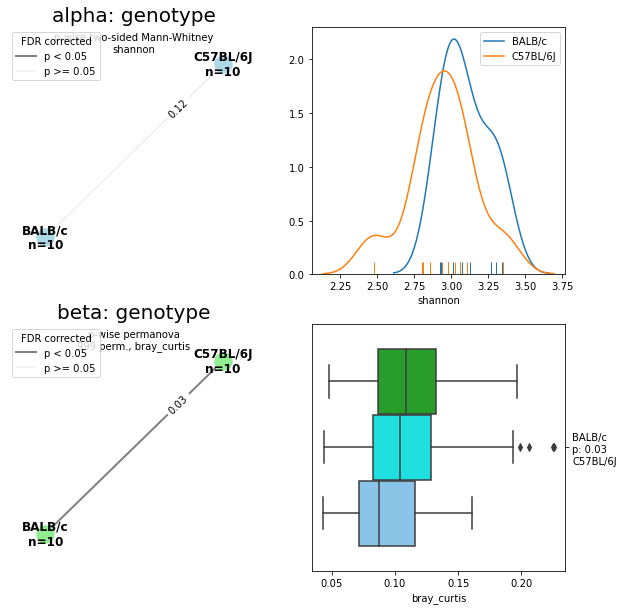

In [410]:
_ = plotNetworks('genotype', meta_gc, 
                 alpha=res_all_chems["alpha_diversity"]['results'], 
                 beta=res_all_chems["beta_diversity"]['results'], minnumalpha=1)

## dsFDR

In [405]:
import calour as ca
ca.set_log_level(40)
pandas2biom(work_dir + '/dsfrd_metabolome.biom', gc_pivot)
meta_gc.to_csv(work_dir + '/dsfdr_metabolome_meta.tsv', sep="\t", index=True)
   
dsFDR_experiment = ca.read_amplicon(work_dir + '/dsfrd_metabolome.biom', work_dir + '/dsfdr_metabolome_meta.tsv', min_reads=0, normalize=10000)

In [411]:
dsFDR_experiment

AmpliconExperiment ("dsfrd_metabolome.biom") with 20 samples, 41 features

'genotype'  (n=10)
     6 (of   41) taxa different between 'BALB/c' (n=5) vs. 'C57BL/6J' (n=5)



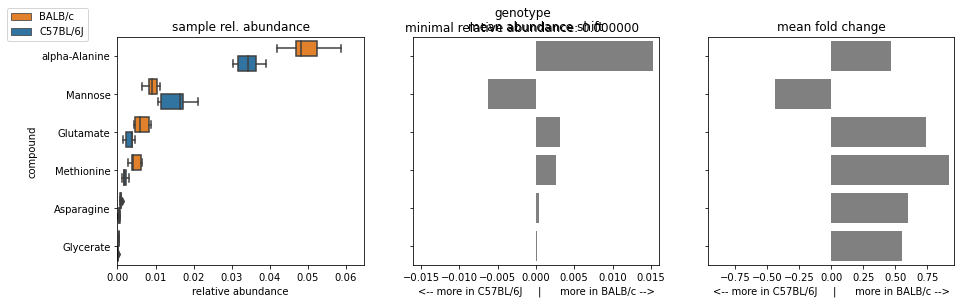

In [417]:
field = 'genotype'
res_dsFDR_genotype = find_diff_taxa(dsFDR_experiment, meta_gc[meta_gc['generation'] == 'F4'], [field])

if len(res_dsFDR_genotype) > 0:
    p = plot_diff_taxa(gc_pivot, meta_gc[meta_gc['generation'] == 'F4'][field], res_dsFDR_genotype,
                       min_mean_abundance=0.0,
#                       colors_boxplot={'Pax5+/-': 'red', 'WT': 'blue'}, 
                       color_barplot='gray'
                      )
    p[0].get_axes()[0].set_ylabel("compound")

F3
'genotype'  (n=10)
     3 (of   41) taxa different between 'BALB/c' (n=5) vs. 'C57BL/6J' (n=5)

F3
F4
'genotype'  (n=10)
     7 (of   41) taxa different between 'BALB/c' (n=5) vs. 'C57BL/6J' (n=5)

F4


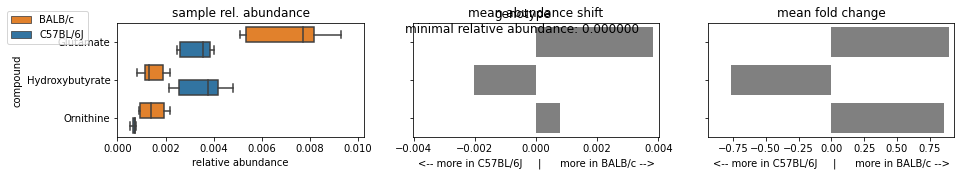

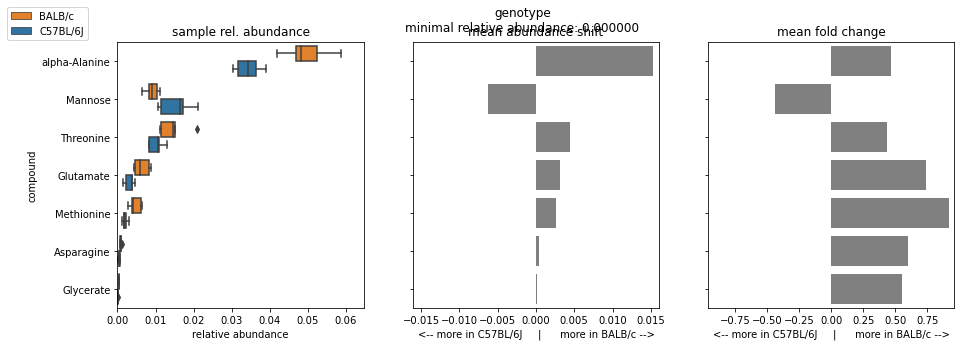

In [438]:
for generation in ['F3', 'F4']:
    print(generation)
    field = 'genotype'
    res_dsFDR_generation = find_diff_taxa(dsFDR_experiment, meta_gc[meta_gc['generation'] == generation], [field])

    if len(res_dsFDR_generation) > 0:
        
        p = plot_diff_taxa(gc_pivot, meta_gc[meta_gc['generation'] == generation][field], res_dsFDR_generation,
                           min_mean_abundance=0.0,
    #                       colors_boxplot={'Pax5+/-': 'red', 'WT': 'blue'}, 
                           color_barplot='gray'
                          )
        p[0].get_axes()[0].set_ylabel("compound")
        print(generation)

In [ ]:
for genotype in ['BALB/c', 'C57BL/6J']:
    print(genotype)
    field = 'generation'
    res_dsFDR_genotype = find_diff_taxa(dsFDR_experiment, meta_gc[meta_gc['genotype'] == genotype], [field])

    if len(res_dsFDR_genotype) > 0:
        
        p = plot_diff_taxa(gc_pivot, meta_gc[meta_gc['genotype'] == genotype][field], res_dsFDR_genotype,
                           min_mean_abundance=0.0,
    #                       colors_boxplot={'Pax5+/-': 'red', 'WT': 'blue'}, 
                           color_barplot='gray'
                          )
        p[0].get_axes()[0].set_ylabel("compound")
        print(genotype)

BALB/c
'generation'  (n=10)
     0 (of   41) taxa different between 'F3' (n=5) vs. 'F4' (n=5)

C57BL/6J
'generation'  (n=10)
     0 (of   41) taxa different between 'F3' (n=5) vs. 'F4' (n=5)



## Triglyceride values

In [34]:
tg_values = pd.read_csv('/homes/arehm/Benga_ThreeGen/Incoming/Triglyceride.csv', sep="\t").set_index("sample_name")

In [53]:
tg_values

,batch,birth_timestamp,cage_group,cage_id,collection_device,collection_method,collection_timestamp,description,dna_extracted,elevation,...,qiita_study_id,sample_type,scientific_name,sex,taxon_id,title,tube_id,tube_id_plate_bmfz,triglyceride_values,triglyceride_units
sample_name,,,,,,,,,,,,,,,,,,,,,
13422.1,1,2018-04-10,RM,rm1,eppi,necropsy,2019-01-03,recipient mother,True,42,...,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-a9,1-a9,1.53,nmol/well
13422.10,1,2018-11-30,PB,P1-11,eppi,necropsy,2019-03-20,motherP1,True,42,...,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,3-d1,3-d1,4.72,nmol/well
13422.100,1,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,True,42,...,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,2-c12,NaN,1.35,nmol/well
13422.100skin,3,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,True,42,...,13422,skin of external ear,mouse skin metagenome,female,410661,Skin screening,7-c12,7-c12,1.35,nmol/well
13422.101,1,2019-05-03,CF2-3,F2-12,eppi,necropsy,2019-08-16,motherF2,True,42,...,13422,colon content,mouse gut metagenome,female,410661,Influence of the genetic background on murine ...,1-a8,NaN,2.03,nmol/well
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13422.water2,4,not applicable,not applicable,not applicable,eppi,tweezers,not applicable,blank-sterile water,False,42,...,13422,sterile water,sterile water,not provided,410661,Influence of the genetic background on murine ...,NaN,NaN,NaN,NaN
13422.water412,2,not applicable,not applicable,not applicable,eppi,tweezers,2020-05-28,blank-sterile water,False,42,...,13422,sterile water,sterile water,not provided,410661,Influence of the genetic background on murine ...,5-b2,5-b2,NaN,NaN
13422.water413,2,not applicable,not applicable,not applicable,eppi,tweezers,2020-05-28,blank-sterile water,False,42,...,13422,sterile water,sterile water,not provided,410661,Influence of the genetic background on murine ...,5-f2,5-f2,NaN,NaN


In [69]:
type(tg_values_only['triglyceride_values'][1])

numpy.float64

In [76]:
tg_values_only = pd.DataFrame(tg_values['triglyceride_values']).dropna()
df_keinSerum = tg_values_only.index.isin(["13422.286","13422.286skin"])

tg_values_only = tg_values_only[~df_keinSerum]
tg_values_only['genotype'] = tg_values['genotype']
tg_values_only['generation'] = tg_values['generation']

tg_values_only['triglyceride_values'] = pd.to_numeric(tg_values_only['triglyceride_values'])
tg_values_only = tg_values_only.dropna()
tg_values_only

,triglyceride_values,genotype,generation
sample_name,,,
13422.1,1.53,B6CF1,RM
13422.10,4.72,BALB/c,P1
13422.100,1.35,C57BL6/J,F2
13422.100skin,1.35,C57BL6/J,F2
13422.101,2.03,C57BL6/J,F2
...,...,...,...
13422.skin383,1.47,C57BL6/J,not applicable
13422.skin384,1.71,C57BL6/J,not applicable
13422.skin385,2.53,C57BL6/J,not applicable


In [95]:
tg_plot = tg_values_only.groupby('genotype').agg([np.mean])
tg_plot

,triglyceride_values
,mean
genotype,
B6CF1,1.933333
BALB/c,5.039221
C57BL6/J,2.013090


Text(0, 0.5, 'nmol/well')

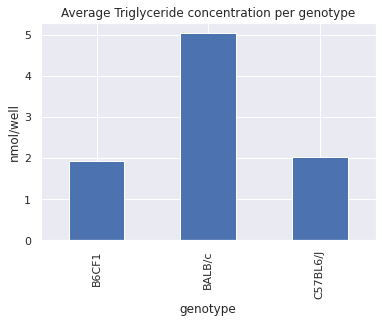

In [99]:
ax = tg_plot.plot.bar(legend=False, title='Average Triglyceride concentration per genotype')
ax.set_ylabel("nmol/well")

In [42]:
grouped = tg_values_only.groupby(['genotype'])

AttributeError: 'DataFrameGroupBy' object has no attribute 'toDataFrame'

In [11]:
tg_values_only[tg_values_only['genotype'].isin(['BALB/c'])]['triglyceride_values']

sample_name
13422.10           4.72
13422.10skin       4.72
13422.11           2.52
13422.111          9.90
13422.111skin      9.90
13422.112          2.17
13422.112skin      2.17
13422.113          2.31
13422.113skin      2.31
13422.114          8.58
13422.114skin      8.58
13422.115          7.00
13422.115skin      7.00
13422.116          5.29
13422.116skin      5.29
13422.117          4.15
13422.117skin      4.15
13422.118          3.89
13422.118skin      3.89
13422.119          3.53
13422.119skin      3.53
13422.11skin       2.52
13422.120          1.33
13422.120skin      1.33
13422.121          2.42
13422.121skin      2.42
13422.122          4.95
13422.122skin      4.95
13422.123          2.15
13422.123skin      2.15
13422.124          4.02
13422.124skin      4.02
13422.125          4.48
13422.125skin      4.48
13422.126          7.90
13422.126skin      7.90
13422.127          9.22
13422.127skin      9.22
13422.173          5.10
13422.173skin      5.10
13422.174          7.14
1342

In [17]:
mannwhitneyu(tg_values_only[tg_values_only['genotype'].isin(['BALB/c'])]['triglyceride_values'],tg_values_only[tg_values_only['genotype'].isin(['C57BL6/J'])]['triglyceride_values'])

MannwhitneyuResult(statistic=12005.5, pvalue=4.402021884028093e-58)

In [18]:
mannwhitneyu(tg_values_only[tg_values_only['genotype'].isin(['BALB/c'])]['triglyceride_values'],tg_values_only[tg_values_only['genotype'].isin(['C57BL6/J'])]['triglyceride_values'])

MannwhitneyuResult(statistic=12005.5, pvalue=4.402021884028093e-58)

In [19]:
F1_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['F1'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
F2_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['F2'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
F3_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['F3'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
F4_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['F4'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
F5_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['F5'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
P1_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['P1'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']
#RM_tg_C57B = tg_values_only[(tg_values_only['generation'].isin(['RM'])) & (tg_values_only['genotype'].isin(['C57BL6/J']))]['triglyceride_values']

tg_C57B_groups = list(itertools.combinations([P1_tg_C57B, F1_tg_C57B, F2_tg_C57B, F3_tg_C57B, F4_tg_C57B, F5_tg_C57B],2))
tg_C57B_groups_str = list(itertools.combinations(['P1_tg_C57B', 'F1_tg_C57B', 'F2_tg_C57B', 'F3_tg_C57B', 'F4_tg_C57B', 'F5_tg_C57B'],2))

In [20]:
F1_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['F1'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
F2_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['F2'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
F3_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['F3'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
F4_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['F4'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
F5_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['F5'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
P1_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['P1'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']
#RM_tg_BALB = tg_values_only[(tg_values_only['generation'].isin(['RM'])) & (tg_values_only['genotype'].isin(['BALB/c']))]['triglyceride_values']

tg_BALB_groups = list(itertools.combinations([P1_tg_BALB, F1_tg_BALB, F2_tg_BALB, F3_tg_BALB, F4_tg_BALB, F5_tg_BALB],2))
tg_BALB_groups_str = list(itertools.combinations(['P1_tg_BALB', 'F1_tg_BALB', 'F2_tg_BALB', 'F3_tg_BALB', 'F4_tg_BALB', 'F5_tg_BALB'],2))

In [21]:
alpha = 0.05/len(tg_C57B_groups)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in tg_C57B_groups:
    mannwhitneyu_table(pair, tg_C57B_groups_str, count)
    count +=1

('P1_tg_C57B', 'F1_tg_C57B')
Statistik: 1028.0 
 p-Wert: 0.6726124002008198 

('P1_tg_C57B', 'F2_tg_C57B')
Statistik: 1394.0 
 p-Wert: 0.11613850877928195 

('P1_tg_C57B', 'F3_tg_C57B')
Statistik: 1446.0 
 p-Wert: 0.4872286785923213 

('P1_tg_C57B', 'F4_tg_C57B')
Statistik: 1636.0 
 p-Wert: 0.03584824664157988 

('P1_tg_C57B', 'F5_tg_C57B')
Statistik: 672.0 
 p-Wert: 0.0034712183514279526 

('F1_tg_C57B', 'F2_tg_C57B')
Statistik: 3052.0 
 p-Wert: 0.030668793784432876 

('F1_tg_C57B', 'F3_tg_C57B')
Statistik: 3118.0 
 p-Wert: 0.4199796835837081 

('F1_tg_C57B', 'F4_tg_C57B')
Statistik: 3438.0 
 p-Wert: 0.01557644916254702 

('F1_tg_C57B', 'F5_tg_C57B')
Statistik: 1404.0 
 p-Wert: 0.0015537841604289276 

('F2_tg_C57B', 'F3_tg_C57B')
Statistik: 2930.0 
 p-Wert: 0.9440899130304714 

('F2_tg_C57B', 'F4_tg_C57B')
Statistik: 3594.0 
 p-Wert: 0.08500751512312249 

('F2_tg_C57B', 'F5_tg_C57B')
Statistik: 1472.0 
 p-Wert: 0.010015070177321608 

('F3_tg_C57B', 'F4_tg_C57B')
Statistik: 4654.0 
 p-

In [22]:
alpha_results_cage_group_vertical_C57B_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of vertical comparisons of cage-groups')
alpha_results_cage_group_vertical_C57B_df

Results of vertical comparisons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(P1_tg_C57B, F1_tg_C57B)",1028.0,0.672612,0.003333,N,N
1,"(P1_tg_C57B, F2_tg_C57B)",1394.0,0.116139,0.003333,N,N
2,"(P1_tg_C57B, F3_tg_C57B)",1446.0,0.487229,0.003333,N,N
3,"(P1_tg_C57B, F4_tg_C57B)",1636.0,0.035848,0.003333,N,Y
4,"(P1_tg_C57B, F5_tg_C57B)",672.0,0.003471,0.003333,N,Y
5,"(F1_tg_C57B, F2_tg_C57B)",3052.0,0.030669,0.003333,N,Y
6,"(F1_tg_C57B, F3_tg_C57B)",3118.0,0.419980,0.003333,N,N
7,"(F1_tg_C57B, F4_tg_C57B)",3438.0,0.015576,0.003333,N,Y
8,"(F1_tg_C57B, F5_tg_C57B)",1404.0,0.001554,0.003333,Y,Y
9,"(F2_tg_C57B, F3_tg_C57B)",2930.0,0.944090,0.003333,N,N


In [23]:
alpha = 0.05/len(tg_BALB_groups)
count = 0
statistics = []
p_values = []
significant = []
groups = []
bonferroni = []
zerofive = []
for pair in tg_BALB_groups:
    mannwhitneyu_table(pair, tg_BALB_groups_str, count)
    count +=1

('P1_tg_BALB', 'F1_tg_BALB')
Statistik: 108.0 
 p-Wert: 0.5405378474940122 

('P1_tg_BALB', 'F2_tg_BALB')
Statistik: 154.0 
 p-Wert: 0.6781678763009845 

('P1_tg_BALB', 'F3_tg_BALB')
Statistik: 180.0 
 p-Wert: 0.8165570850917219 

('P1_tg_BALB', 'F4_tg_BALB')
Statistik: 224.0 
 p-Wert: 0.7007097467939276 

('P1_tg_BALB', 'F5_tg_BALB')
Statistik: 316.0 
 p-Wert: 0.5881869049250922 

('F1_tg_BALB', 'F2_tg_BALB')
Statistik: 332.0 
 p-Wert: 0.7621836481292255 

('F1_tg_BALB', 'F3_tg_BALB')
Statistik: 440.0 
 p-Wert: 0.7275817010823009 

('F1_tg_BALB', 'F4_tg_BALB')
Statistik: 560.0 
 p-Wert: 0.4537305075852488 

('F1_tg_BALB', 'F5_tg_BALB')
Statistik: 750.0 
 p-Wert: 0.4104008598922357 

('F2_tg_BALB', 'F3_tg_BALB')
Statistik: 786.0 
 p-Wert: 0.35272181220197485 

('F2_tg_BALB', 'F4_tg_BALB')
Statistik: 932.0 
 p-Wert: 0.22869221875692797 

('F2_tg_BALB', 'F5_tg_BALB')
Statistik: 1324.0 
 p-Wert: 0.07126199865268638 

('F3_tg_BALB', 'F4_tg_BALB')
Statistik: 1164.0 
 p-Wert: 0.3150628477488

In [24]:
alpha_results_cage_group_vertical_BALB_df = pd.DataFrame({'Comparisons': groups,
                                'Statistics': statistics,
                                'p_values': p_values,
                                'Alpha': alpha,
                                'Reject H0: x<=y?': bonferroni,
                                'No Bonferroni reject H0': zerofive})
print('Results of vertical comparisons of cage-groups')
alpha_results_cage_group_vertical_BALB_df

Results of vertical comparisons of cage-groups


,Comparisons,Statistics,p_values,Alpha,Reject H0: x<=y?,No Bonferroni reject H0
0,"(P1_tg_BALB, F1_tg_BALB)",108.0,0.540538,0.003333,N,N
1,"(P1_tg_BALB, F2_tg_BALB)",154.0,0.678168,0.003333,N,N
2,"(P1_tg_BALB, F3_tg_BALB)",180.0,0.816557,0.003333,N,N
3,"(P1_tg_BALB, F4_tg_BALB)",224.0,0.700710,0.003333,N,N
4,"(P1_tg_BALB, F5_tg_BALB)",316.0,0.588187,0.003333,N,N
5,"(F1_tg_BALB, F2_tg_BALB)",332.0,0.762184,0.003333,N,N
6,"(F1_tg_BALB, F3_tg_BALB)",440.0,0.727582,0.003333,N,N
7,"(F1_tg_BALB, F4_tg_BALB)",560.0,0.453731,0.003333,N,N
8,"(F1_tg_BALB, F5_tg_BALB)",750.0,0.410401,0.003333,N,N
9,"(F2_tg_BALB, F3_tg_BALB)",786.0,0.352722,0.003333,N,N


In [37]:
T = tg_values_only.transpose()
#T.columns
T['13422.1'].fillna(0).value_counts().shape[0]

3

In [63]:
res_tg = {
    'alpha_diversity': alpha_diversity(tg_values_only.transpose(), metrics=['shannon'], dry=False, wait=True, rarefaction_depth=None)
    #,    'beta_diversity': beta_diversity(tg_values_only.transpose(), metrics=['bray_curtis'], dry=False, wait=True)
}

Using existing results from '.anacache/342a694aa452987292d8f2a8607660d0.adiv'. 


In [52]:
! rm -r /homes/arehm/TMP/ana_adiv_ia_ydsfo